## COP and COG estimation by derivative method
Trying to estimate COP and COG were used linear function wich didn't give the results expected, therefore we tried to make different approaches and one of them is the next function:
COP= COG-(4/g*3*d²derivadasegundaTeta)

## Python libraries

First, let's import the necessary Python libraries and configure the environment:

In [13]:
import numpy as np
#from scipy.signal import butter, filtfilt
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
#import seaborn as sns
#sns.set_context("notebook", font_scale=1.3,
#                rc={'lines.linewidth': 1.5, 'lines.markersize': 14, 'axes.titlesize': 'x-large'})
#matplotlib.rc('legend', numpoints=1, fontsize=14)
#import glob
import sys, os
sys.path.insert(1, r'./Functions')
# IPython widgets:
from IPython.display import display
import ipywidgets
from ipywidgets import FloatProgress, interactive

Versions of the Python libraries used:

In [14]:
#!pip install version_information
%load_ext version_information
%version_information numpy, scipy, pandas, matplotlib, seaborn

The version_information extension is already loaded. To reload it, use:
  %reload_ext version_information


Software versions
Python 3.8.8 64bit [MSC v.1916 64 bit (AMD64)]
IPython 7.22.0
OS Windows 10 10.0.22000 SP0
numpy 1.20.1
scipy 1.6.2
pandas 1.2.4
matplotlib 3.3.4
seaborn 0.11.1
Fri Jun 03 16:06:46 2022 Hora oficial do Brasil

## Meta data

The file `PDSinfo.txt` contains meta data about the subjects and the experimental trials. The file has a header plus 588 rows per 29 columns (there are 12 rows for each of the 49 subjects).   
Let's use the power of the [pandas](http://pandas.pydata.org/) library to load and explore the meta data:

In [15]:
# GitHub URL:
#path2 = 'C:\Users\ferna\Downloads\IC- dados\Dados'
# local directory:
path2 = r'C:\\Users\\ferna\\Downloads\\IC- dados\\Dados'
fname = os.path.join(path2, 'PDSinfo.txt')
PDSinfo = pd.read_csv(fname, sep='\t', header=0, index_col=None, engine='c', encoding='utf-8')
print(fname)
print("Information of %s subjects loaded (%s rows, %s columns)."
      %(len(pd.unique(PDSinfo.Subject)), PDSinfo.shape[0], PDSinfo.shape[1]))

C:\\Users\\ferna\\Downloads\\IC- dados\\Dados\PDSinfo.txt
Information of 49 subjects loaded (588 rows, 29 columns).


In [16]:
a=PDSinfo[PDSinfo['Subject']==44].index.tolist()
e=PDSinfo[PDSinfo['Subject']==44].index.tolist()[2]
print(a)
print(e)

[516, 517, 518, 519, 520, 521, 522, 523, 524, 525, 526, 527]
518


Here are the first 12 rows and first 10 columns of meta data:

## COP and COG displacements

## For Every Subject

The Center of Pressure mesured will be called COPXrealmatrix and COPZrealmatrix and the one calculated by COPXmatrix and COPZmatrix by the equation with Yp being the center of pressure. By subtracting the real one from the calculated one is found the error. From it the next steps will try to find where is this error. 

In [17]:
fs = 100 # Hz
COPX = np.zeros((49, 60*fs-30))
COPZ = np.zeros((49, 60*fs-30))

COPXreal = np.zeros((49, 60*fs-30))
COPZreal = np.zeros((49, 60*fs-30))

d1x = np.zeros((49, 60*fs-30))
d2x = np.zeros((49, 60*fs-30))

d1z = np.zeros((49, 60*fs-30))
d2z = np.zeros((49, 60*fs-30))

matrizangx = np.zeros((49, 60*fs-30))
matrizangz = np.zeros((49, 60*fs-30))



for s in range (1,50):
    a = PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d = np.sqrt(COGX**2+COGY**2+COGZ**2)
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.cos(angulox)
    cosz=np.cos(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx[s-1,:] = angulox.values[30:]
    matrizangz[s-1,:] = anguloz.values[30:]
    
    
    Jb=(4/3)*(mass.values[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    
    d1x[s-1,:]=np.gradient(matrizangx[s-1,:],dt)
    d1z[s-1,:]=np.gradient(matrizangz[s-1,:],dt)

    d2x[s-1,:]=np.gradient(d1x[s-1,:],dt)
    d2z[s-1,:]=np.gradient(d1z[s-1,:],dt)
    
    
    
    COPX[s-1,:] = d.values[30:]*sinx.values[30:] + Jb/(mass.values[s]*9.8)*(sinx.values[30:]*d1x[s-1,:]**2-cosx.values[30:]*d2x[s-1,:])
    COPZ[s-1,:] = d.values[30:]*sinz.values[30:] + Jb/(mass.values[s]*9.8)*(sinz.values[30:]*d1z[s-1,:]**2-cosz.values[30:]*d2z[s-1,:])
    
    COPXreal[s-1,:]=grf['COPNET_X'].values[30:]
    COPZreal[s-1,:]=grf['COPNET_Z'].values[30:]
    
    
    
errorZ = COPZ - COPZreal


## Graphics between real and calculated COP

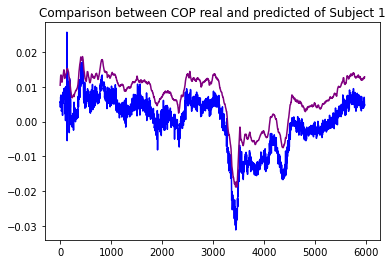

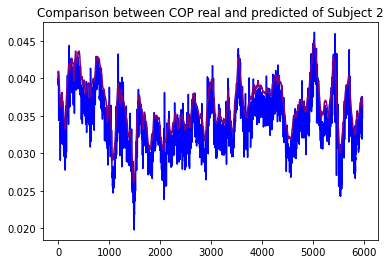

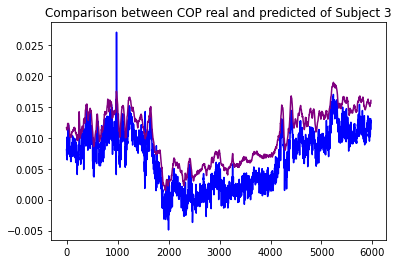

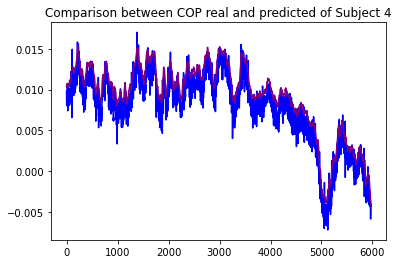

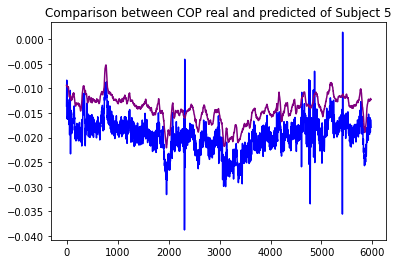

...

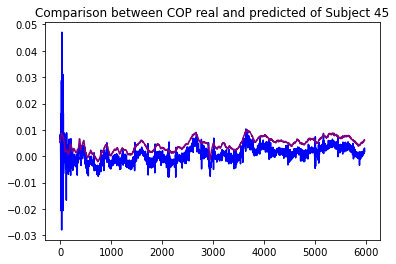

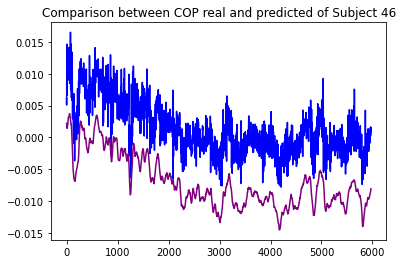

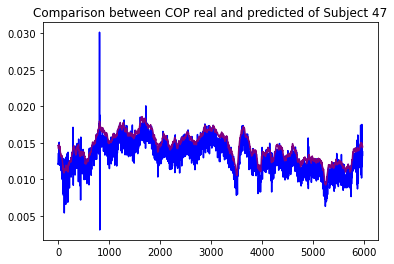

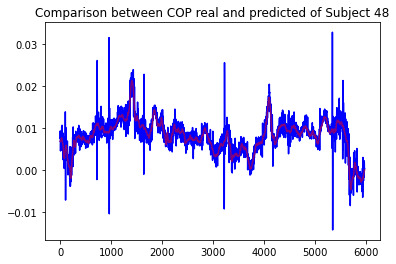

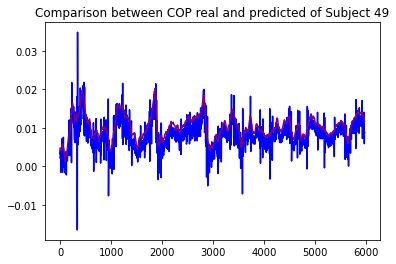

In [18]:
for s in range (1,50):
    plt.figure()
    plt.plot(COPZ[s-1,:],color='blue')
    plt.plot(COPZreal[s-1,:],color='purple')
    plt.title('Comparison between COP real and predicted of Subject {}'.format(s))
    plt.show()

# COP in function of angles

Let's se how the COP correlates with the angles x and z, if the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice some lack of correlation between them. 

# Correlation between COPZ and Angle x

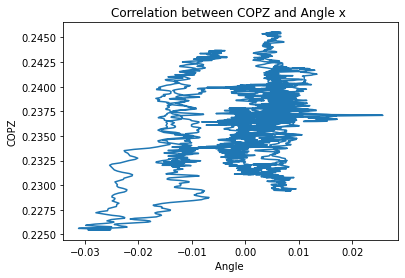

[[1.         0.35791024]
 [0.35791024 1.        ]]


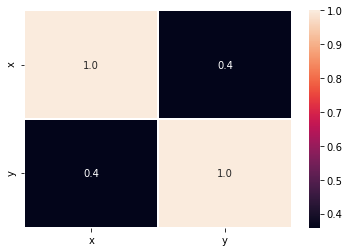

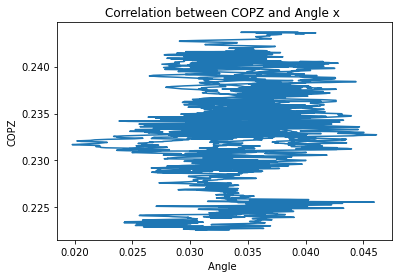

[[1.         0.14182232]
 [0.14182232 1.        ]]


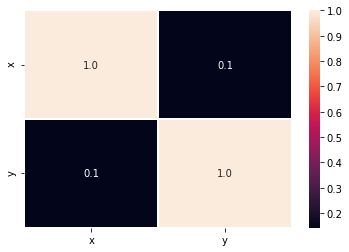

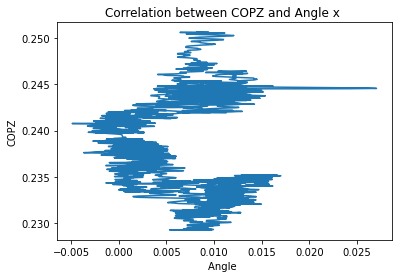

[[ 1.         -0.01102221]
 [-0.01102221  1.        ]]


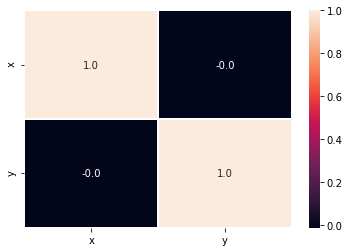

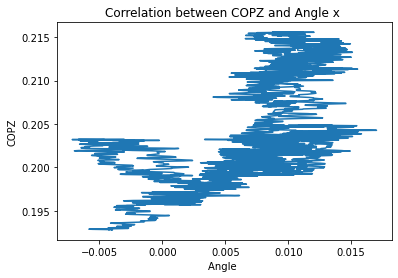

[[1.         0.59645375]
 [0.59645375 1.        ]]


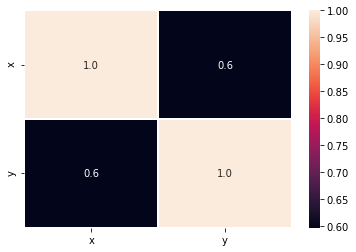

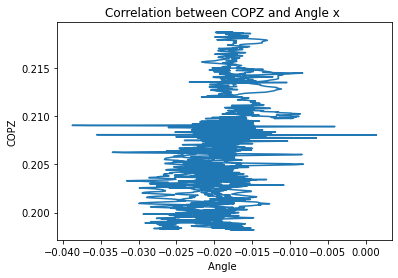

[[1.        0.4702792]
 [0.4702792 1.       ]]


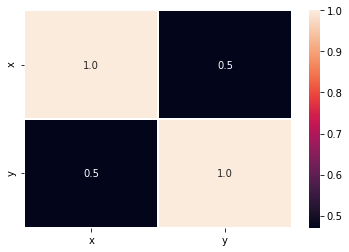

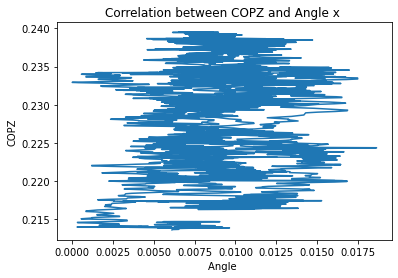

[[1.         0.10978466]
 [0.10978466 1.        ]]


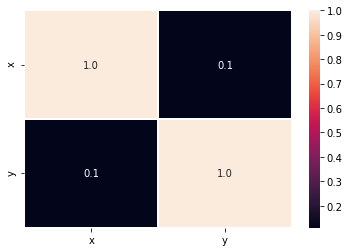

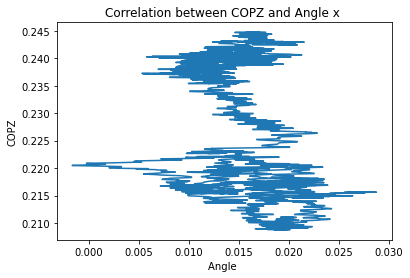

[[ 1.         -0.42301981]
 [-0.42301981  1.        ]]


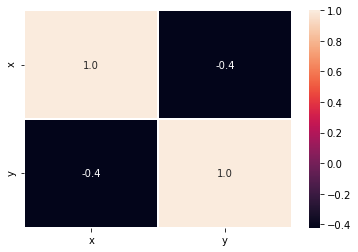

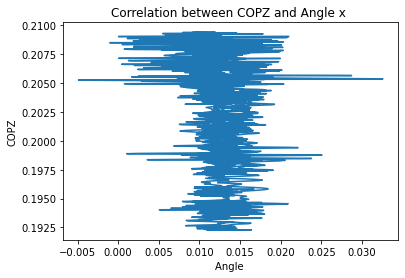

[[ 1.         -0.21991724]
 [-0.21991724  1.        ]]


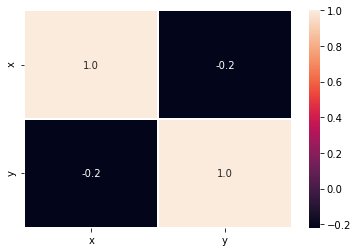

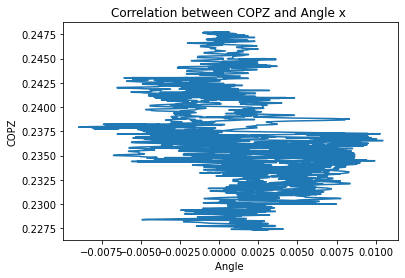

[[ 1.         -0.33454178]
 [-0.33454178  1.        ]]


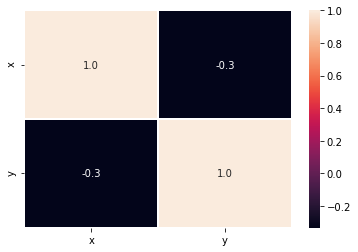

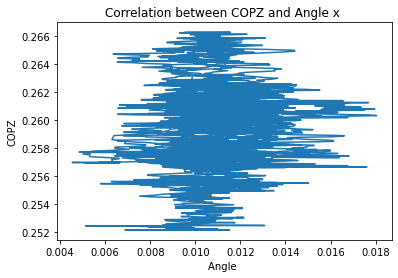

[[1.         0.11157408]
 [0.11157408 1.        ]]


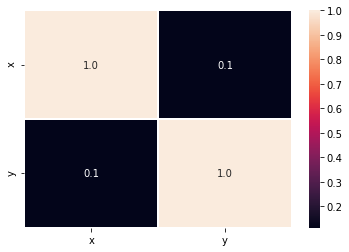

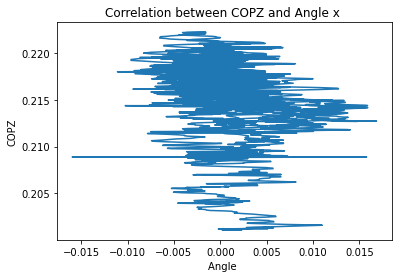

[[ 1.         -0.24906182]
 [-0.24906182  1.        ]]


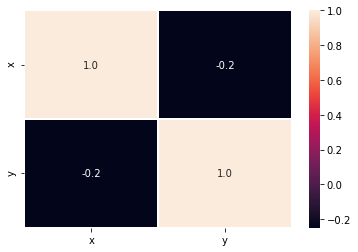

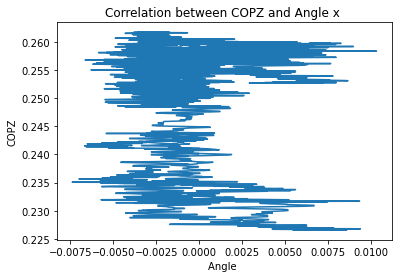

[[1.         0.01060981]
 [0.01060981 1.        ]]


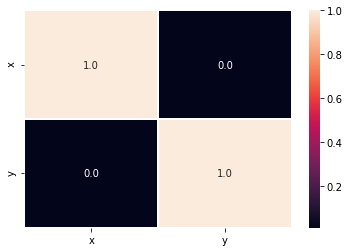

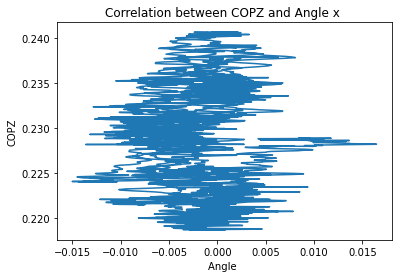

[[ 1.         -0.02453197]
 [-0.02453197  1.        ]]


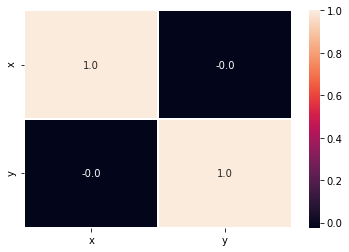

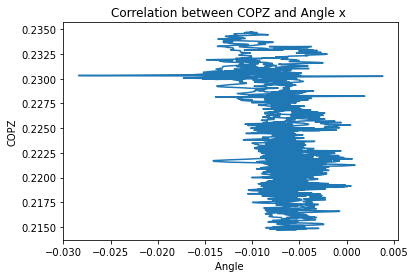

[[ 1.         -0.45686973]
 [-0.45686973  1.        ]]


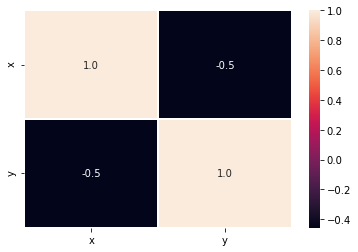

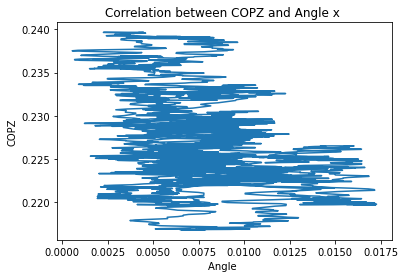

[[ 1.        -0.3674562]
 [-0.3674562  1.       ]]


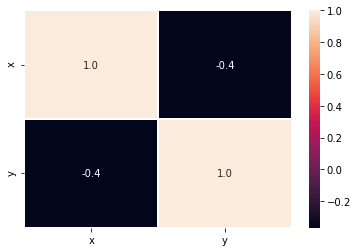

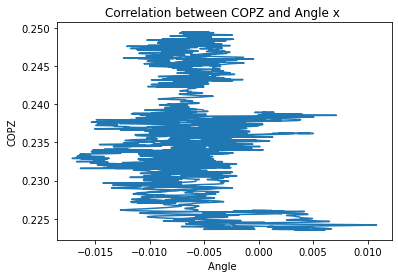

[[1.         0.01502797]
 [0.01502797 1.        ]]


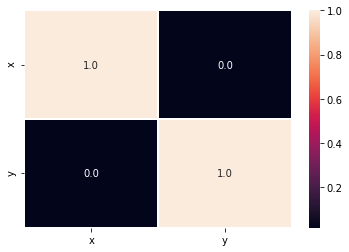

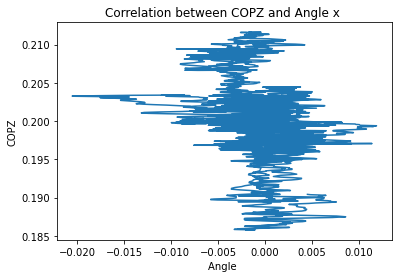

[[ 1.         -0.33515316]
 [-0.33515316  1.        ]]


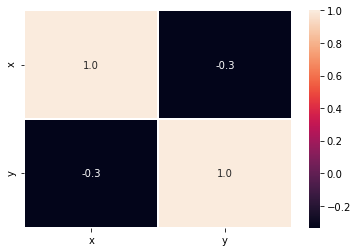

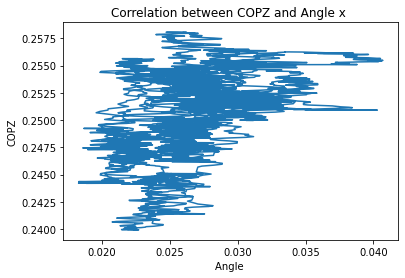

[[1.         0.48093995]
 [0.48093995 1.        ]]


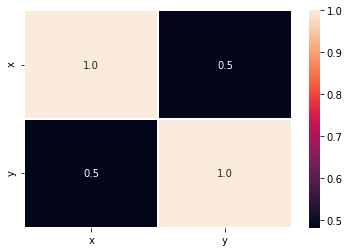

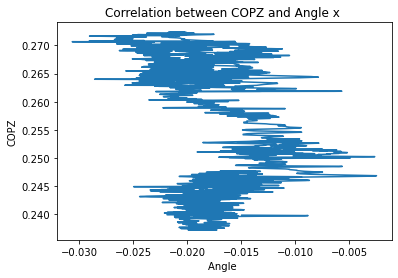

[[ 1.         -0.33540915]
 [-0.33540915  1.        ]]


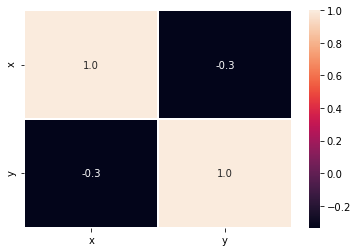

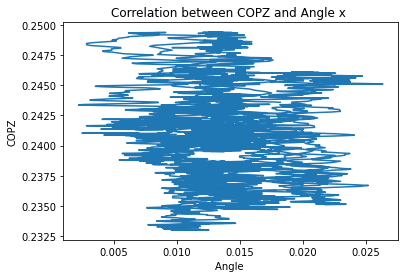

[[ 1.         -0.06325343]
 [-0.06325343  1.        ]]


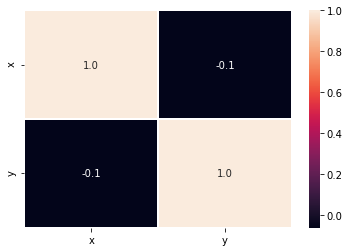

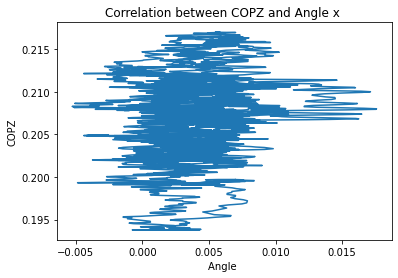

[[1.         0.12590543]
 [0.12590543 1.        ]]


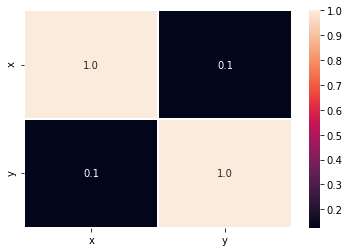

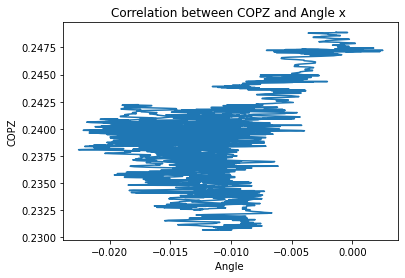

[[1.         0.35308047]
 [0.35308047 1.        ]]


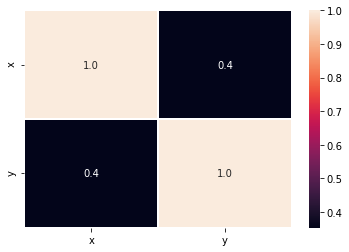

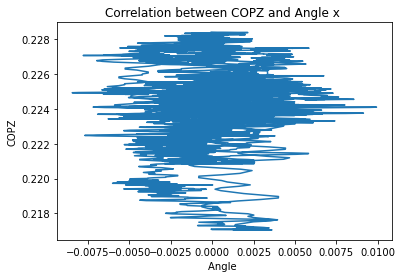

[[1.         0.15226964]
 [0.15226964 1.        ]]


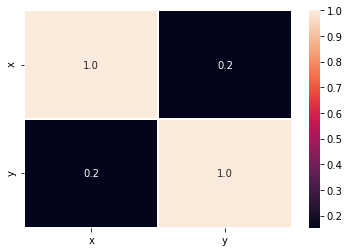

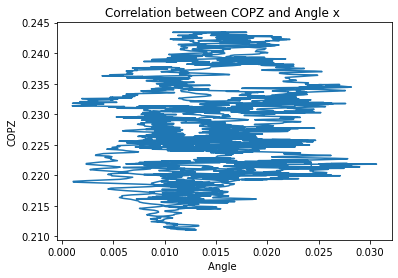

[[1.        0.1236665]
 [0.1236665 1.       ]]


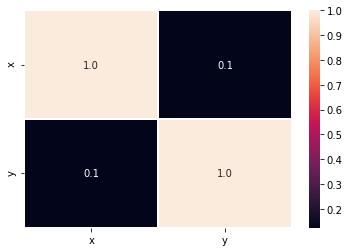

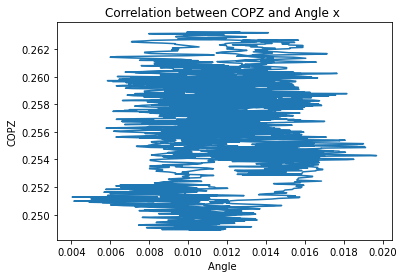

[[1.         0.12957278]
 [0.12957278 1.        ]]


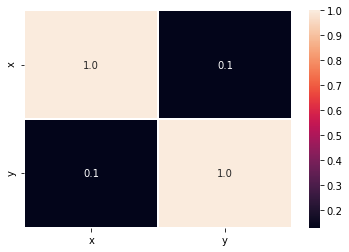

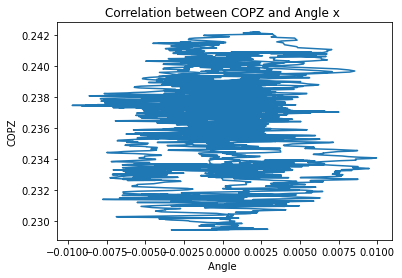

[[1.         0.01296799]
 [0.01296799 1.        ]]


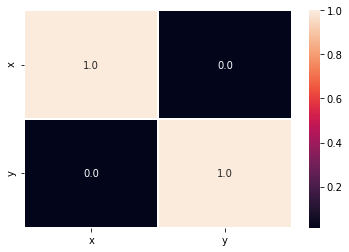

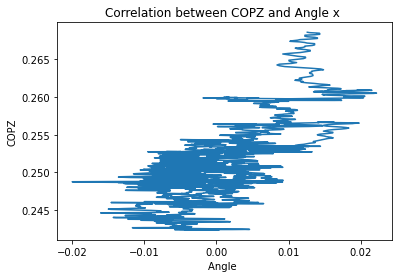

[[1.        0.6300959]
 [0.6300959 1.       ]]


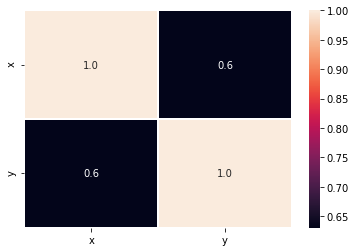

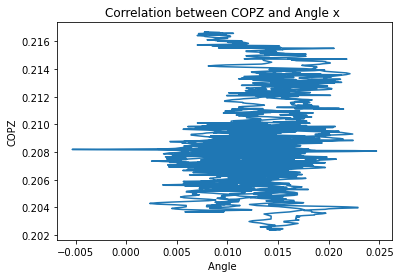

[[1.         0.28247276]
 [0.28247276 1.        ]]


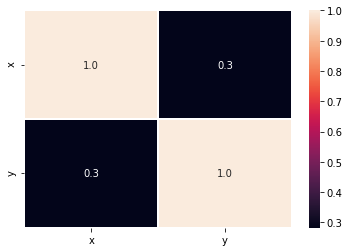

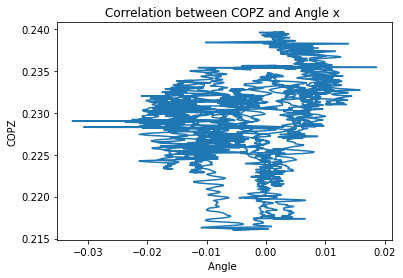

[[1.         0.19743358]
 [0.19743358 1.        ]]


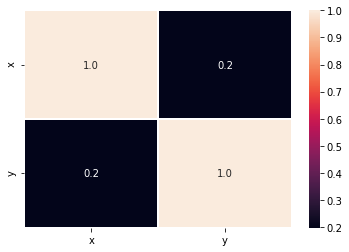

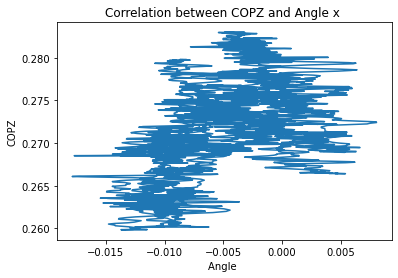

[[1.         0.52982784]
 [0.52982784 1.        ]]


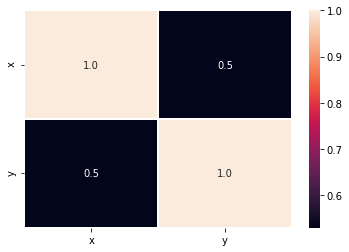

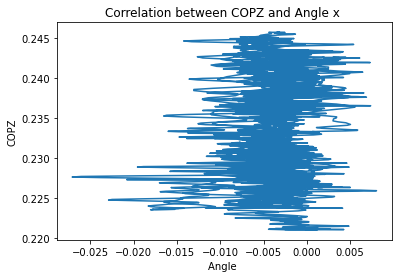

[[1.         0.12379493]
 [0.12379493 1.        ]]


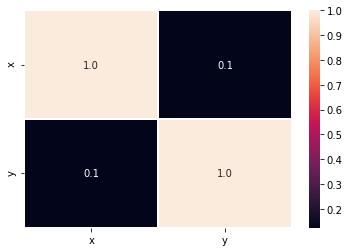

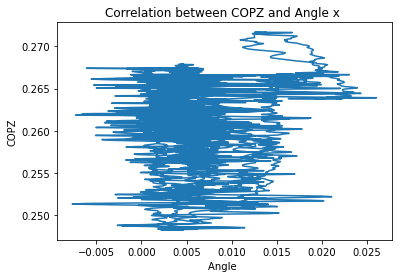

[[1.        0.1038951]
 [0.1038951 1.       ]]


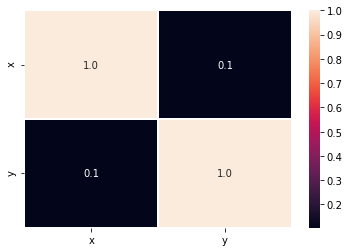

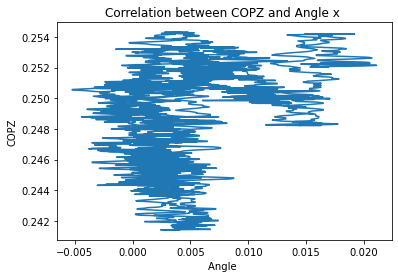

[[1.        0.3752653]
 [0.3752653 1.       ]]


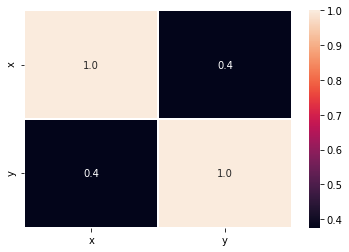

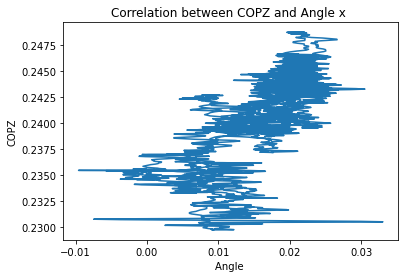

[[1.         0.71352186]
 [0.71352186 1.        ]]


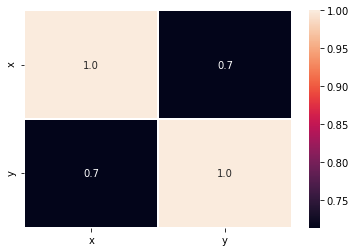

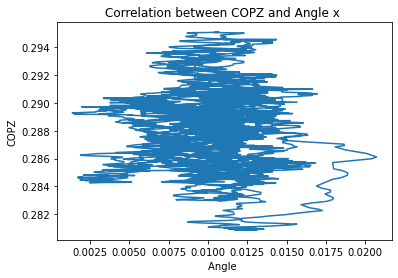

[[ 1.         -0.03007196]
 [-0.03007196  1.        ]]


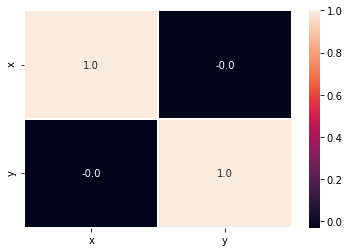

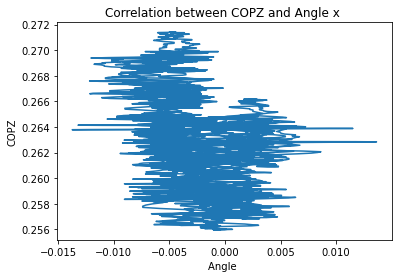

[[ 1.         -0.37644575]
 [-0.37644575  1.        ]]


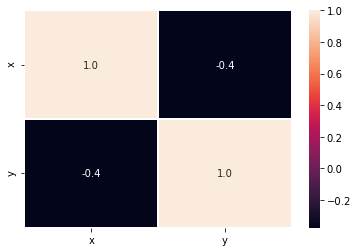

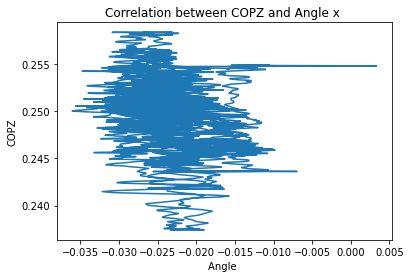

[[ 1.         -0.33629914]
 [-0.33629914  1.        ]]


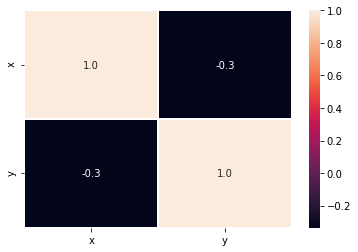

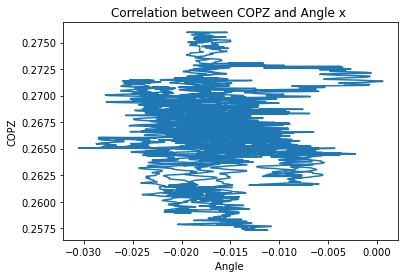

[[ 1.         -0.05553438]
 [-0.05553438  1.        ]]


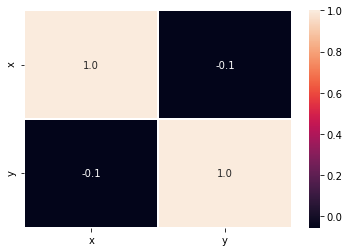

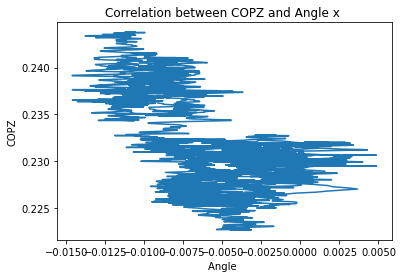

[[ 1.         -0.57946466]
 [-0.57946466  1.        ]]


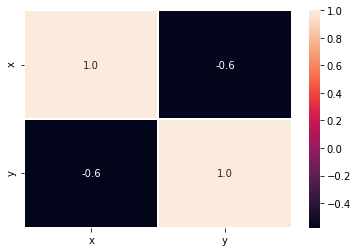

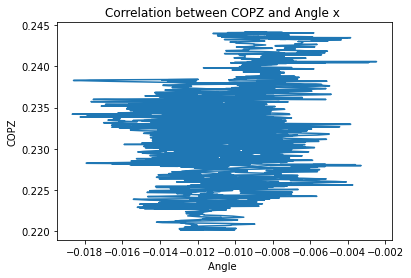

[[1.         0.25461804]
 [0.25461804 1.        ]]


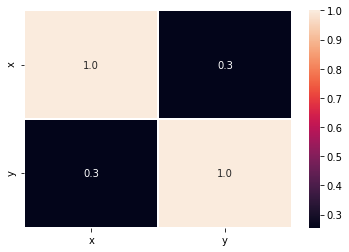

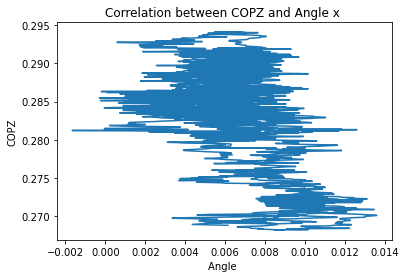

[[ 1.         -0.48475111]
 [-0.48475111  1.        ]]


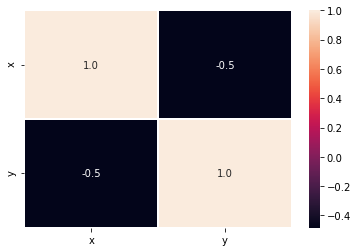

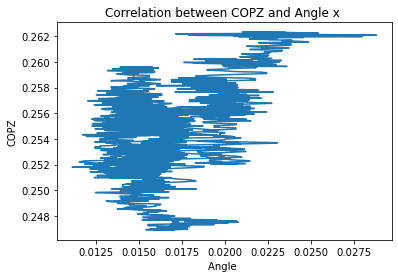

[[1.         0.51484451]
 [0.51484451 1.        ]]


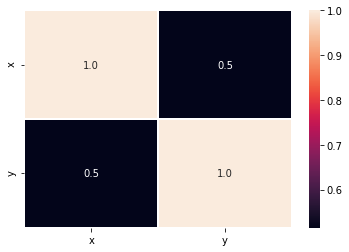

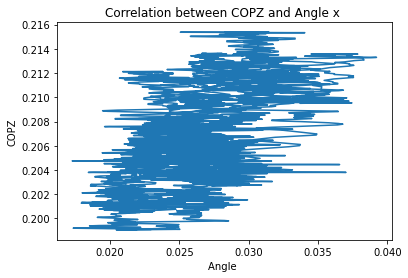

[[1.         0.57080519]
 [0.57080519 1.        ]]


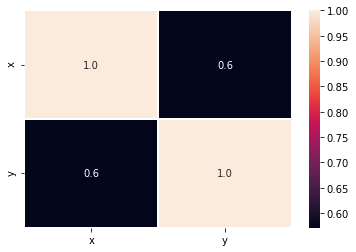

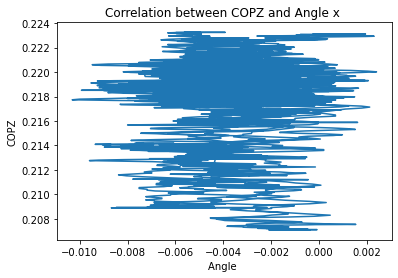

[[1.         0.13980895]
 [0.13980895 1.        ]]


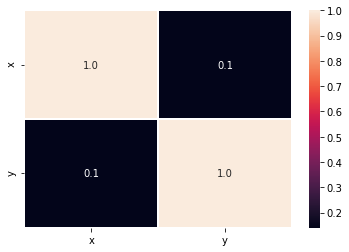

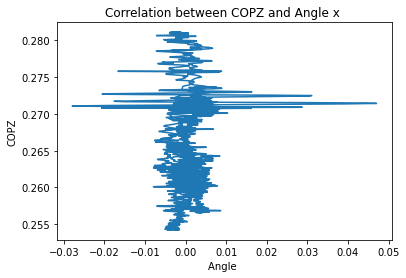

[[1.         0.08000588]
 [0.08000588 1.        ]]


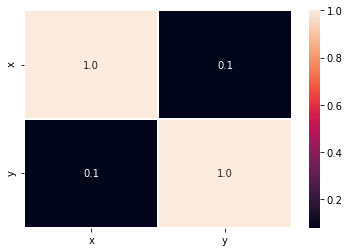

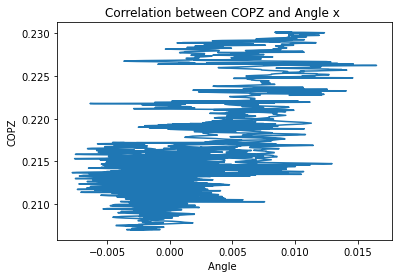

[[1.         0.66537007]
 [0.66537007 1.        ]]


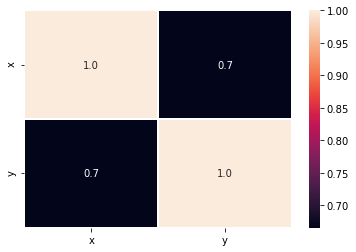

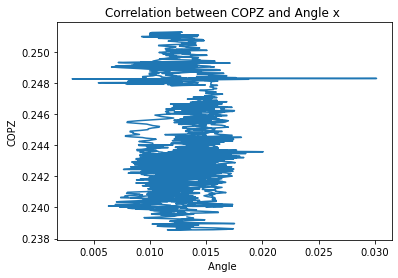

[[1.         0.09939688]
 [0.09939688 1.        ]]


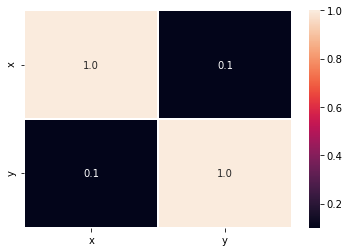

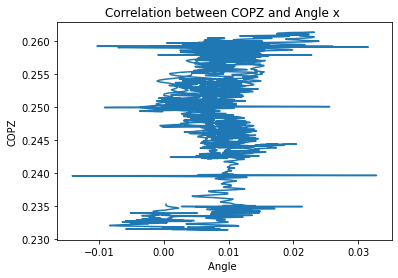

[[1.         0.30062107]
 [0.30062107 1.        ]]


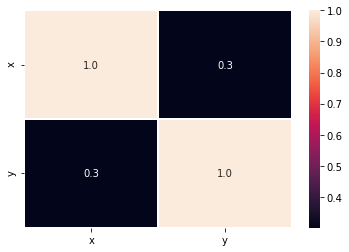

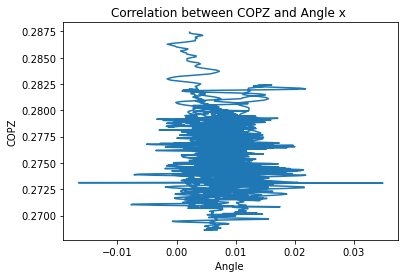

[[ 1.         -0.08336927]
 [-0.08336927  1.        ]]


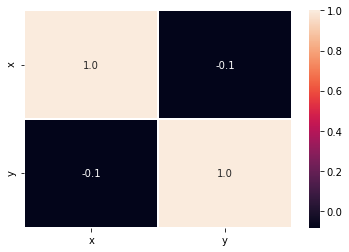

In [19]:
import seaborn as sns
for s in range(1,50):
    plt.figure()
    plt.plot(COPZ[s-1,:],matrizangx[s-1,:])
    plt.xlabel("Angle ")
    plt.ylabel("COPZ")
    plt.title("Correlation between COPZ and Angle x ")
    plt.show()

    r=np.corrcoef(matrizangx[s-1,:],COPZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':matrizangx[s-1,:],
          'y': COPZ[s-1,:]
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Correlation between COPZ and anglez

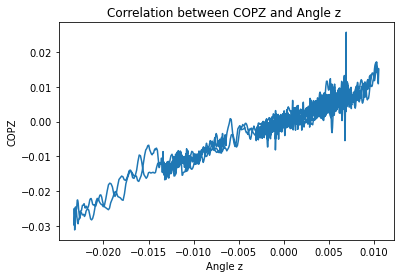

[[1.        0.9745819]
 [0.9745819 1.       ]]


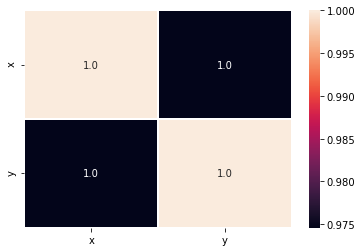

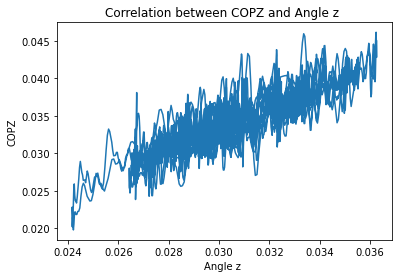

[[1.         0.86139698]
 [0.86139698 1.        ]]


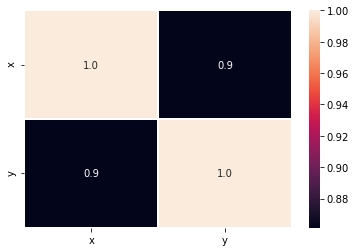

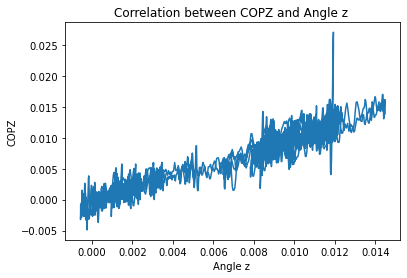

[[1.         0.94949431]
 [0.94949431 1.        ]]


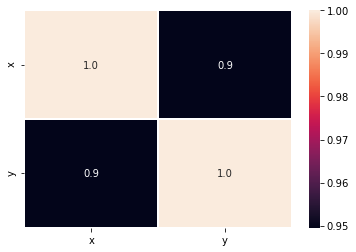

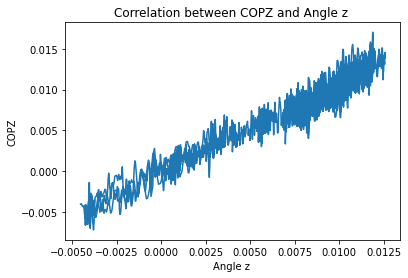

[[1.         0.96820986]
 [0.96820986 1.        ]]


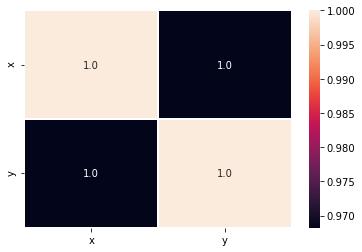

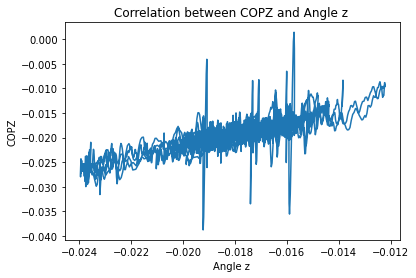

[[1.         0.83939585]
 [0.83939585 1.        ]]


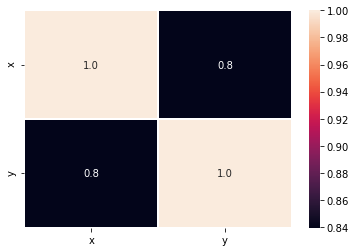

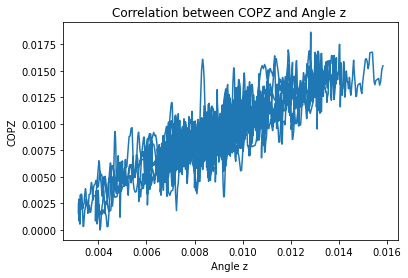

[[1.         0.87601727]
 [0.87601727 1.        ]]


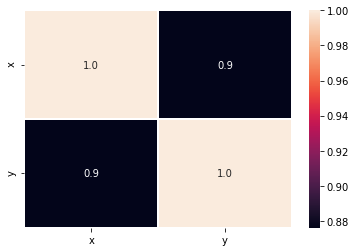

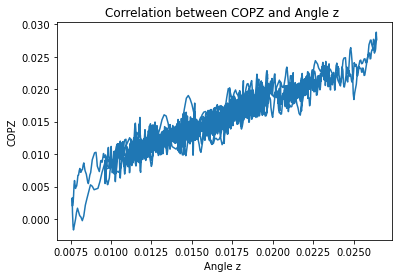

[[1.         0.94572323]
 [0.94572323 1.        ]]


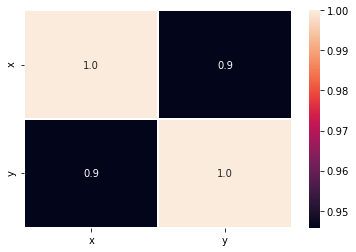

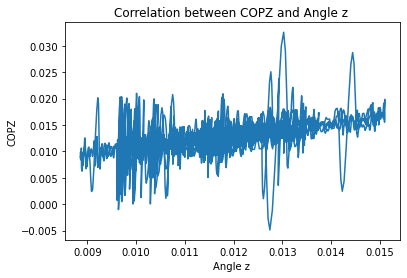

[[1.         0.59916184]
 [0.59916184 1.        ]]


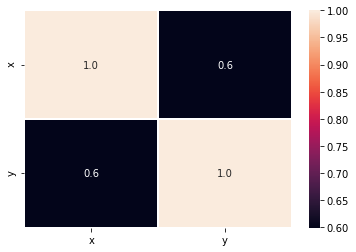

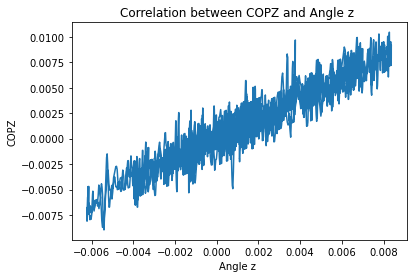

[[1.         0.95221848]
 [0.95221848 1.        ]]


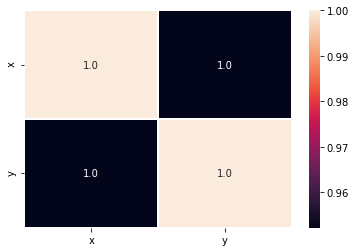

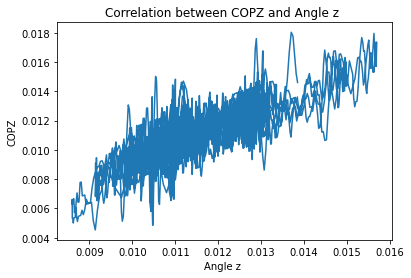

[[1.        0.8180422]
 [0.8180422 1.       ]]


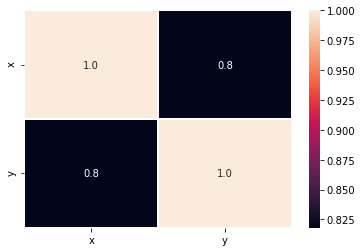

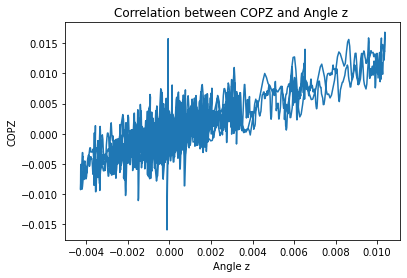

[[1.         0.85540298]
 [0.85540298 1.        ]]


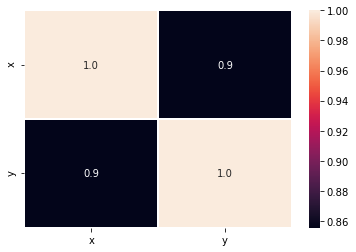

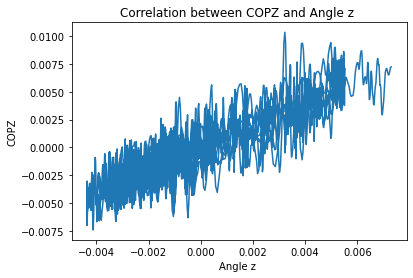

[[1.         0.88048929]
 [0.88048929 1.        ]]


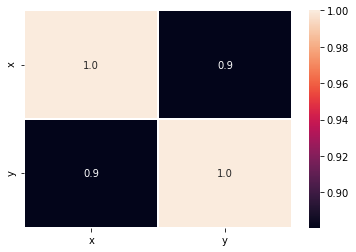

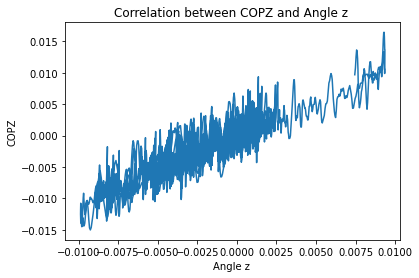

[[1.         0.90240827]
 [0.90240827 1.        ]]


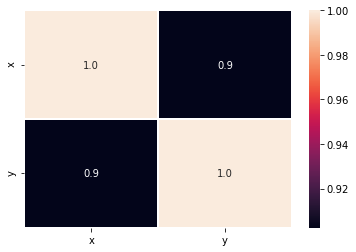

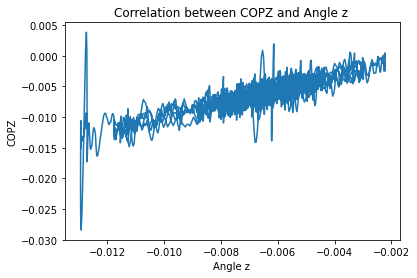

[[1.        0.8615349]
 [0.8615349 1.       ]]


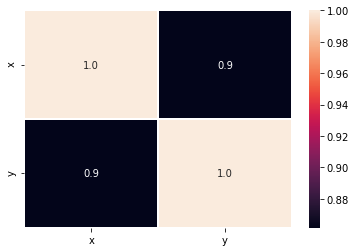

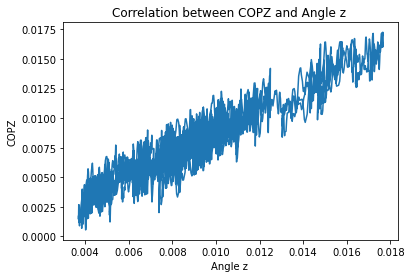

[[1.         0.93624494]
 [0.93624494 1.        ]]


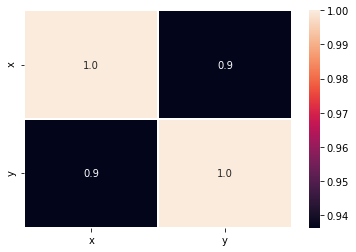

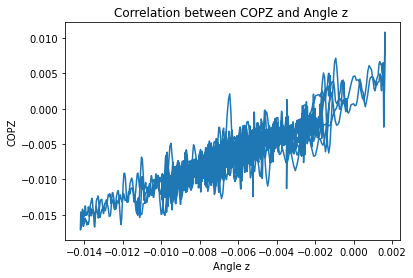

[[1.         0.90763667]
 [0.90763667 1.        ]]


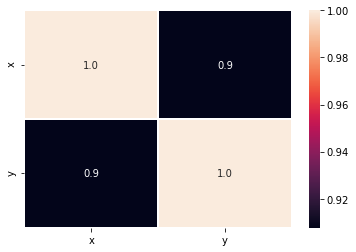

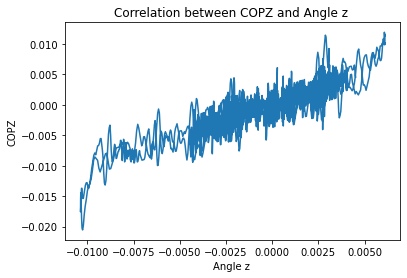

[[1.         0.89118003]
 [0.89118003 1.        ]]


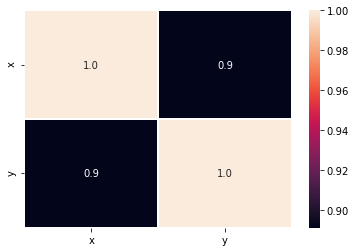

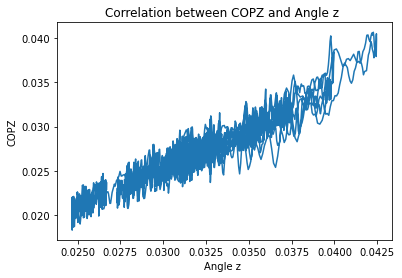

[[1.         0.95101678]
 [0.95101678 1.        ]]


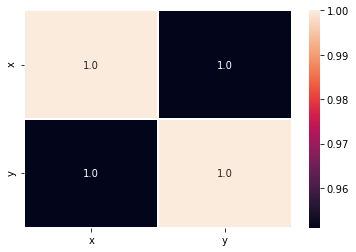

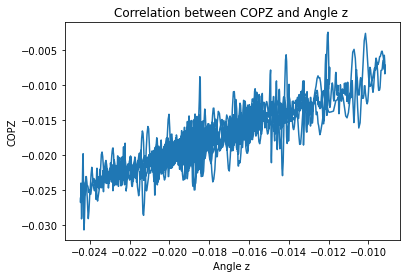

[[1.         0.90262112]
 [0.90262112 1.        ]]


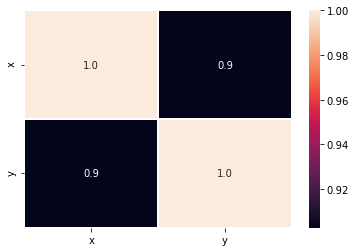

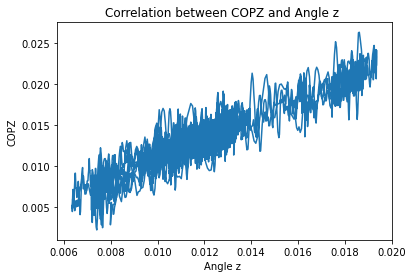

[[1.         0.93038484]
 [0.93038484 1.        ]]


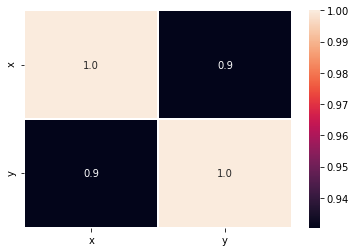

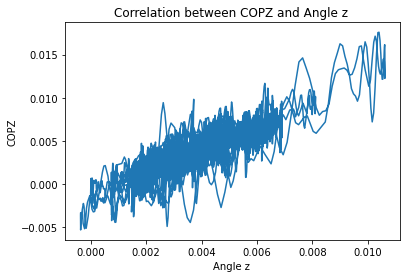

[[1.         0.86007724]
 [0.86007724 1.        ]]


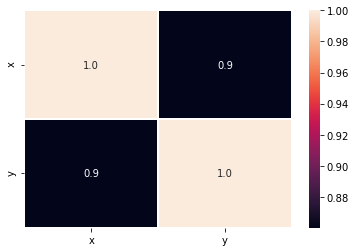

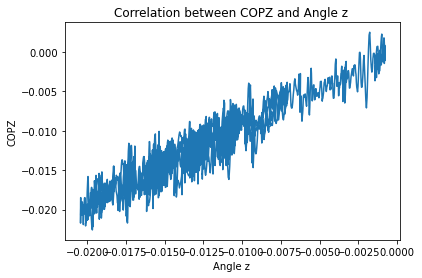

[[1.         0.94010541]
 [0.94010541 1.        ]]


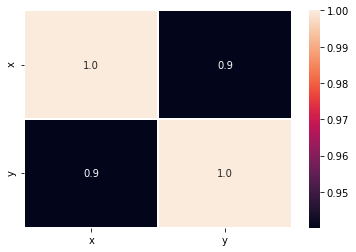

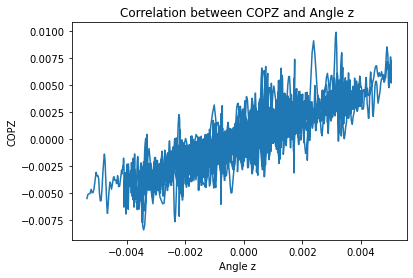

[[1.        0.8864562]
 [0.8864562 1.       ]]


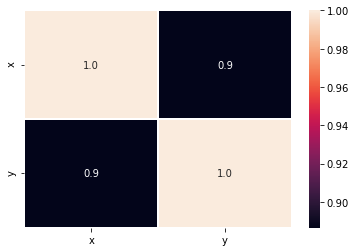

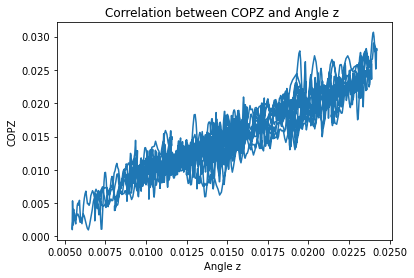

[[1.         0.93590834]
 [0.93590834 1.        ]]


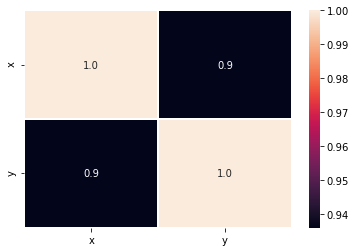

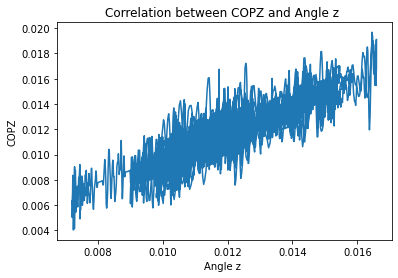

[[1.         0.88054224]
 [0.88054224 1.        ]]


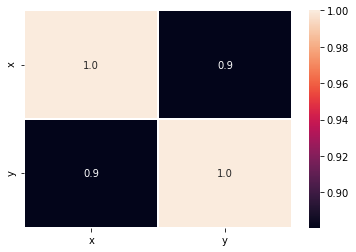

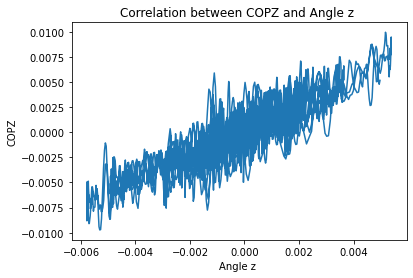

[[1.         0.88725373]
 [0.88725373 1.        ]]


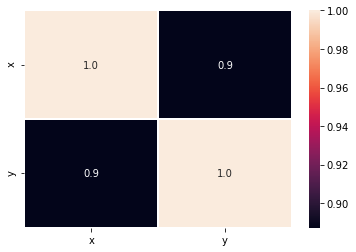

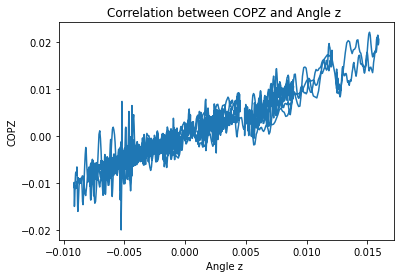

[[1.         0.95143072]
 [0.95143072 1.        ]]


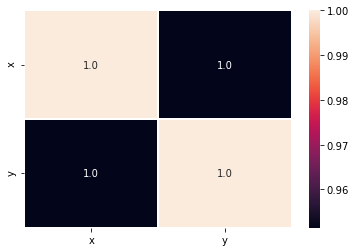

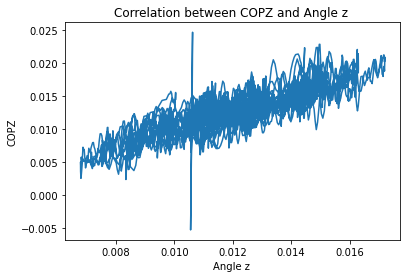

[[1.         0.84404864]
 [0.84404864 1.        ]]


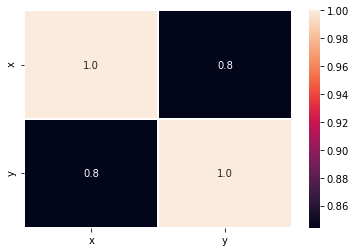

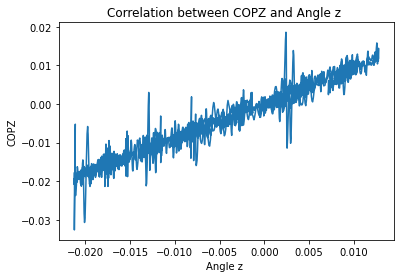

[[1.        0.9810995]
 [0.9810995 1.       ]]


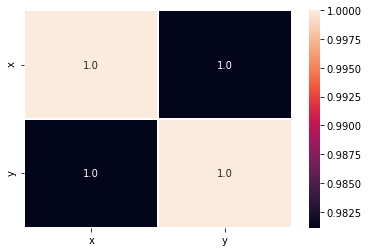

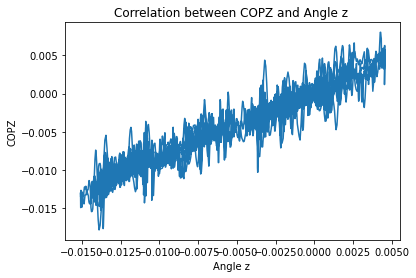

[[1.         0.95819734]
 [0.95819734 1.        ]]


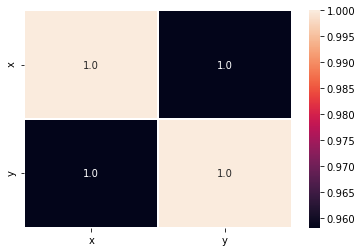

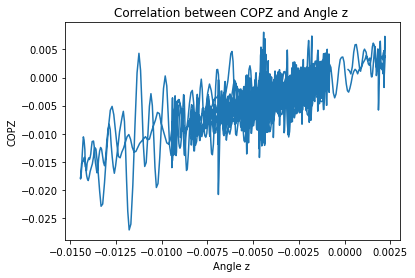

[[1.         0.77815823]
 [0.77815823 1.        ]]


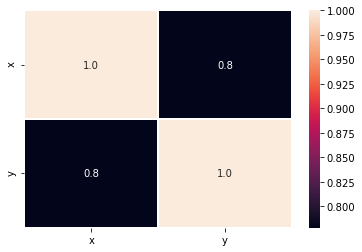

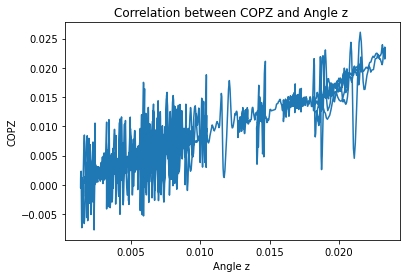

[[1.         0.90890197]
 [0.90890197 1.        ]]


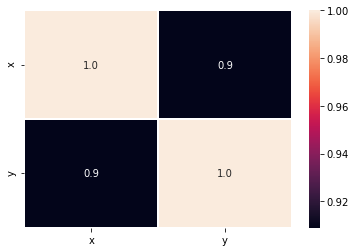

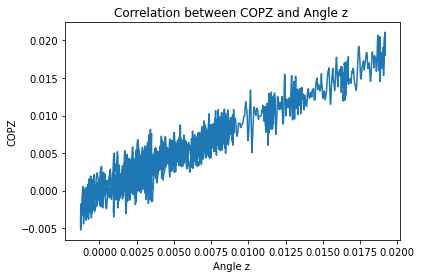

[[1.        0.9626187]
 [0.9626187 1.       ]]


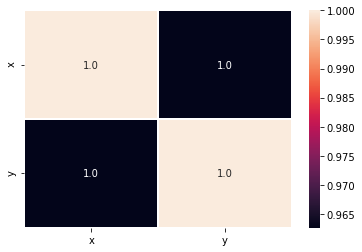

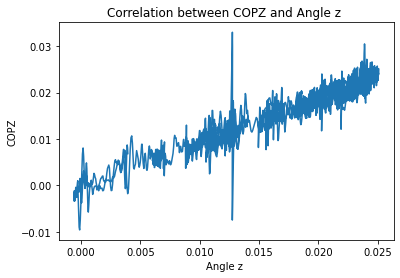

[[1.         0.95899089]
 [0.95899089 1.        ]]


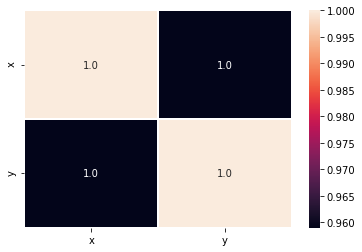

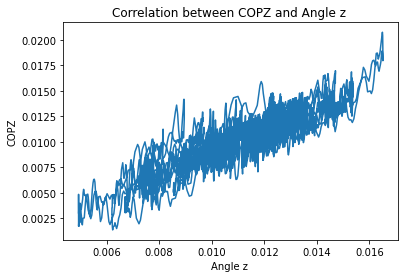

[[1.         0.87472694]
 [0.87472694 1.        ]]


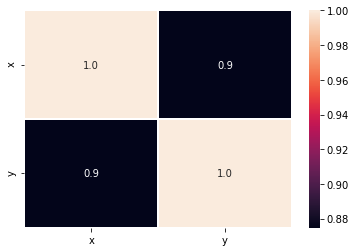

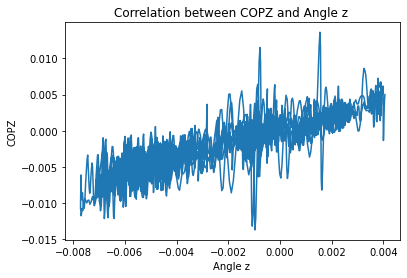

[[1.         0.87974989]
 [0.87974989 1.        ]]


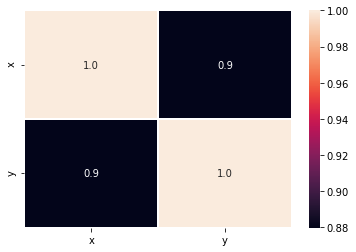

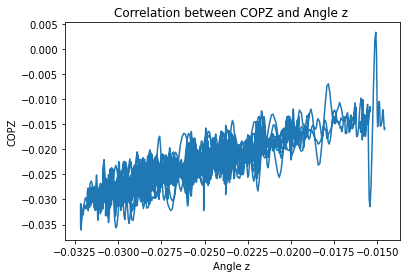

[[1.         0.88844855]
 [0.88844855 1.        ]]


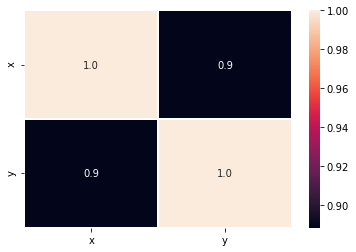

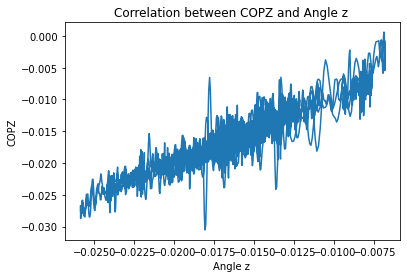

[[1.         0.93314982]
 [0.93314982 1.        ]]


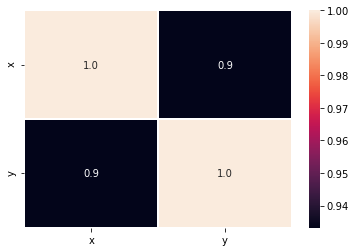

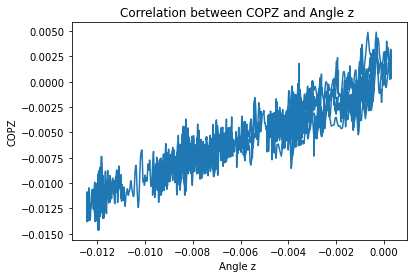

[[1.         0.94520844]
 [0.94520844 1.        ]]


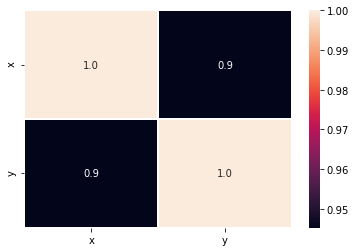

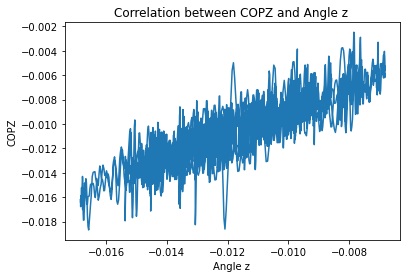

[[1.         0.87688673]
 [0.87688673 1.        ]]


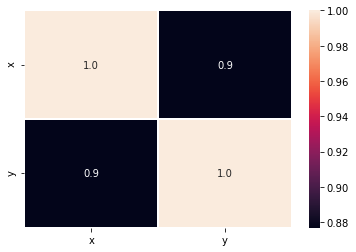

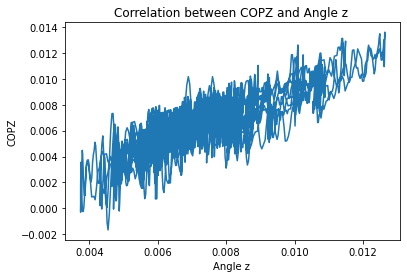

[[1.         0.83635557]
 [0.83635557 1.        ]]


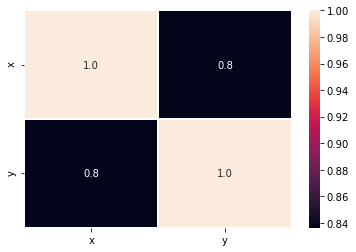

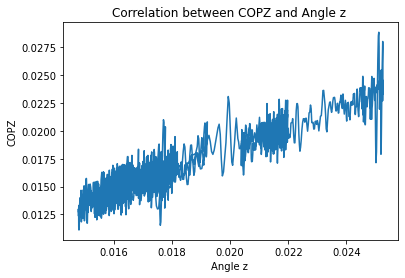

[[1.         0.94065069]
 [0.94065069 1.        ]]


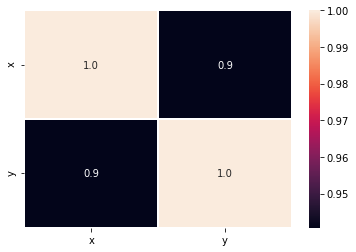

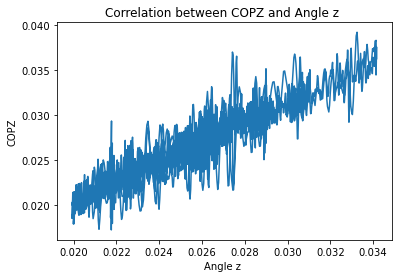

[[1.         0.93006804]
 [0.93006804 1.        ]]


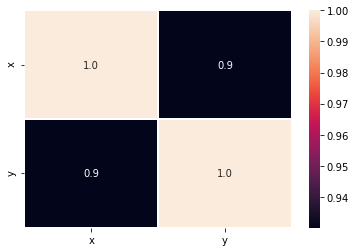

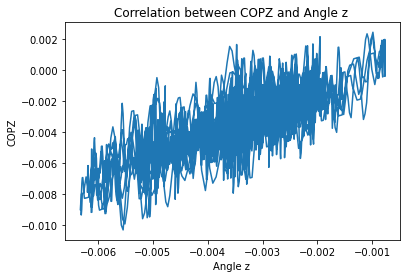

[[1.         0.77303573]
 [0.77303573 1.        ]]


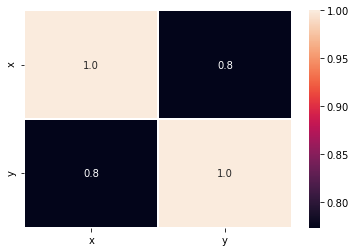

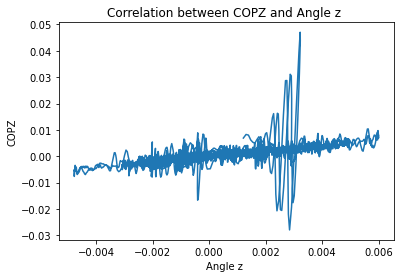

[[1.         0.72094364]
 [0.72094364 1.        ]]


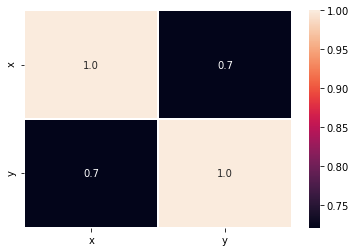

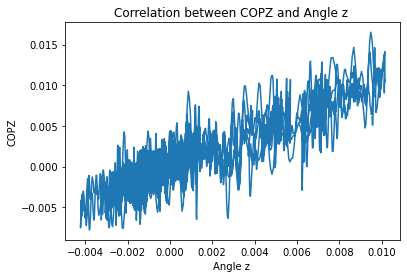

[[1.         0.90549111]
 [0.90549111 1.        ]]


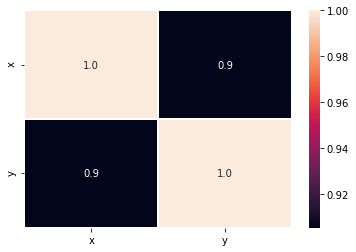

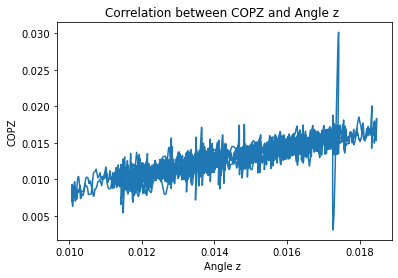

[[1.         0.87279844]
 [0.87279844 1.        ]]


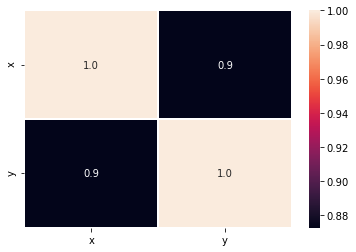

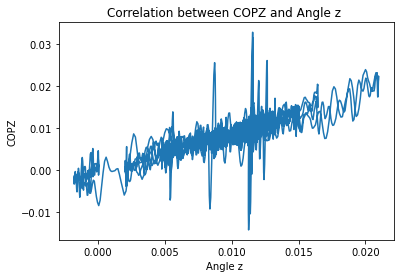

[[1.        0.8782341]
 [0.8782341 1.       ]]


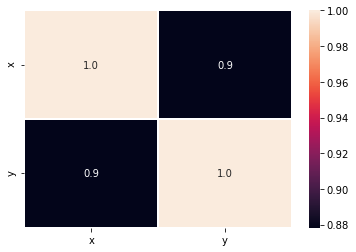

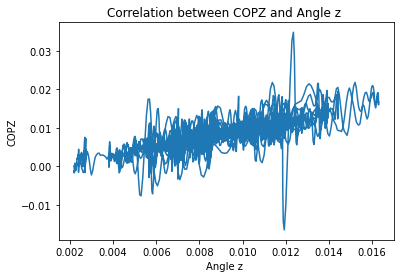

[[1.        0.7966483]
 [0.7966483 1.       ]]


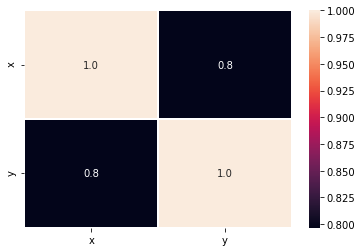

In [20]:
for s in range(1,50):
    plt.figure()
    plt.plot(matrizangz[s-1,:],COPZ[s-1,:])
    plt.xlabel("Angle z ")
    plt.ylabel("COPZ")
    plt.title("Correlation between COPZ and Angle z ")
    plt.show()

    r=np.corrcoef(matrizangz[s-1,:],COPZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':matrizangz[s-1,:],
          'y': COPZ[s-1,:]
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

# Error in function of angles

We are going to correlate the error found with angle x and z. If the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice that the number of correlation approaches -1, indicating a negative correlation betweem them, for the errorz and anglez. With angle x it's possible to conclude that they dont correlate. 

## Correlation between errorz and angle x 

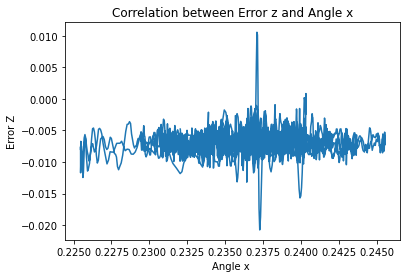

[[1.         0.10185363]
 [0.10185363 1.        ]]


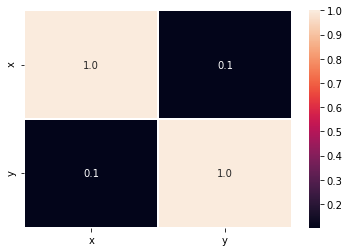

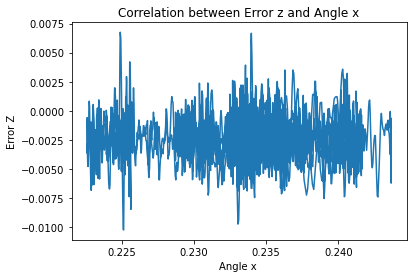

[[ 1.        -0.0145523]
 [-0.0145523  1.       ]]


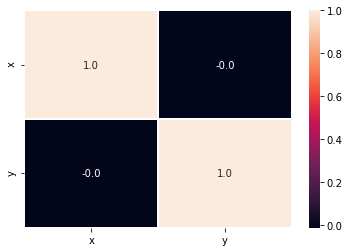

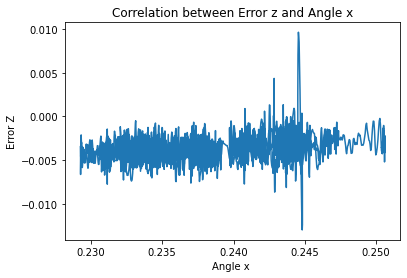

[[1.         0.32543203]
 [0.32543203 1.        ]]


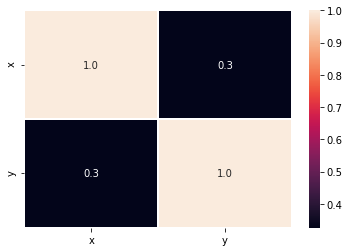

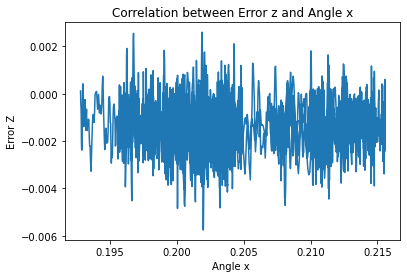

[[ 1.00000000e+00 -1.70891262e-07]
 [-1.70891262e-07  1.00000000e+00]]


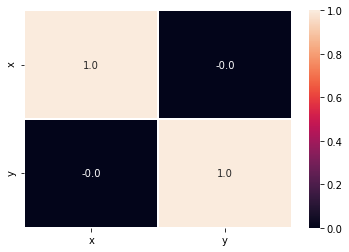

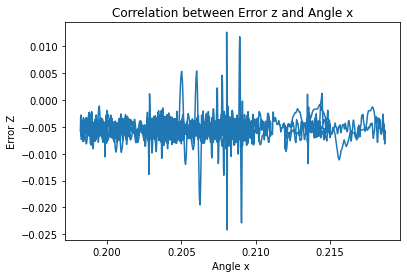

[[1.         0.02571845]
 [0.02571845 1.        ]]


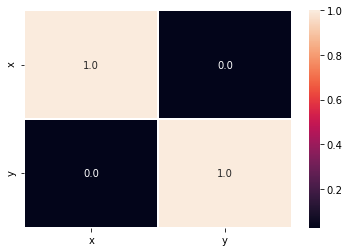

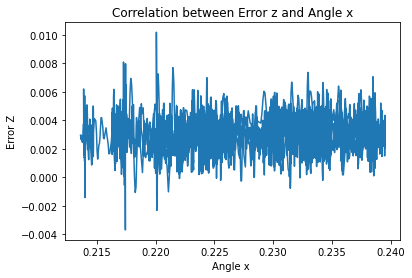

[[1.         0.08790727]
 [0.08790727 1.        ]]


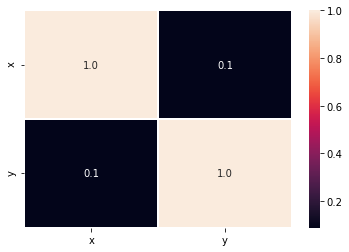

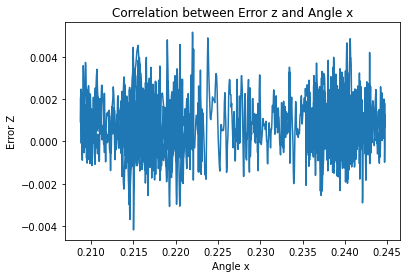

[[1.         0.02556735]
 [0.02556735 1.        ]]


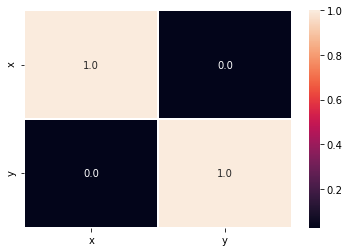

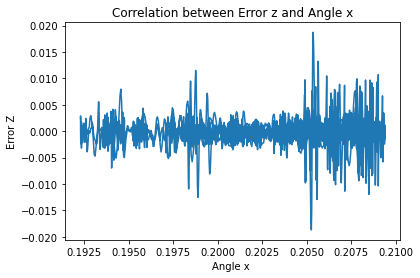

[[1.         0.03422638]
 [0.03422638 1.        ]]


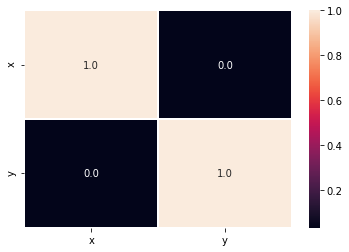

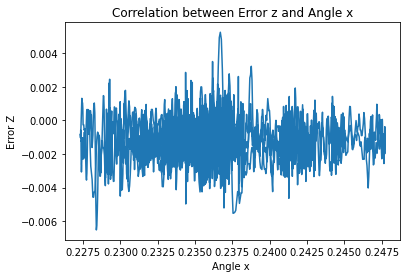

[[1.         0.01311338]
 [0.01311338 1.        ]]


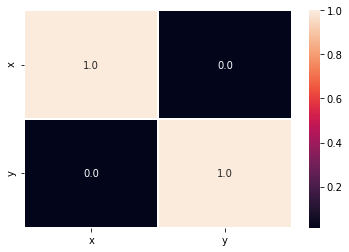

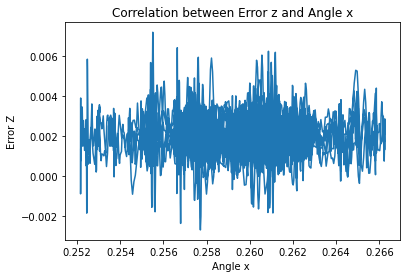

[[1.         0.00548952]
 [0.00548952 1.        ]]


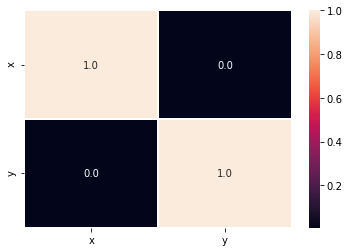

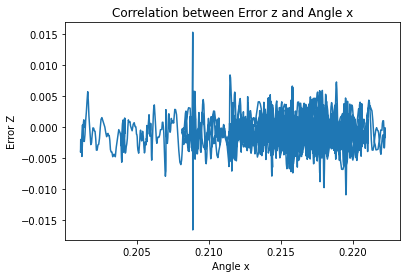

[[1.         0.02150955]
 [0.02150955 1.        ]]


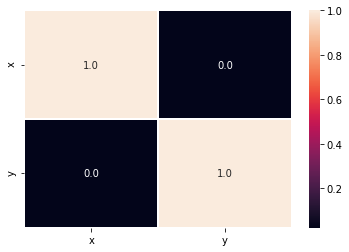

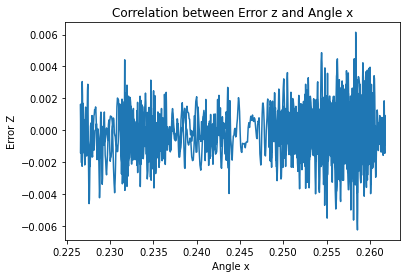

[[1.         0.05036901]
 [0.05036901 1.        ]]


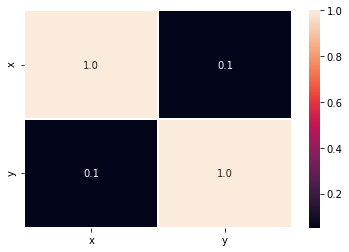

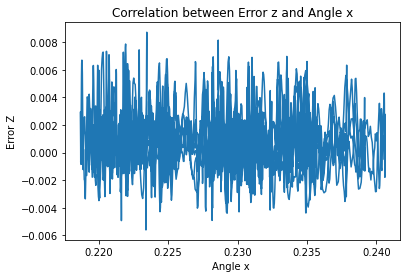

[[ 1.         -0.06224584]
 [-0.06224584  1.        ]]


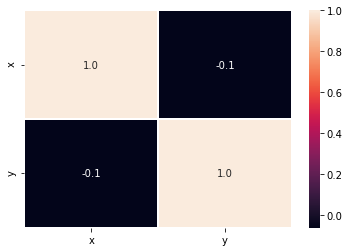

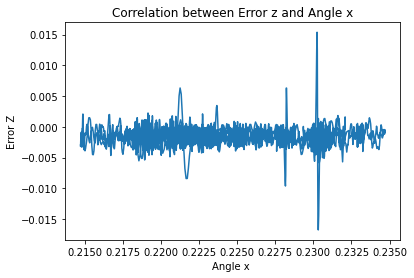

[[1.         0.01678477]
 [0.01678477 1.        ]]


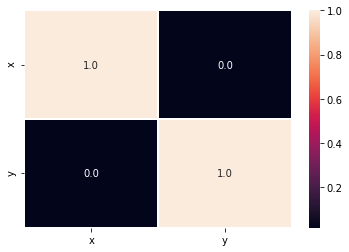

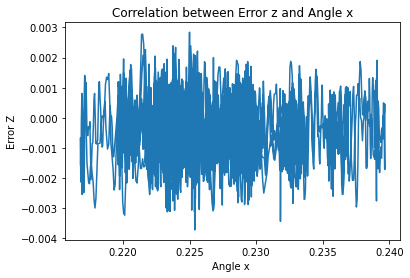

[[ 1.         -0.05875746]
 [-0.05875746  1.        ]]


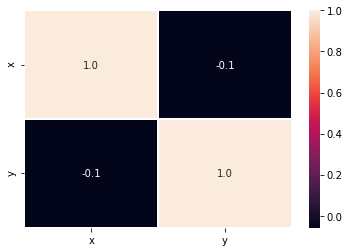

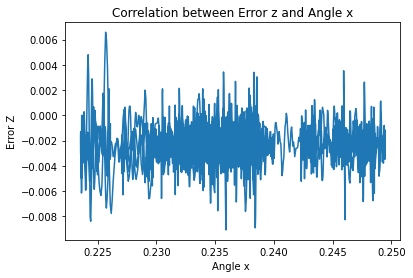

[[1.         0.04059975]
 [0.04059975 1.        ]]


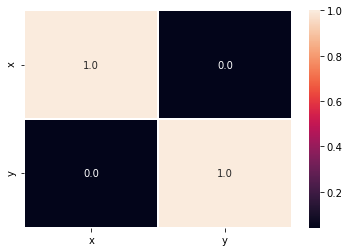

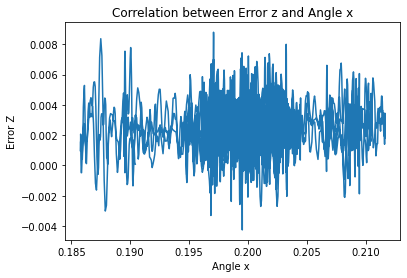

[[1.         0.05977028]
 [0.05977028 1.        ]]


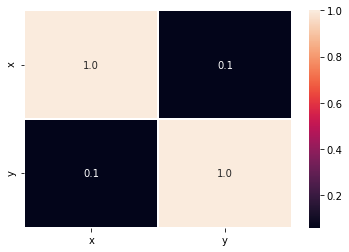

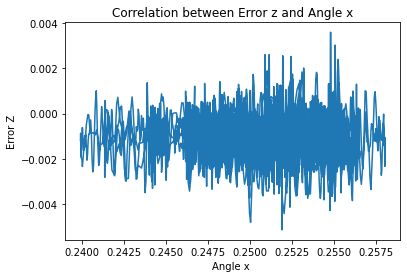

[[1.         0.00273816]
 [0.00273816 1.        ]]


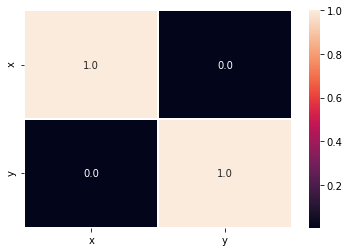

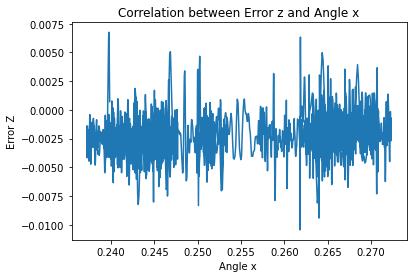

[[1.       0.253209]
 [0.253209 1.      ]]


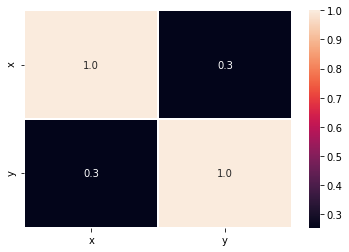

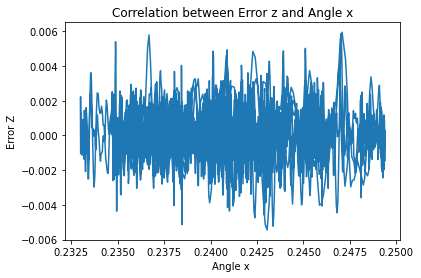

[[ 1.         -0.00619283]
 [-0.00619283  1.        ]]


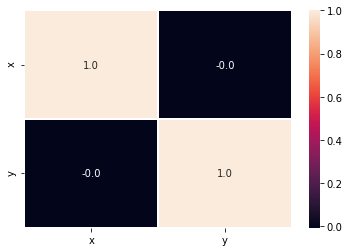

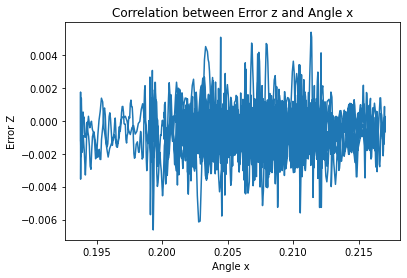

[[1.         0.01962636]
 [0.01962636 1.        ]]


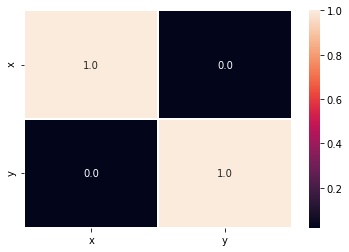

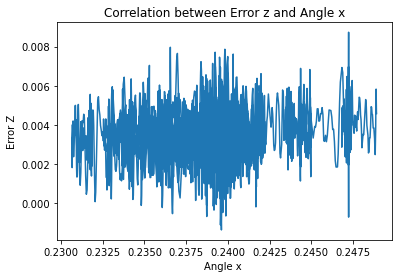

[[1.         0.17227563]
 [0.17227563 1.        ]]


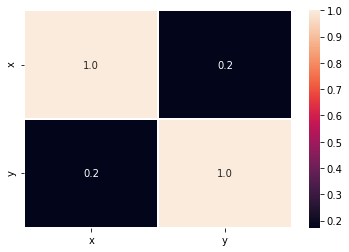

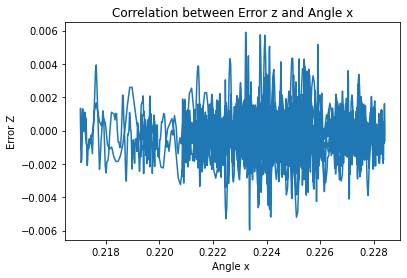

[[ 1.         -0.00401526]
 [-0.00401526  1.        ]]


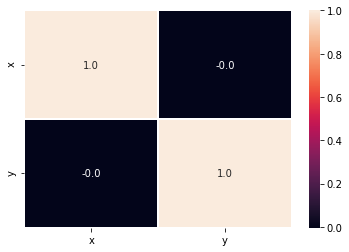

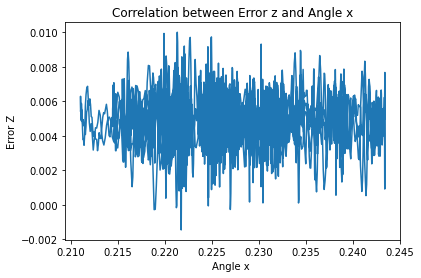

[[ 1.        -0.0161413]
 [-0.0161413  1.       ]]


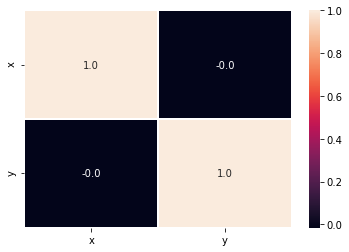

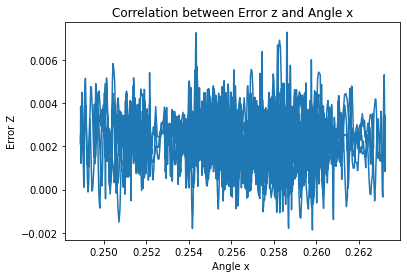

[[ 1.         -0.08961864]
 [-0.08961864  1.        ]]


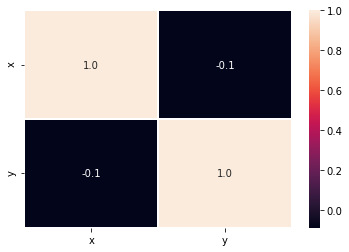

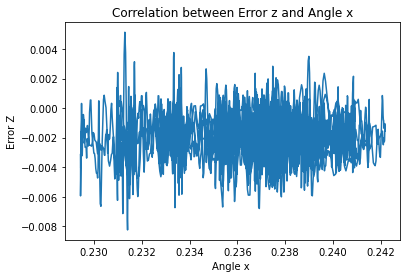

[[1.         0.02114307]
 [0.02114307 1.        ]]


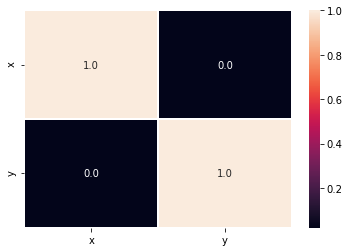

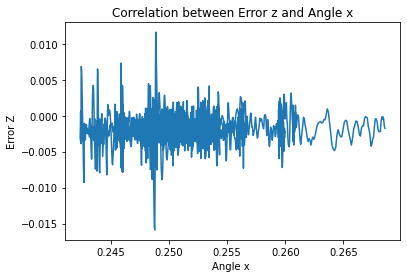

[[1.         0.06302103]
 [0.06302103 1.        ]]


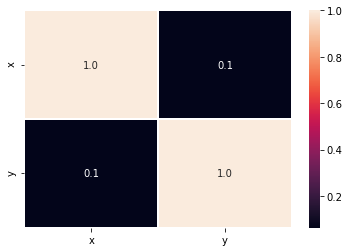

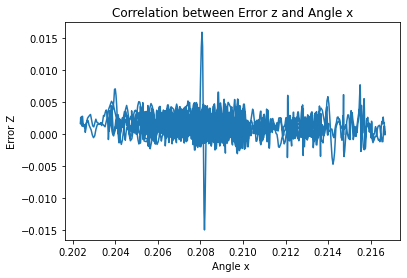

[[ 1.         -0.14264206]
 [-0.14264206  1.        ]]


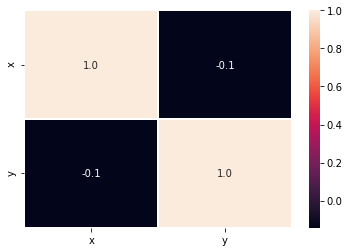

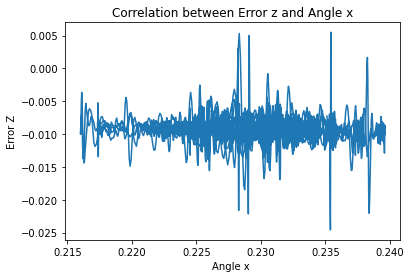

[[ 1.         -0.08214144]
 [-0.08214144  1.        ]]


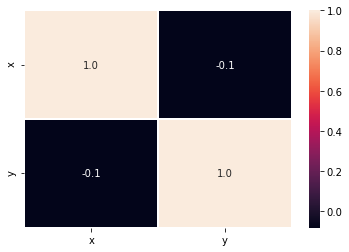

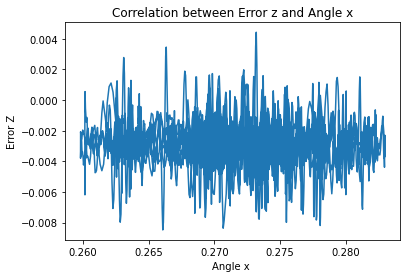

[[ 1.         -0.05864002]
 [-0.05864002  1.        ]]


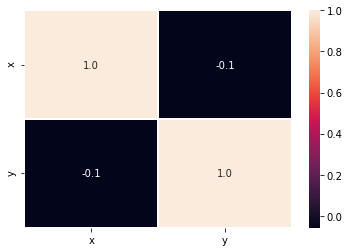

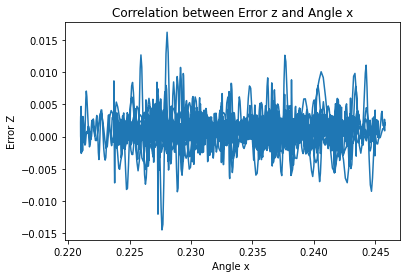

[[1.         0.01303269]
 [0.01303269 1.        ]]


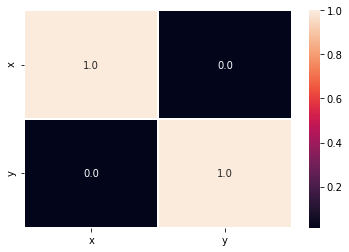

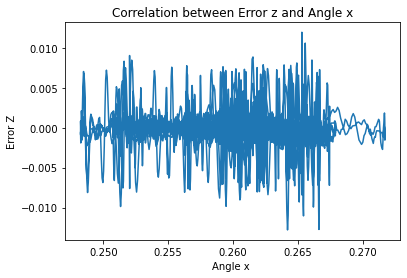

[[ 1.         -0.04446623]
 [-0.04446623  1.        ]]


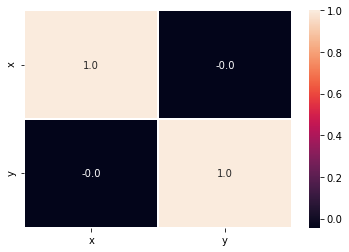

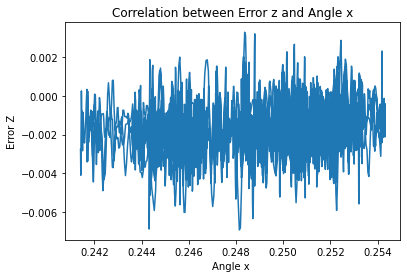

[[1.        0.1779001]
 [0.1779001 1.       ]]


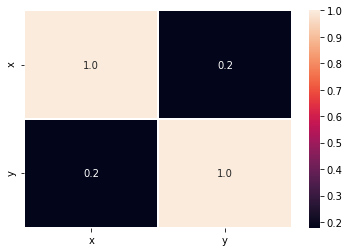

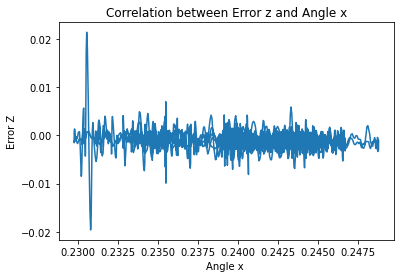

[[ 1.         -0.15473056]
 [-0.15473056  1.        ]]


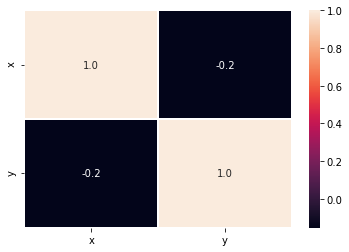

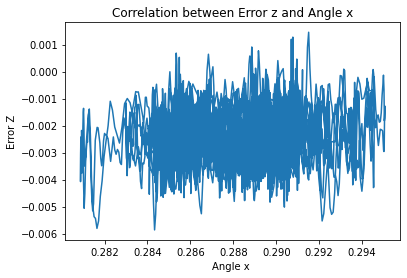

[[1.         0.11882807]
 [0.11882807 1.        ]]


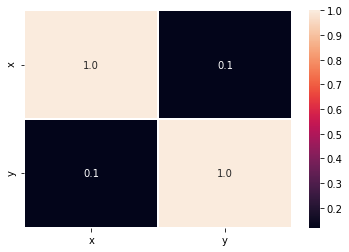

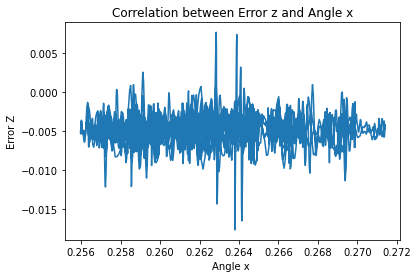

[[ 1.         -0.02006735]
 [-0.02006735  1.        ]]


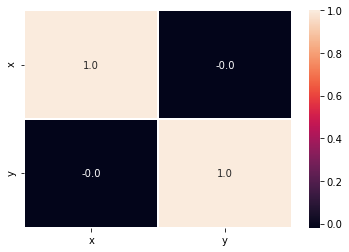

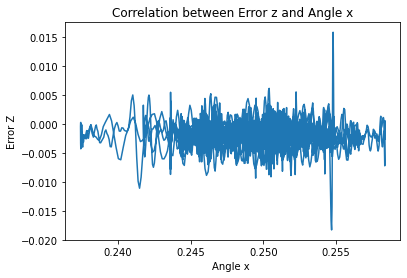

[[ 1.         -0.05220131]
 [-0.05220131  1.        ]]


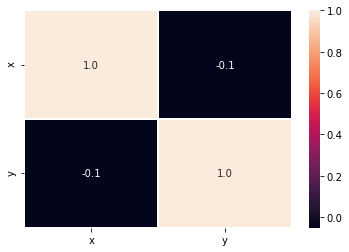

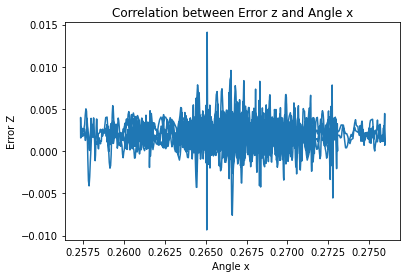

[[ 1.         -0.03009569]
 [-0.03009569  1.        ]]


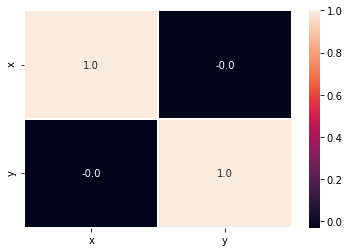

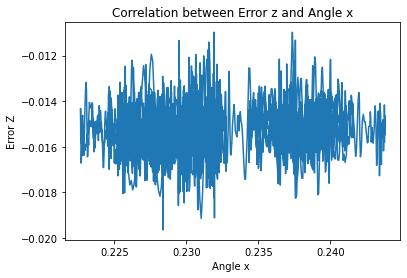

[[1.         0.09964017]
 [0.09964017 1.        ]]


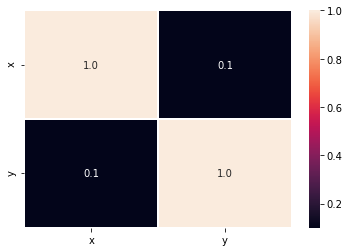

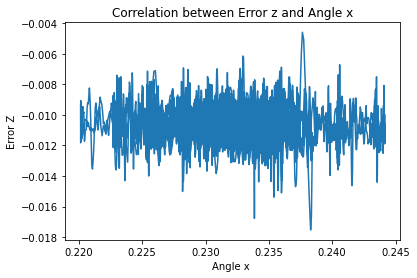

[[ 1.         -0.07611453]
 [-0.07611453  1.        ]]


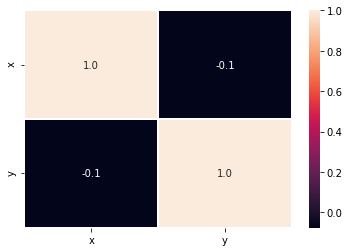

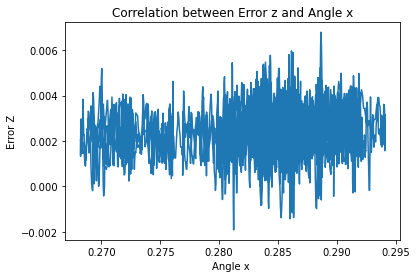

[[1.        0.1606659]
 [0.1606659 1.       ]]


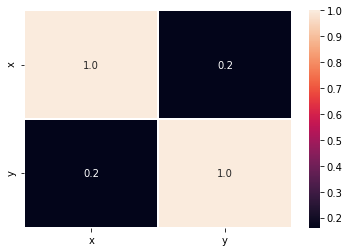

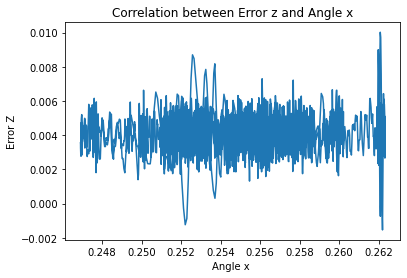

[[1.         0.08469629]
 [0.08469629 1.        ]]


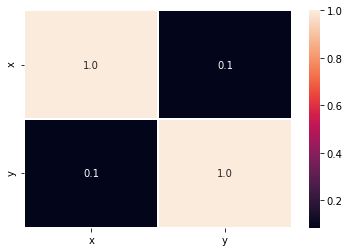

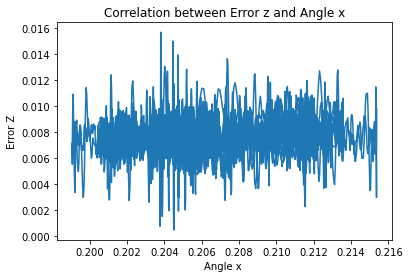

[[1.         0.15494841]
 [0.15494841 1.        ]]


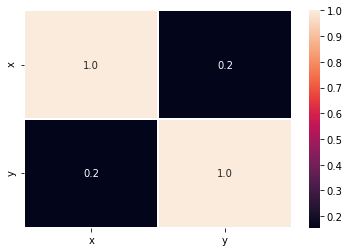

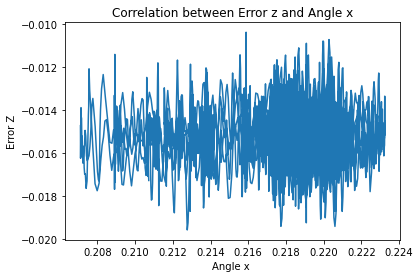

[[1.         0.04890948]
 [0.04890948 1.        ]]


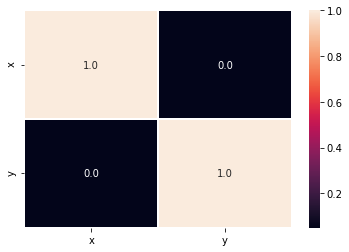

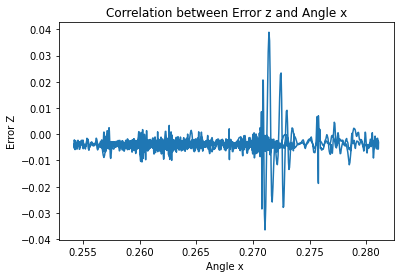

[[1.         0.04544965]
 [0.04544965 1.        ]]


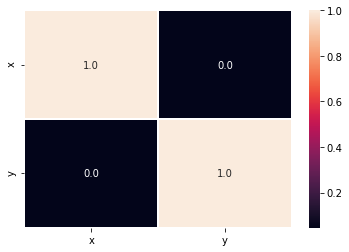

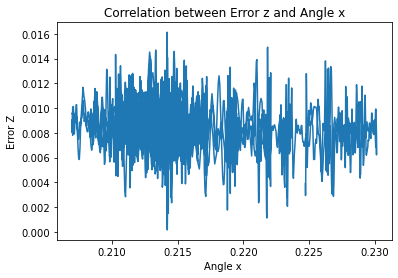

[[ 1.         -0.16085331]
 [-0.16085331  1.        ]]


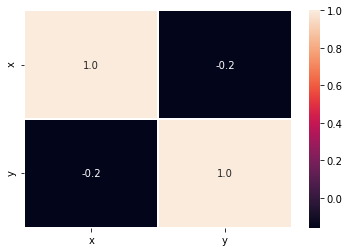

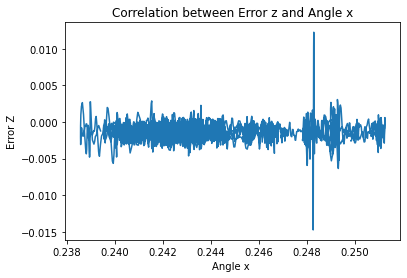

[[1.         0.00789698]
 [0.00789698 1.        ]]


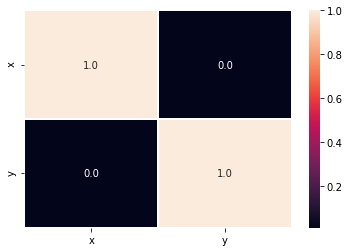

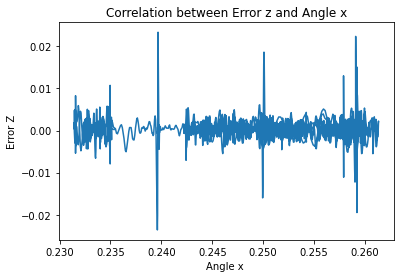

[[ 1.         -0.03279784]
 [-0.03279784  1.        ]]


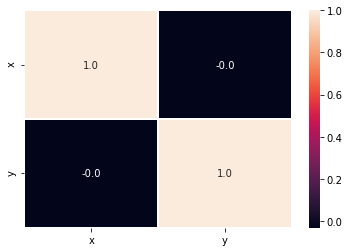

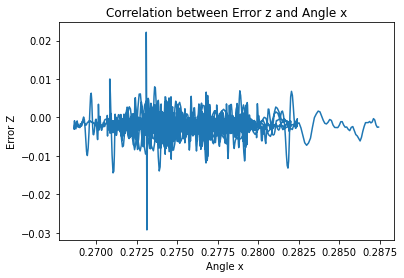

[[ 1.         -0.00454042]
 [-0.00454042  1.        ]]


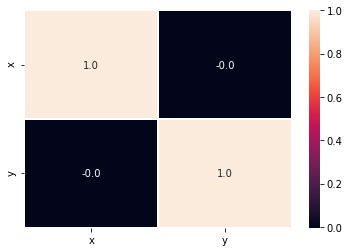

In [21]:
for s in range(1,50):
    plt.figure()
    plt.plot(matrizangx[s-1,:], errorZ[s-1,:])
    plt.xlabel("Angle x ")
    plt.ylabel("Error Z")
    plt.title("Correlation between Error z and Angle x")
    plt.show()

    r=np.corrcoef(matrizangx[s-1,:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':matrizangx[s-1,:],
          'y': errorZ[s-1,:]
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Correlation between errorz and anglez

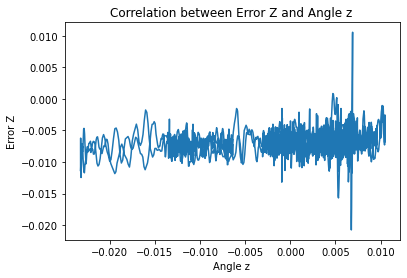

[[1.         0.25318751]
 [0.25318751 1.        ]]


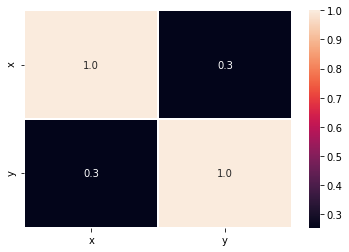

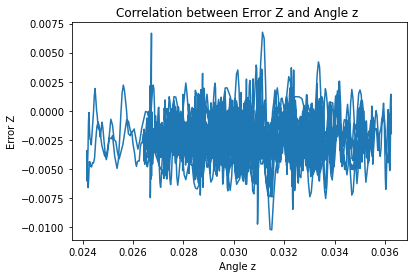

[[1.         0.02097181]
 [0.02097181 1.        ]]


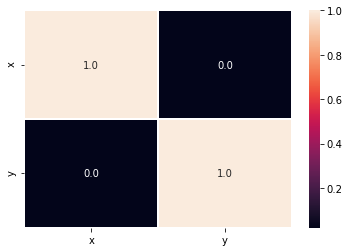

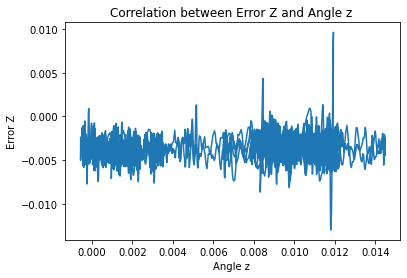

[[1.         0.08943161]
 [0.08943161 1.        ]]


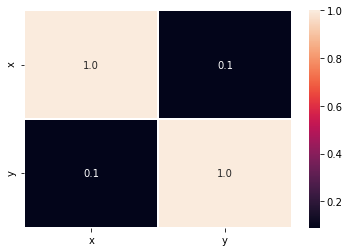

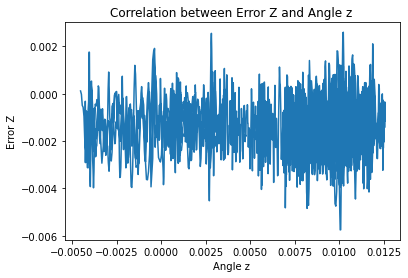

[[ 1.        -0.0373389]
 [-0.0373389  1.       ]]


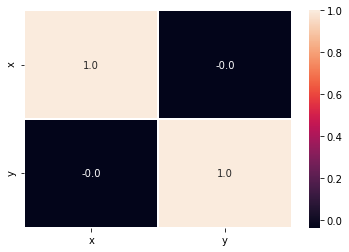

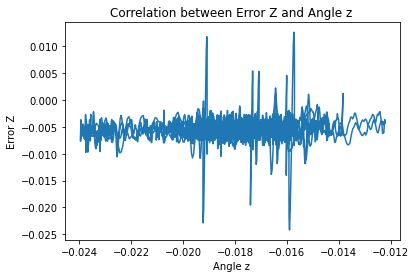

[[1.        0.1059037]
 [0.1059037 1.       ]]


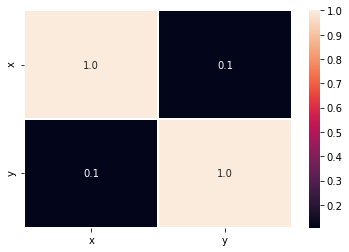

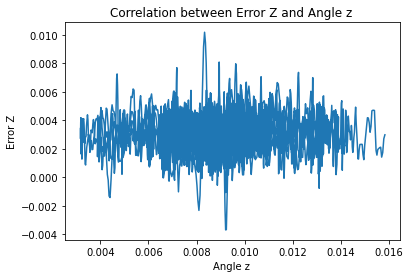

[[1.         0.05901009]
 [0.05901009 1.        ]]


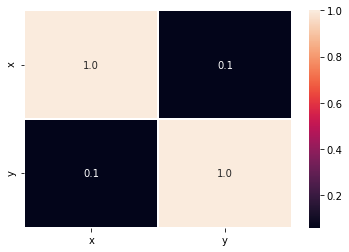

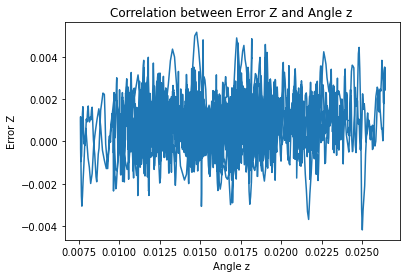

[[1.         0.12156354]
 [0.12156354 1.        ]]


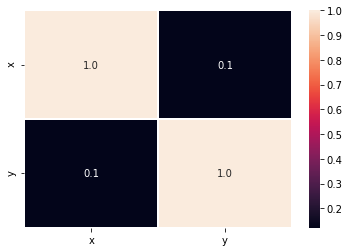

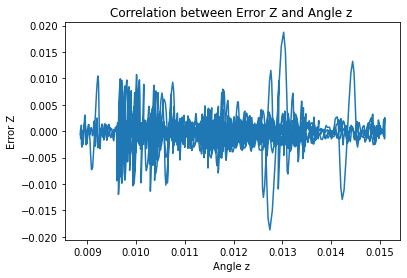

[[1.         0.00755315]
 [0.00755315 1.        ]]


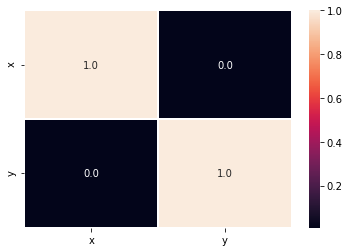

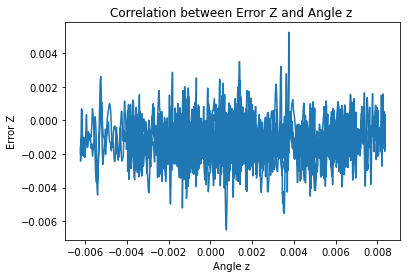

[[1.         0.03585022]
 [0.03585022 1.        ]]


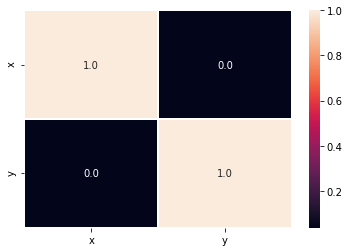

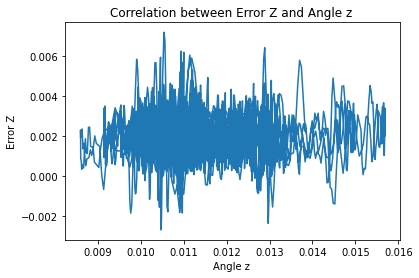

[[1.        0.0097025]
 [0.0097025 1.       ]]


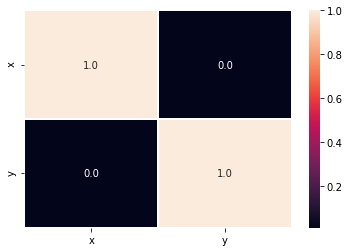

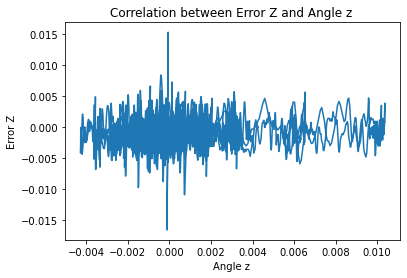

[[1.         0.08011774]
 [0.08011774 1.        ]]


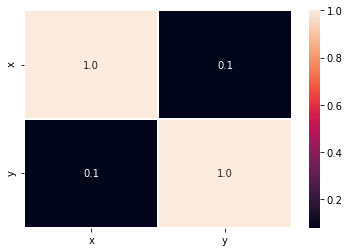

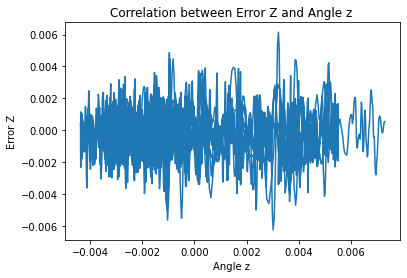

[[ 1.        -0.0244747]
 [-0.0244747  1.       ]]


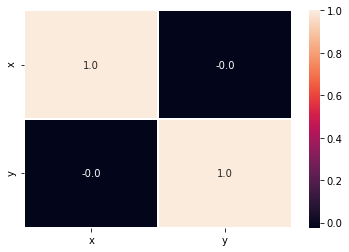

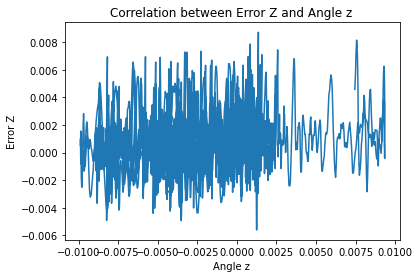

[[1.         0.15450748]
 [0.15450748 1.        ]]


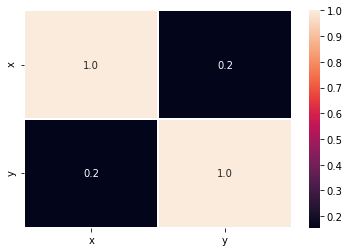

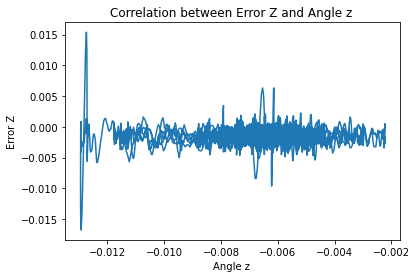

[[ 1.00000000e+00 -8.46659809e-04]
 [-8.46659809e-04  1.00000000e+00]]


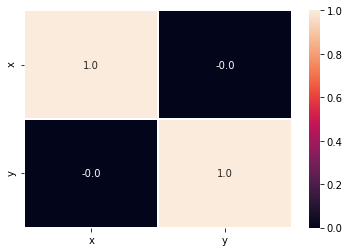

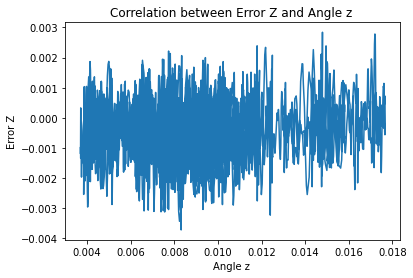

[[1.         0.09048861]
 [0.09048861 1.        ]]


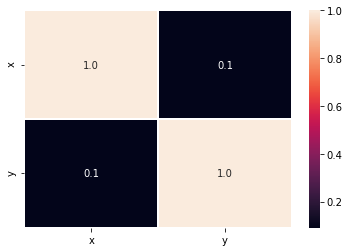

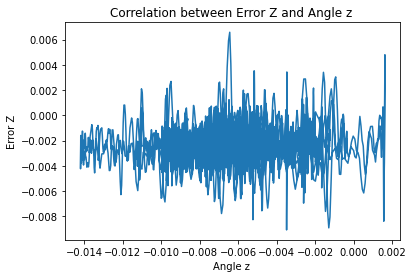

[[1.         0.09312564]
 [0.09312564 1.        ]]


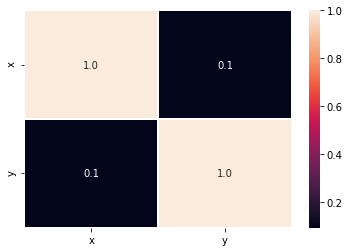

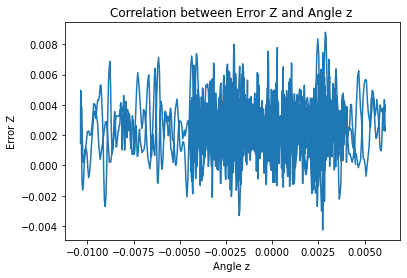

[[1.         0.01002997]
 [0.01002997 1.        ]]


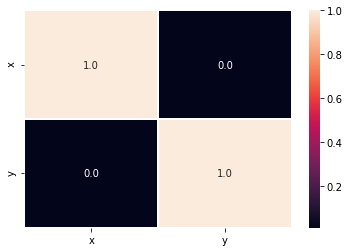

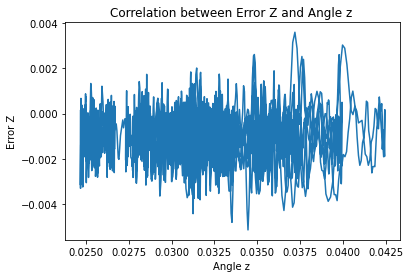

[[1.         0.00886766]
 [0.00886766 1.        ]]


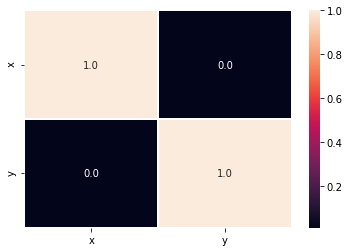

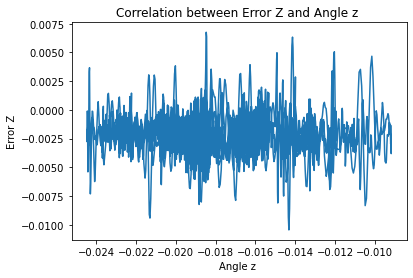

[[ 1.         -0.01912025]
 [-0.01912025  1.        ]]


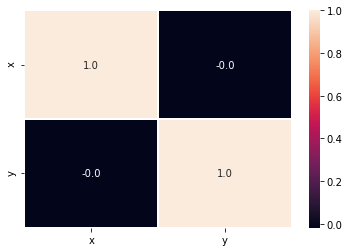

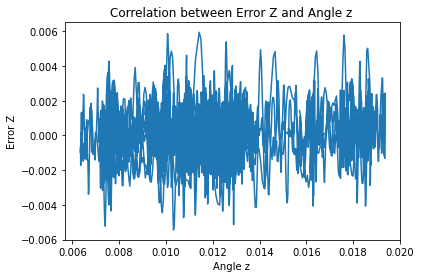

[[1.        0.1016939]
 [0.1016939 1.       ]]


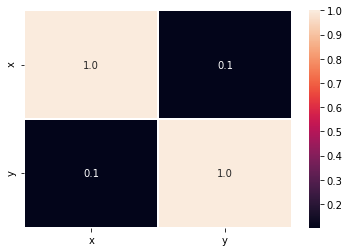

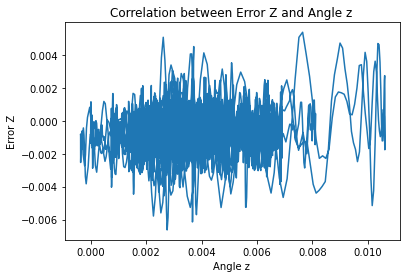

[[1.         0.11977621]
 [0.11977621 1.        ]]


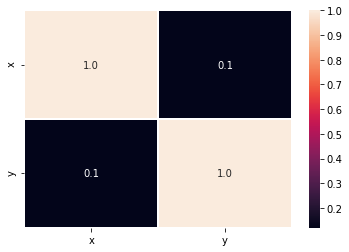

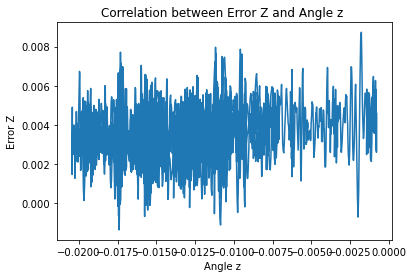

[[1.         0.17874624]
 [0.17874624 1.        ]]


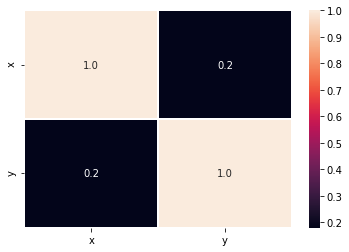

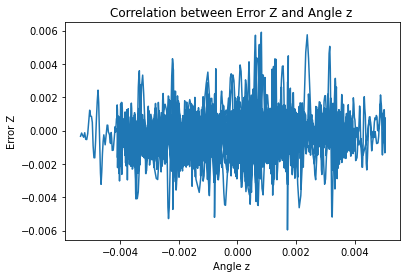

[[1.         0.08676413]
 [0.08676413 1.        ]]


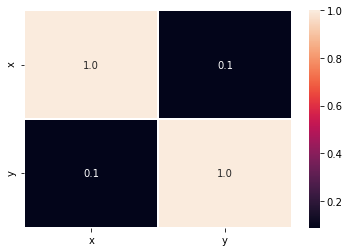

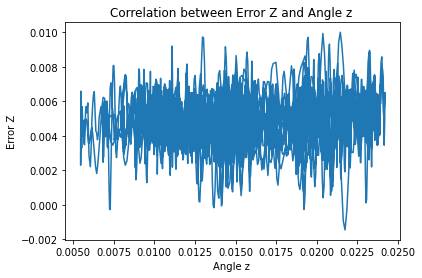

[[1.         0.09306422]
 [0.09306422 1.        ]]


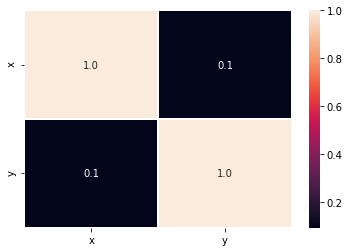

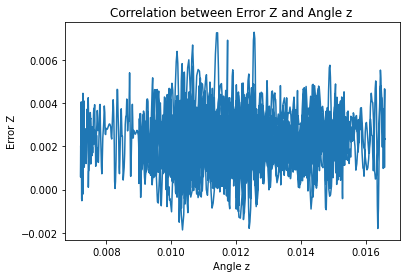

[[1.         0.02413388]
 [0.02413388 1.        ]]


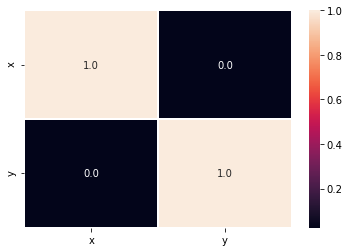

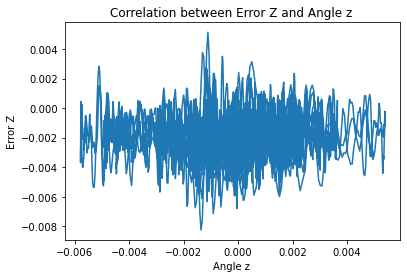

[[1.         0.04283474]
 [0.04283474 1.        ]]


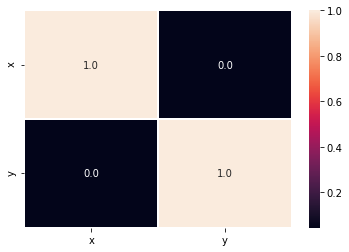

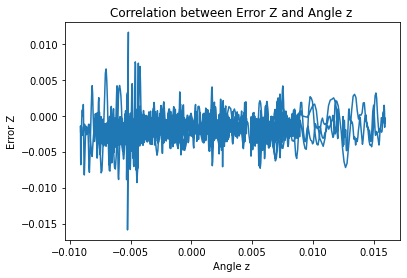

[[1.         0.13401191]
 [0.13401191 1.        ]]


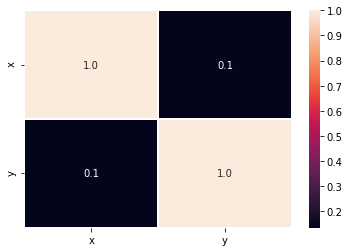

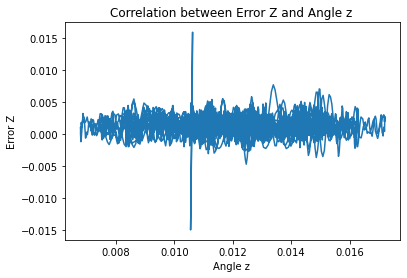

[[1.         0.01670516]
 [0.01670516 1.        ]]


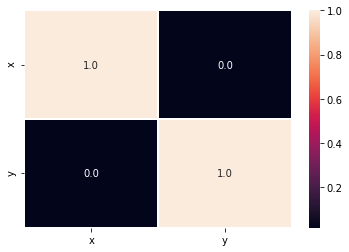

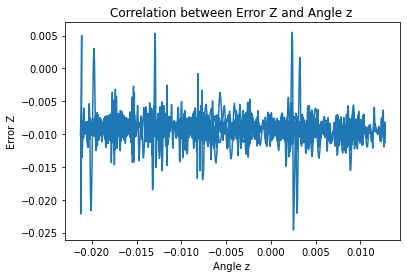

[[ 1.         -0.11186677]
 [-0.11186677  1.        ]]


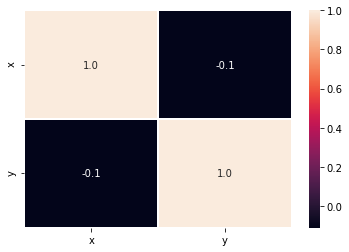

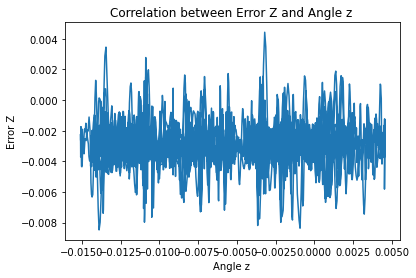

[[ 1.         -0.01209973]
 [-0.01209973  1.        ]]


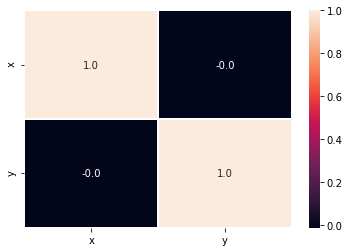

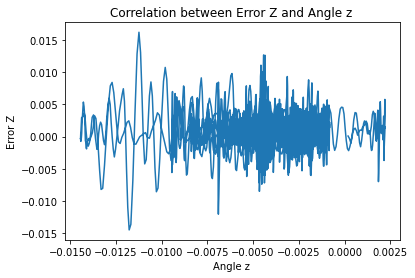

[[ 1.         -0.00257905]
 [-0.00257905  1.        ]]


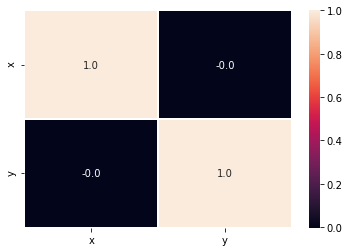

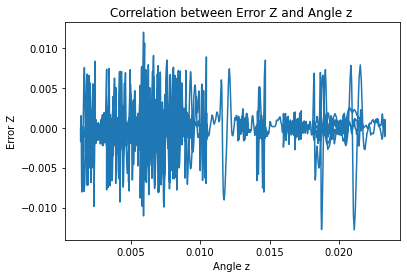

[[1.         0.08154769]
 [0.08154769 1.        ]]


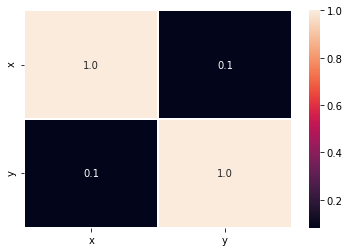

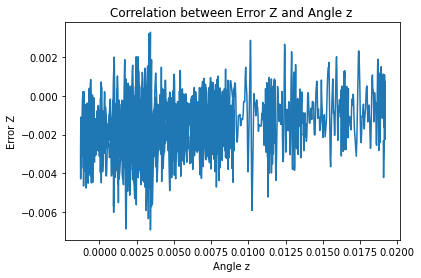

[[1.         0.30387962]
 [0.30387962 1.        ]]


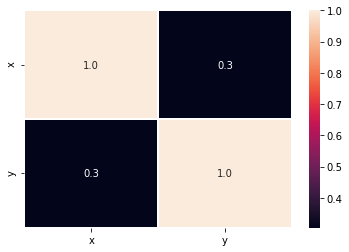

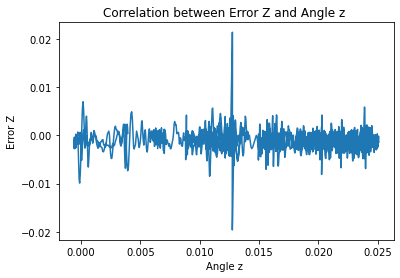

[[ 1.         -0.11828432]
 [-0.11828432  1.        ]]


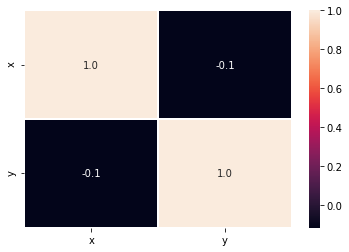

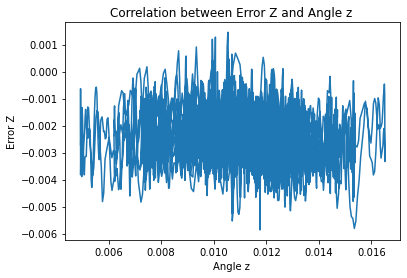

[[ 1.         -0.11831861]
 [-0.11831861  1.        ]]


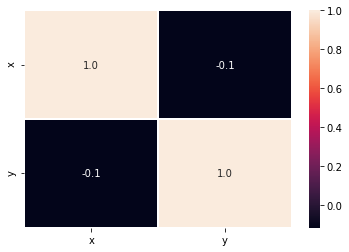

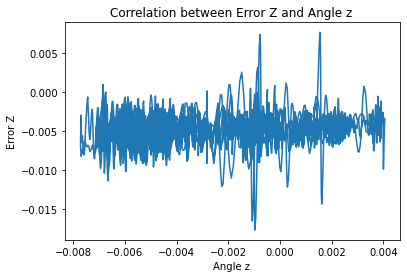

[[1.         0.15026686]
 [0.15026686 1.        ]]


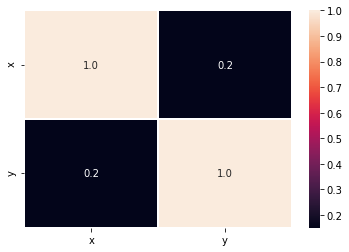

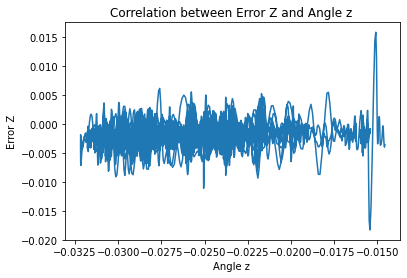

[[1.         0.13572733]
 [0.13572733 1.        ]]


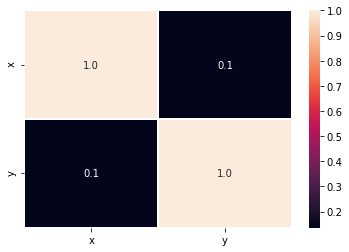

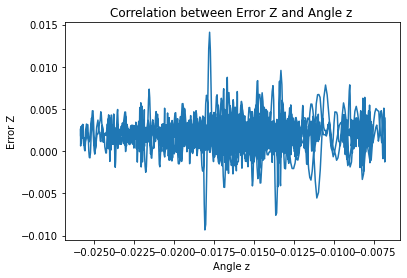

[[1.         0.02650007]
 [0.02650007 1.        ]]


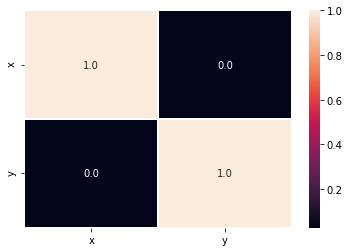

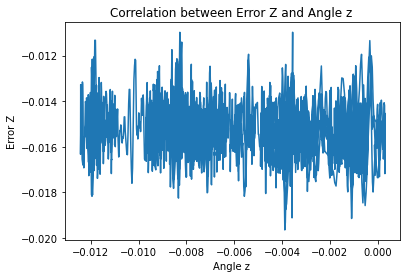

[[ 1.         -0.13878911]
 [-0.13878911  1.        ]]


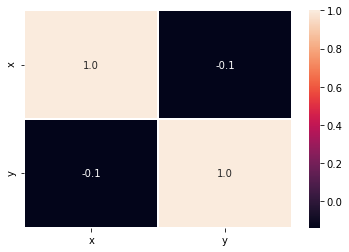

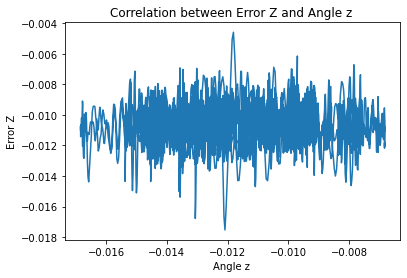

[[1.         0.03934565]
 [0.03934565 1.        ]]


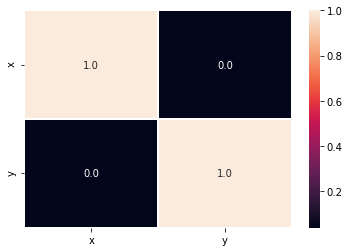

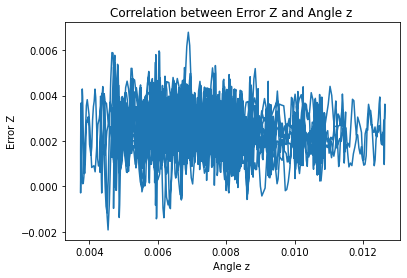

[[ 1.         -0.11252225]
 [-0.11252225  1.        ]]


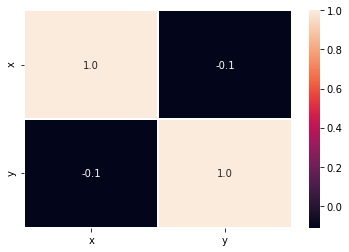

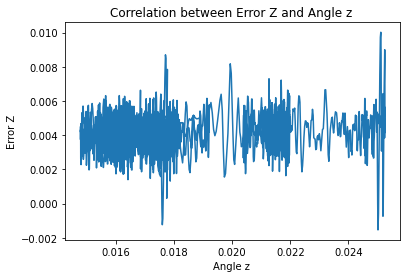

[[1.         0.12702855]
 [0.12702855 1.        ]]


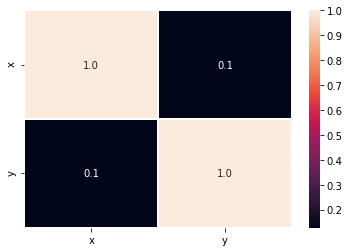

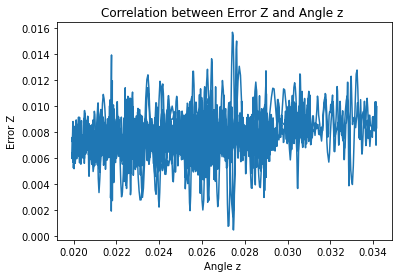

[[1.         0.24980363]
 [0.24980363 1.        ]]


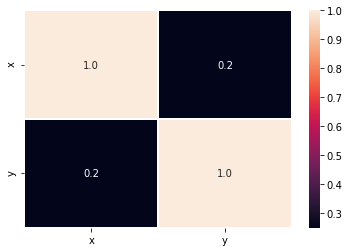

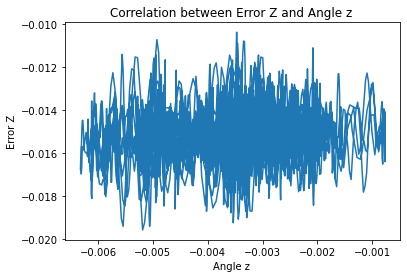

[[1.         0.10106188]
 [0.10106188 1.        ]]


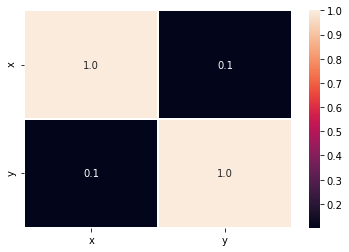

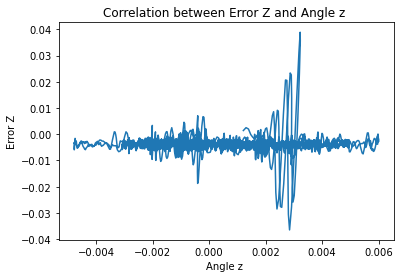

[[ 1.        -0.0050861]
 [-0.0050861  1.       ]]


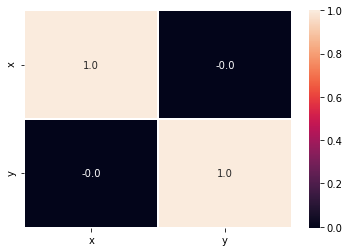

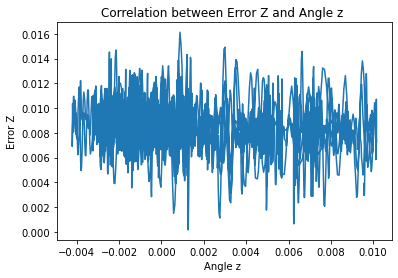

[[ 1.         -0.18597477]
 [-0.18597477  1.        ]]


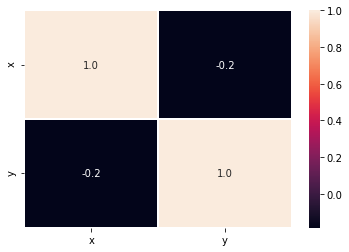

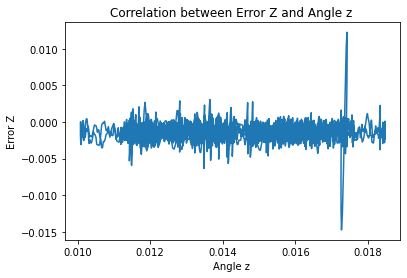

[[1.         0.03182942]
 [0.03182942 1.        ]]


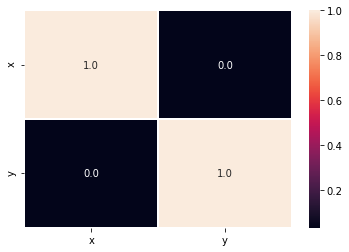

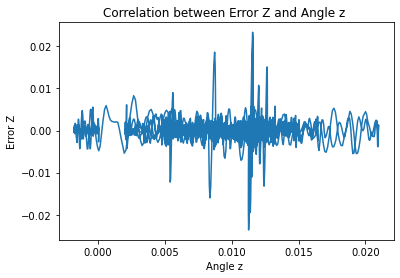

[[ 1.         -0.00699313]
 [-0.00699313  1.        ]]


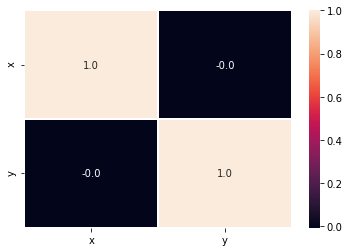

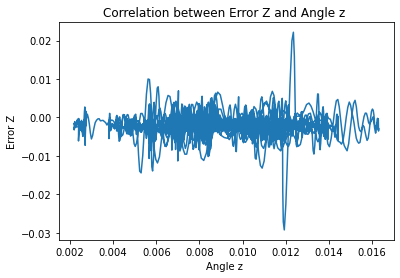

[[1.         0.00203129]
 [0.00203129 1.        ]]


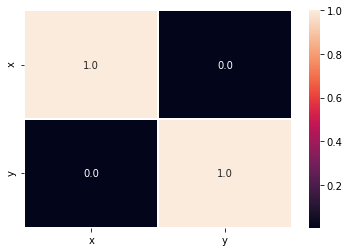

In [22]:
for s in range(1,50):
    plt.figure()
    plt.plot(matrizangz[s-1,:],errorZ[s-1,:])
    plt.xlabel("Angle z ")
    plt.ylabel("Error Z")
    plt.title("Correlation between Error Z and Angle z ")
    plt.show()

    r=np.corrcoef(matrizangz[s-1,:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':matrizangz[s-1,:],
          'y': errorZ[s-1,:]
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

# Error in function of trigonometry

We are going to correlate the error found with the trigonometry angle x and z. If the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice that the number of correlation approaches -1, inidicating a negative correlation betweem them, for the errorz and trigonometry of the anglez. With angle x it's possible to conclude that they dont correlate. 

## Error z and senx, cosx and tanx

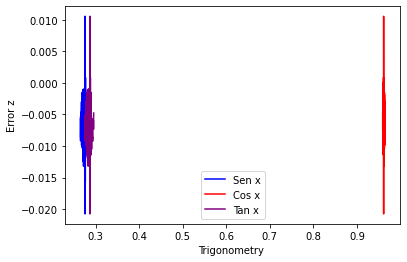

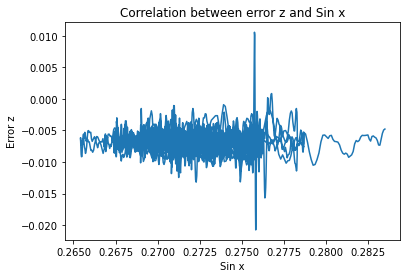

[[ 1.        -0.0340907]
 [-0.0340907  1.       ]]


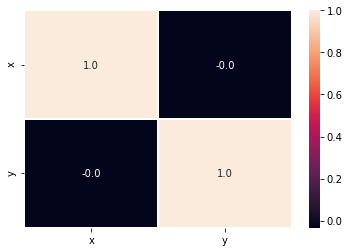

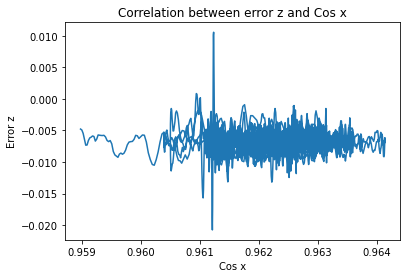

[[1.         0.03373587]
 [0.03373587 1.        ]]


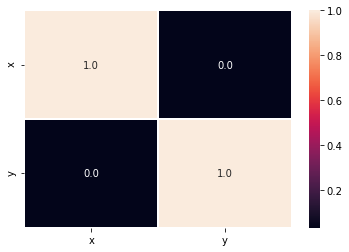

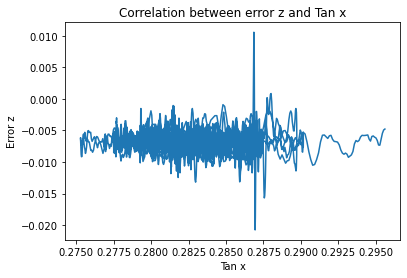

[[ 1.         -0.03401126]
 [-0.03401126  1.        ]]


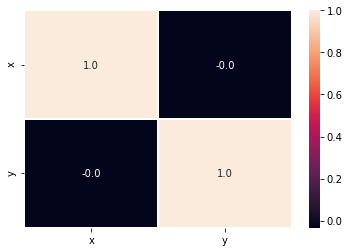

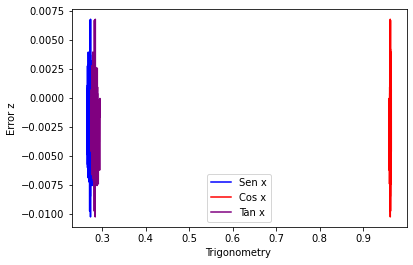

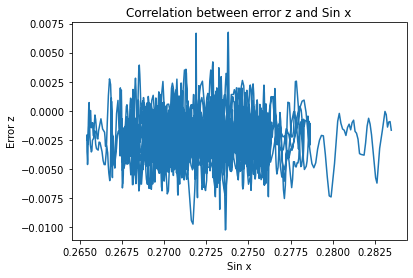

[[1.         0.00117718]
 [0.00117718 1.        ]]


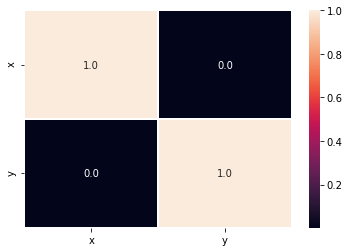

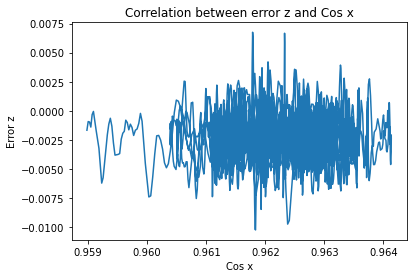

[[ 1.00000000e+00 -9.58726131e-04]
 [-9.58726131e-04  1.00000000e+00]]


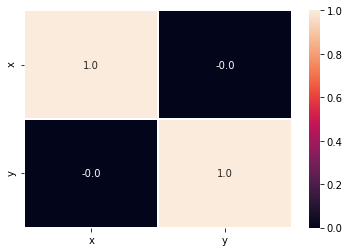

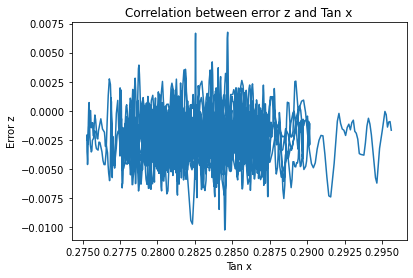

[[1.         0.00112843]
 [0.00112843 1.        ]]


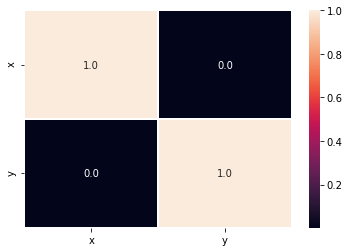

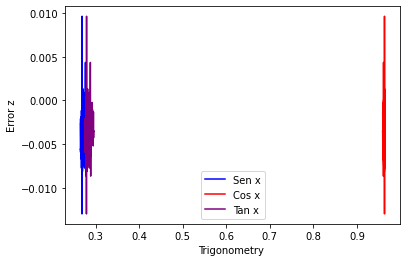

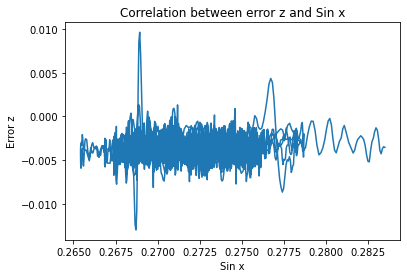

[[1.         0.06050998]
 [0.06050998 1.        ]]


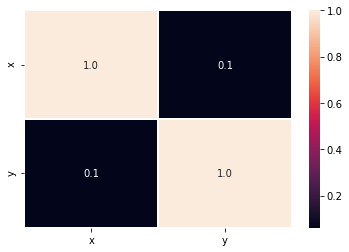

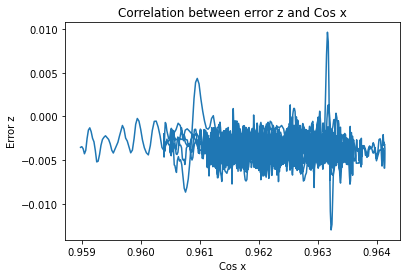

[[ 1.         -0.06093458]
 [-0.06093458  1.        ]]


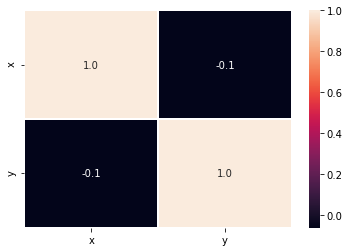

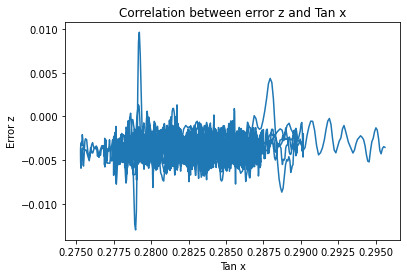

[[1.         0.06060593]
 [0.06060593 1.        ]]


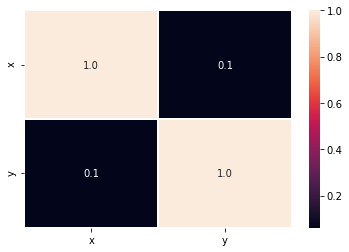

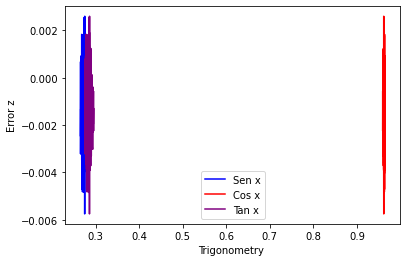

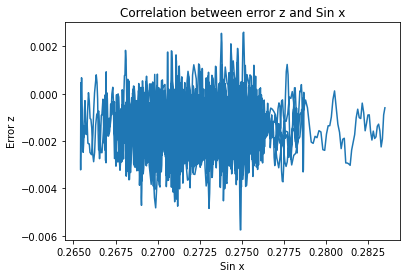

[[1.         0.04829793]
 [0.04829793 1.        ]]


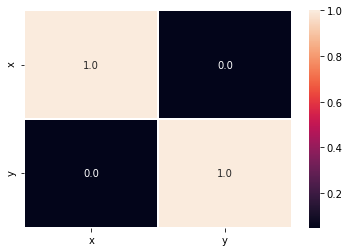

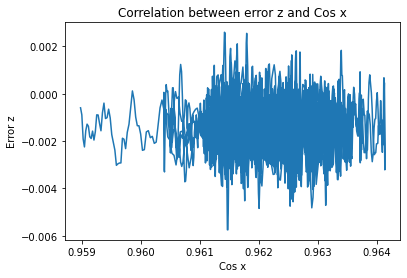

[[ 1.         -0.04818479]
 [-0.04818479  1.        ]]


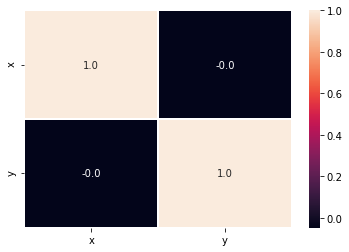

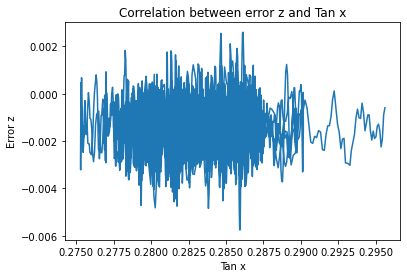

[[1.         0.04827229]
 [0.04827229 1.        ]]


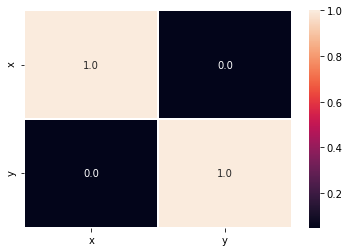

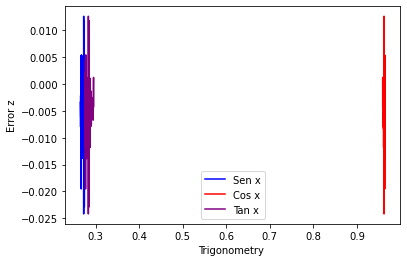

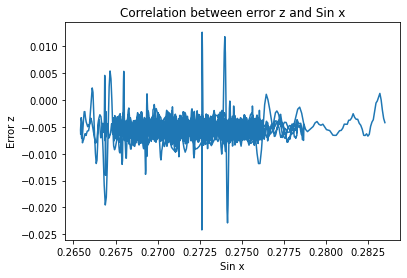

[[1.         0.01045081]
 [0.01045081 1.        ]]


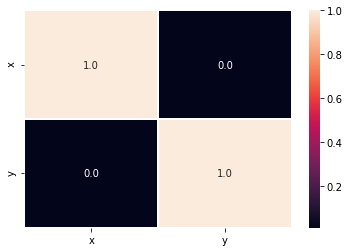

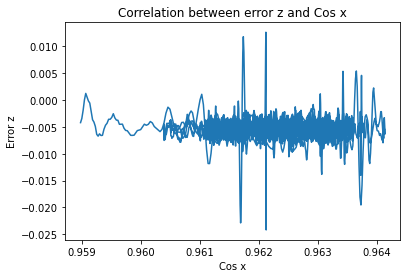

[[ 1.         -0.01092875]
 [-0.01092875  1.        ]]


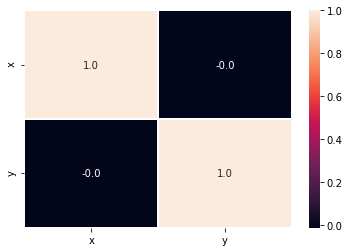

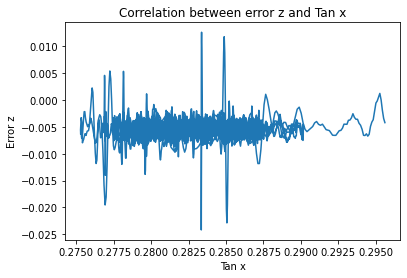

[[1.         0.01055854]
 [0.01055854 1.        ]]


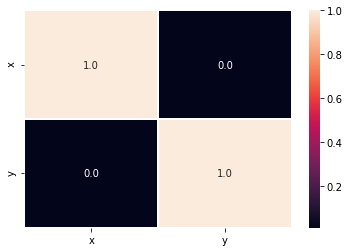

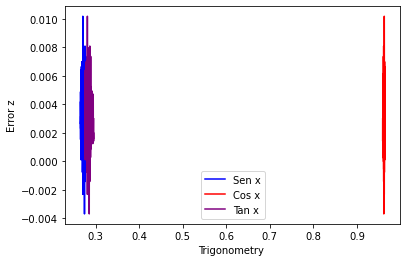

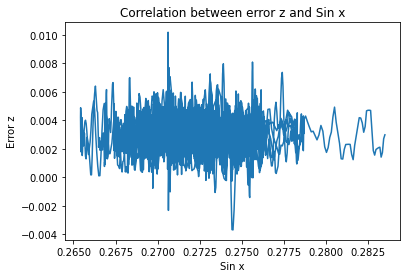

[[ 1.         -0.02422734]
 [-0.02422734  1.        ]]


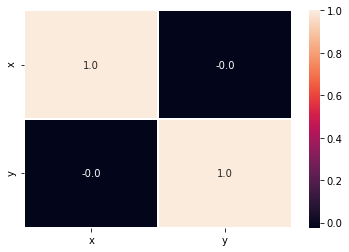

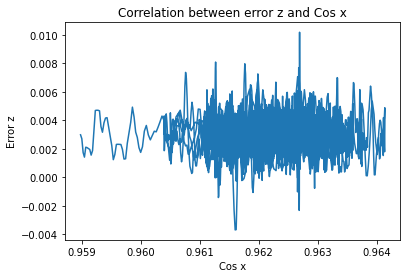

[[1.         0.02442219]
 [0.02442219 1.        ]]


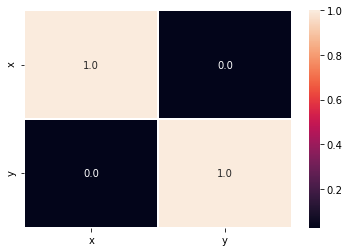

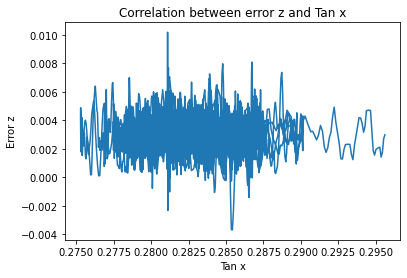

[[ 1.        -0.0242708]
 [-0.0242708  1.       ]]


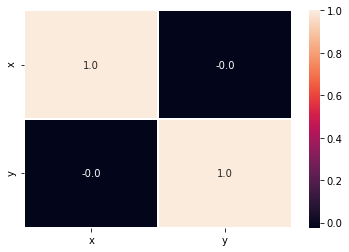

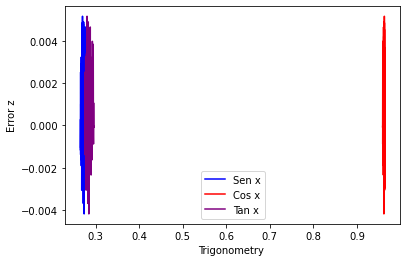

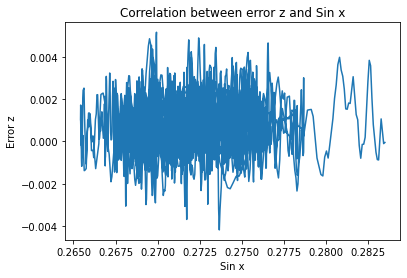

[[1.        0.0703426]
 [0.0703426 1.       ]]


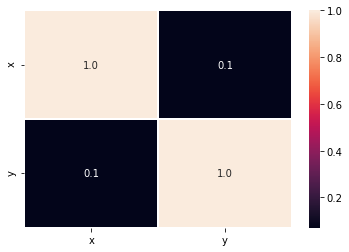

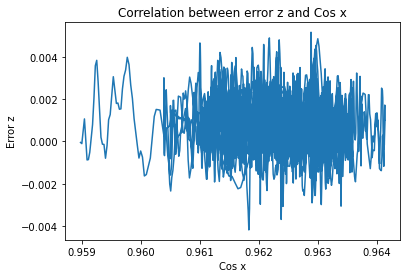

[[ 1.         -0.07014069]
 [-0.07014069  1.        ]]


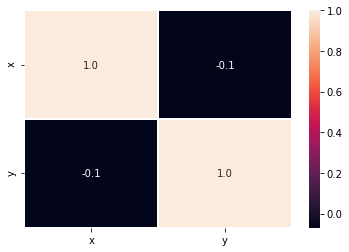

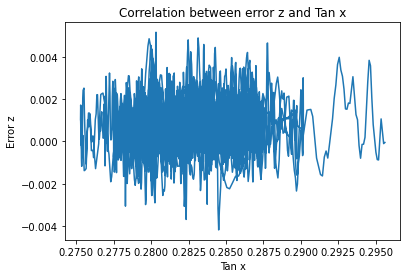

[[1.         0.07029781]
 [0.07029781 1.        ]]


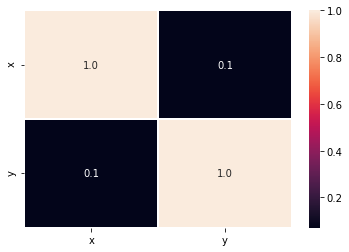

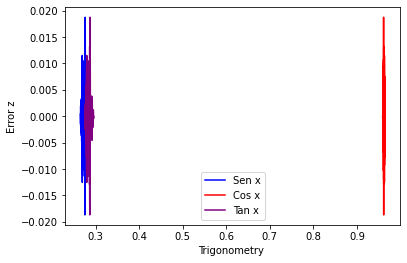

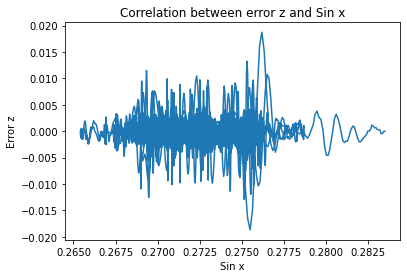

[[1.         0.00658762]
 [0.00658762 1.        ]]


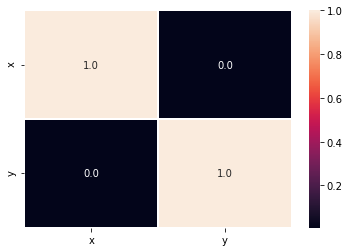

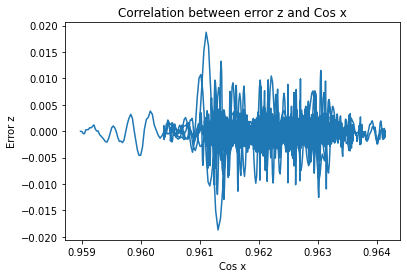

[[ 1.         -0.00663187]
 [-0.00663187  1.        ]]


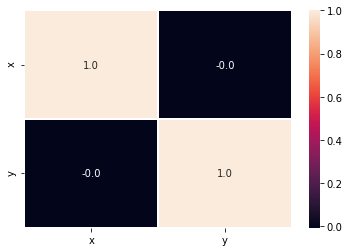

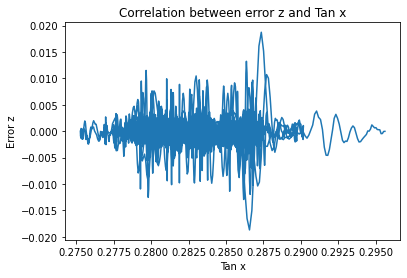

[[1.        0.0065976]
 [0.0065976 1.       ]]


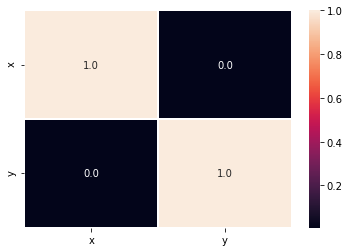

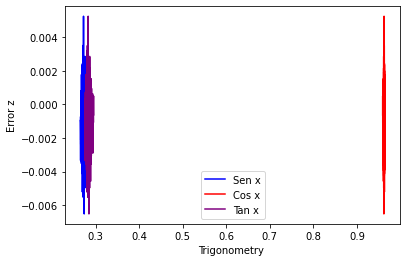

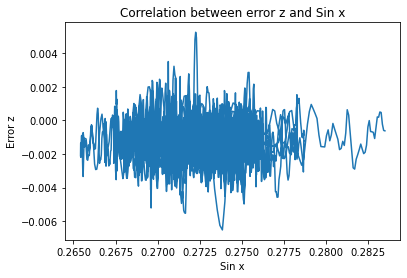

[[ 1.         -0.01084573]
 [-0.01084573  1.        ]]


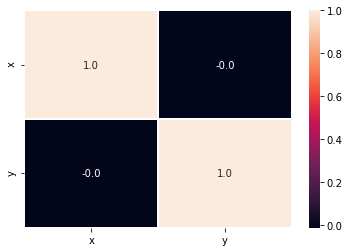

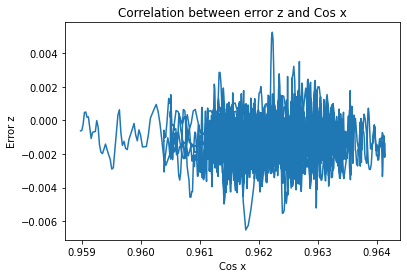

[[1.         0.01059399]
 [0.01059399 1.        ]]


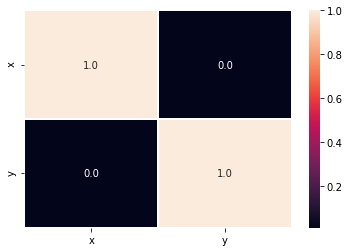

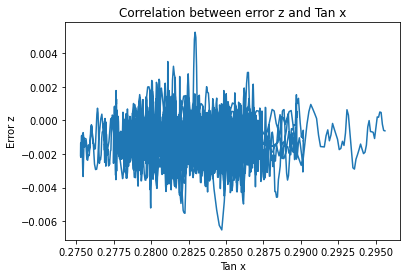

[[ 1.         -0.01078905]
 [-0.01078905  1.        ]]


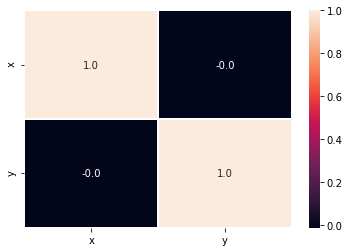

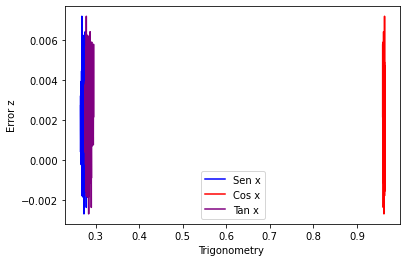

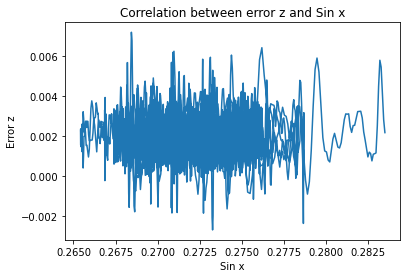

[[1.         0.01287919]
 [0.01287919 1.        ]]


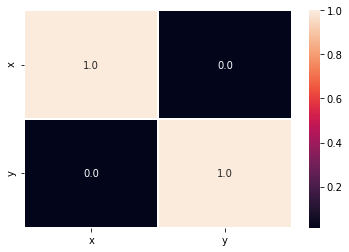

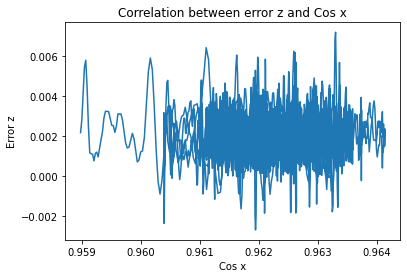

[[ 1.         -0.01308515]
 [-0.01308515  1.        ]]


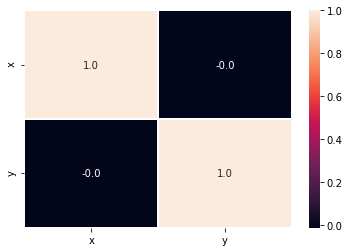

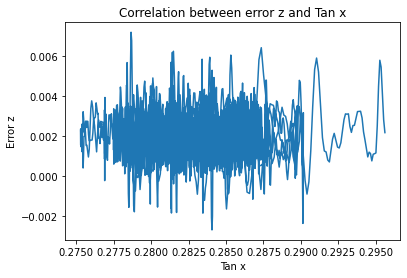

[[1.         0.01292541]
 [0.01292541 1.        ]]


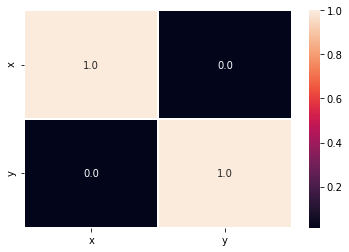

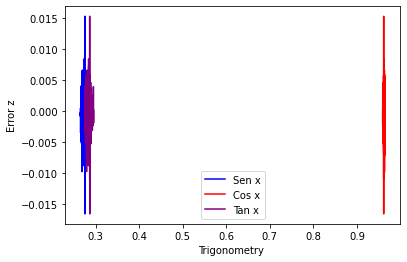

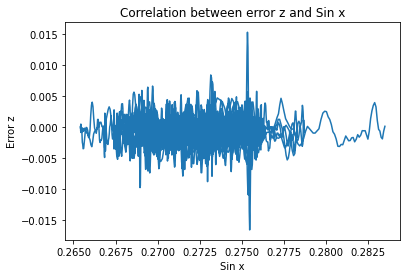

[[ 1.         -0.00407741]
 [-0.00407741  1.        ]]


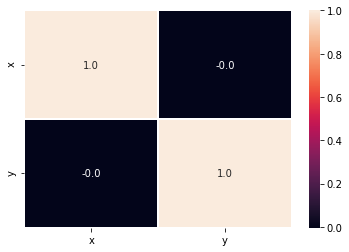

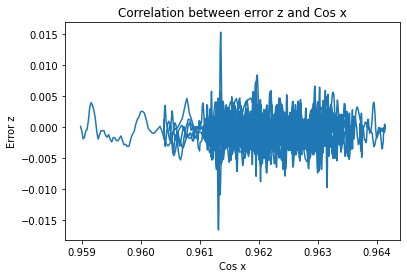

[[1.         0.00382399]
 [0.00382399 1.        ]]


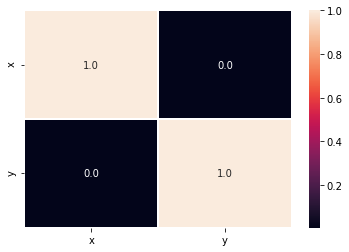

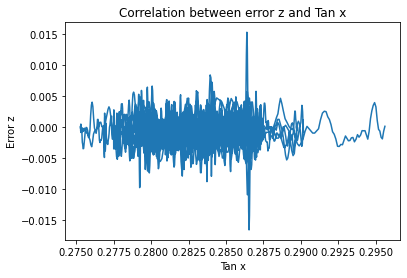

[[ 1.         -0.00402072]
 [-0.00402072  1.        ]]


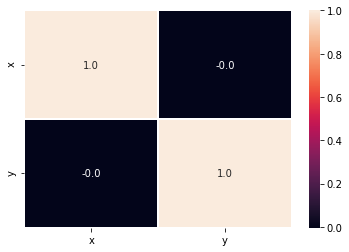

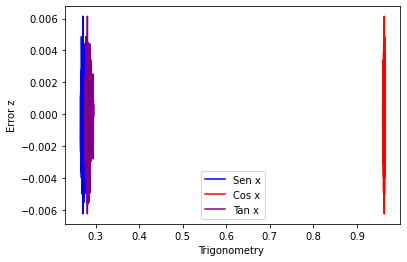

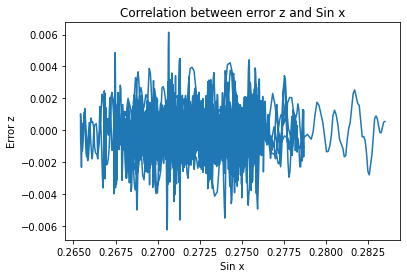

[[1.         0.01853116]
 [0.01853116 1.        ]]


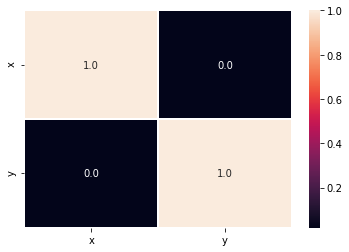

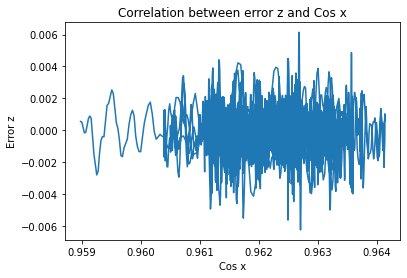

[[ 1.         -0.01850661]
 [-0.01850661  1.        ]]


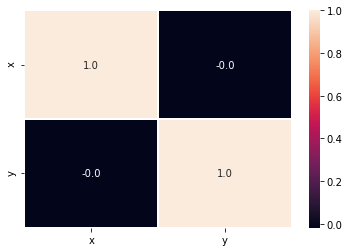

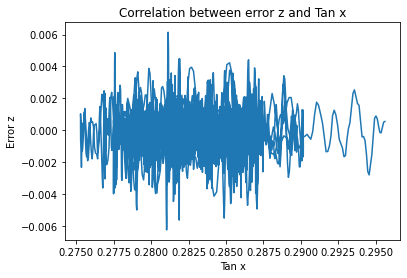

[[1.         0.01852593]
 [0.01852593 1.        ]]


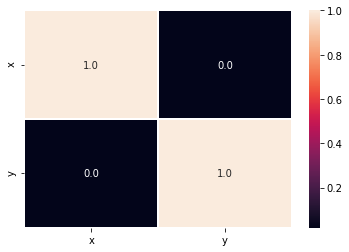

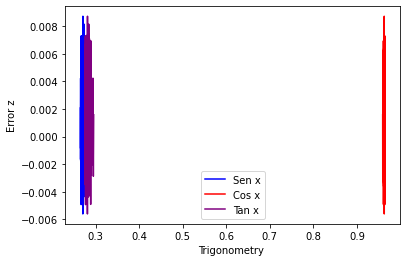

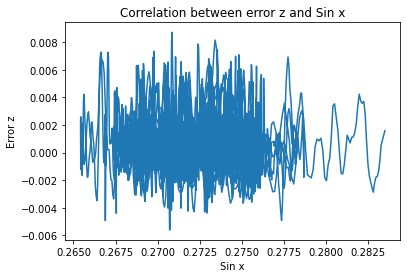

[[1.         0.00171506]
 [0.00171506 1.        ]]


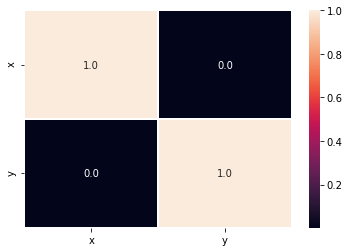

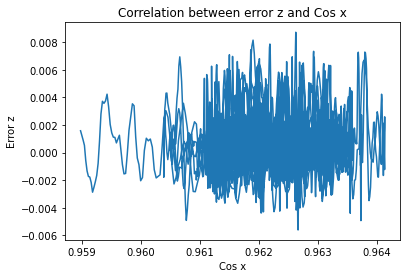

[[ 1.         -0.00159144]
 [-0.00159144  1.        ]]


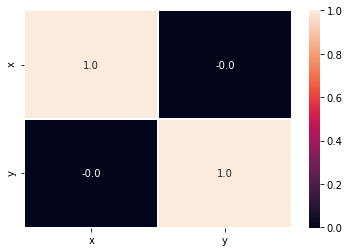

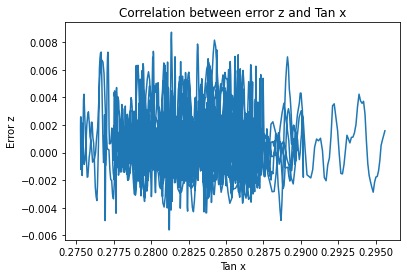

[[1.         0.00168702]
 [0.00168702 1.        ]]


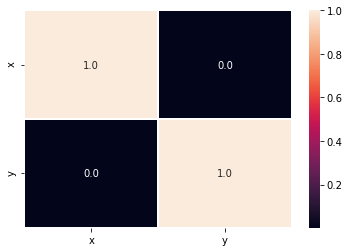

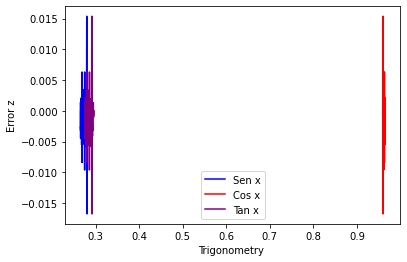

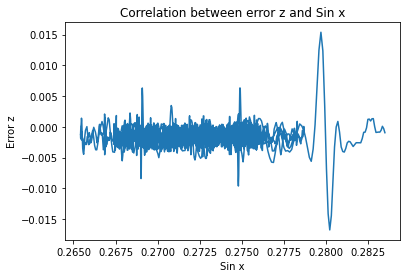

[[1.         0.01446287]
 [0.01446287 1.        ]]


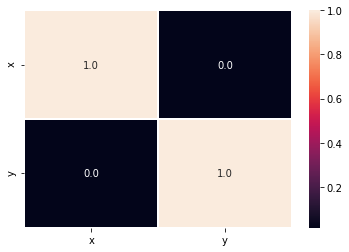

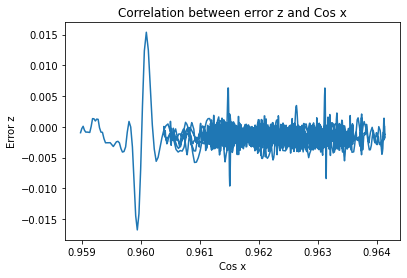

[[ 1.         -0.01454597]
 [-0.01454597  1.        ]]


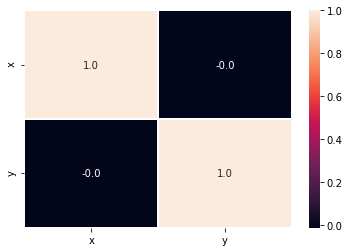

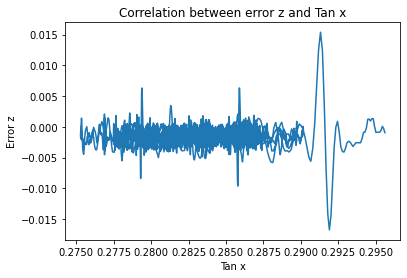

[[1.         0.01448167]
 [0.01448167 1.        ]]


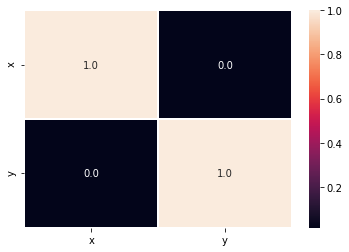

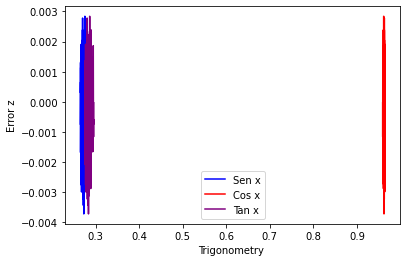

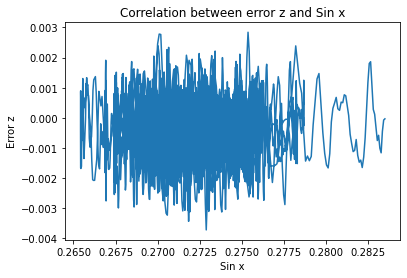

[[1.         0.02315825]
 [0.02315825 1.        ]]


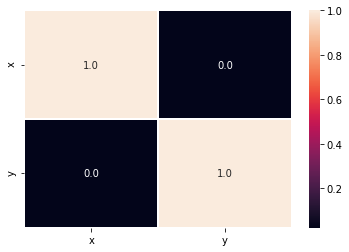

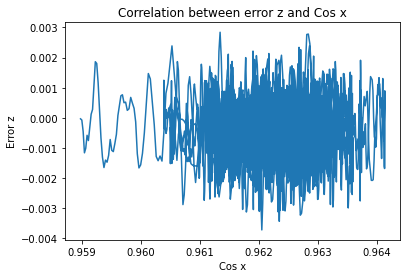

[[ 1.         -0.02354076]
 [-0.02354076  1.        ]]


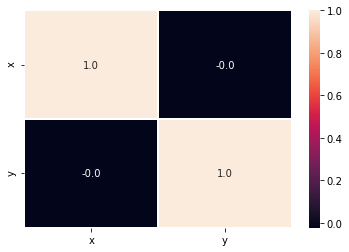

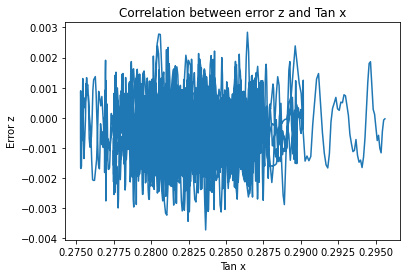

[[1.         0.02324368]
 [0.02324368 1.        ]]


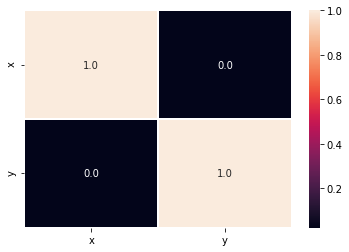

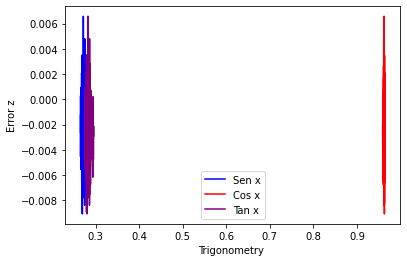

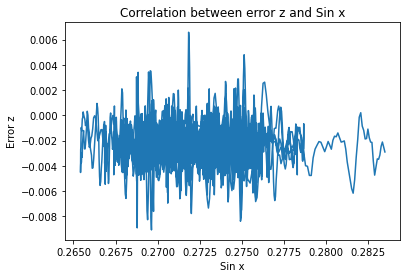

[[ 1.         -0.05341802]
 [-0.05341802  1.        ]]


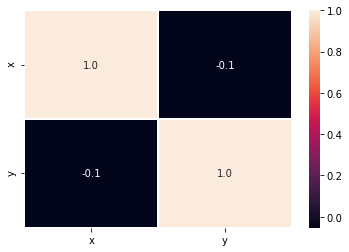

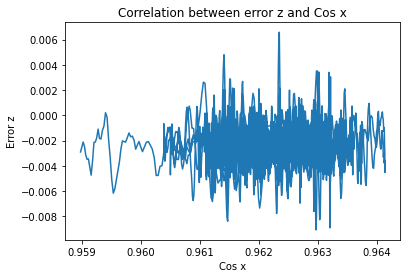

[[1.         0.05344287]
 [0.05344287 1.        ]]


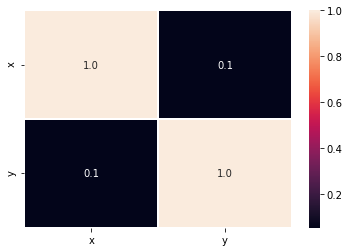

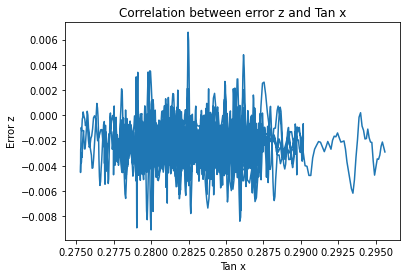

[[ 1.         -0.05342394]
 [-0.05342394  1.        ]]


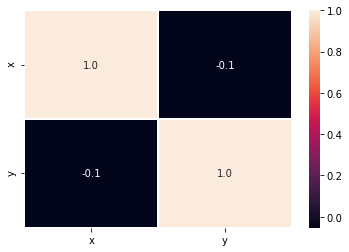

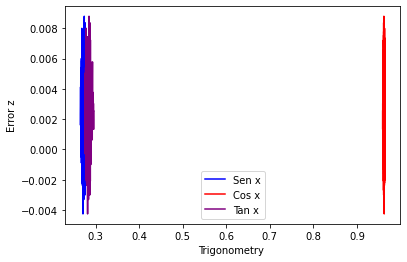

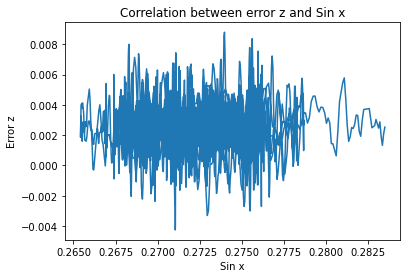

[[1.00000000e+00 5.23849474e-04]
 [5.23849474e-04 1.00000000e+00]]


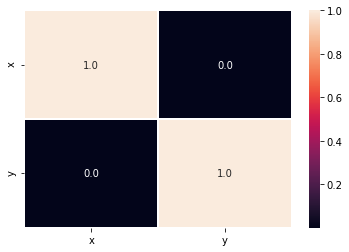

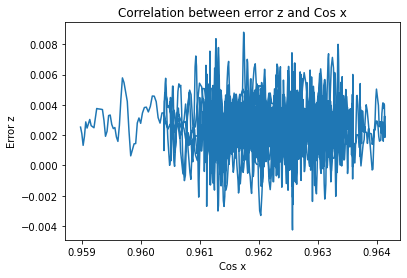

[[ 1.00000000e+00 -8.84058896e-04]
 [-8.84058896e-04  1.00000000e+00]]


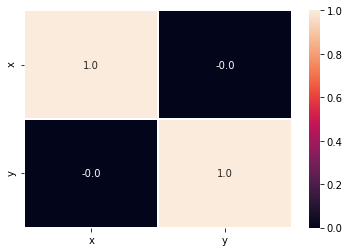

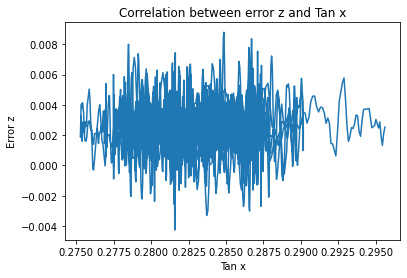

[[1.00000000e+00 6.04483834e-04]
 [6.04483834e-04 1.00000000e+00]]


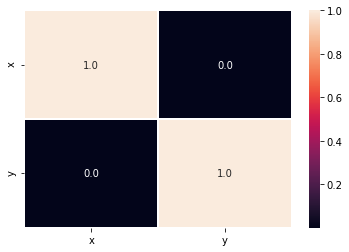

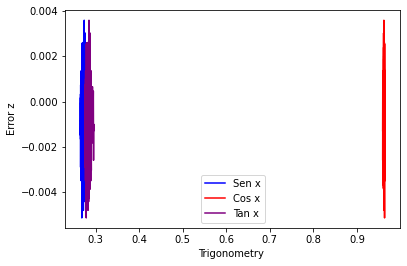

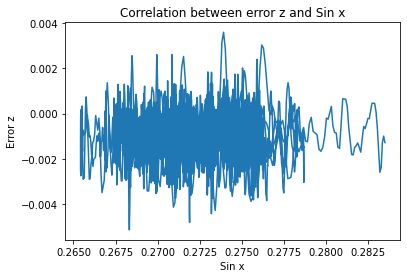

[[1.         0.03043541]
 [0.03043541 1.        ]]


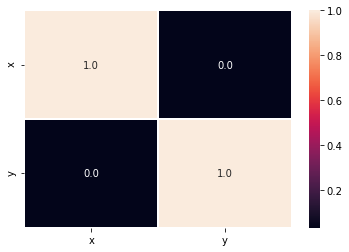

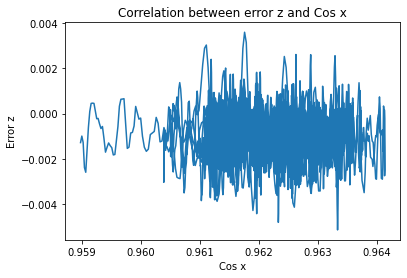

[[ 1.         -0.03041083]
 [-0.03041083  1.        ]]


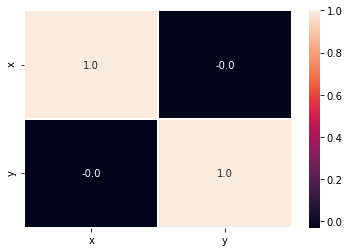

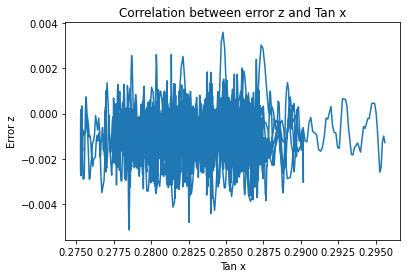

[[1.        0.0304303]
 [0.0304303 1.       ]]


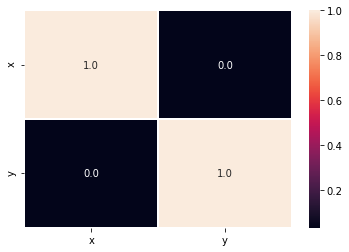

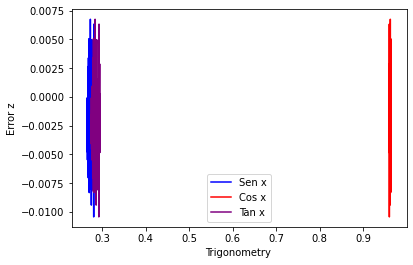

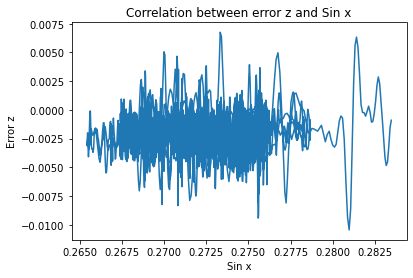

[[1.         0.01619699]
 [0.01619699 1.        ]]


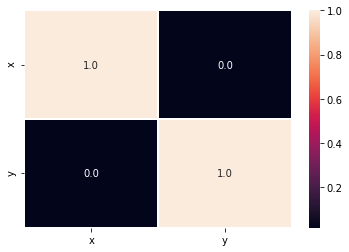

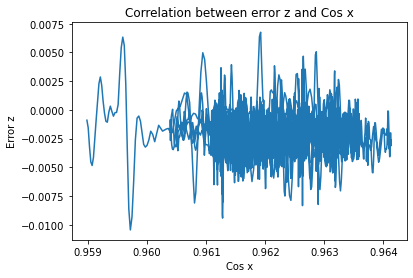

[[ 1.         -0.01676803]
 [-0.01676803  1.        ]]


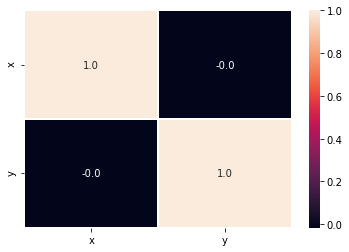

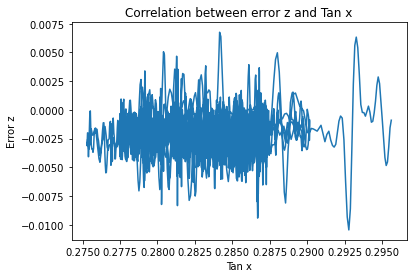

[[1.        0.0163259]
 [0.0163259 1.       ]]


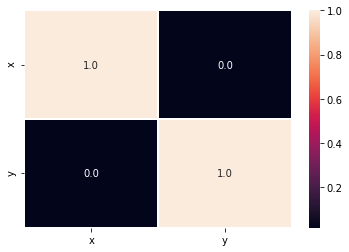

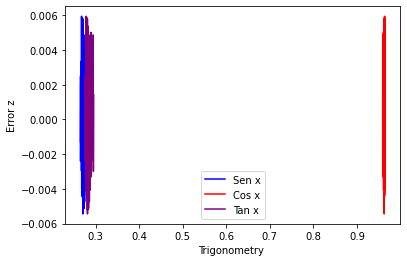

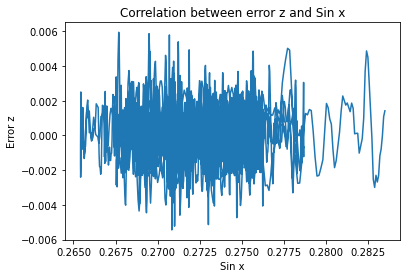

[[1.         0.00291025]
 [0.00291025 1.        ]]


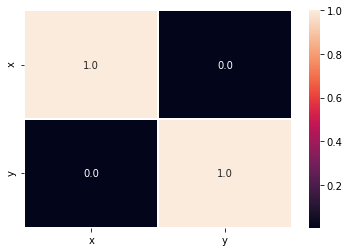

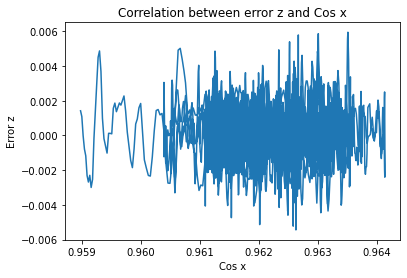

[[ 1.         -0.00329984]
 [-0.00329984  1.        ]]


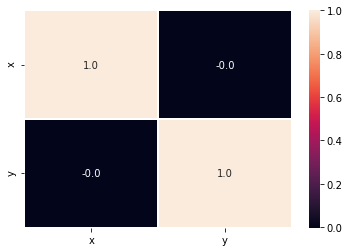

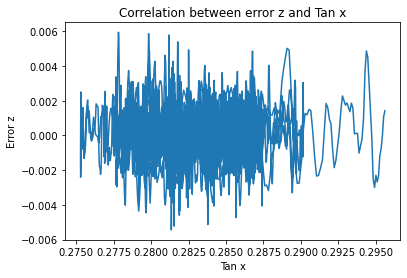

[[1.        0.0029973]
 [0.0029973 1.       ]]


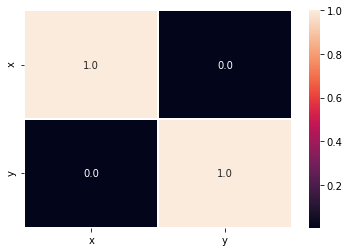

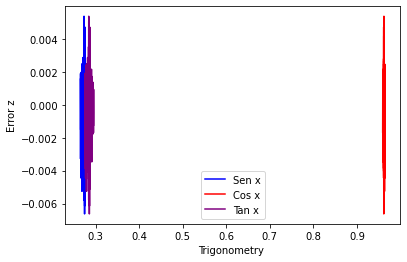

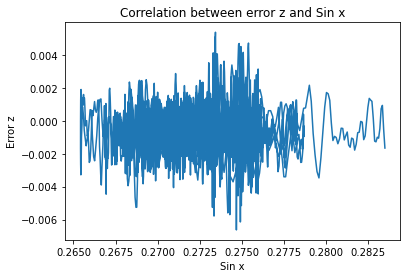

[[1.        0.0352603]
 [0.0352603 1.       ]]


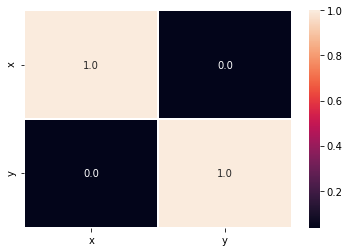

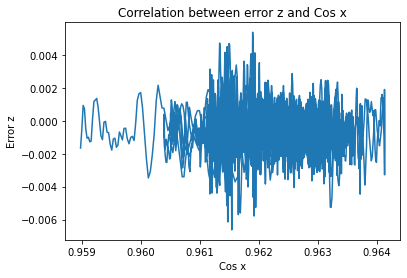

[[ 1.        -0.0352242]
 [-0.0352242  1.       ]]


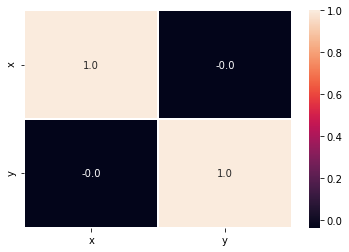

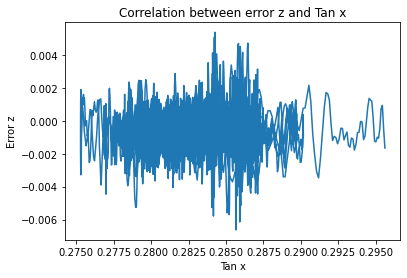

[[1.        0.0352523]
 [0.0352523 1.       ]]


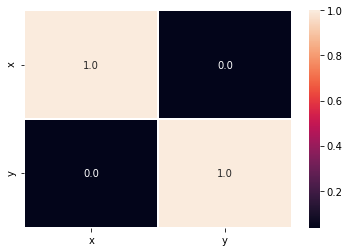

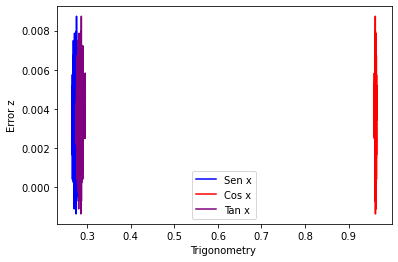

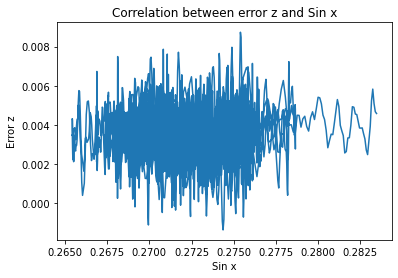

[[1.       0.011711]
 [0.011711 1.      ]]


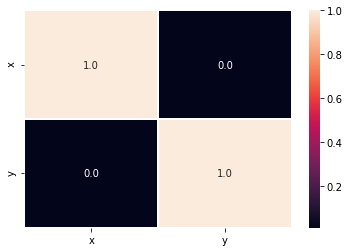

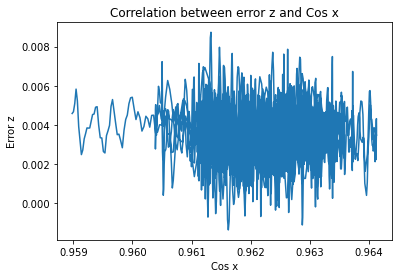

[[ 1.         -0.01226552]
 [-0.01226552  1.        ]]


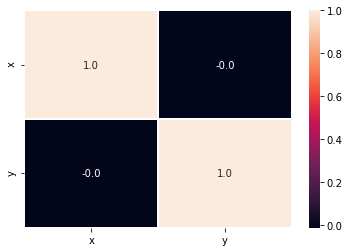

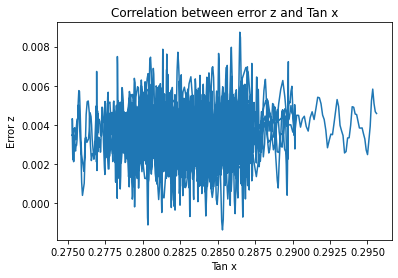

[[1.         0.01183566]
 [0.01183566 1.        ]]


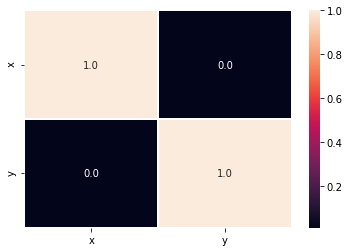

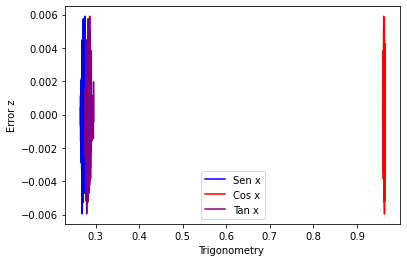

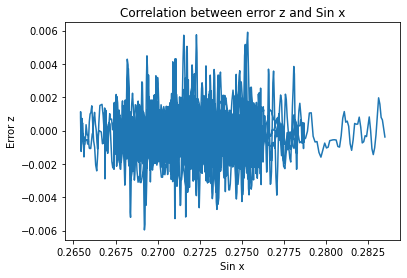

[[1.         0.01645222]
 [0.01645222 1.        ]]


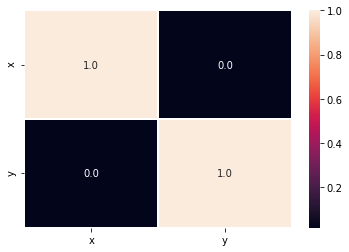

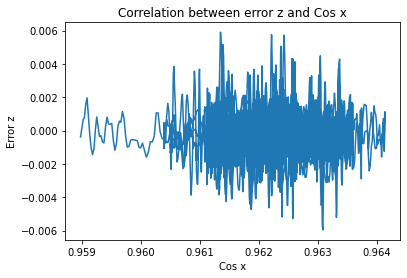

[[ 1.         -0.01662947]
 [-0.01662947  1.        ]]


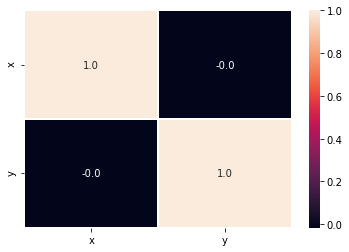

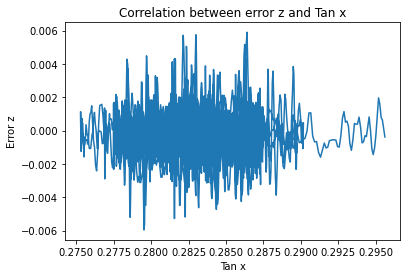

[[1.         0.01649201]
 [0.01649201 1.        ]]


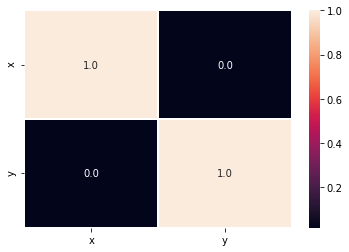

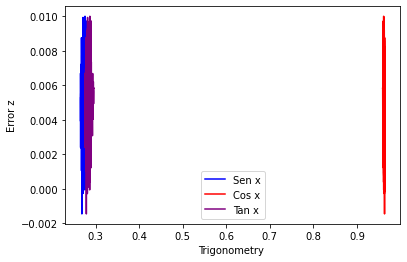

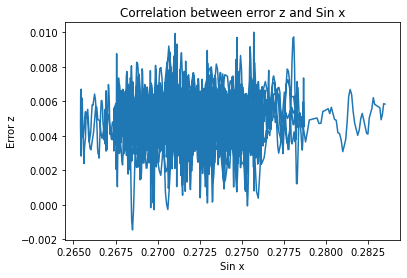

[[1.         0.02303683]
 [0.02303683 1.        ]]


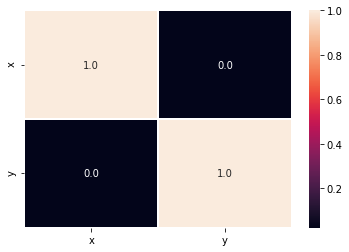

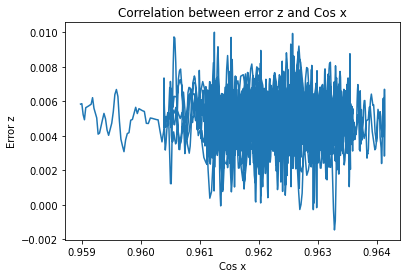

[[ 1.         -0.02323901]
 [-0.02323901  1.        ]]


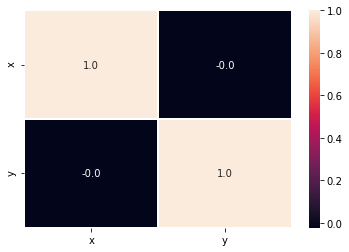

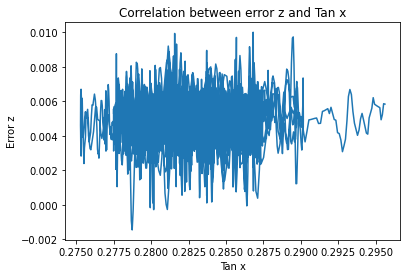

[[1.         0.02308253]
 [0.02308253 1.        ]]


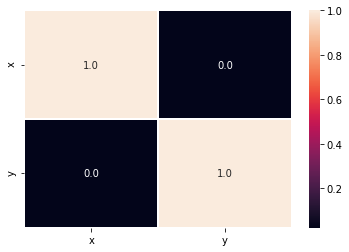

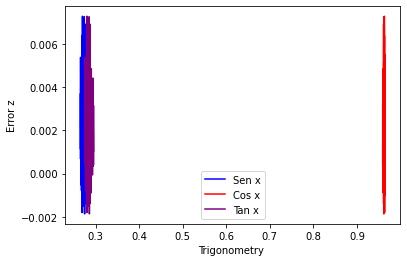

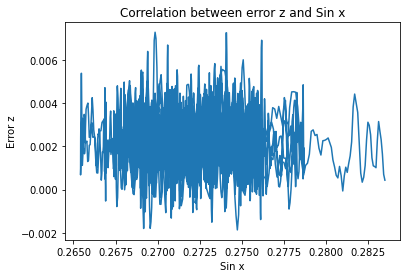

[[ 1.        -0.0216028]
 [-0.0216028  1.       ]]


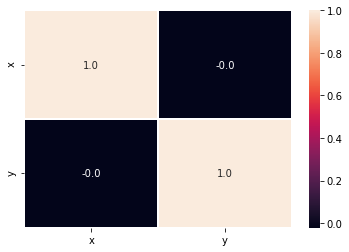

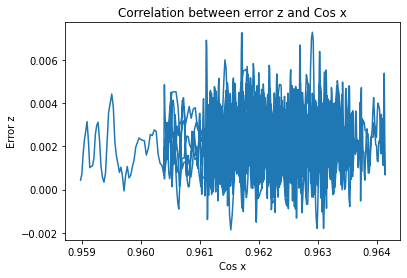

[[1.         0.02182314]
 [0.02182314 1.        ]]


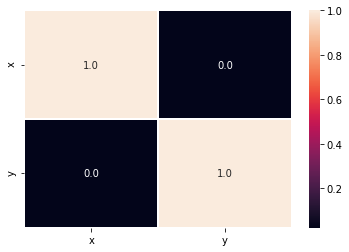

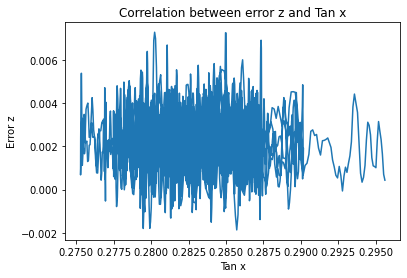

[[ 1.         -0.02165255]
 [-0.02165255  1.        ]]


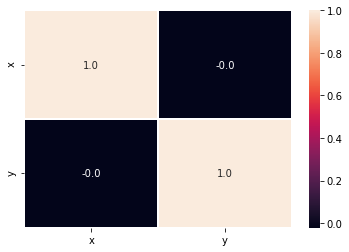

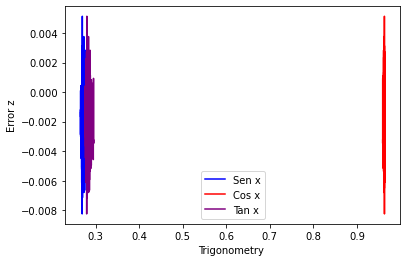

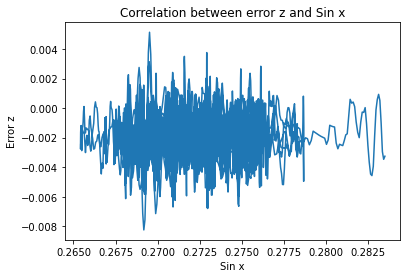

[[1.         0.00755519]
 [0.00755519 1.        ]]


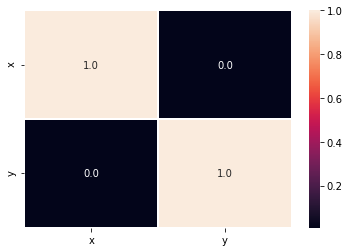

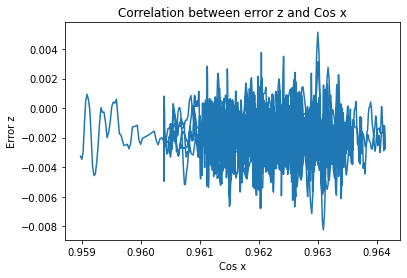

[[ 1.         -0.00779578]
 [-0.00779578  1.        ]]


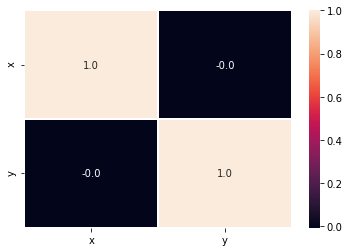

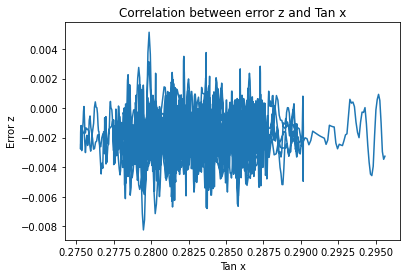

[[1.         0.00760909]
 [0.00760909 1.        ]]


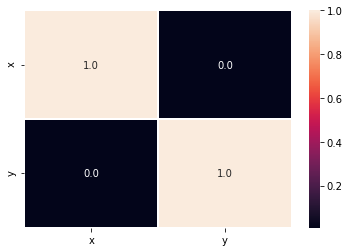

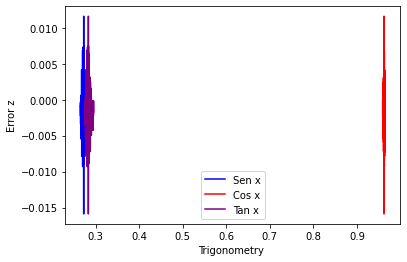

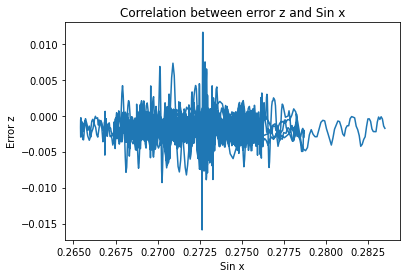

[[ 1.         -0.00300641]
 [-0.00300641  1.        ]]


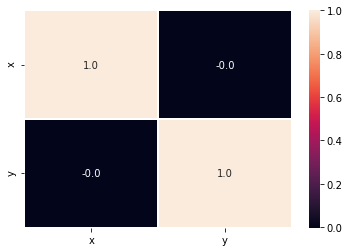

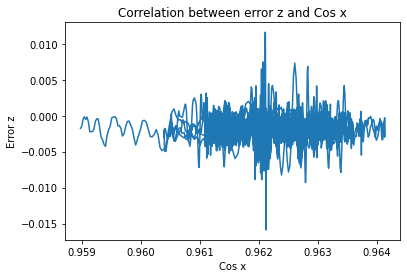

[[1.         0.00288402]
 [0.00288402 1.        ]]


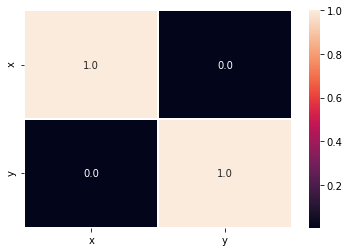

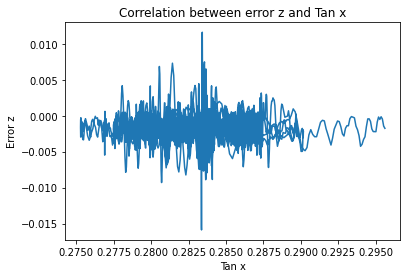

[[ 1.         -0.00297915]
 [-0.00297915  1.        ]]


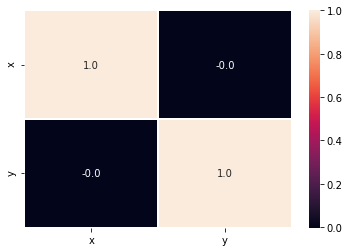

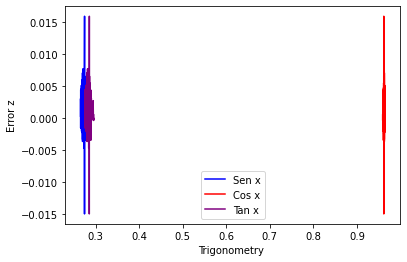

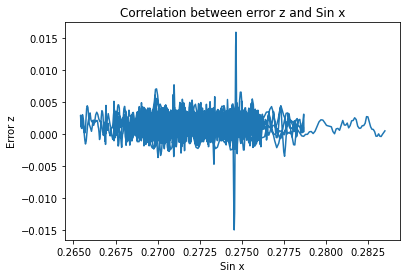

[[ 1.         -0.00847769]
 [-0.00847769  1.        ]]


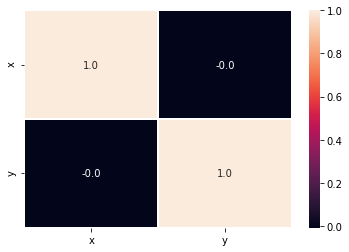

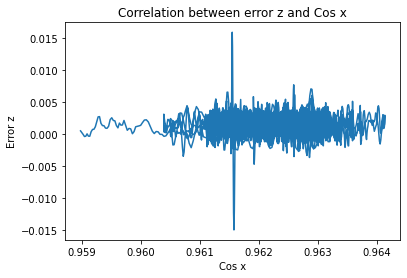

[[1.         0.00861774]
 [0.00861774 1.        ]]


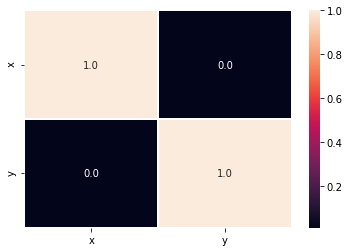

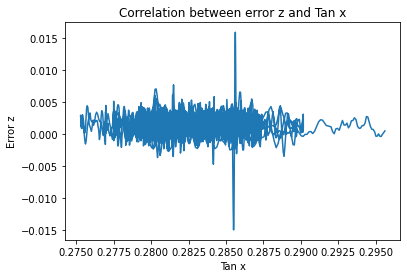

[[ 1.         -0.00850953]
 [-0.00850953  1.        ]]


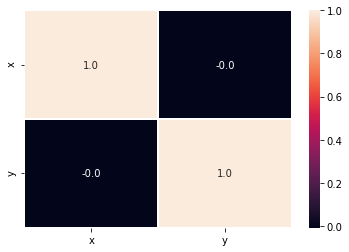

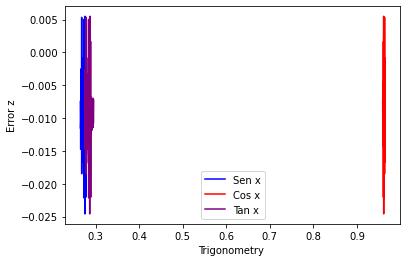

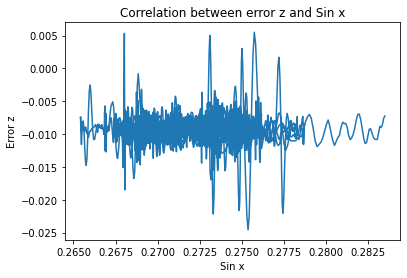

[[ 1.         -0.00652187]
 [-0.00652187  1.        ]]


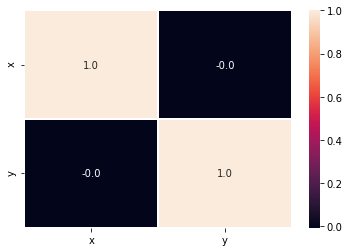

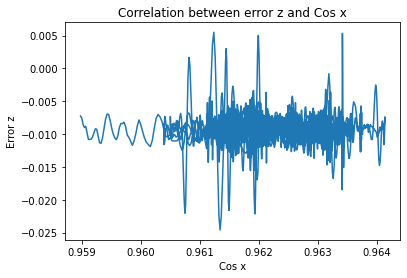

[[1.         0.00681194]
 [0.00681194 1.        ]]


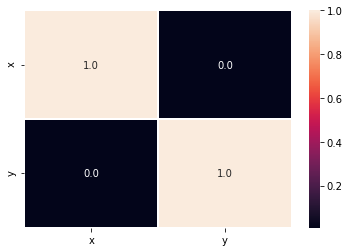

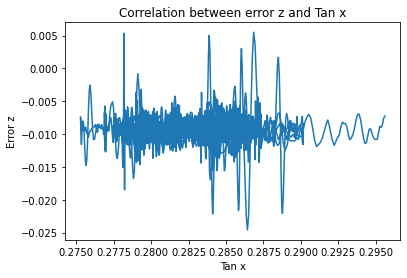

[[ 1.         -0.00658683]
 [-0.00658683  1.        ]]


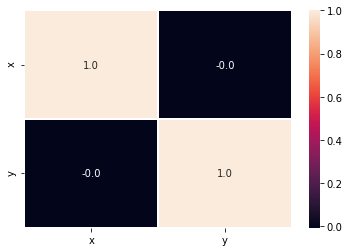

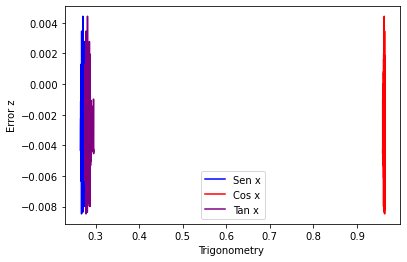

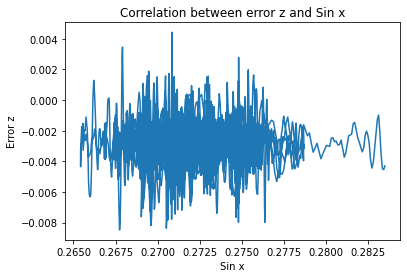

[[ 1.         -0.01057964]
 [-0.01057964  1.        ]]


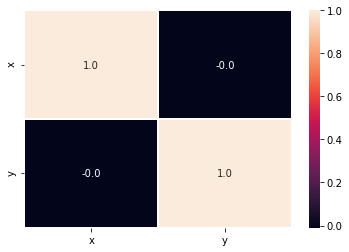

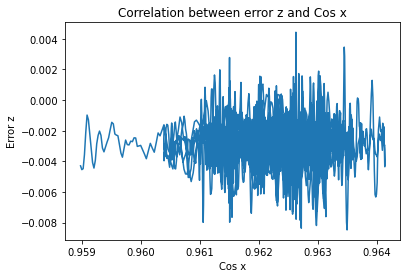

[[1.         0.01044139]
 [0.01044139 1.        ]]


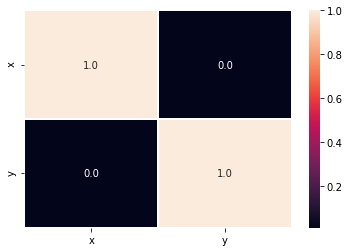

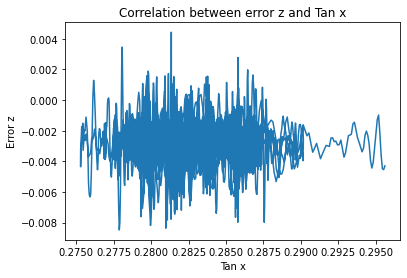

[[ 1.         -0.01054911]
 [-0.01054911  1.        ]]


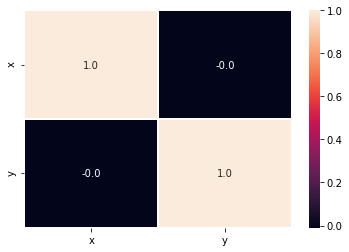

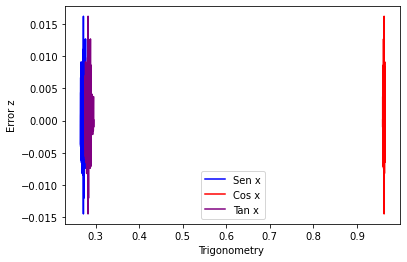

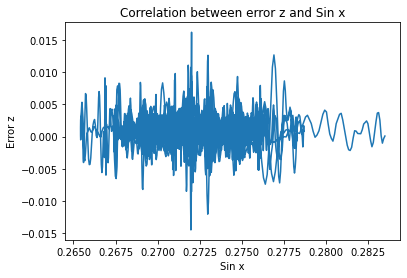

[[ 1.         -0.00356175]
 [-0.00356175  1.        ]]


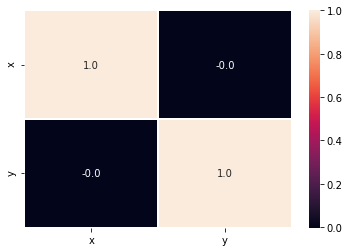

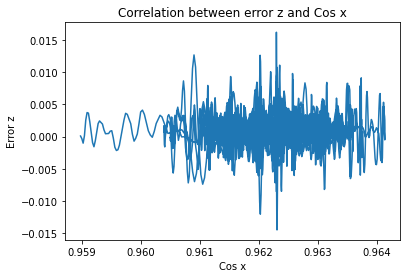

[[1.         0.00349223]
 [0.00349223 1.        ]]


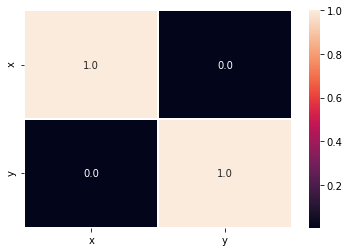

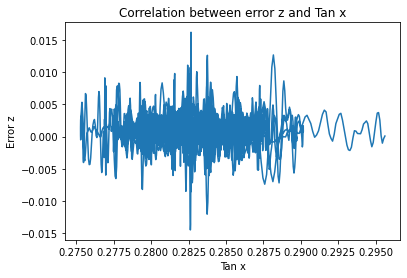

[[ 1.         -0.00354634]
 [-0.00354634  1.        ]]


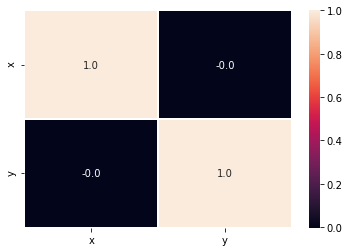

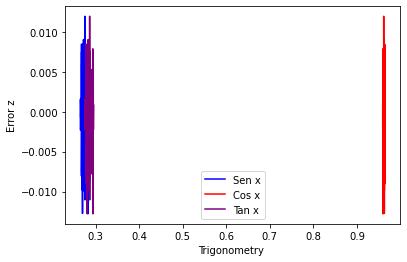

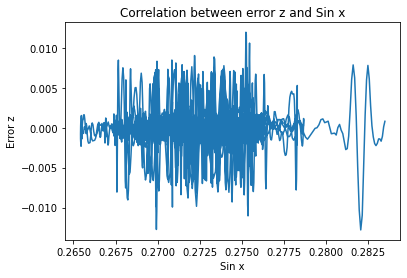

[[ 1.         -0.00474569]
 [-0.00474569  1.        ]]


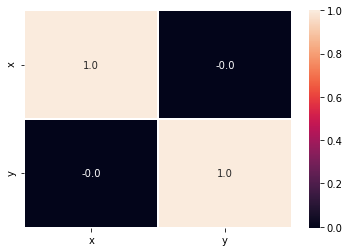

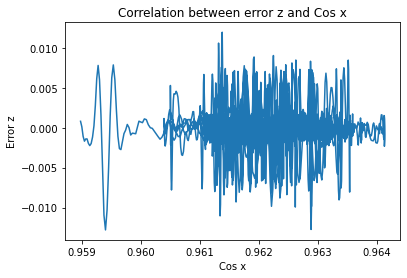

[[1.        0.0047834]
 [0.0047834 1.       ]]


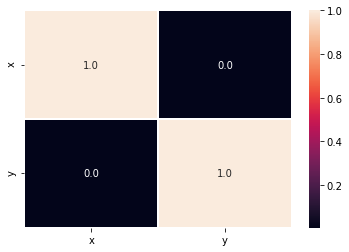

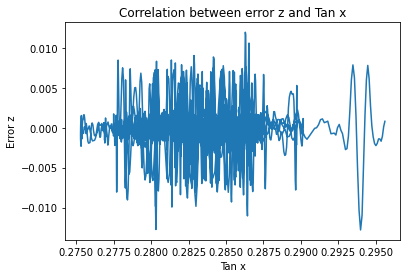

[[ 1.         -0.00475399]
 [-0.00475399  1.        ]]


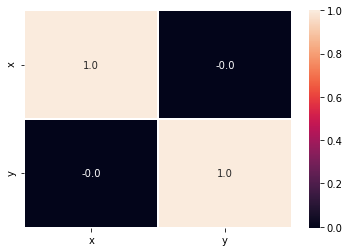

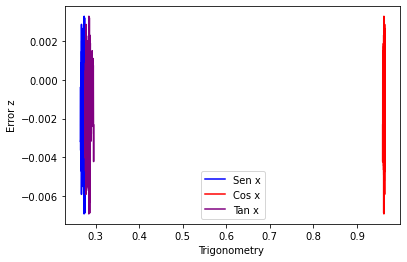

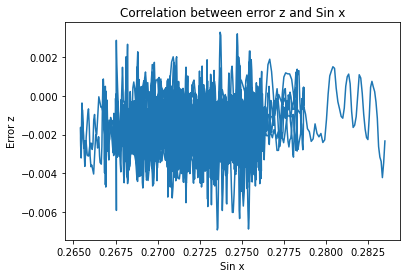

[[1.         0.04854409]
 [0.04854409 1.        ]]


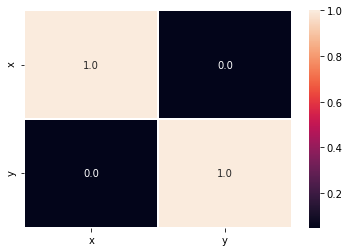

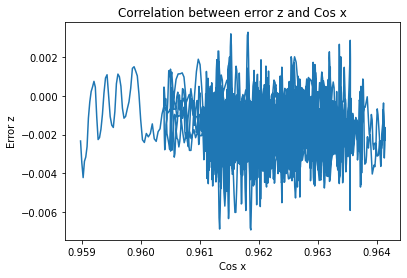

[[ 1.         -0.04906002]
 [-0.04906002  1.        ]]


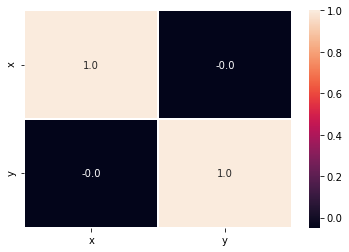

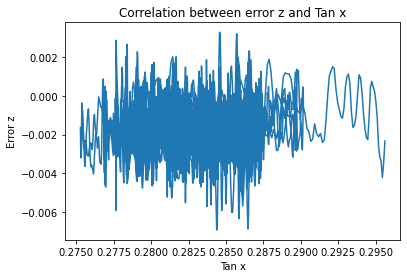

[[1.         0.04866055]
 [0.04866055 1.        ]]


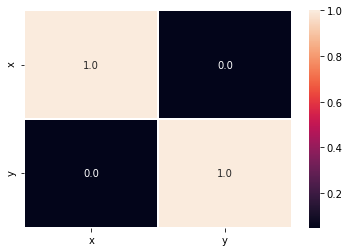

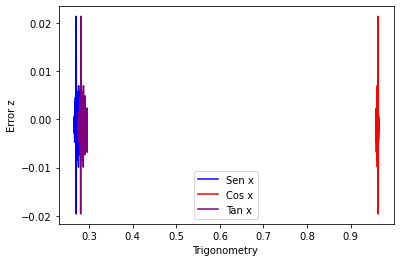

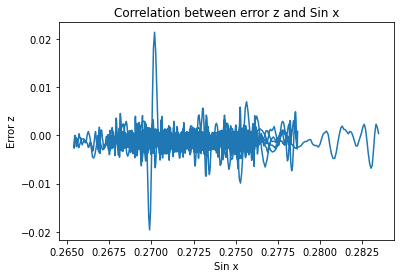

[[ 1.         -0.02317169]
 [-0.02317169  1.        ]]


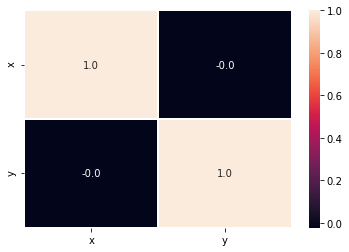

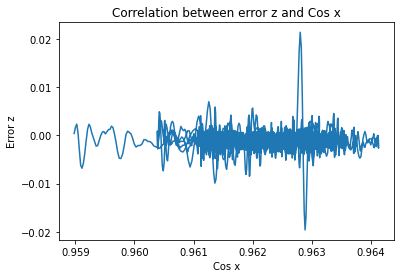

[[1.         0.02298592]
 [0.02298592 1.        ]]


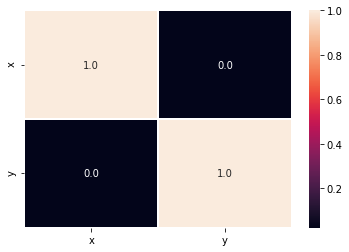

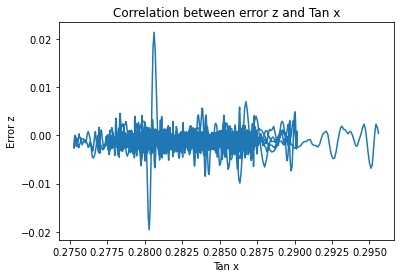

[[ 1.         -0.02312967]
 [-0.02312967  1.        ]]


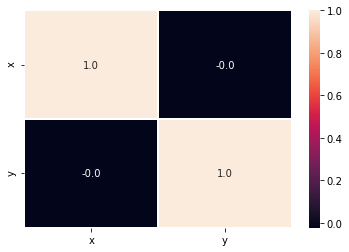

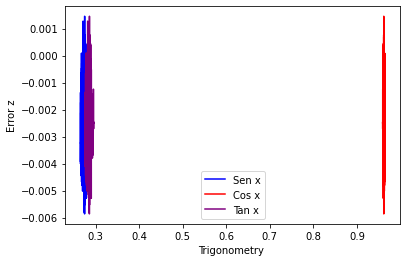

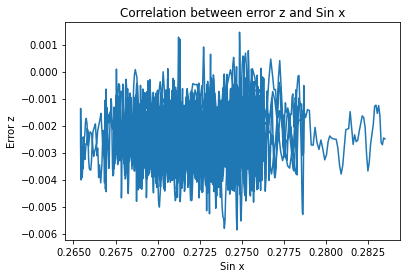

[[1.         0.03694532]
 [0.03694532 1.        ]]


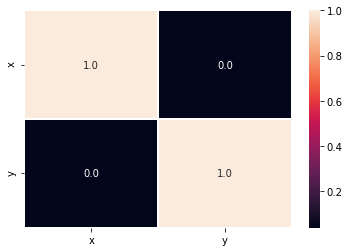

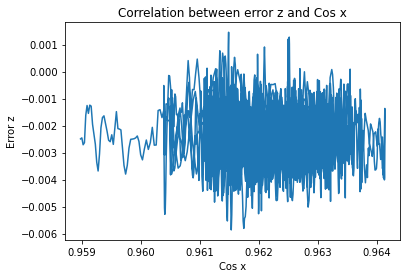

[[ 1.         -0.03698615]
 [-0.03698615  1.        ]]


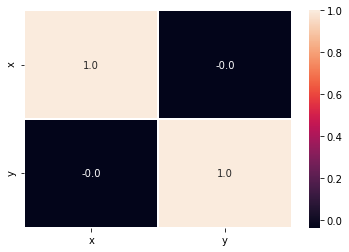

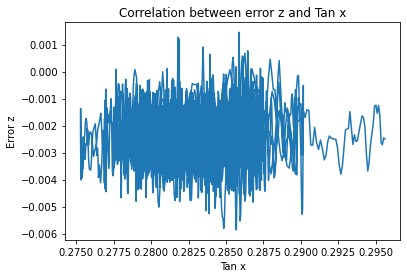

[[1.       0.036955]
 [0.036955 1.      ]]


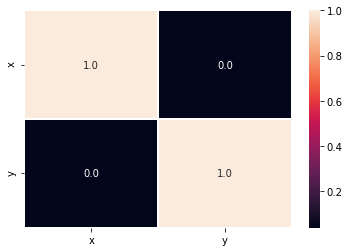

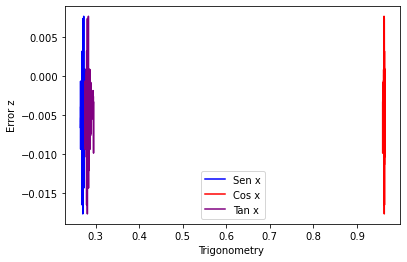

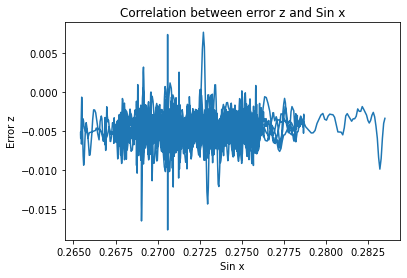

[[1.         0.04632461]
 [0.04632461 1.        ]]


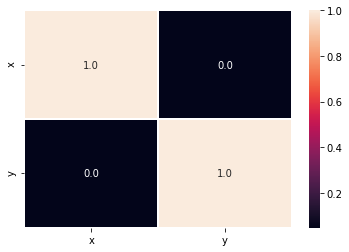

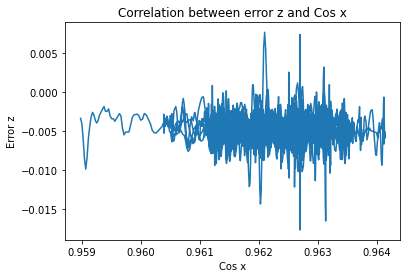

[[ 1.        -0.0465653]
 [-0.0465653  1.       ]]


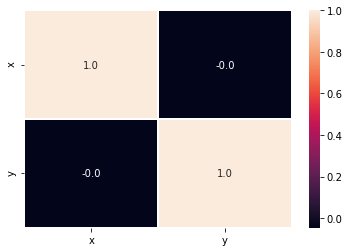

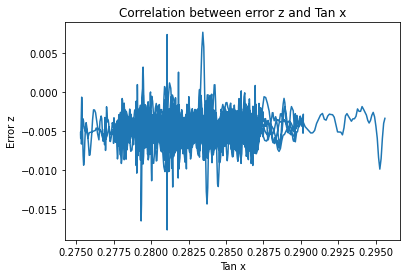

[[1.         0.04637906]
 [0.04637906 1.        ]]


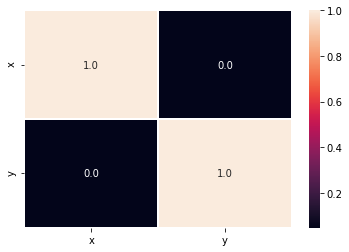

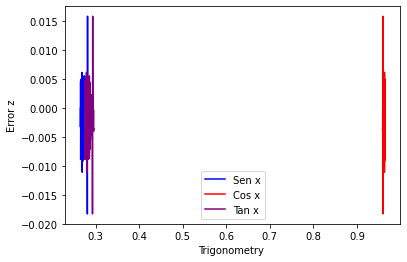

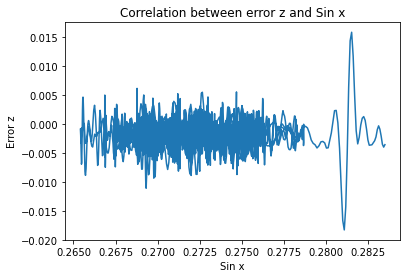

[[1.         0.01519458]
 [0.01519458 1.        ]]


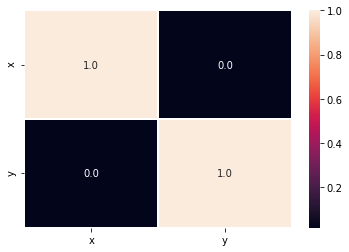

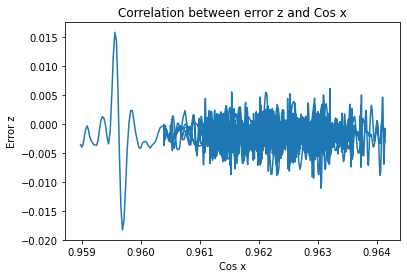

[[ 1.         -0.01532279]
 [-0.01532279  1.        ]]


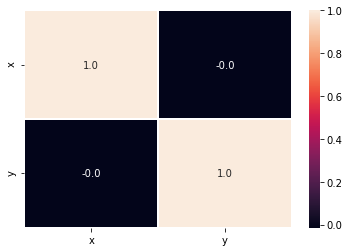

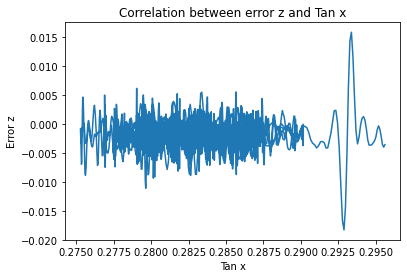

[[1.         0.01522343]
 [0.01522343 1.        ]]


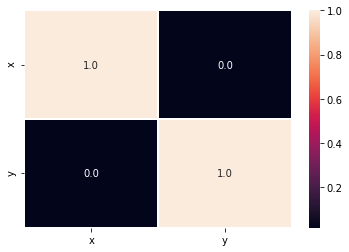

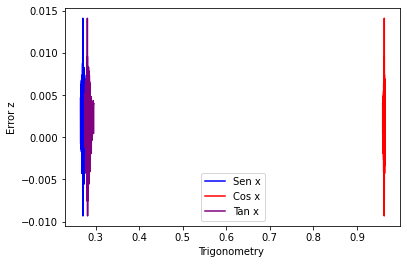

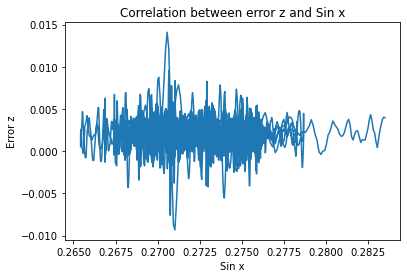

[[ 1.         -0.01242296]
 [-0.01242296  1.        ]]


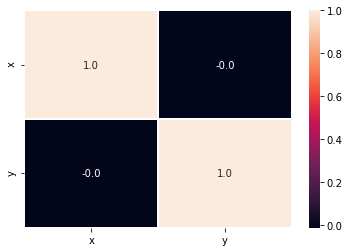

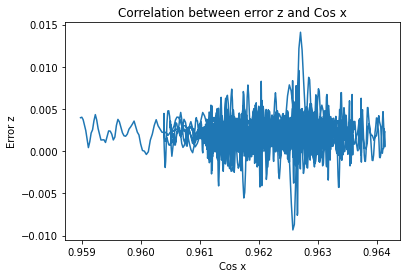

[[1.         0.01230733]
 [0.01230733 1.        ]]


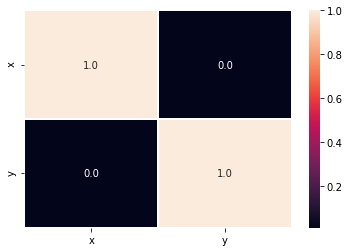

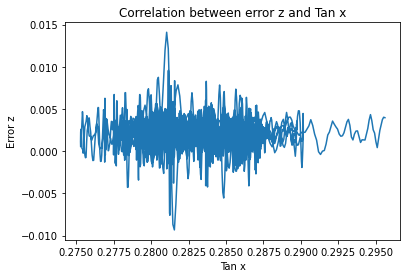

[[ 1.         -0.01239666]
 [-0.01239666  1.        ]]


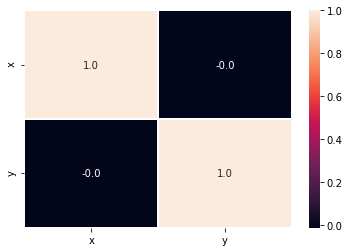

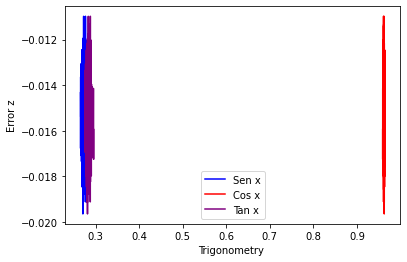

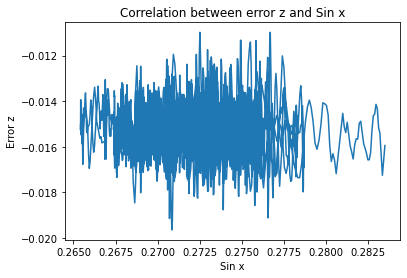

[[ 1.        -0.0261098]
 [-0.0261098  1.       ]]


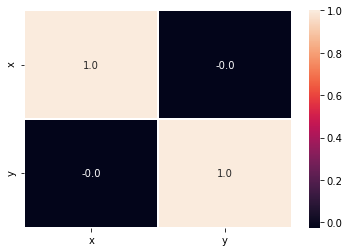

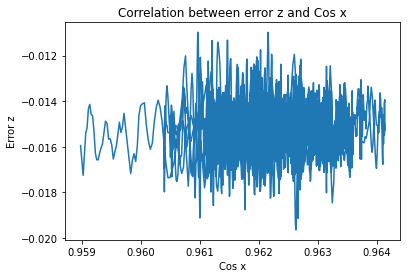

[[1.         0.02629075]
 [0.02629075 1.        ]]


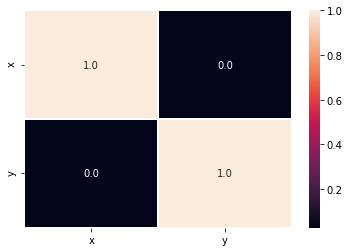

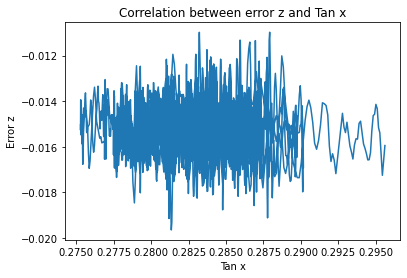

[[ 1.         -0.02615105]
 [-0.02615105  1.        ]]


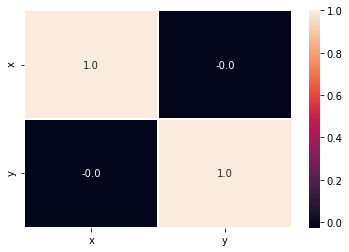

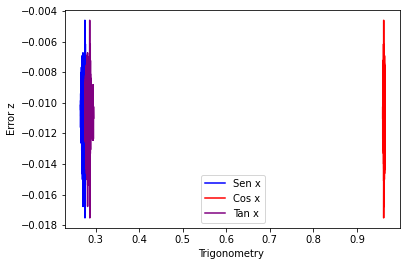

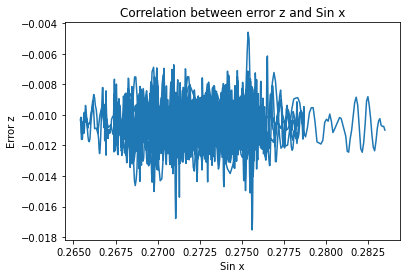

[[1.00000000e+00 3.94042307e-04]
 [3.94042307e-04 1.00000000e+00]]


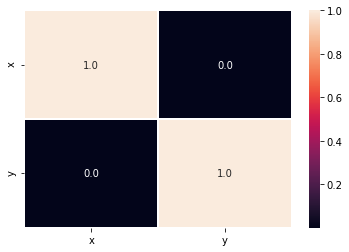

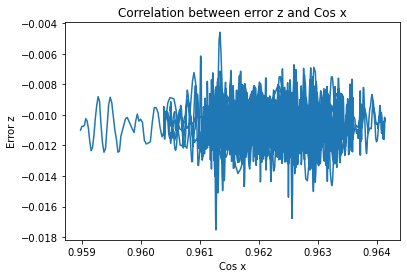

[[ 1.00000000e+00 -4.28967727e-04]
 [-4.28967727e-04  1.00000000e+00]]


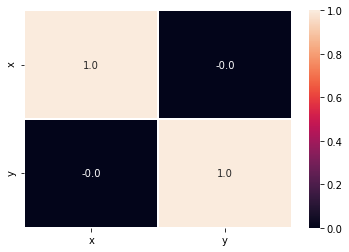

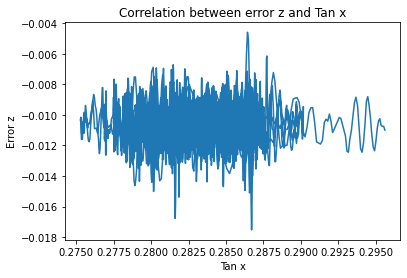

[[1.00000000e+00 4.01507436e-04]
 [4.01507436e-04 1.00000000e+00]]


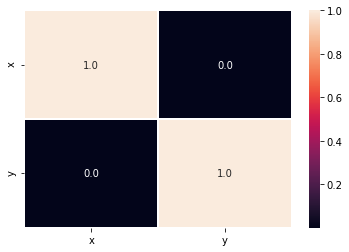

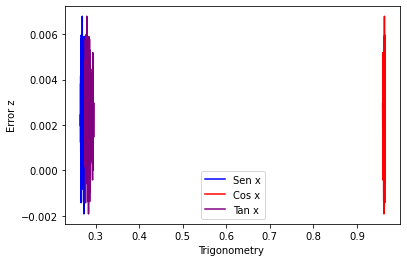

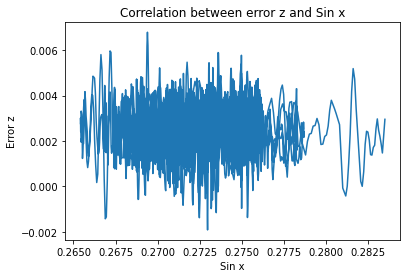

[[1.         0.01345349]
 [0.01345349 1.        ]]


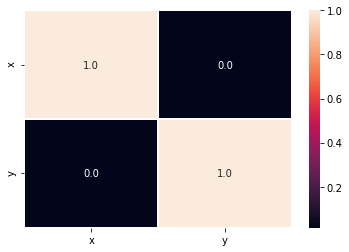

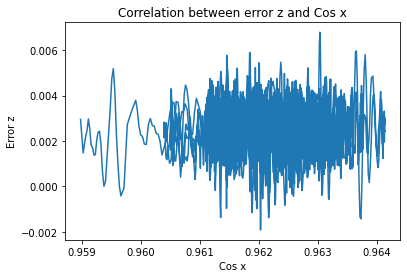

[[ 1.         -0.01321564]
 [-0.01321564  1.        ]]


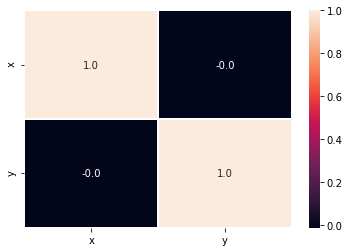

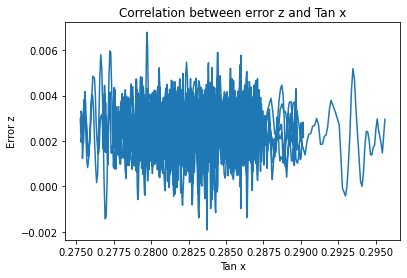

[[1.        0.0133996]
 [0.0133996 1.       ]]


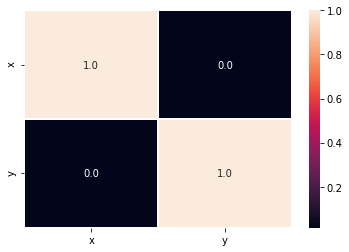

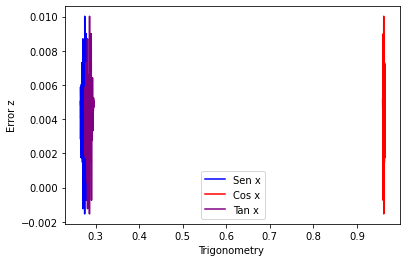

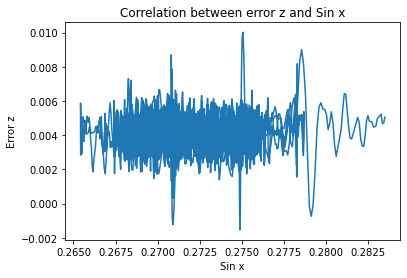

[[1.         0.02096345]
 [0.02096345 1.        ]]


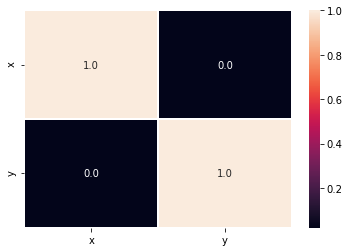

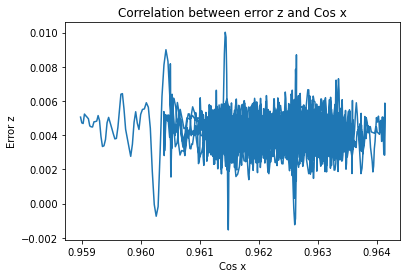

[[ 1.         -0.02136761]
 [-0.02136761  1.        ]]


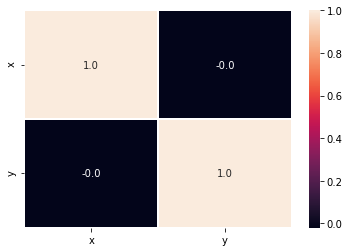

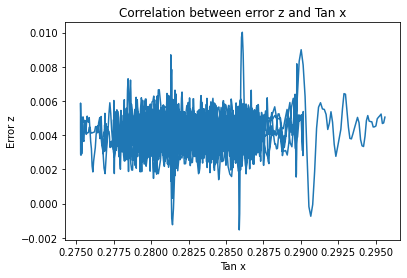

[[1.         0.02105457]
 [0.02105457 1.        ]]


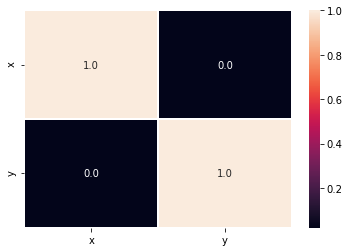

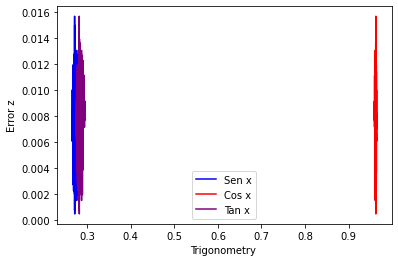

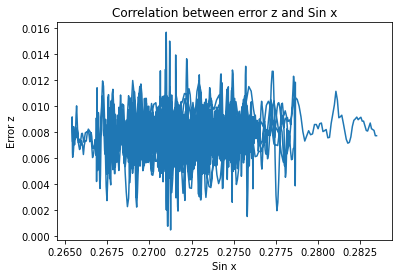

[[1.        0.0619277]
 [0.0619277 1.       ]]


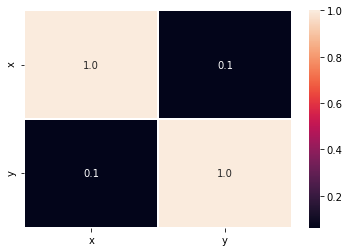

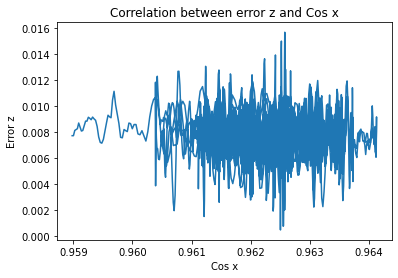

[[ 1.         -0.06235028]
 [-0.06235028  1.        ]]


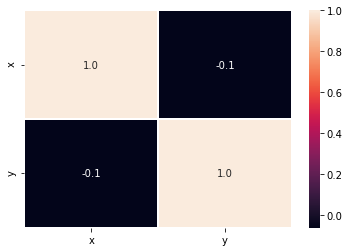

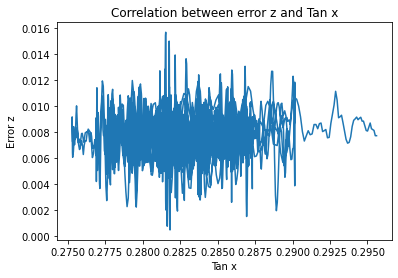

[[1.         0.06202286]
 [0.06202286 1.        ]]


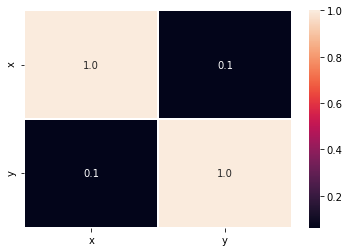

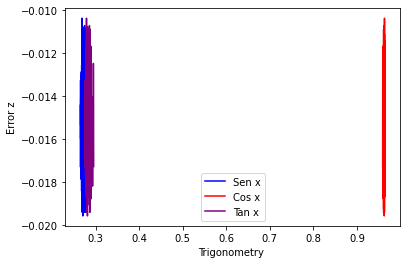

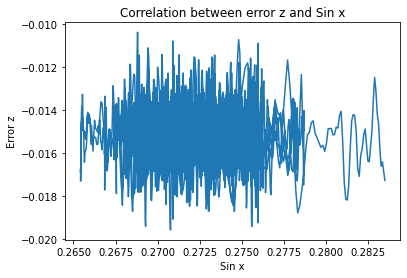

[[ 1.         -0.00935391]
 [-0.00935391  1.        ]]


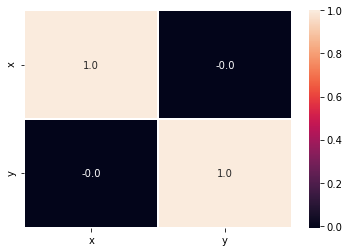

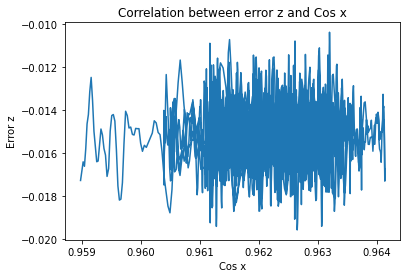

[[1.        0.0095381]
 [0.0095381 1.       ]]


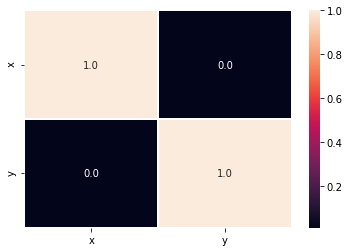

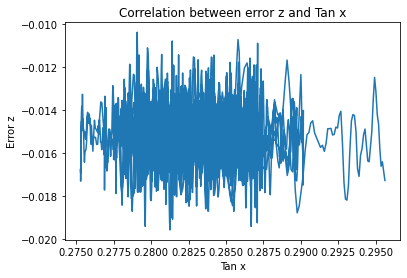

[[ 1.         -0.00939553]
 [-0.00939553  1.        ]]


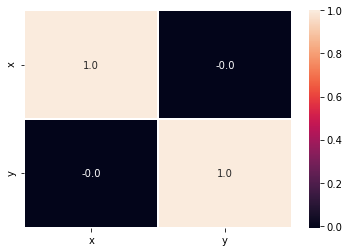

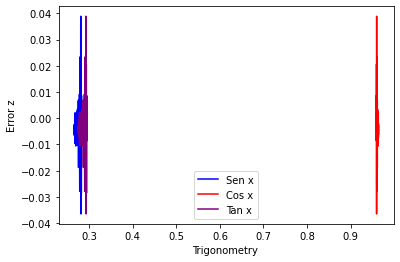

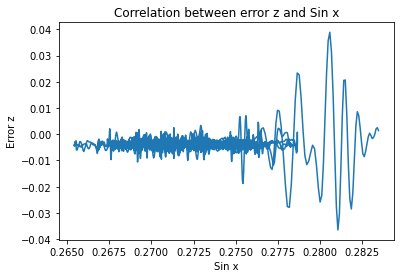

[[1.         0.01366185]
 [0.01366185 1.        ]]


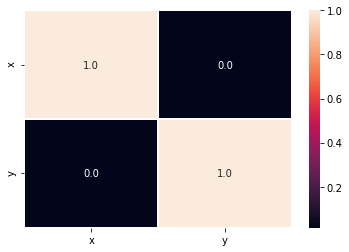

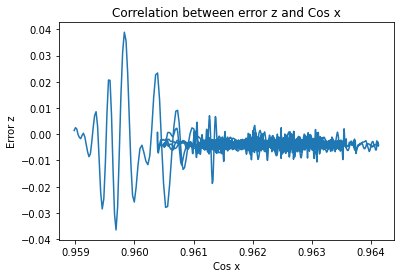

[[ 1.         -0.01403142]
 [-0.01403142  1.        ]]


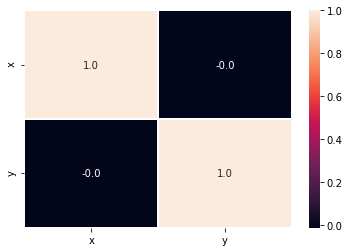

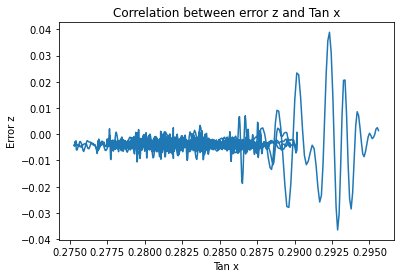

[[1.         0.01374528]
 [0.01374528 1.        ]]


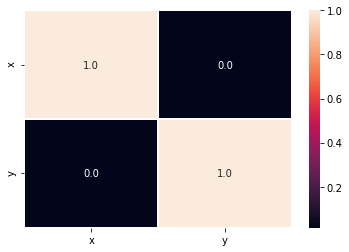

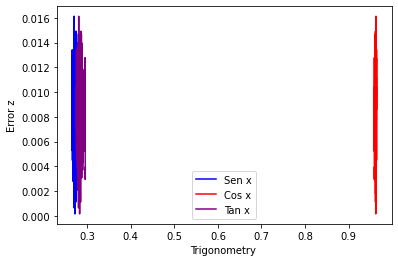

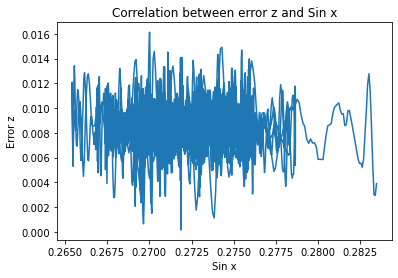

[[1.        0.0025618]
 [0.0025618 1.       ]]


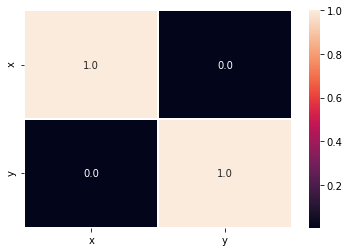

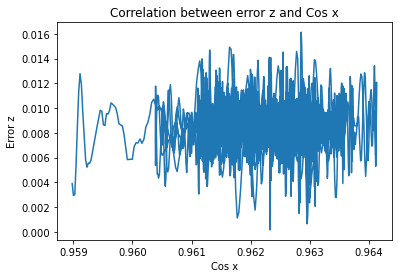

[[ 1.         -0.00224025]
 [-0.00224025  1.        ]]


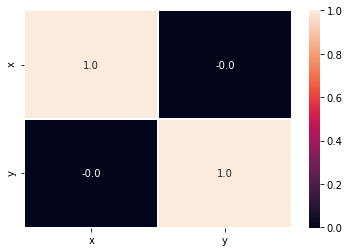

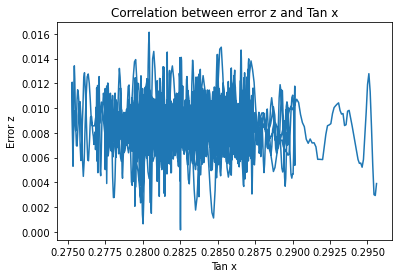

[[1.         0.00248908]
 [0.00248908 1.        ]]


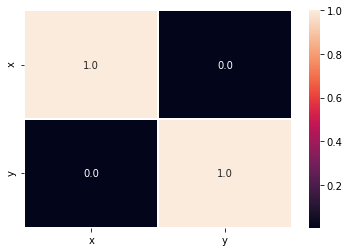

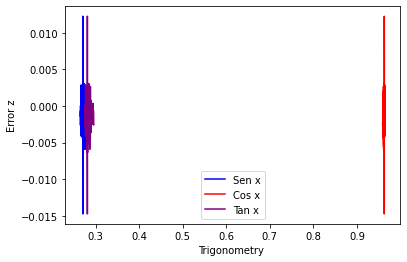

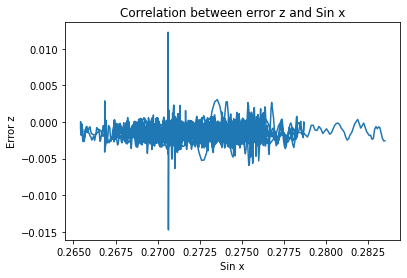

[[ 1.00000000e+00 -2.48362113e-04]
 [-2.48362113e-04  1.00000000e+00]]


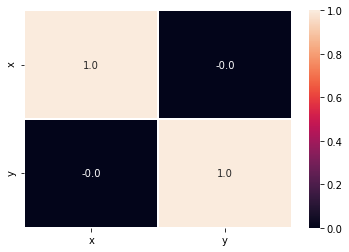

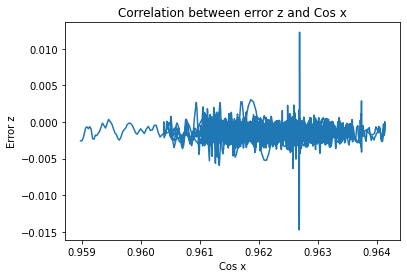

[[1.00000000e+00 1.55768772e-04]
 [1.55768772e-04 1.00000000e+00]]


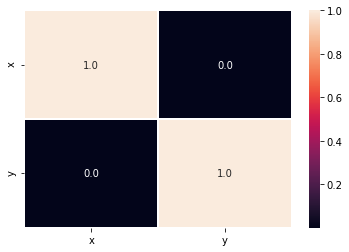

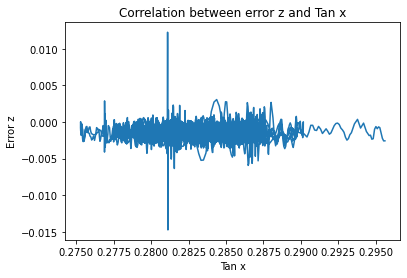

[[ 1.00000000e+00 -2.27523195e-04]
 [-2.27523195e-04  1.00000000e+00]]


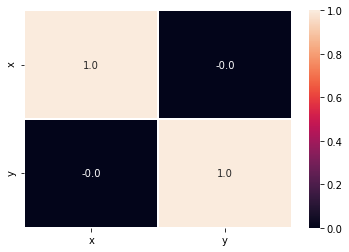

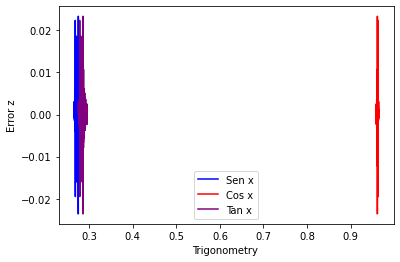

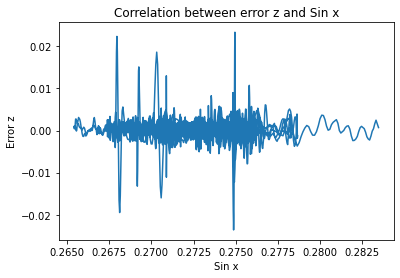

[[ 1.         -0.02087545]
 [-0.02087545  1.        ]]


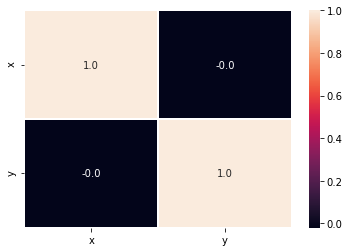

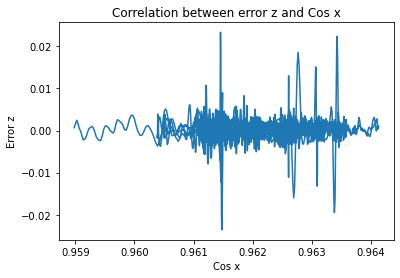

[[1.         0.02061866]
 [0.02061866 1.        ]]


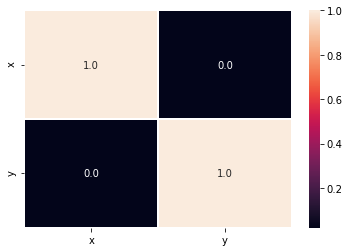

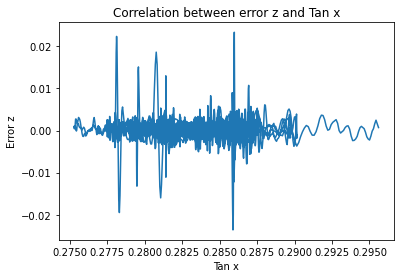

[[ 1.         -0.02081842]
 [-0.02081842  1.        ]]


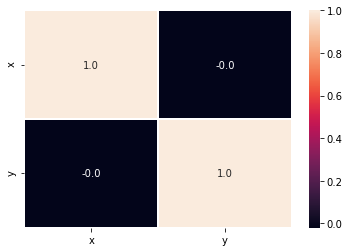

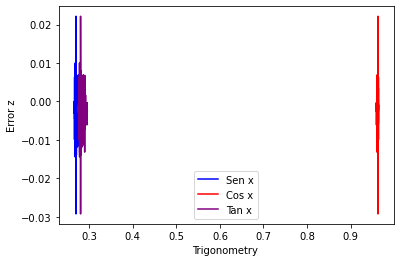

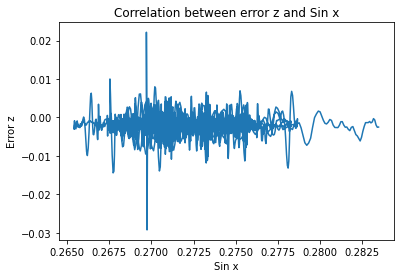

[[ 1.         -0.00454799]
 [-0.00454799  1.        ]]


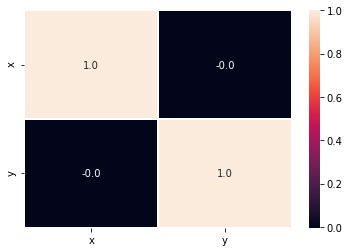

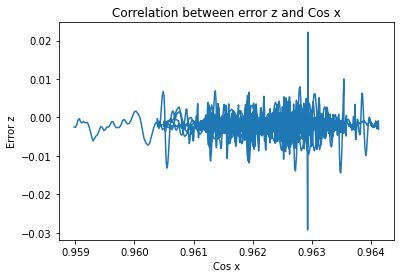

[[1.         0.00444531]
 [0.00444531 1.        ]]


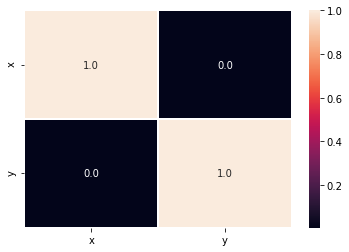

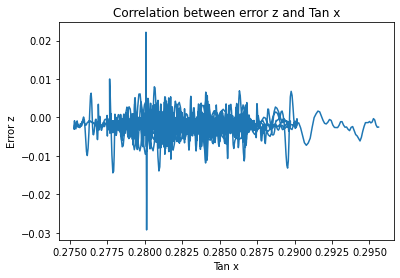

[[ 1.         -0.00452531]
 [-0.00452531  1.        ]]


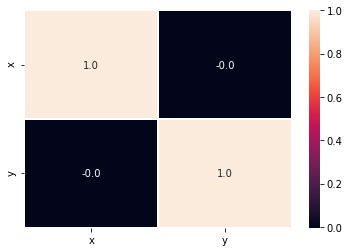

In [23]:
for s in range(1,50):
    plt.figure()
    plt.plot(sinx[30:],errorZ[s-1,:],color='blue',label='Sen x')
    plt.plot(cosx[30:],errorZ[s-1,:],color='red',label='Cos x')
    plt.plot(tanx[30:],errorZ[s-1,:],color='purple',label='Tan x')
    plt.xlabel("Trigonometry ")
    plt.ylabel("Error z")
    plt.legend()
    plt.show()

    plt.plot(sinx[30:],errorZ[s-1,:])
    plt.xlabel("Sin x")
    plt.ylabel("Error z")
    plt.title("Correlation between error z and Sin x")
    plt.show()
    r=np.corrcoef(sinx[30:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':sinx[30:],
          'y': errorZ[s-1,:]
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

    plt.plot(cosx[30:],errorZ[s-1,:])
    plt.xlabel("Cos x")
    plt.ylabel("Error z")
    plt.title("Correlation between error z and Cos x")
    plt.show()
    r=np.corrcoef(cosx[30:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':cosx[30:],
          'y': errorZ[s-1,:]
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

    plt.plot(tanx[30:],errorZ[s-1,:])
    plt.xlabel("Tan x")
    plt.ylabel("Error z")
    plt.title("Correlation between error z and Tan x")
    plt.show()
    r=np.corrcoef(tanx[30:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':tanx[30:],
          'y': errorZ[s-1,:]
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Correlation between errorz and sen,cos and tan of z

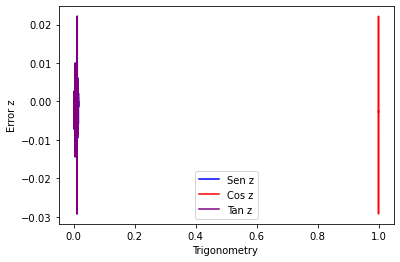

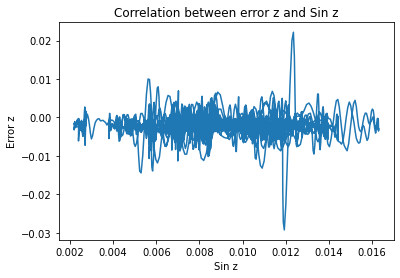

[[1.         0.00203145]
 [0.00203145 1.        ]]


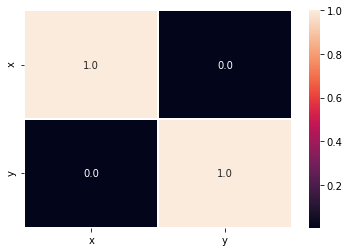

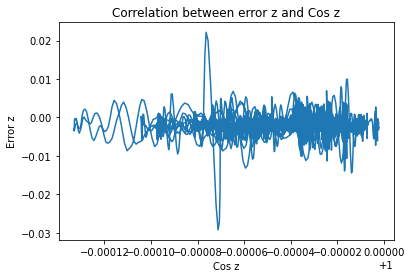

[[1.00000000e+00 1.58700683e-04]
 [1.58700683e-04 1.00000000e+00]]


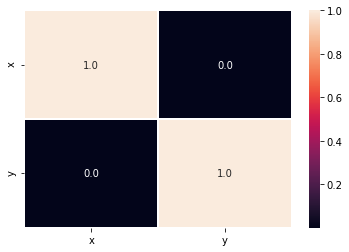

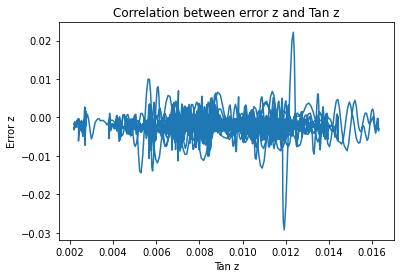

[[1.         0.00203096]
 [0.00203096 1.        ]]


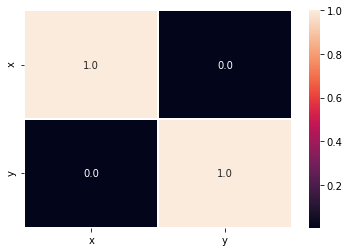

In [24]:
plt.figure()
plt.plot(sinz[30:],errorZ[s-1,:],color='blue',label='Sen z')
plt.plot(cosz[30:],errorZ[s-1,:],color='red',label='Cos z')
plt.plot(tanz[30:],errorZ[s-1,:],color='purple',label='Tan z')
plt.xlabel("Trigonometry ")
plt.ylabel("Error z")
plt.legend()
plt.show()

plt.plot(sinz[30:],errorZ[s-1,:])
plt.xlabel("Sin z")
plt.ylabel("Error z")
plt.title("Correlation between error z and Sin z")
plt.show()
r=np.corrcoef(sinz[30:],errorZ[s-1,:])
print(r)
plt.figure()
data={'x':sinz[30:],
      'y': errorZ[s-1,:]
     }
df=pd.DataFrame(data)
correlation=df.corr()
plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
plt.show()
    
plt.plot(cosz[30:],errorZ[s-1,:])
plt.xlabel("Cos z")
plt.ylabel("Error z")
plt.title("Correlation between error z and Cos z")
plt.show()
r=np.corrcoef(cosz[30:],errorZ[s-1,:])
print(r)
plt.figure()
data={'x':cosz[30:],
      'y': errorZ[s-1,:]
     }
df=pd.DataFrame(data)
correlation=df.corr()
plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
plt.show()

plt.plot(tanz[30:],errorZ[s-1,:])
plt.xlabel("Tan z")
plt.ylabel("Error z")
plt.title("Correlation between error z and Tan z")
plt.show()
r=np.corrcoef(tanz[30:],errorZ[s-1,:])
print(r)
plt.figure()
data={'x':tanz[30:],
      'y': errorZ[s-1,:]
     }
df=pd.DataFrame(data)
correlation=df.corr()
plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
plt.show()

# Error z in function of derivatives

We are going to correlate the error found with the first and second. If the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice that the number of correlation approaches 0, indicating a lack of correlation betweem them, for the errorz and anglez and angle x for the first and second derivative.

## Correlation between errorz and first and second derivative of x

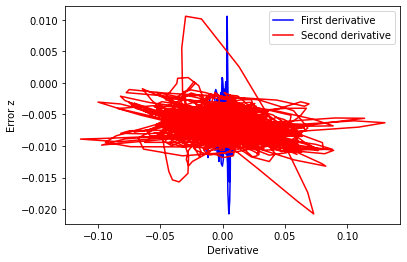

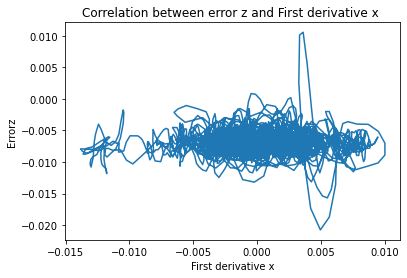

[[1.         0.00178598]
 [0.00178598 1.        ]]


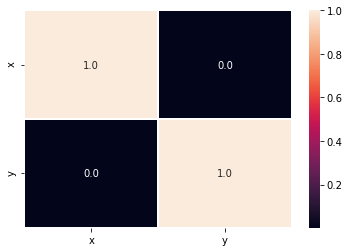

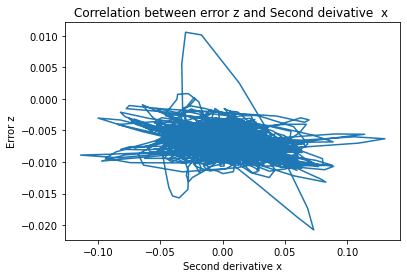

[[ 1.         -0.17835412]
 [-0.17835412  1.        ]]


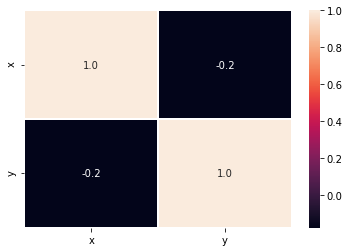

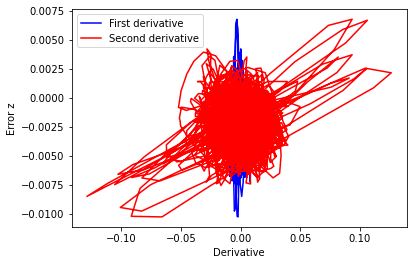

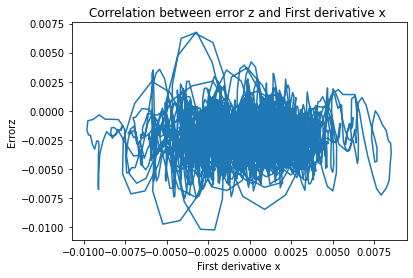

[[1.         0.02323446]
 [0.02323446 1.        ]]


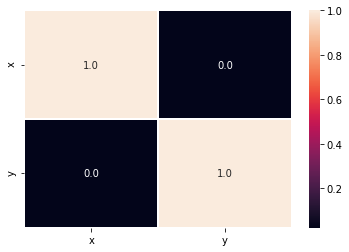

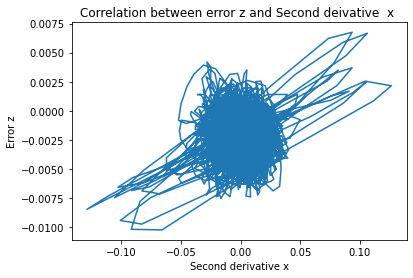

[[1.         0.10632105]
 [0.10632105 1.        ]]


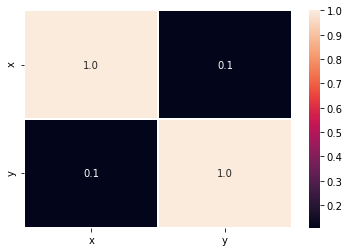

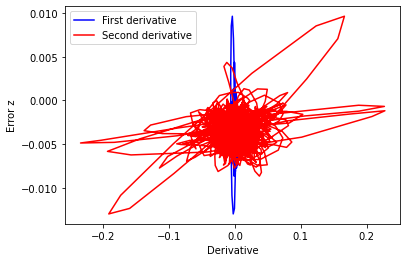

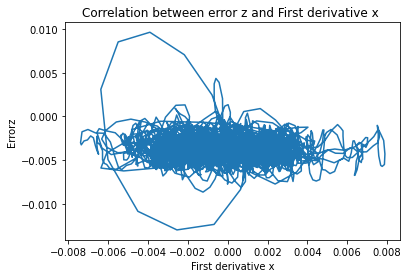

[[ 1.        -0.0588731]
 [-0.0588731  1.       ]]


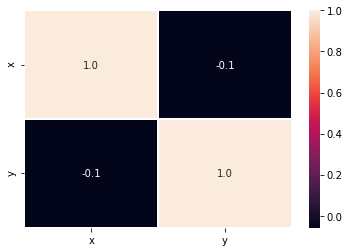

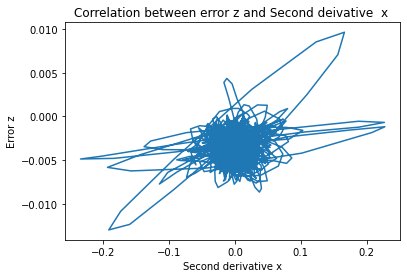

[[1.         0.09800119]
 [0.09800119 1.        ]]


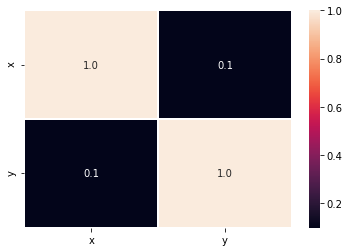

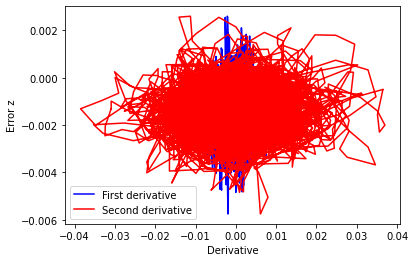

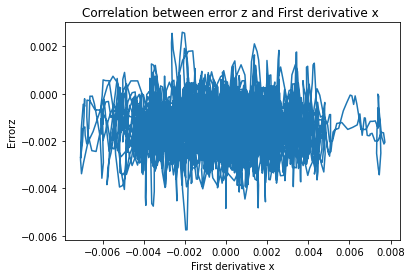

[[ 1.         -0.03240264]
 [-0.03240264  1.        ]]


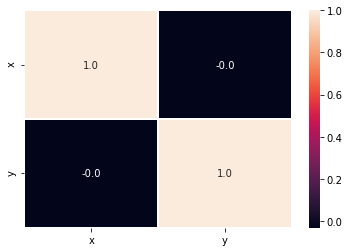

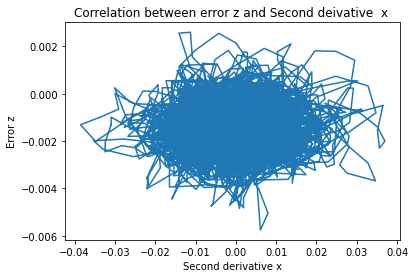

[[1.         0.03358527]
 [0.03358527 1.        ]]


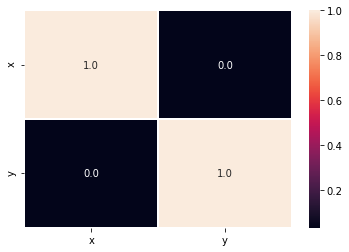

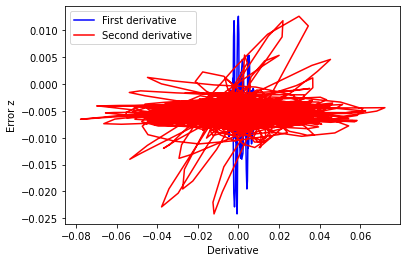

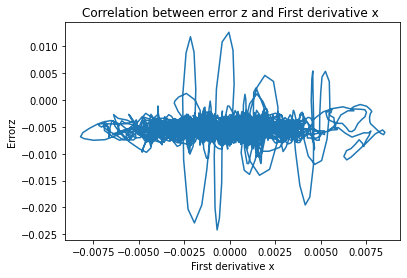

[[1.         0.01840292]
 [0.01840292 1.        ]]


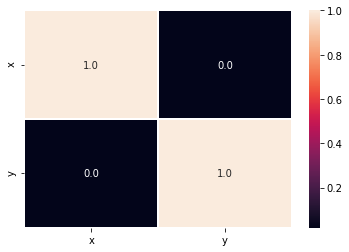

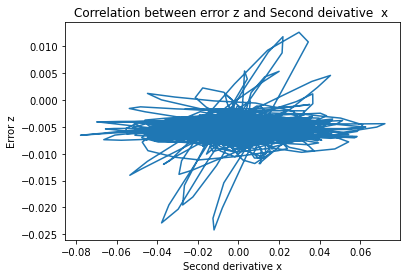

[[1.         0.03347597]
 [0.03347597 1.        ]]


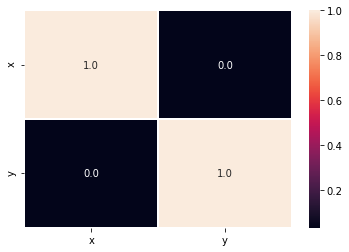

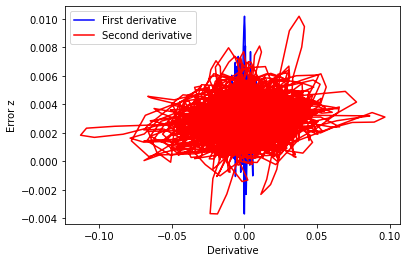

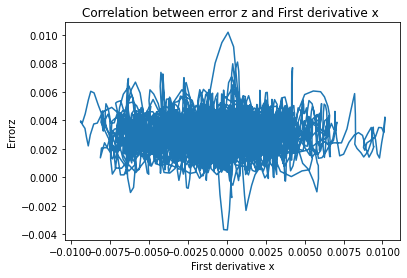

[[1.         0.01078035]
 [0.01078035 1.        ]]


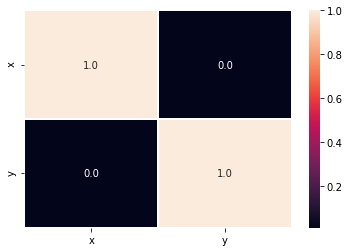

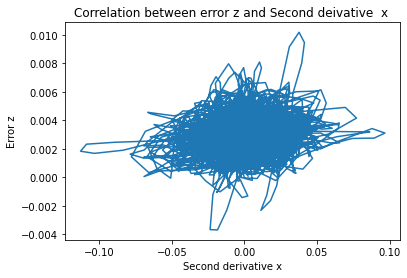

[[1.        0.1456889]
 [0.1456889 1.       ]]


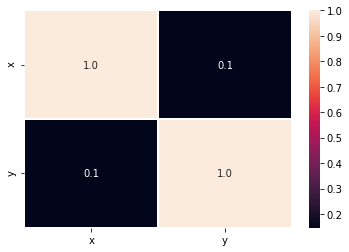

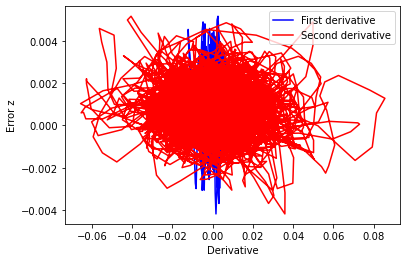

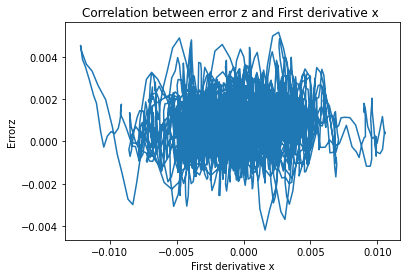

[[1.        0.0437395]
 [0.0437395 1.       ]]


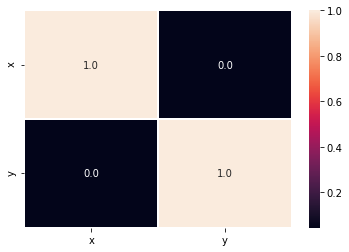

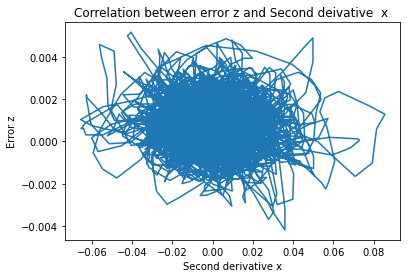

[[ 1.         -0.06026903]
 [-0.06026903  1.        ]]


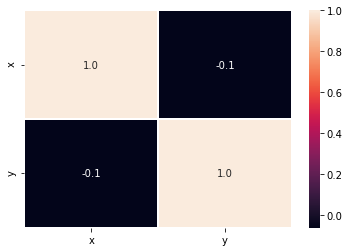

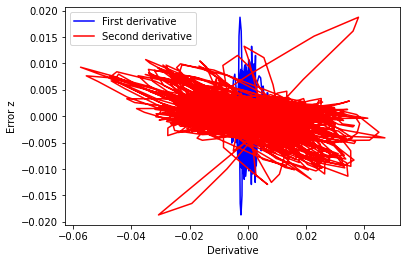

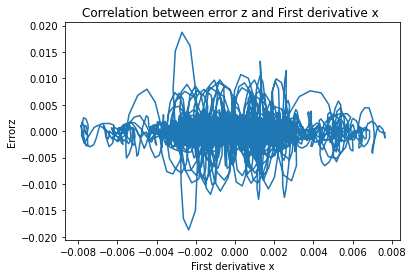

[[1.         0.00723998]
 [0.00723998 1.        ]]


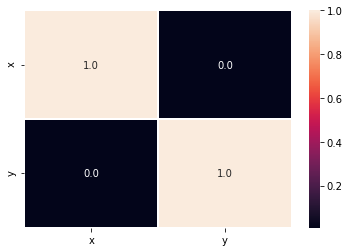

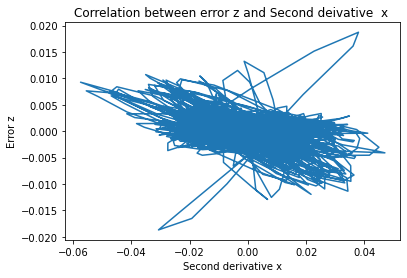

[[ 1.         -0.29075591]
 [-0.29075591  1.        ]]


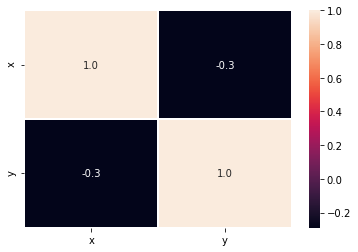

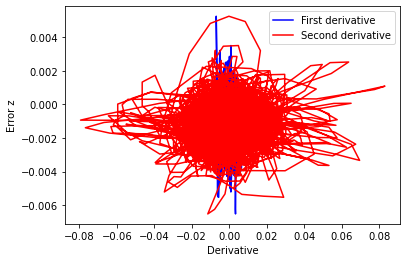

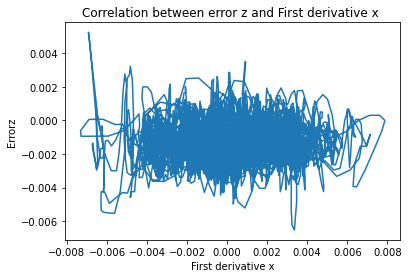

[[1.         0.02416649]
 [0.02416649 1.        ]]


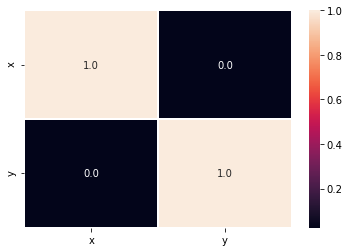

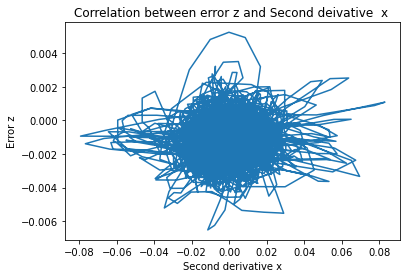

[[1.         0.05657382]
 [0.05657382 1.        ]]


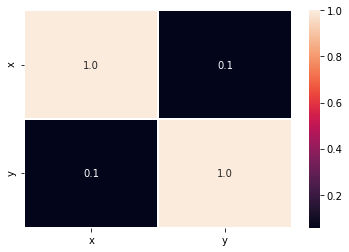

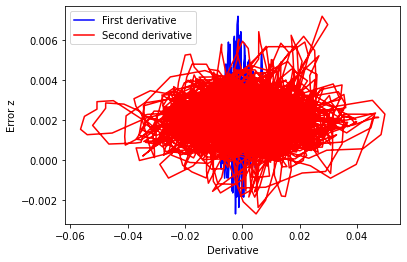

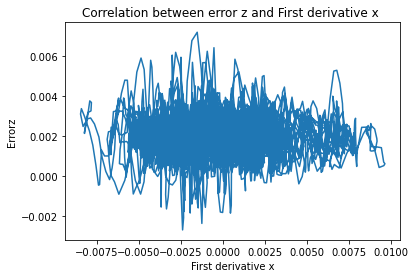

[[ 1.        -0.0461491]
 [-0.0461491  1.       ]]


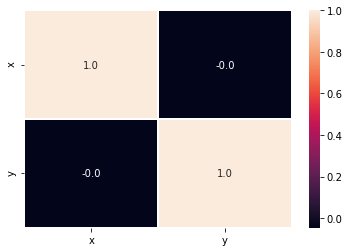

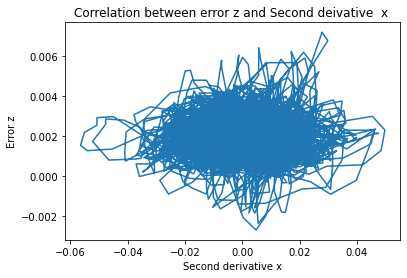

[[1.         0.01251125]
 [0.01251125 1.        ]]


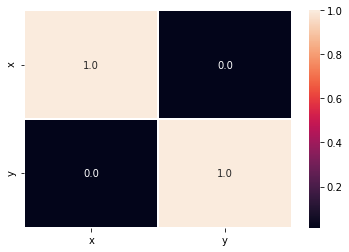

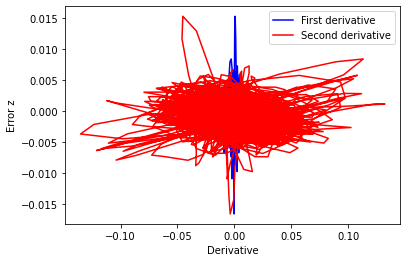

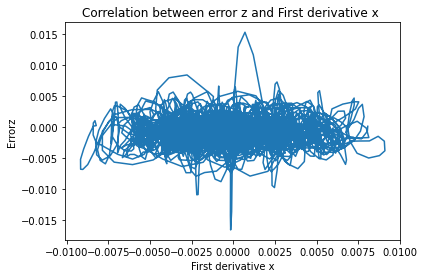

[[1.         0.00848899]
 [0.00848899 1.        ]]


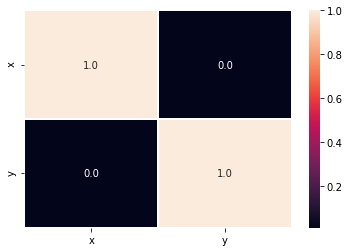

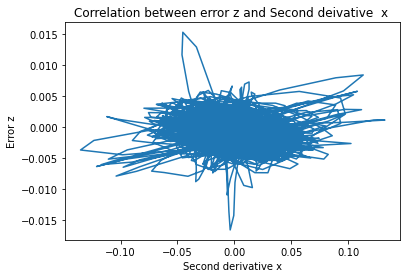

[[ 1.         -0.14327424]
 [-0.14327424  1.        ]]


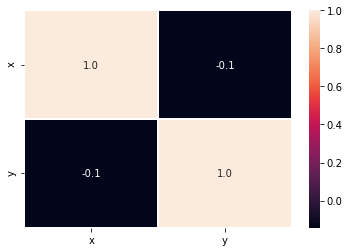

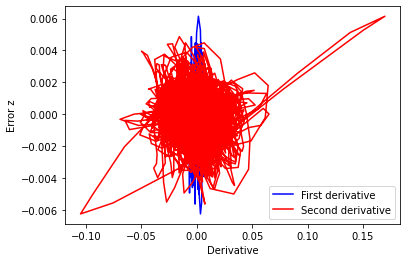

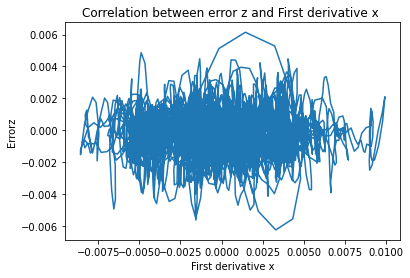

[[ 1.00000000e+00 -8.29795837e-04]
 [-8.29795837e-04  1.00000000e+00]]


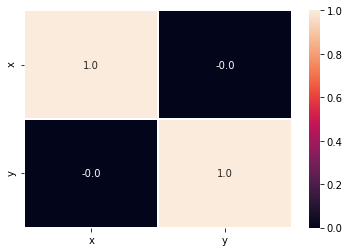

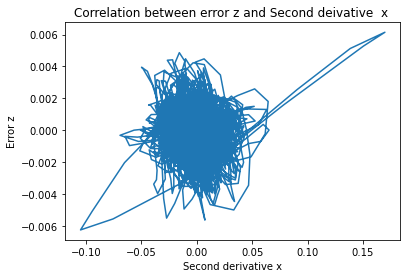

[[ 1.         -0.01905688]
 [-0.01905688  1.        ]]


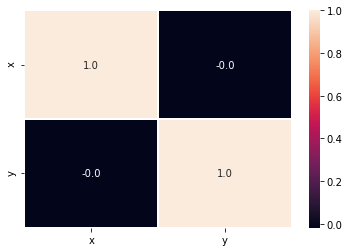

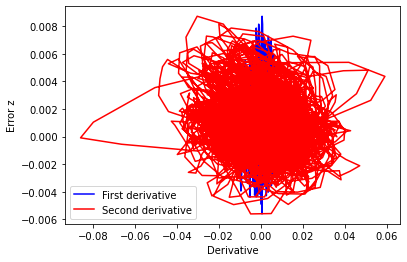

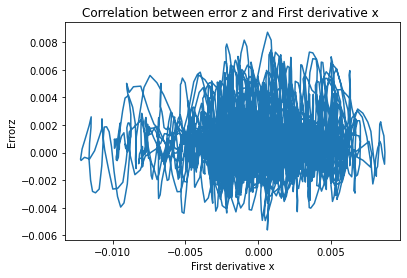

[[1.         0.00317274]
 [0.00317274 1.        ]]


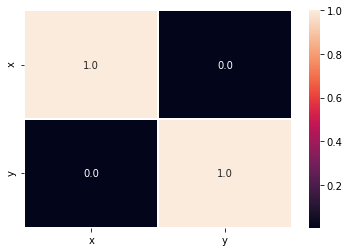

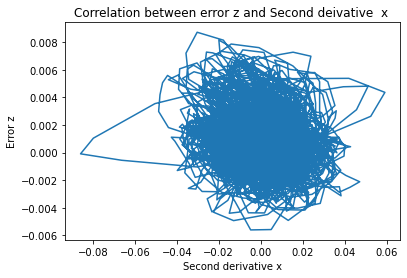

[[ 1.         -0.15429762]
 [-0.15429762  1.        ]]


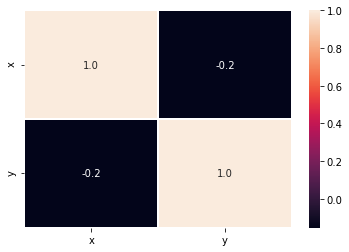

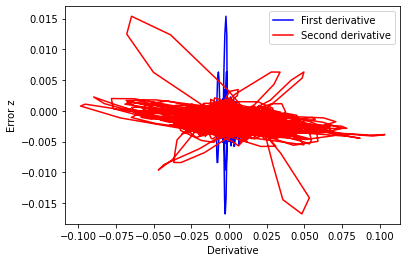

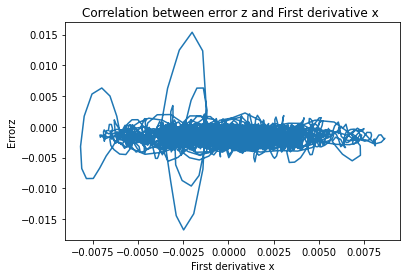

[[ 1.         -0.00545379]
 [-0.00545379  1.        ]]


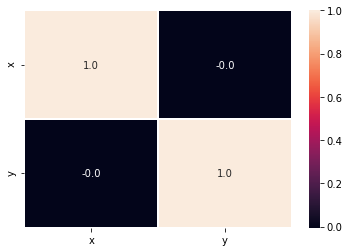

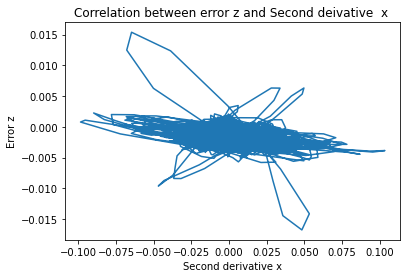

[[ 1.         -0.20081511]
 [-0.20081511  1.        ]]


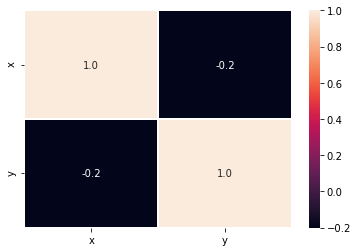

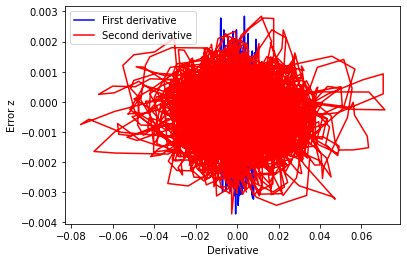

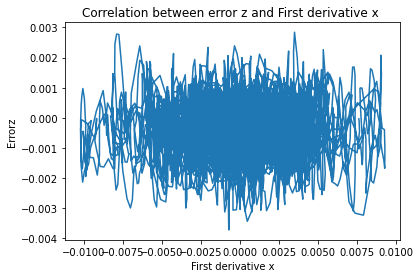

[[ 1.         -0.01871314]
 [-0.01871314  1.        ]]


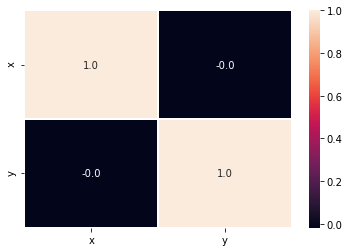

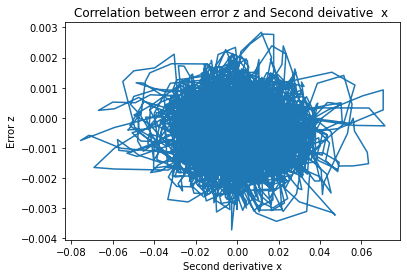

[[ 1.         -0.05381238]
 [-0.05381238  1.        ]]


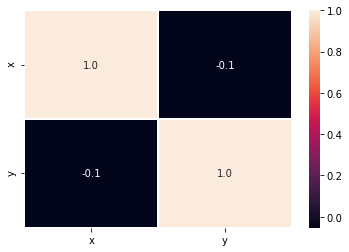

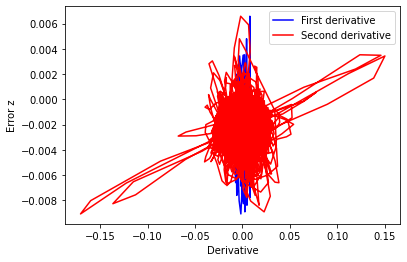

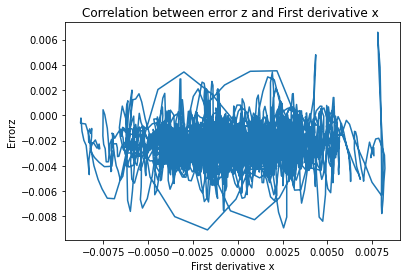

[[1.         0.02120306]
 [0.02120306 1.        ]]


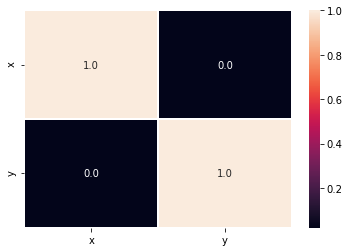

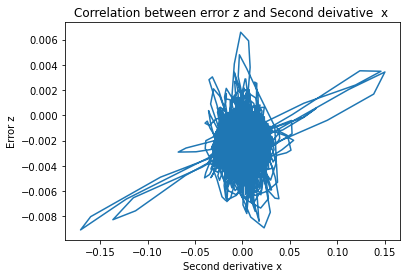

[[1.         0.08317478]
 [0.08317478 1.        ]]


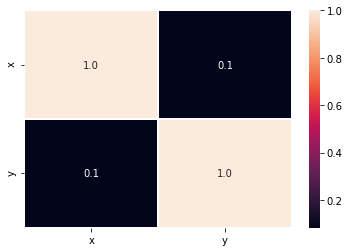

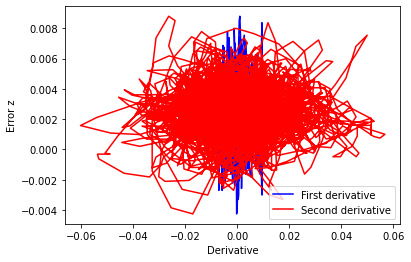

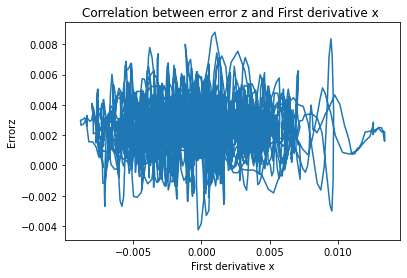

[[ 1.         -0.00241581]
 [-0.00241581  1.        ]]


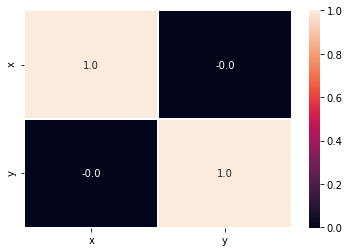

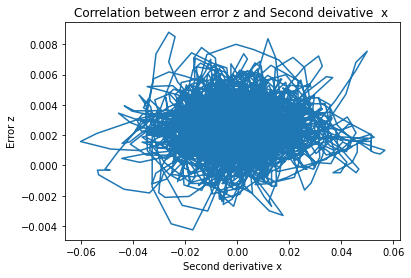

[[1.         0.00288219]
 [0.00288219 1.        ]]


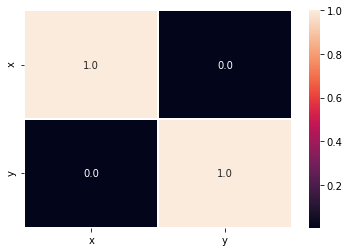

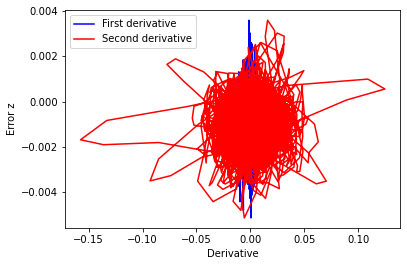

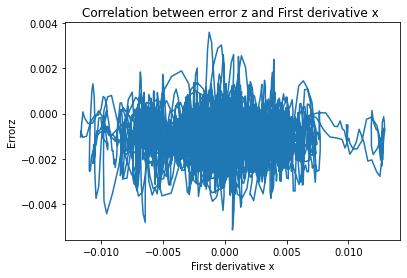

[[ 1.         -0.03407195]
 [-0.03407195  1.        ]]


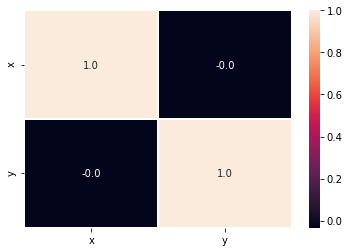

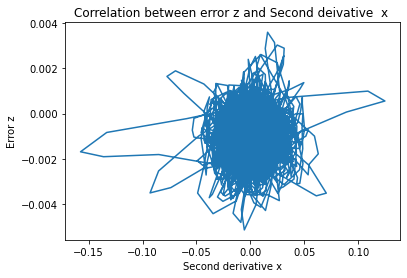

[[1.         0.03519845]
 [0.03519845 1.        ]]


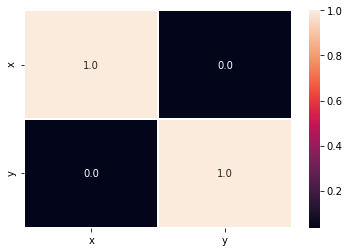

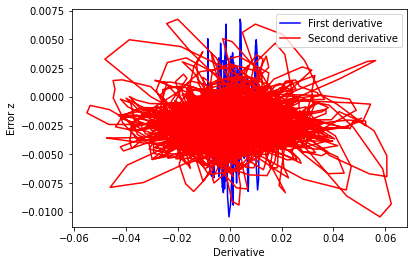

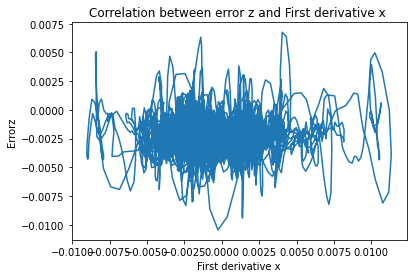

[[1.         0.02595886]
 [0.02595886 1.        ]]


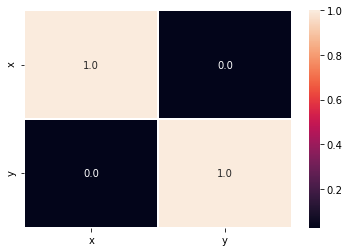

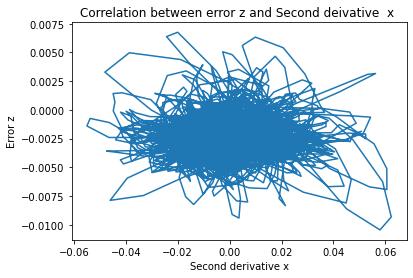

[[1.         0.03603585]
 [0.03603585 1.        ]]


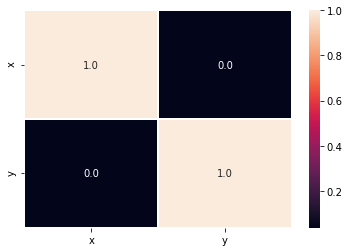

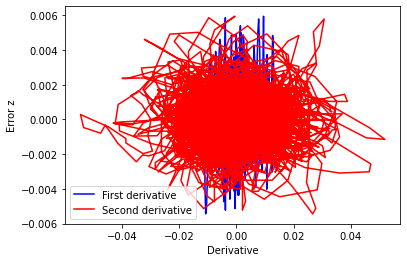

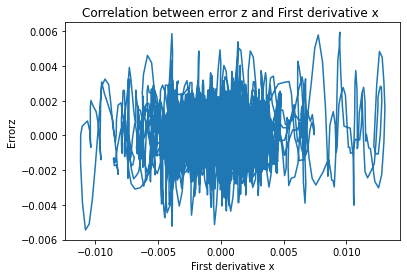

[[1.         0.03701339]
 [0.03701339 1.        ]]


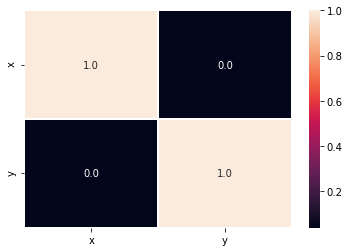

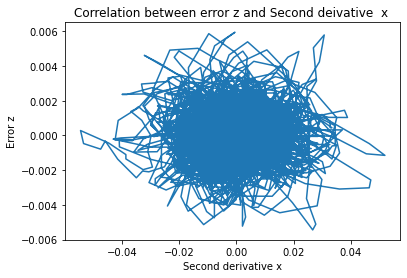

[[ 1.         -0.00215827]
 [-0.00215827  1.        ]]


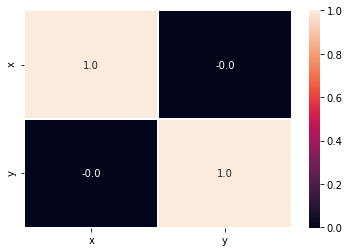

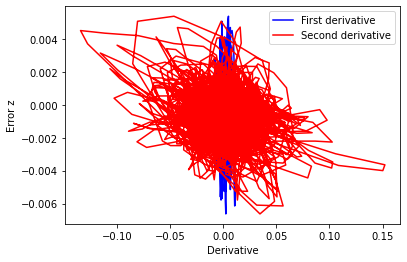

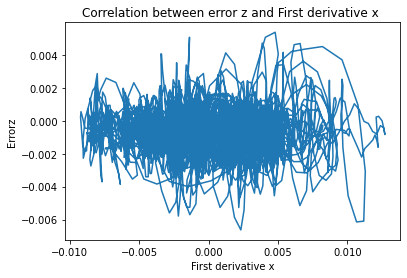

[[ 1.        -0.0170144]
 [-0.0170144  1.       ]]


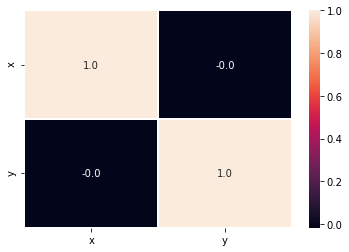

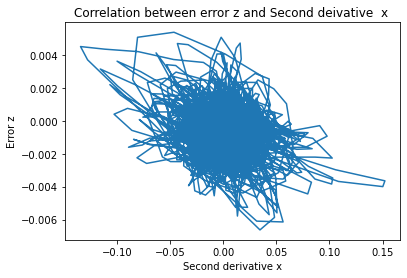

[[ 1.         -0.20933862]
 [-0.20933862  1.        ]]


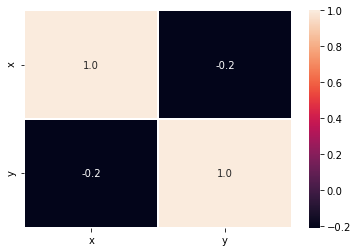

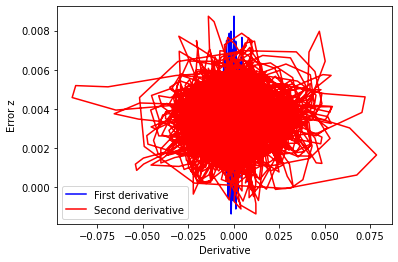

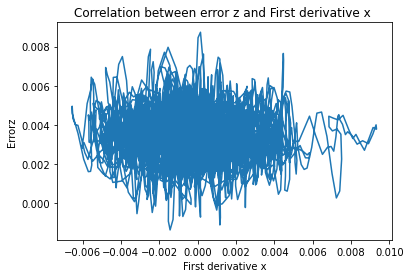

[[ 1.        -0.0478281]
 [-0.0478281  1.       ]]


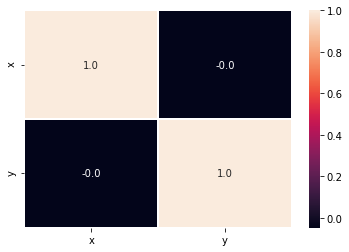

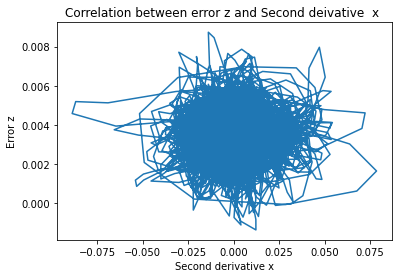

[[1.         0.01969862]
 [0.01969862 1.        ]]


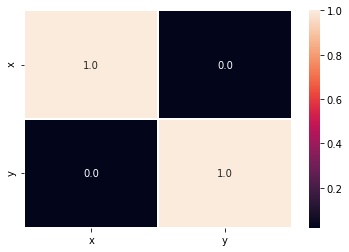

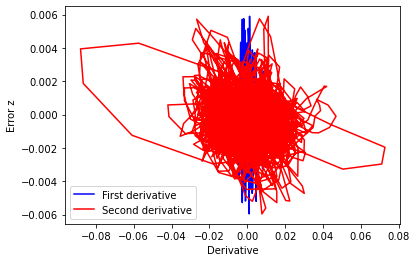

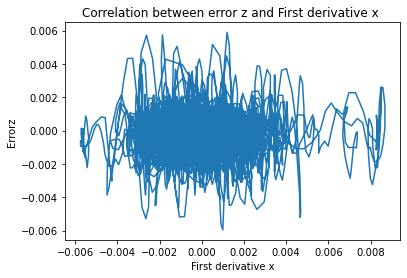

[[ 1.         -0.00605016]
 [-0.00605016  1.        ]]


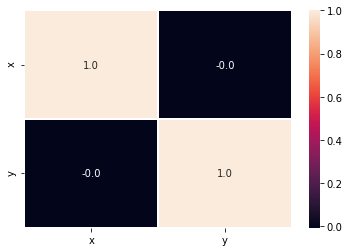

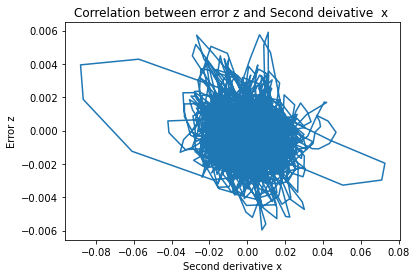

[[ 1.         -0.13769163]
 [-0.13769163  1.        ]]


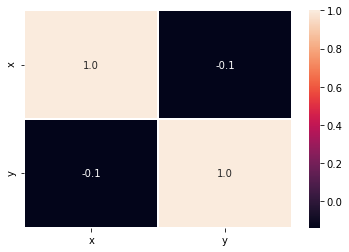

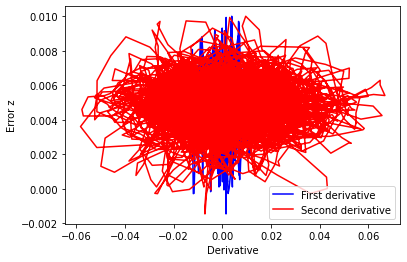

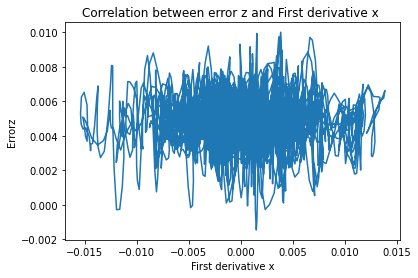

[[ 1.         -0.01158887]
 [-0.01158887  1.        ]]


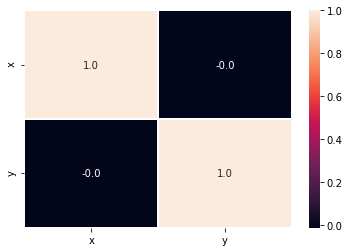

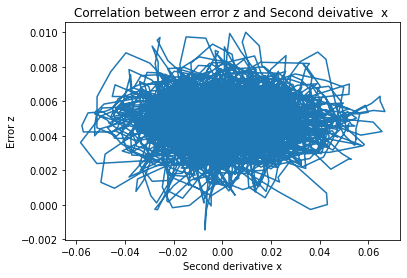

[[1.         0.00920309]
 [0.00920309 1.        ]]


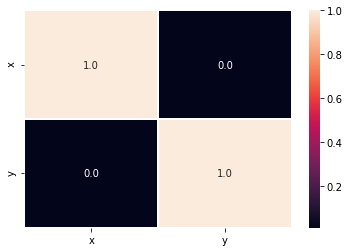

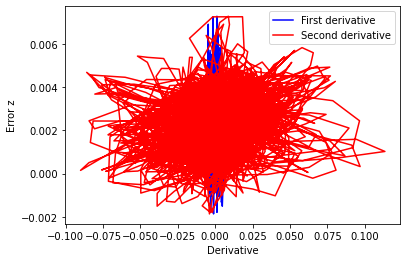

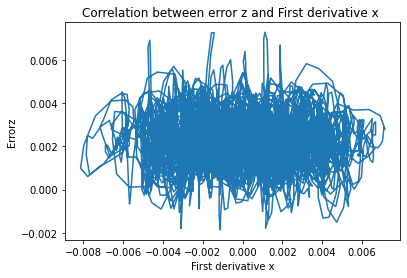

[[ 1.        -0.0369053]
 [-0.0369053  1.       ]]


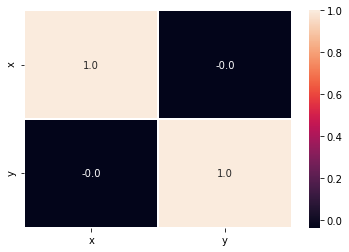

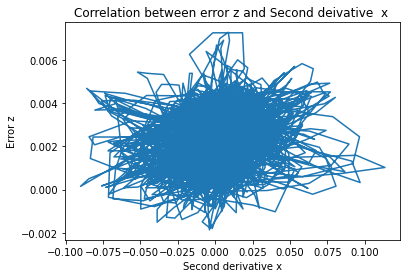

[[1.         0.17815395]
 [0.17815395 1.        ]]


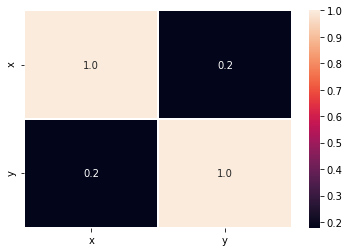

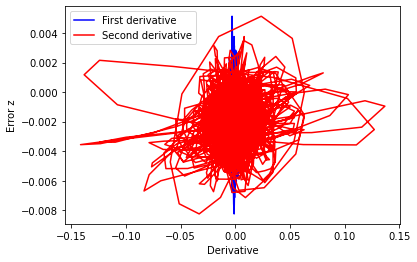

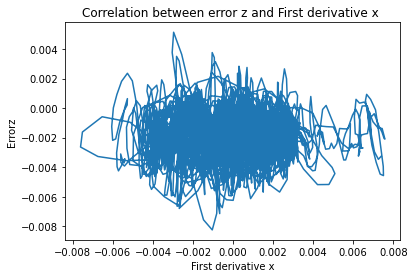

[[1.         0.01145572]
 [0.01145572 1.        ]]


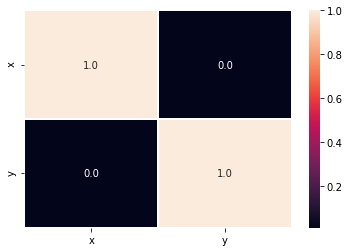

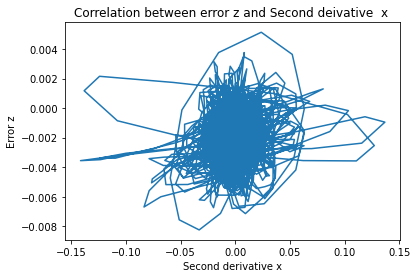

[[1.         0.09626788]
 [0.09626788 1.        ]]


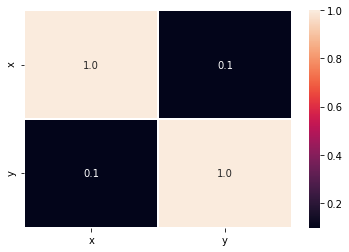

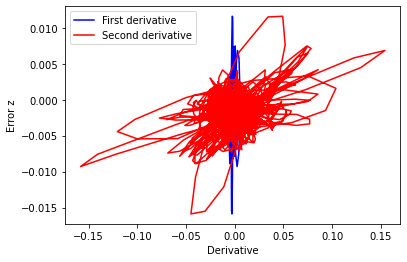

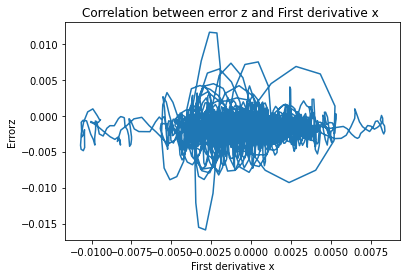

[[1.         0.03950075]
 [0.03950075 1.        ]]


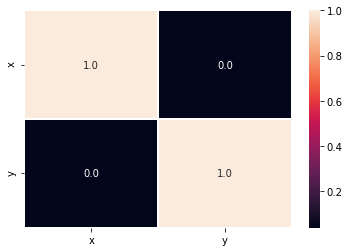

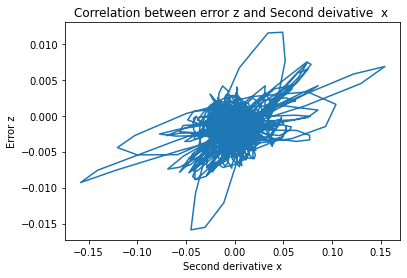

[[1.         0.22675031]
 [0.22675031 1.        ]]


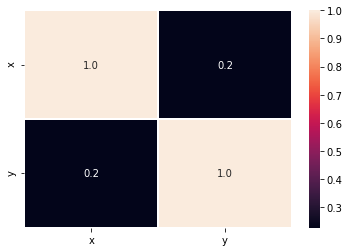

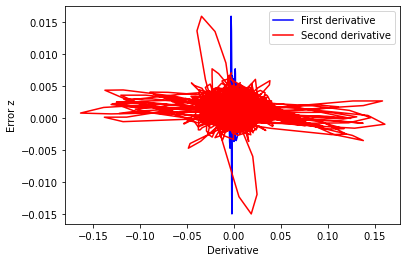

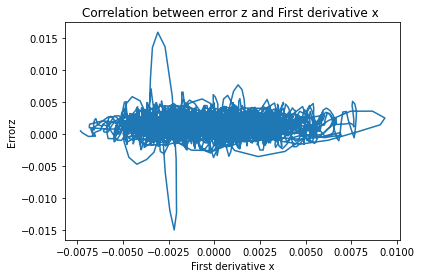

[[1.         0.01365216]
 [0.01365216 1.        ]]


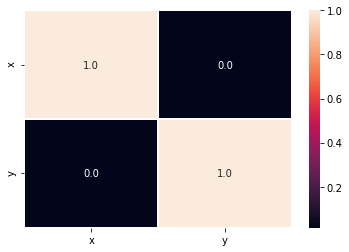

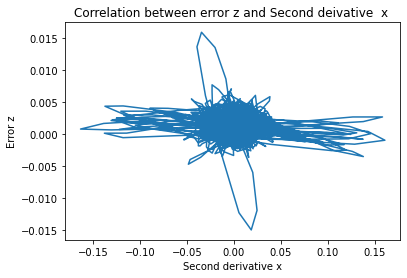

[[ 1.         -0.09409358]
 [-0.09409358  1.        ]]


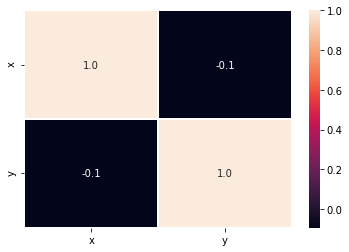

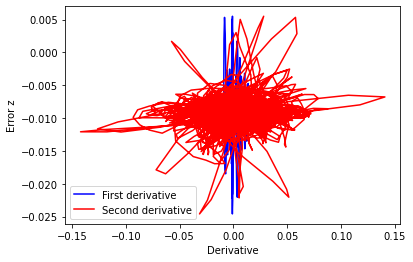

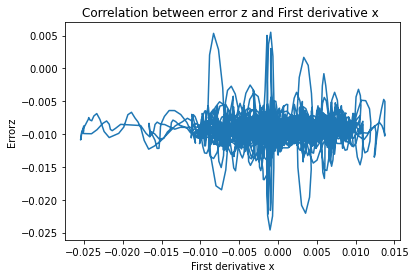

[[1.        0.0245638]
 [0.0245638 1.       ]]


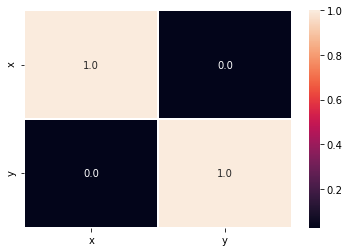

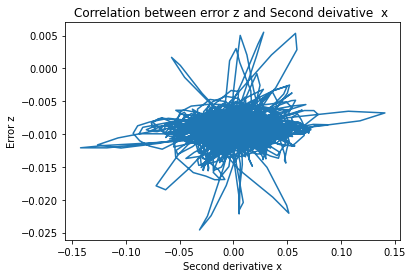

[[1.         0.05543135]
 [0.05543135 1.        ]]


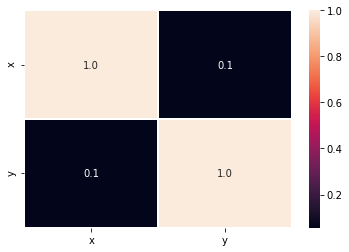

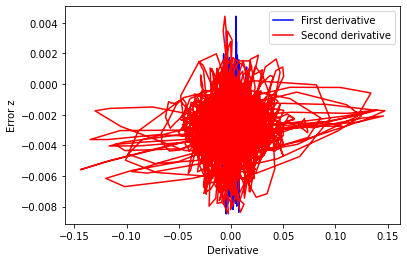

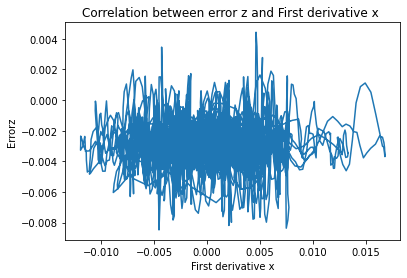

[[1.         0.01258201]
 [0.01258201 1.        ]]


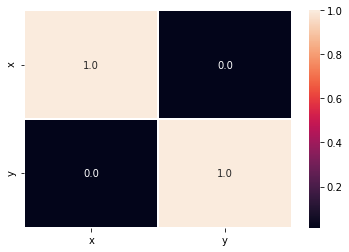

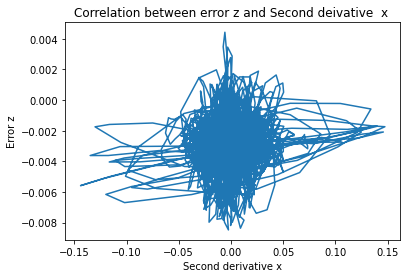

[[1.         0.08072353]
 [0.08072353 1.        ]]


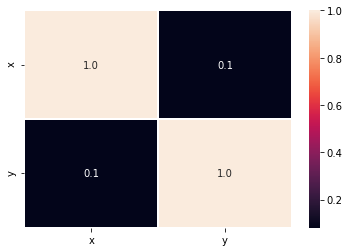

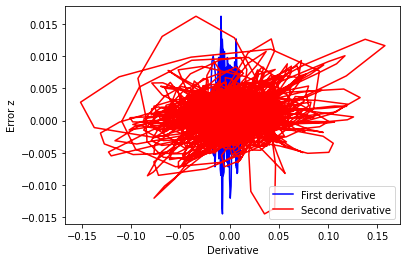

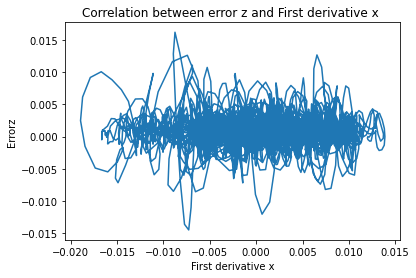

[[1.00000000e+00 3.61877967e-05]
 [3.61877967e-05 1.00000000e+00]]


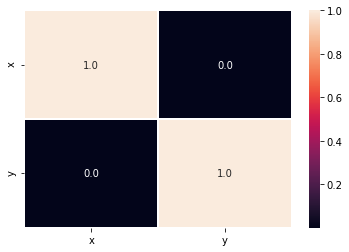

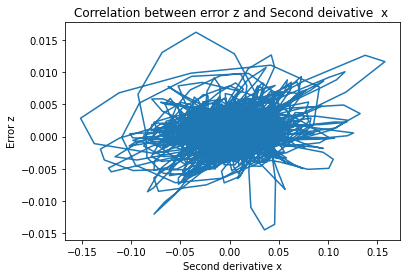

[[1.         0.10515006]
 [0.10515006 1.        ]]


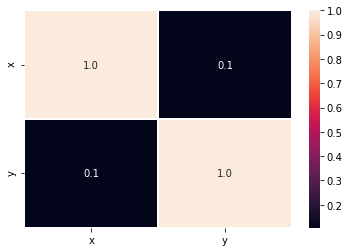

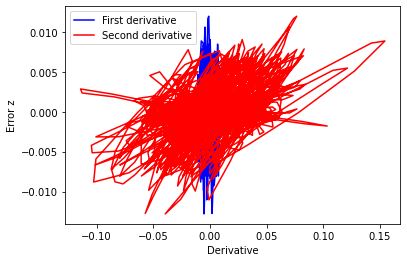

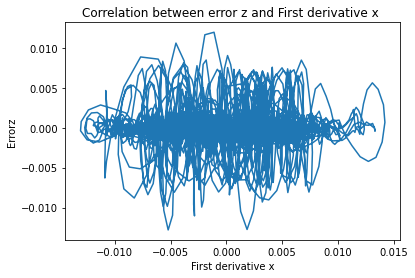

[[ 1.         -0.00334638]
 [-0.00334638  1.        ]]


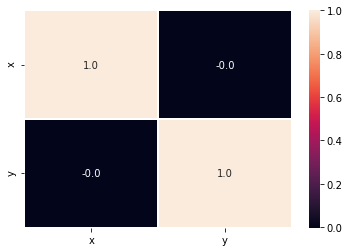

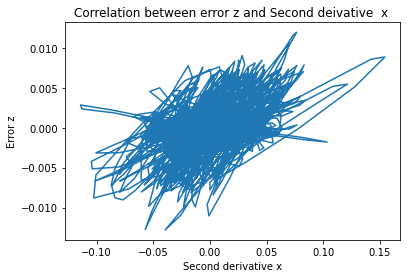

[[1.        0.3616008]
 [0.3616008 1.       ]]


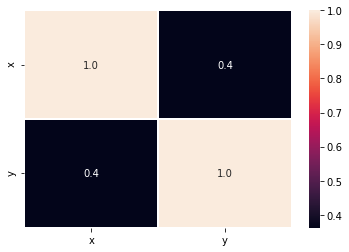

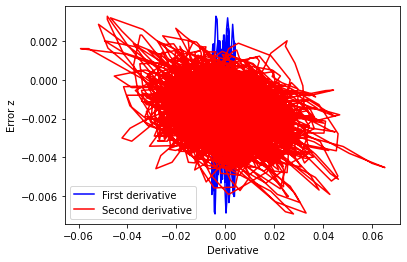

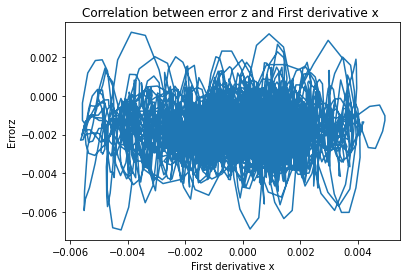

[[ 1.         -0.00174909]
 [-0.00174909  1.        ]]


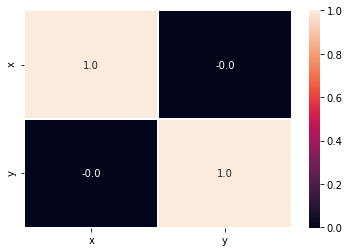

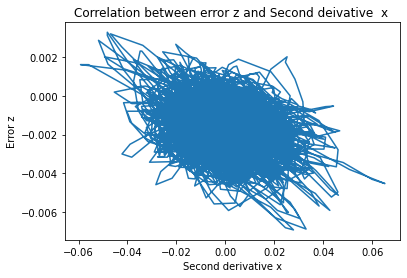

[[ 1.         -0.29007445]
 [-0.29007445  1.        ]]


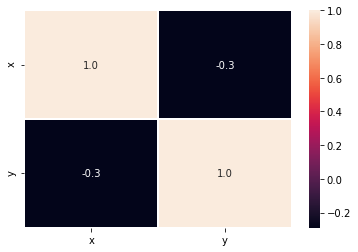

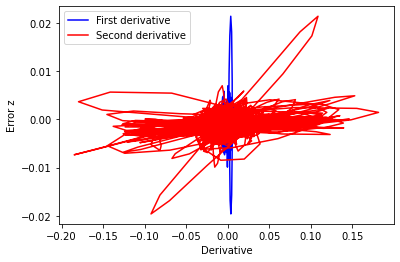

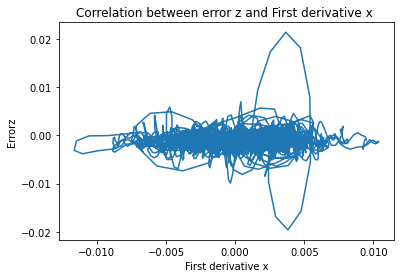

[[1.         0.02211357]
 [0.02211357 1.        ]]


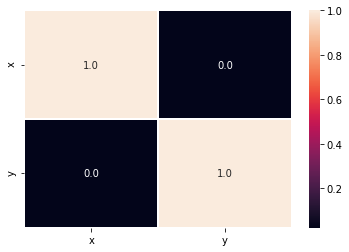

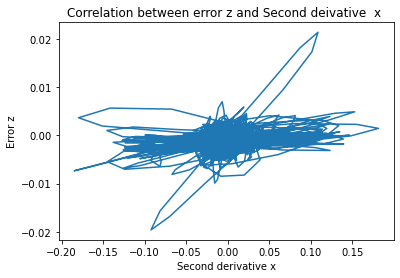

[[1.         0.24573917]
 [0.24573917 1.        ]]


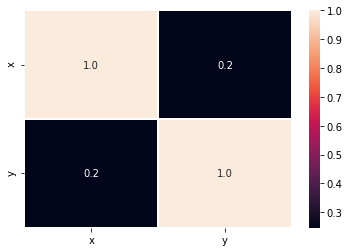

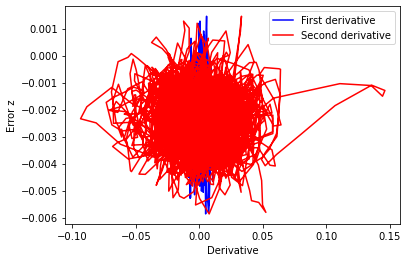

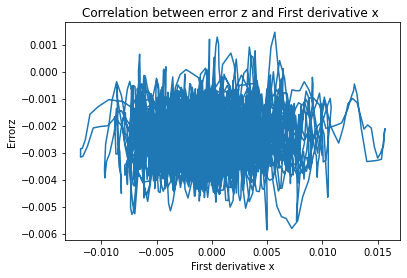

[[1.         0.01639172]
 [0.01639172 1.        ]]


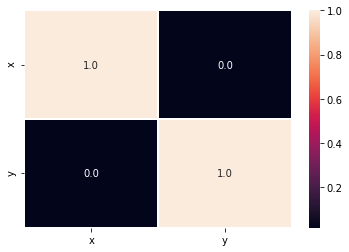

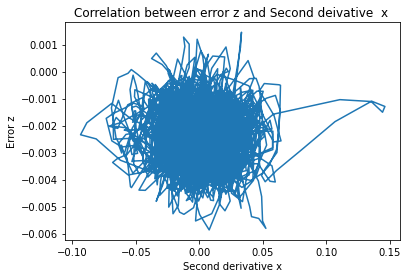

[[ 1.         -0.02027882]
 [-0.02027882  1.        ]]


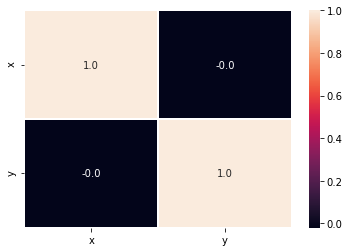

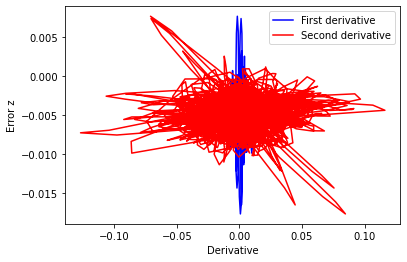

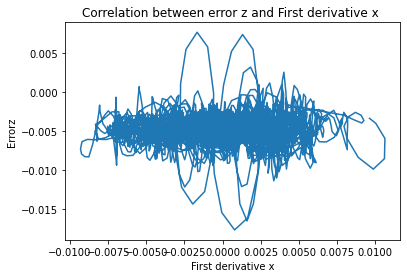

[[1.         0.02214369]
 [0.02214369 1.        ]]


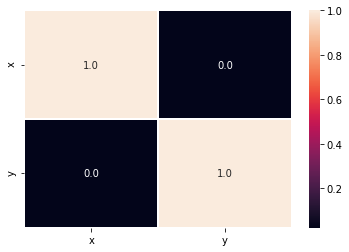

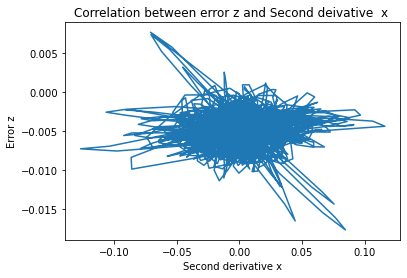

[[ 1.         -0.03491477]
 [-0.03491477  1.        ]]


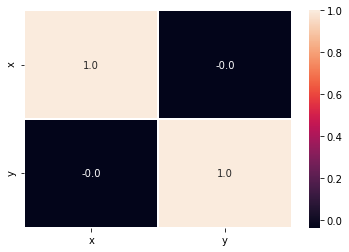

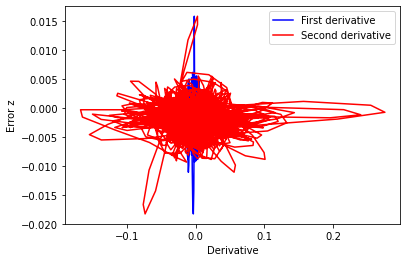

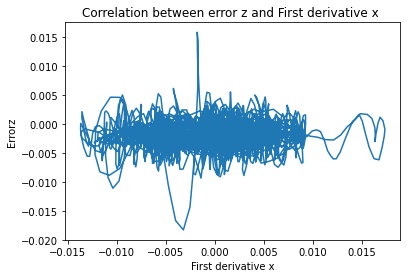

[[1.         0.05608801]
 [0.05608801 1.        ]]


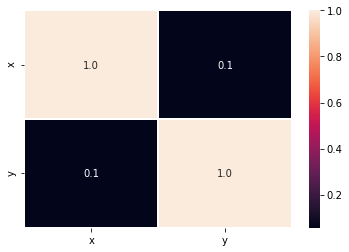

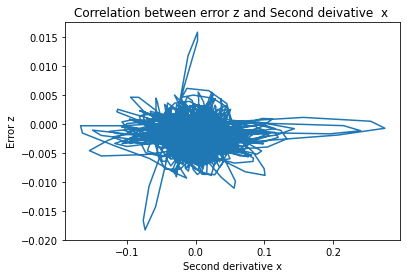

[[ 1.         -0.04637792]
 [-0.04637792  1.        ]]


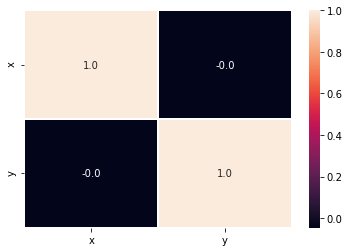

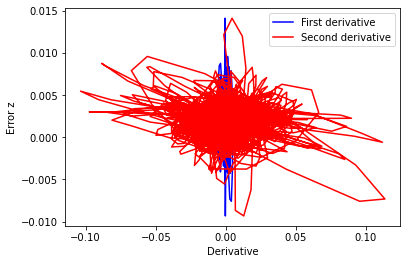

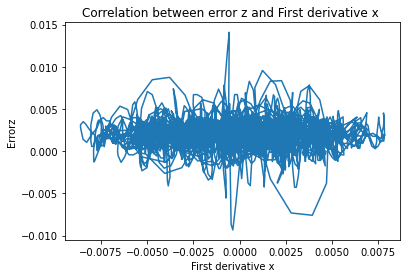

[[1.         0.00303929]
 [0.00303929 1.        ]]


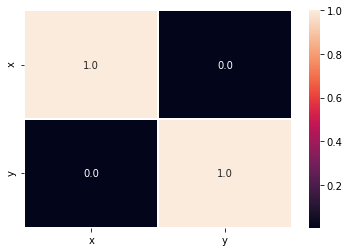

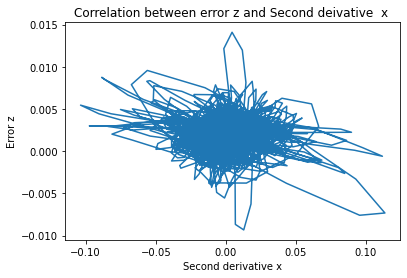

[[ 1.         -0.03299947]
 [-0.03299947  1.        ]]


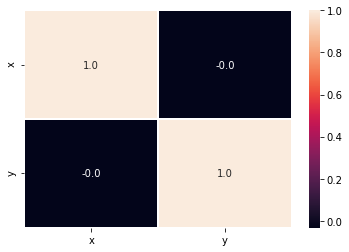

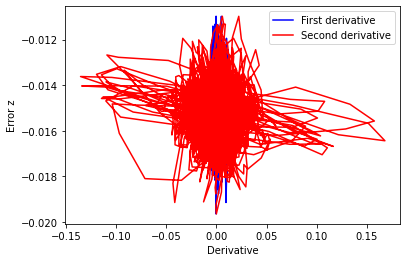

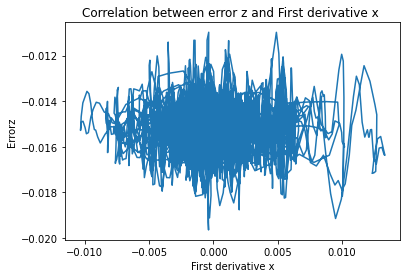

[[ 1.         -0.00431104]
 [-0.00431104  1.        ]]


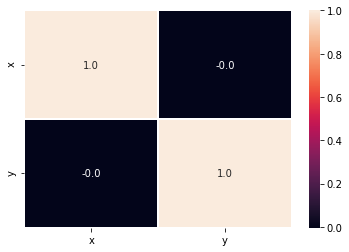

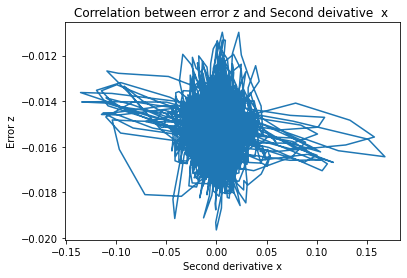

[[ 1.         -0.07886233]
 [-0.07886233  1.        ]]


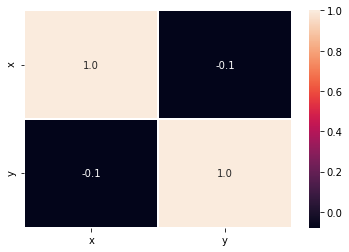

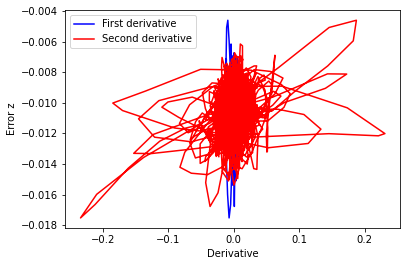

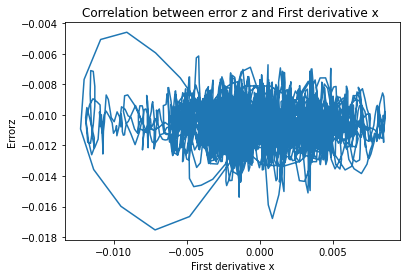

[[ 1.        -0.0313177]
 [-0.0313177  1.       ]]


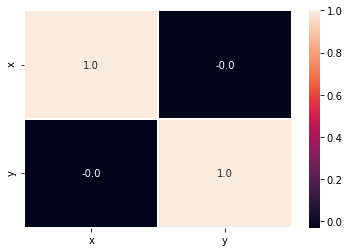

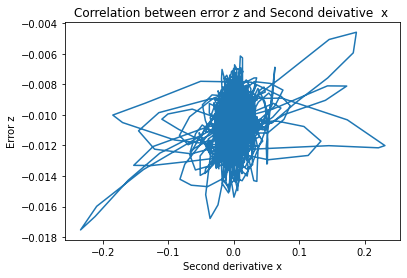

[[1.         0.19223411]
 [0.19223411 1.        ]]


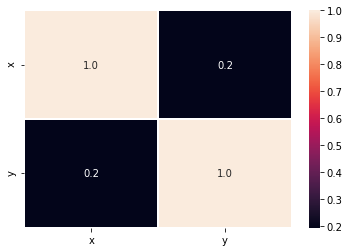

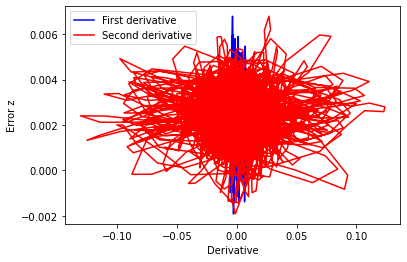

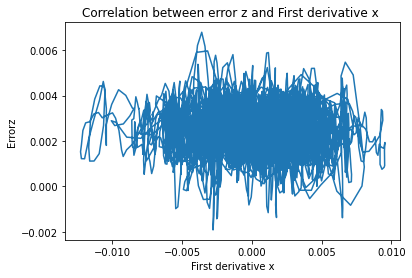

[[ 1.        -0.0585136]
 [-0.0585136  1.       ]]


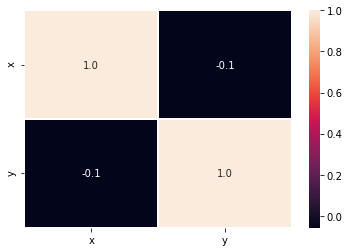

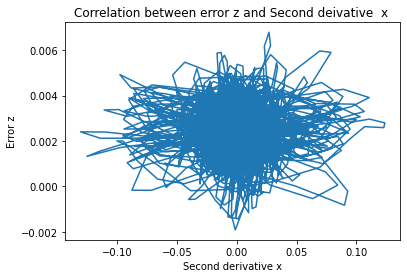

[[1.         0.01253757]
 [0.01253757 1.        ]]


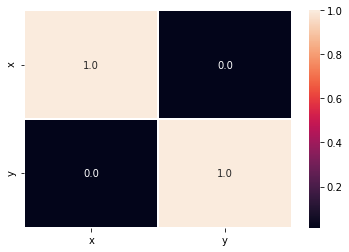

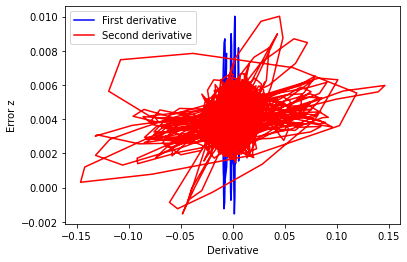

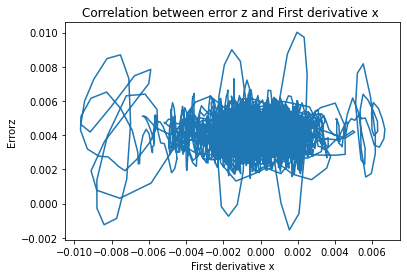

[[1.        0.0140845]
 [0.0140845 1.       ]]


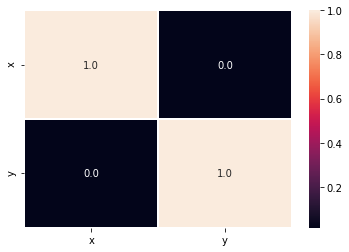

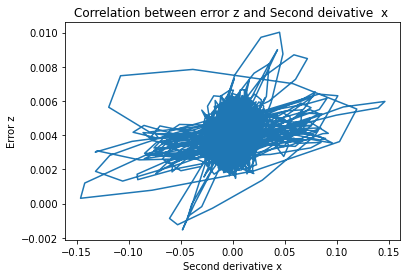

[[1.         0.24356166]
 [0.24356166 1.        ]]


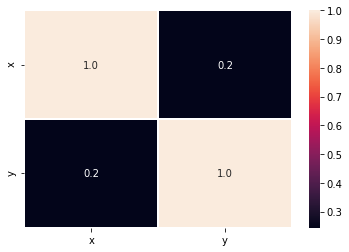

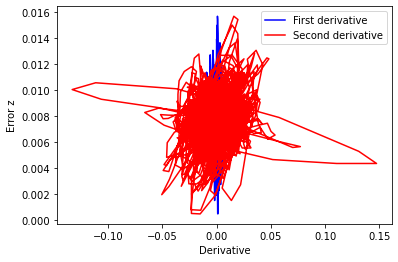

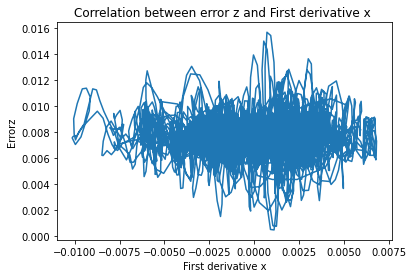

[[ 1.         -0.01474768]
 [-0.01474768  1.        ]]


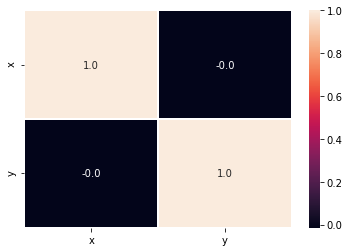

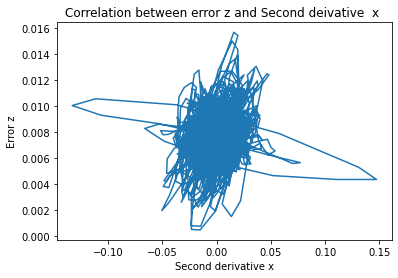

[[1.         0.13246273]
 [0.13246273 1.        ]]


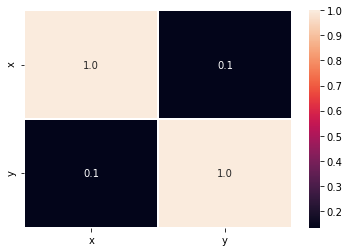

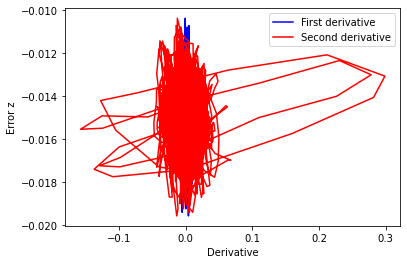

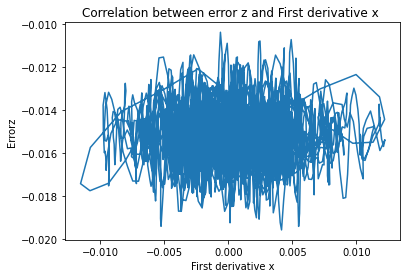

[[ 1.         -0.02268913]
 [-0.02268913  1.        ]]


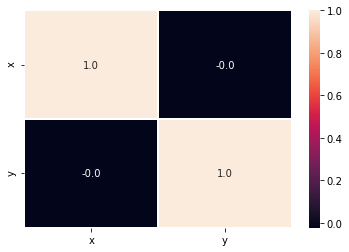

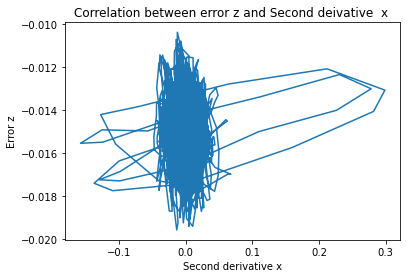

[[ 1.         -0.01637433]
 [-0.01637433  1.        ]]


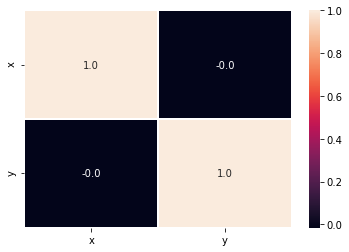

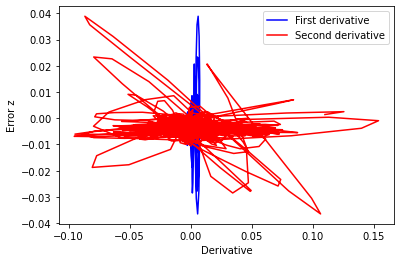

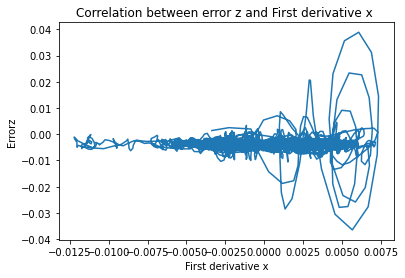

[[1.         0.00422599]
 [0.00422599 1.        ]]


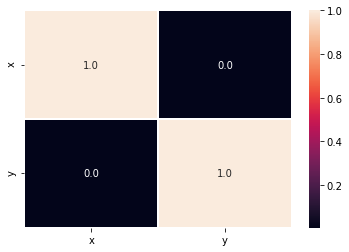

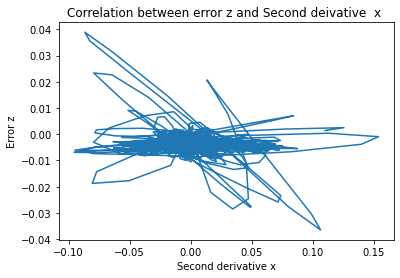

[[ 1.         -0.16298768]
 [-0.16298768  1.        ]]


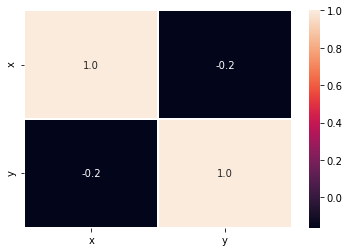

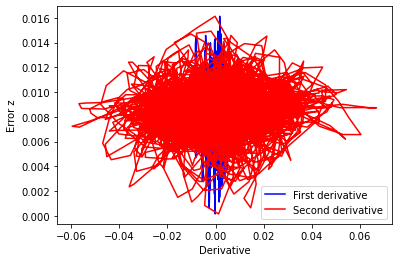

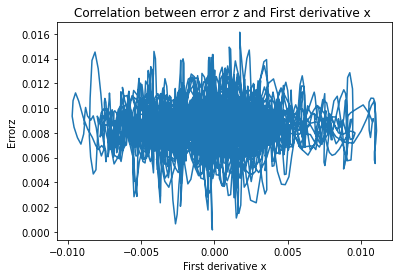

[[1.         0.02035676]
 [0.02035676 1.        ]]


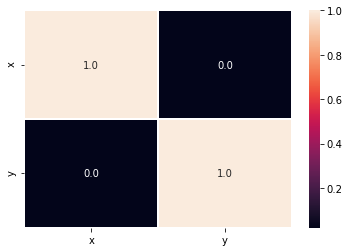

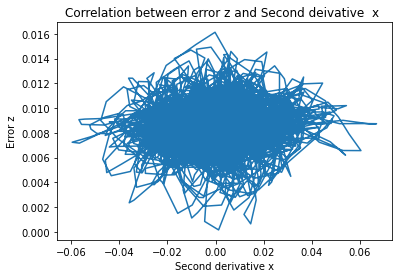

[[1.         0.07409878]
 [0.07409878 1.        ]]


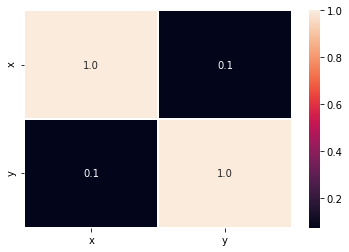

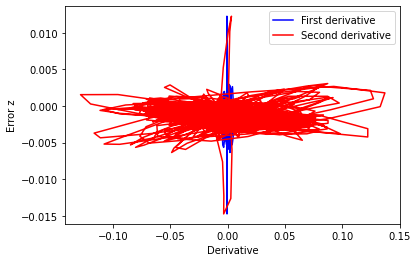

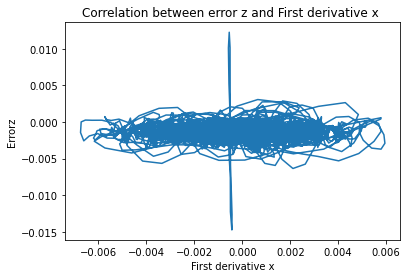

[[ 1.         -0.01636639]
 [-0.01636639  1.        ]]


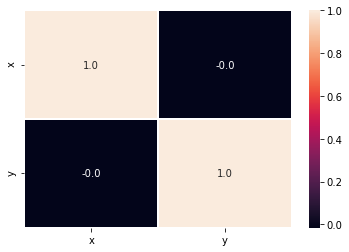

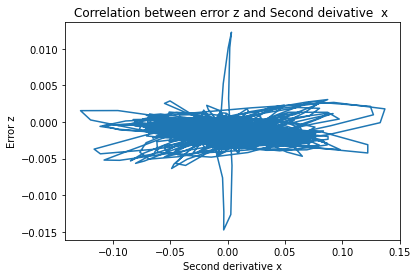

[[ 1.         -0.05247599]
 [-0.05247599  1.        ]]


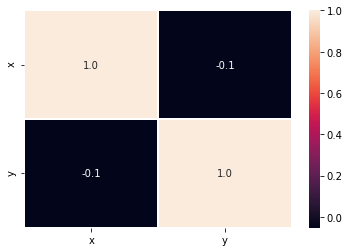

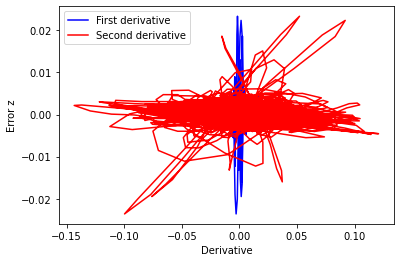

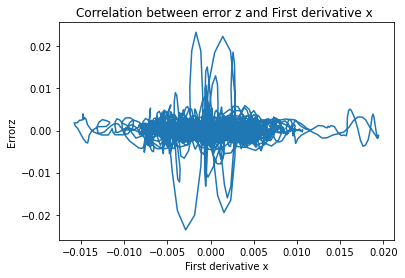

[[ 1.         -0.00529605]
 [-0.00529605  1.        ]]


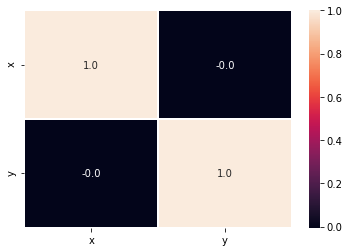

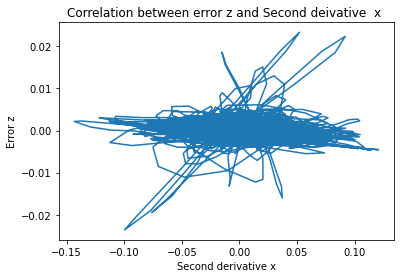

[[ 1.         -0.00648979]
 [-0.00648979  1.        ]]


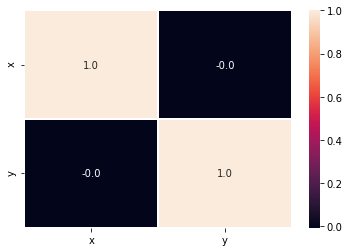

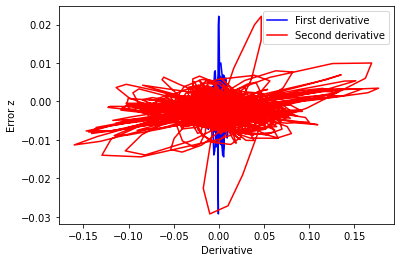

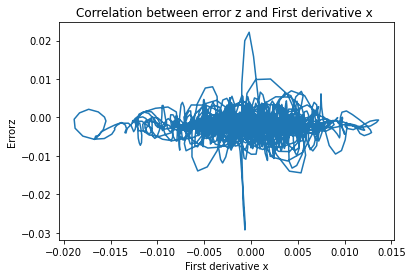

[[1.        0.0098395]
 [0.0098395 1.       ]]


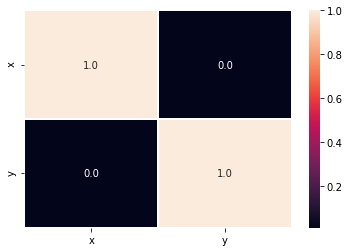

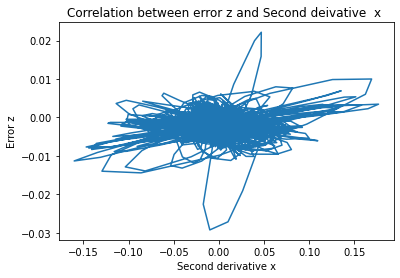

[[1.         0.05746397]
 [0.05746397 1.        ]]


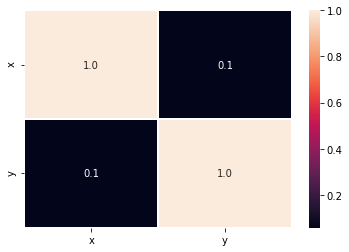

In [25]:
for s in range(1,50):
    plt.figure()
    plt.plot(d1x[s-1,:],errorZ[s-1,:],color='blue',label='First derivative')
    plt.plot(d2x[s-1,:],errorZ[s-1,:],color='red',label='Second derivative')
    plt.xlabel("Derivative")
    plt.ylabel("Error z")
    plt.legend()
    plt.show()

    plt.plot(d1x[s-1,:],errorZ[s-1,:])
    plt.xlabel("First derivative x")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and First derivative x ")
    plt.show()
    r=np.corrcoef(d1x[s-1,:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':d1x[s-1,:],
          'y': errorZ[s-1,:],
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    plt.plot(d2x[s-1,:],errorZ[s-1,:])
    plt.xlabel("Second derivative x")
    plt.ylabel("Error z")
    plt.title("Correlation between error z and Second deivative  x ")
    plt.show()
    r=np.corrcoef(d2x[s-1,:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':d2x[s-1,:],
          'y': errorZ[s-1,:],
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation between error and first and second derivative of z

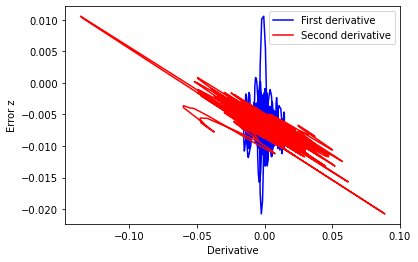

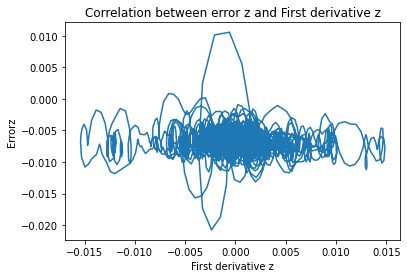

[[ 1.         -0.05740804]
 [-0.05740804  1.        ]]


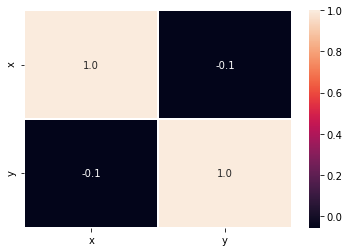

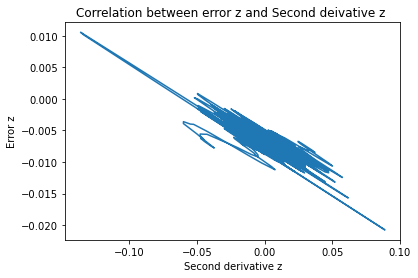

[[ 1.         -0.86106619]
 [-0.86106619  1.        ]]


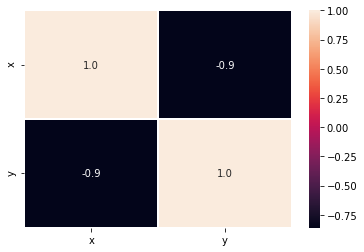

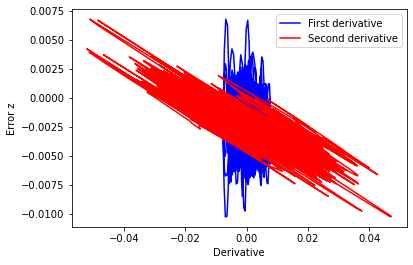

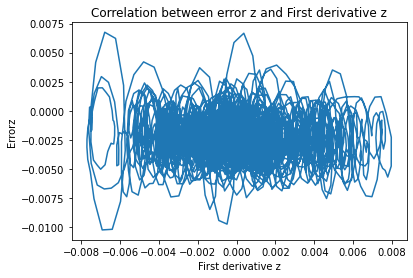

[[ 1.         -0.04784263]
 [-0.04784263  1.        ]]


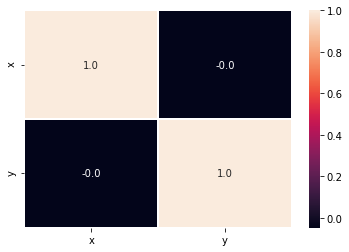

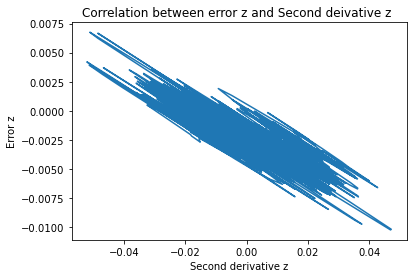

[[ 1.         -0.86753541]
 [-0.86753541  1.        ]]


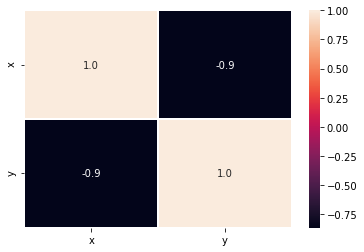

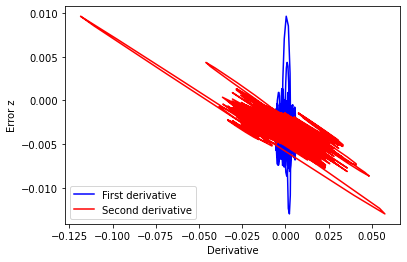

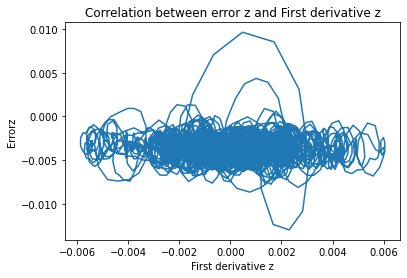

[[ 1.         -0.08771094]
 [-0.08771094  1.        ]]


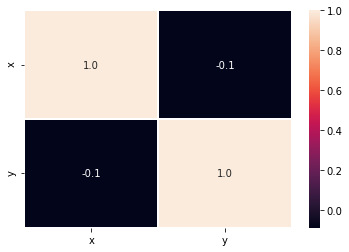

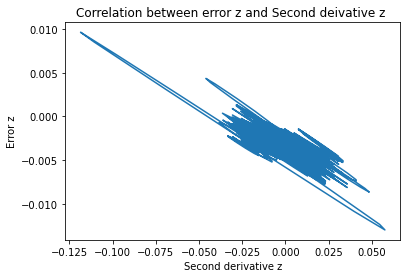

[[ 1.        -0.7943159]
 [-0.7943159  1.       ]]


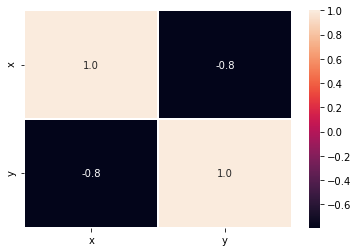

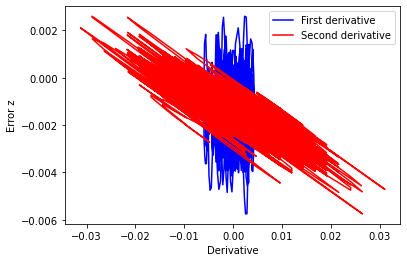

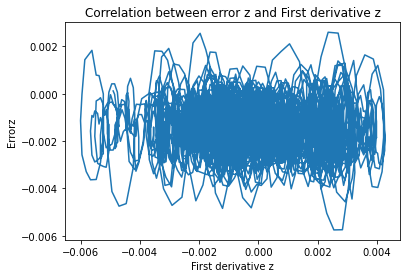

[[ 1.         -0.05654455]
 [-0.05654455  1.        ]]


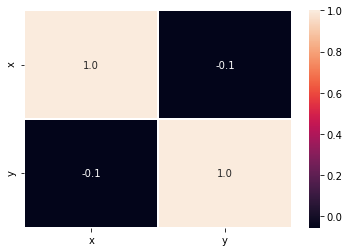

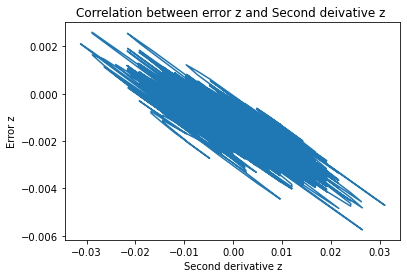

[[ 1.         -0.85821768]
 [-0.85821768  1.        ]]


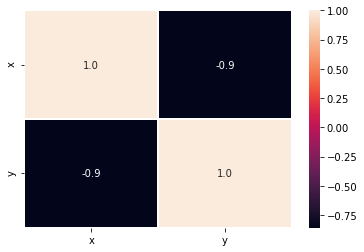

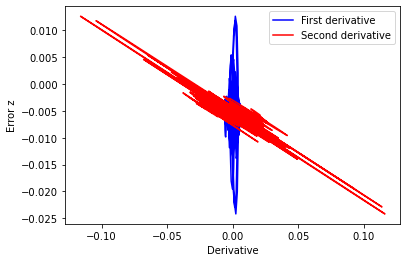

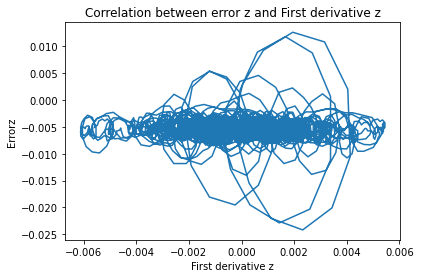

[[ 1.         -0.04238903]
 [-0.04238903  1.        ]]


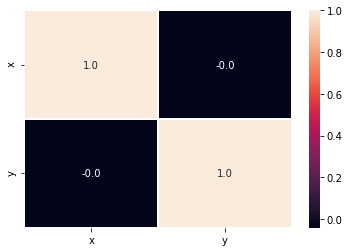

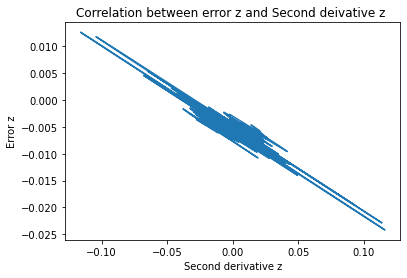

[[ 1.         -0.91608055]
 [-0.91608055  1.        ]]


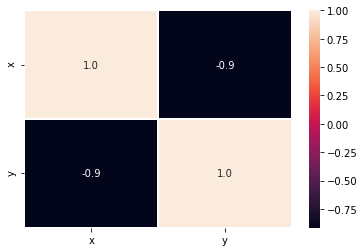

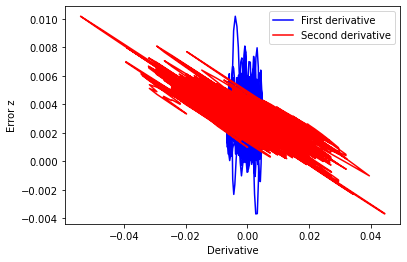

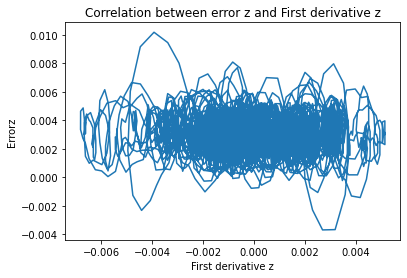

[[ 1.         -0.06378323]
 [-0.06378323  1.        ]]


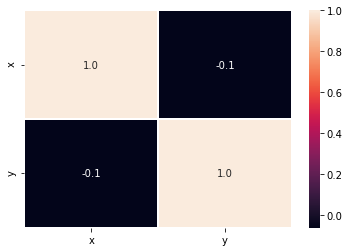

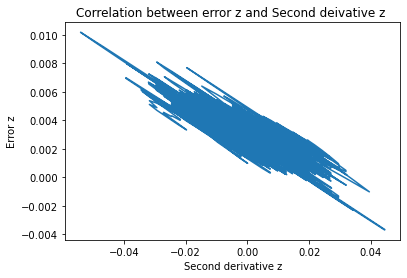

[[ 1.         -0.84508369]
 [-0.84508369  1.        ]]


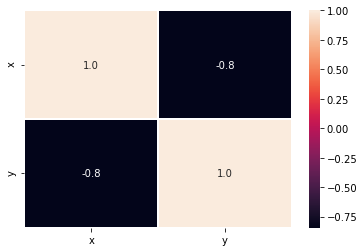

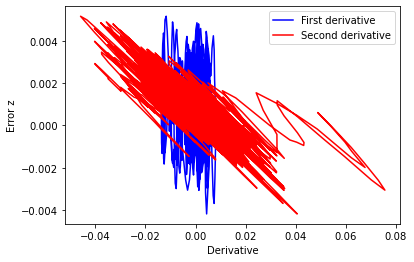

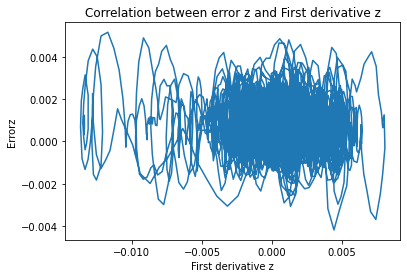

[[ 1.         -0.07352228]
 [-0.07352228  1.        ]]


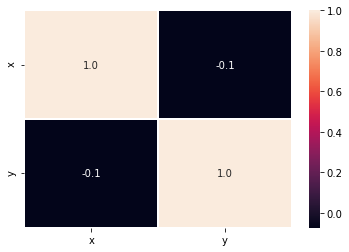

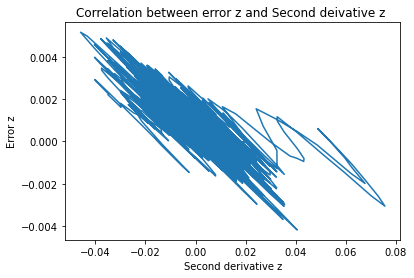

[[ 1.         -0.86103673]
 [-0.86103673  1.        ]]


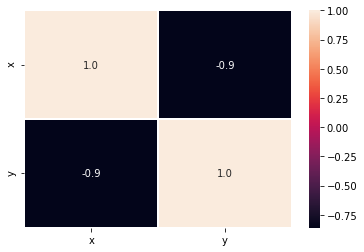

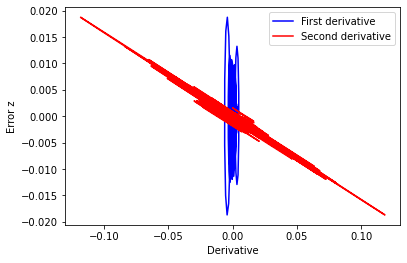

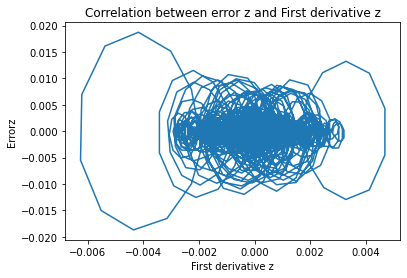

[[ 1.         -0.01455634]
 [-0.01455634  1.        ]]


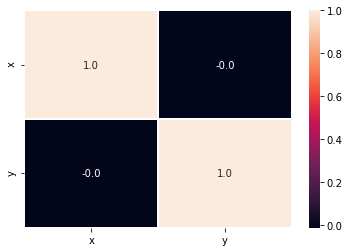

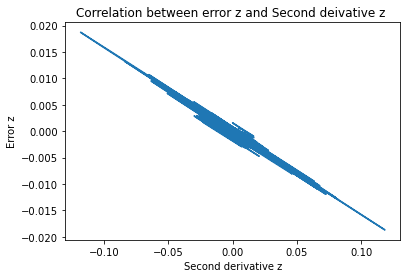

[[ 1.        -0.9796815]
 [-0.9796815  1.       ]]


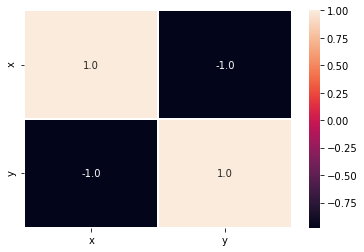

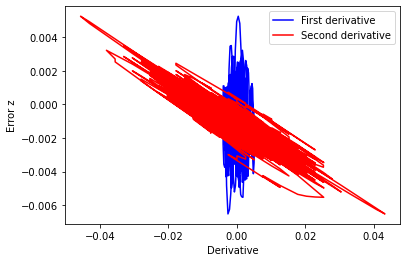

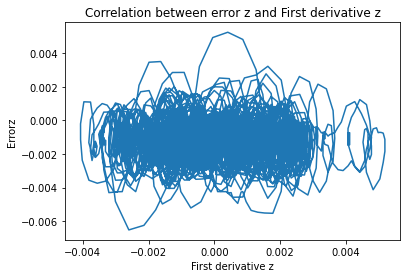

[[ 1.         -0.02831296]
 [-0.02831296  1.        ]]


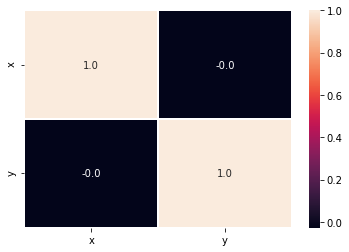

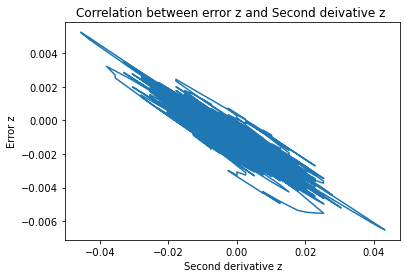

[[ 1.         -0.90886325]
 [-0.90886325  1.        ]]


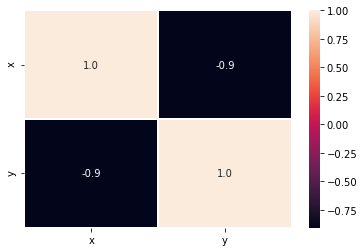

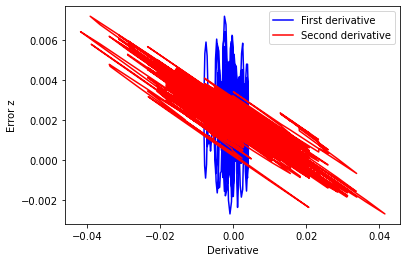

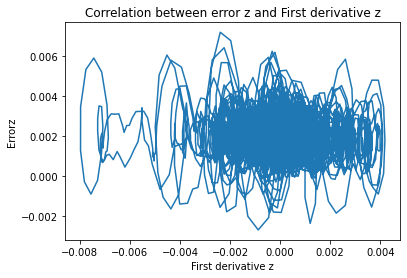

[[ 1.         -0.05148765]
 [-0.05148765  1.        ]]


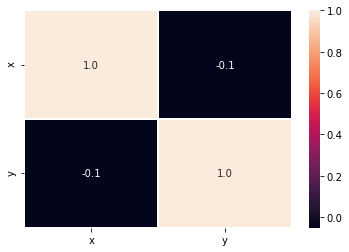

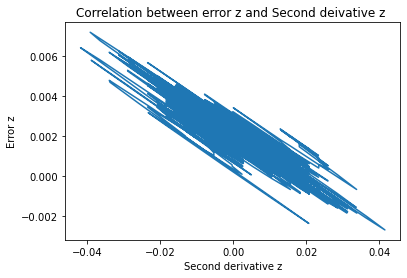

[[ 1.         -0.90125384]
 [-0.90125384  1.        ]]


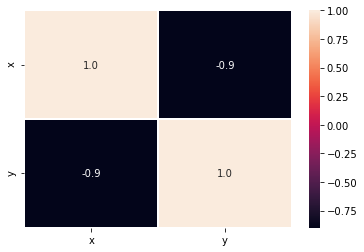

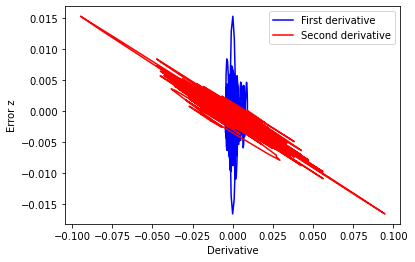

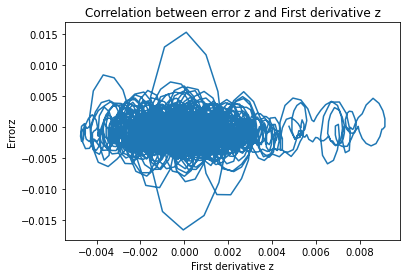

[[ 1.         -0.00678805]
 [-0.00678805  1.        ]]


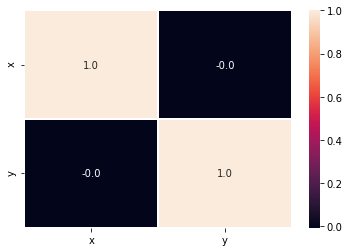

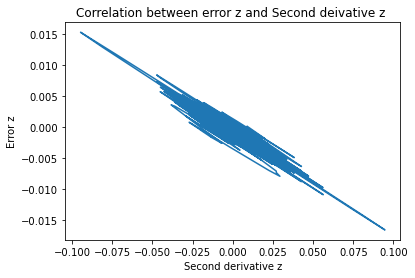

[[ 1.         -0.95112669]
 [-0.95112669  1.        ]]


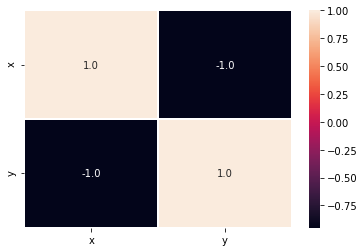

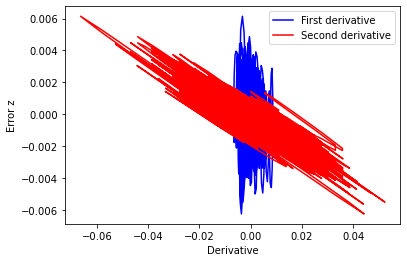

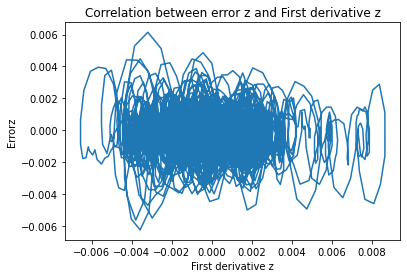

[[ 1.         -0.03357854]
 [-0.03357854  1.        ]]


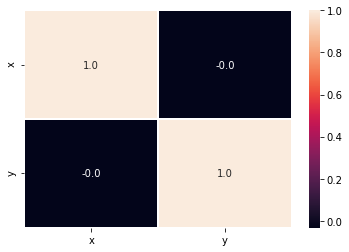

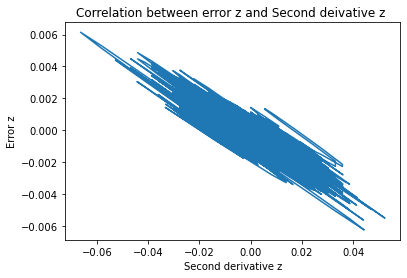

[[ 1.         -0.89929776]
 [-0.89929776  1.        ]]


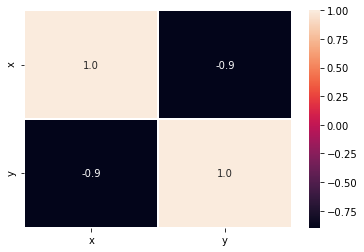

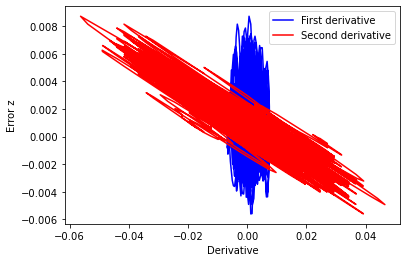

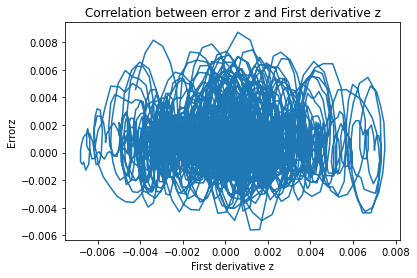

[[ 1.         -0.02269975]
 [-0.02269975  1.        ]]


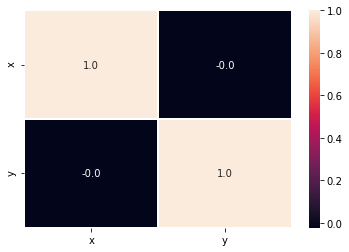

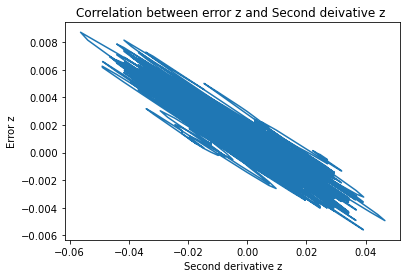

[[ 1.         -0.92660582]
 [-0.92660582  1.        ]]


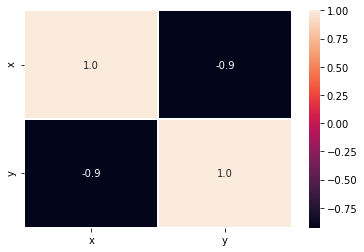

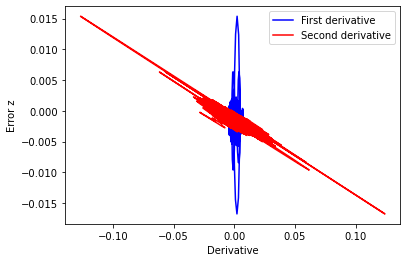

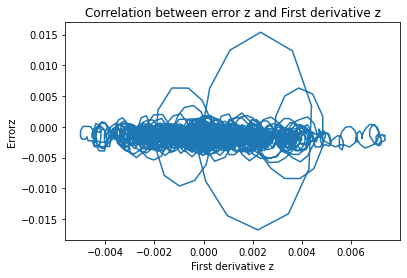

[[ 1.         -0.06420215]
 [-0.06420215  1.        ]]


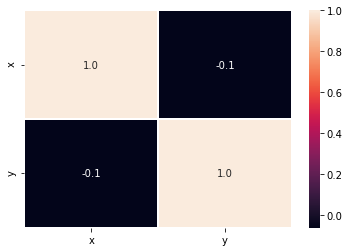

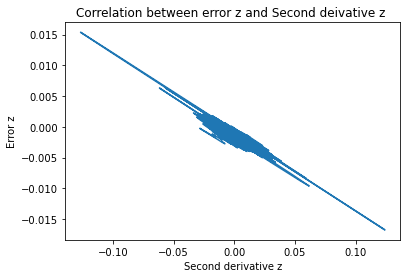

[[ 1.         -0.91658958]
 [-0.91658958  1.        ]]


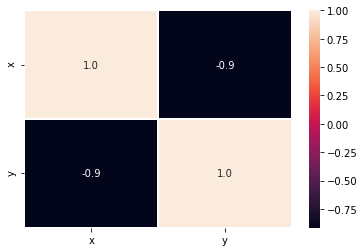

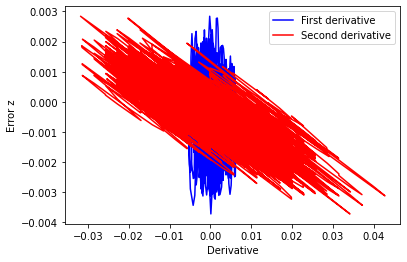

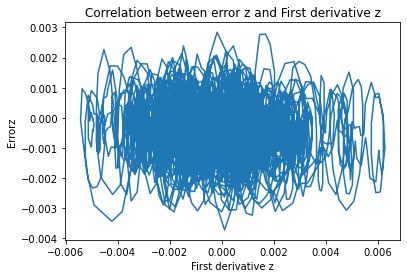

[[ 1.         -0.07510683]
 [-0.07510683  1.        ]]


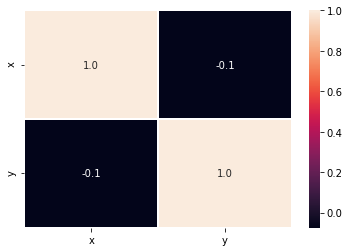

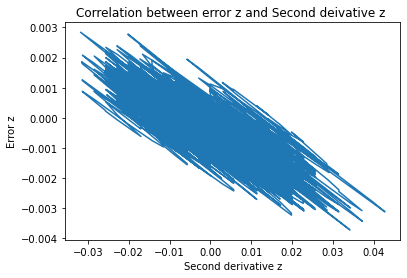

[[ 1.         -0.81197096]
 [-0.81197096  1.        ]]


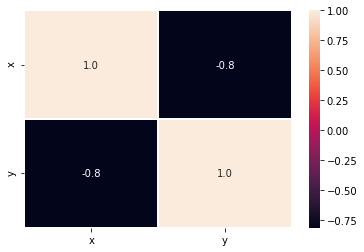

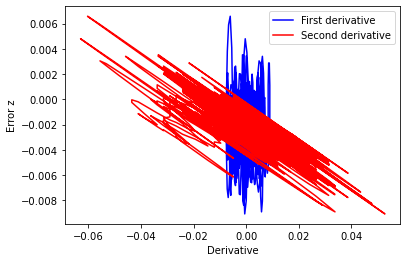

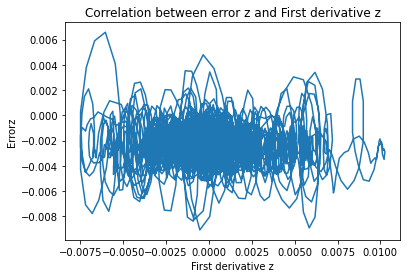

[[ 1.         -0.03995666]
 [-0.03995666  1.        ]]


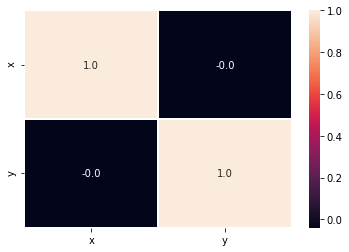

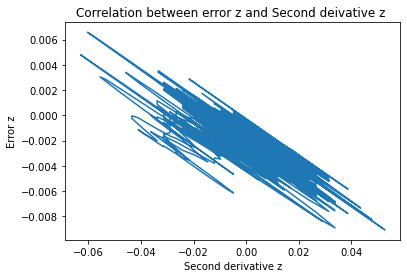

[[ 1.         -0.86777989]
 [-0.86777989  1.        ]]


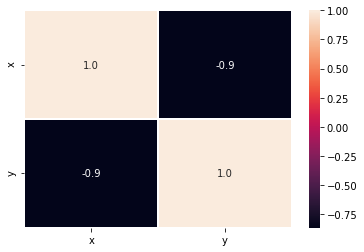

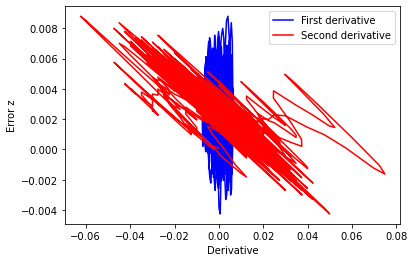

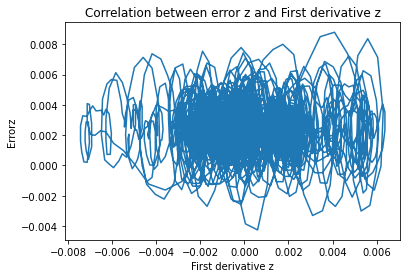

[[ 1.         -0.04472582]
 [-0.04472582  1.        ]]


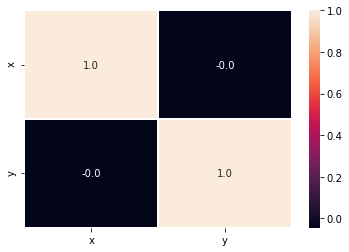

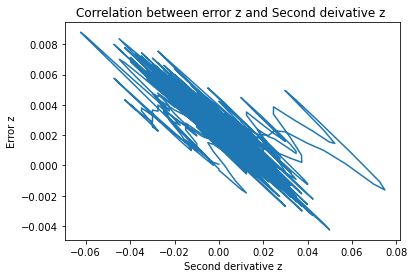

[[ 1.         -0.88842004]
 [-0.88842004  1.        ]]


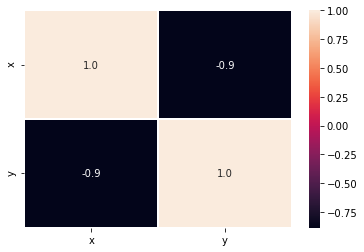

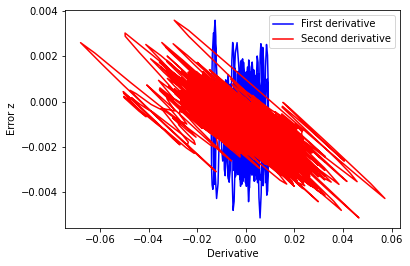

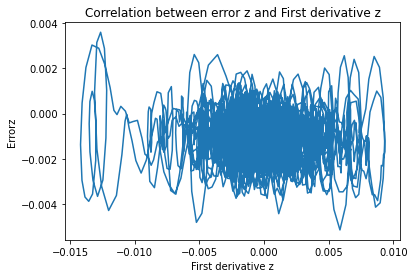

[[ 1.         -0.08901382]
 [-0.08901382  1.        ]]


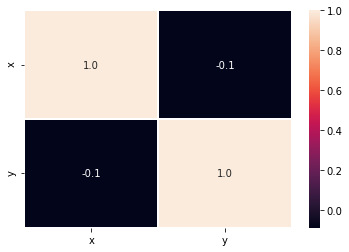

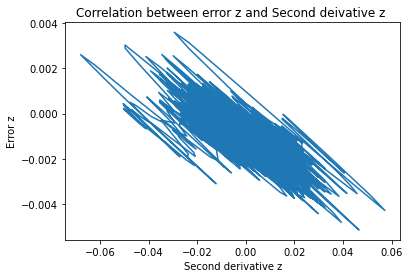

[[ 1.         -0.78125465]
 [-0.78125465  1.        ]]


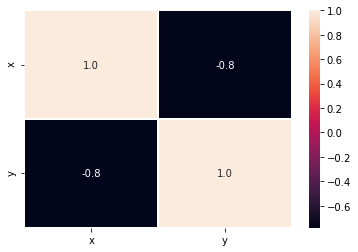

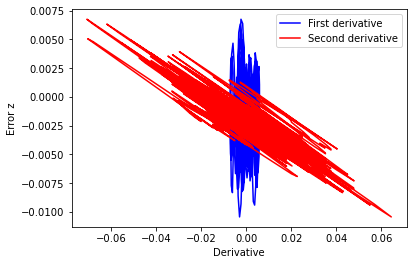

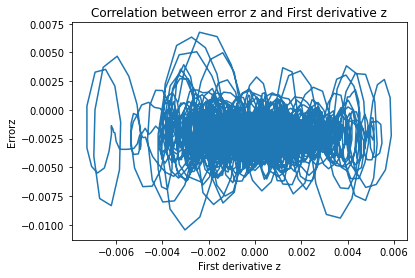

[[ 1.         -0.06100207]
 [-0.06100207  1.        ]]


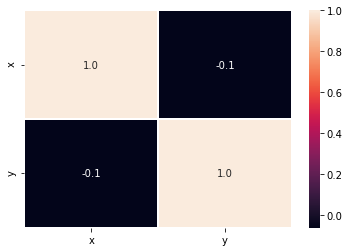

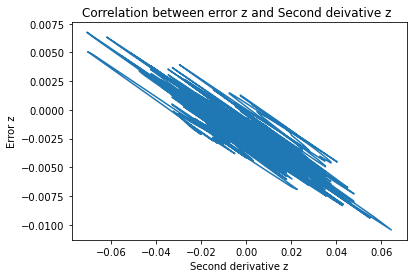

[[ 1.         -0.87948072]
 [-0.87948072  1.        ]]


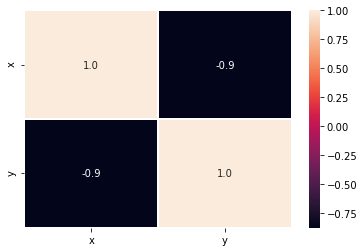

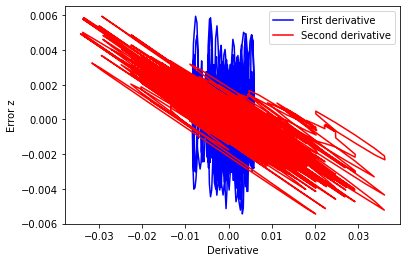

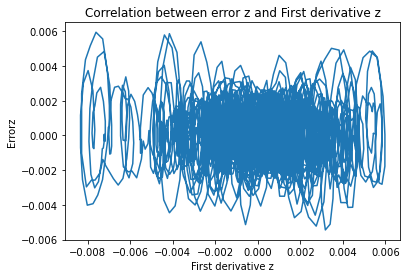

[[ 1.         -0.05669121]
 [-0.05669121  1.        ]]


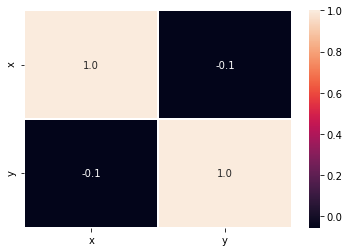

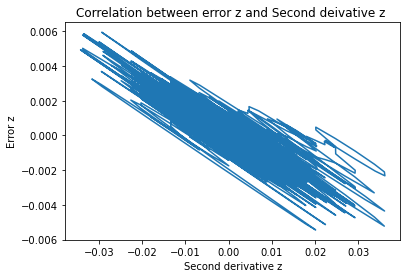

[[ 1.        -0.8887597]
 [-0.8887597  1.       ]]


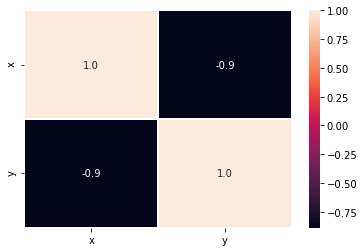

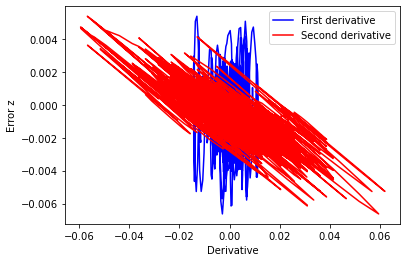

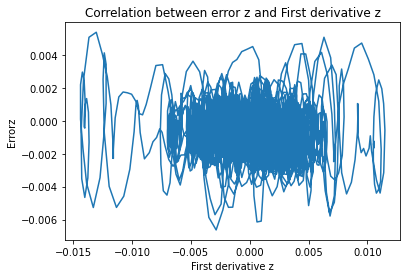

[[ 1.         -0.10154916]
 [-0.10154916  1.        ]]


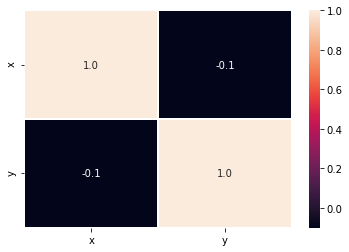

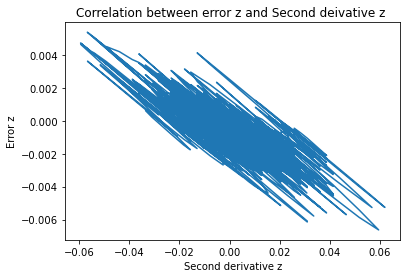

[[ 1.         -0.82922013]
 [-0.82922013  1.        ]]


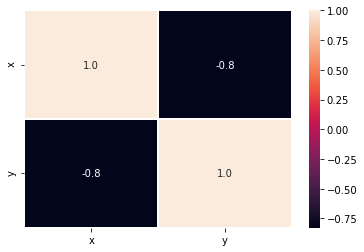

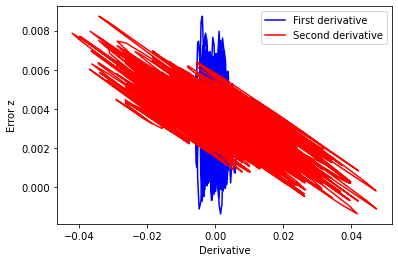

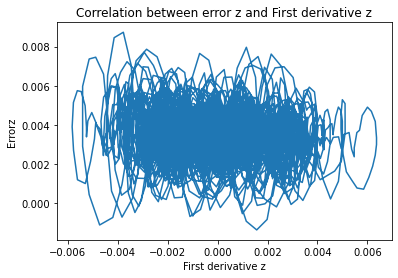

[[ 1.         -0.11547901]
 [-0.11547901  1.        ]]


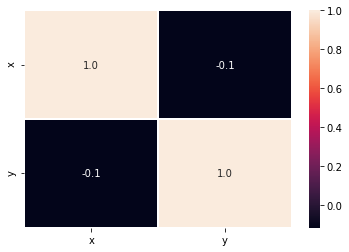

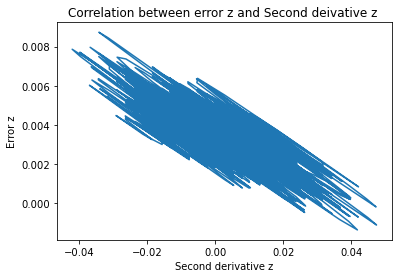

[[ 1.         -0.78787388]
 [-0.78787388  1.        ]]


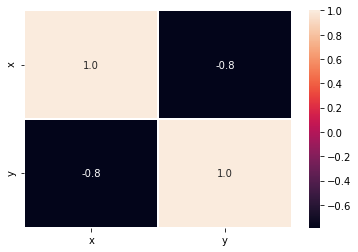

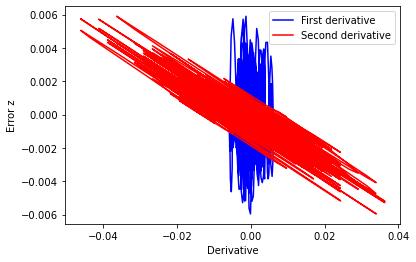

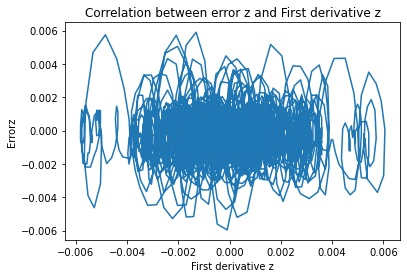

[[ 1.        -0.0311157]
 [-0.0311157  1.       ]]


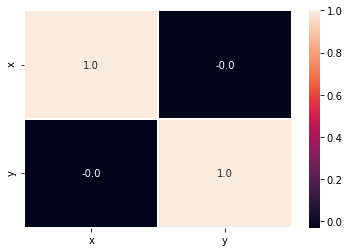

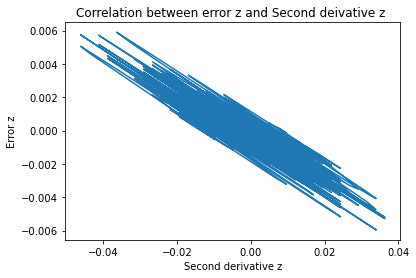

[[ 1.         -0.92457114]
 [-0.92457114  1.        ]]


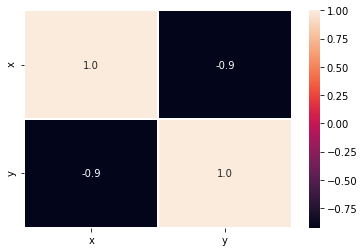

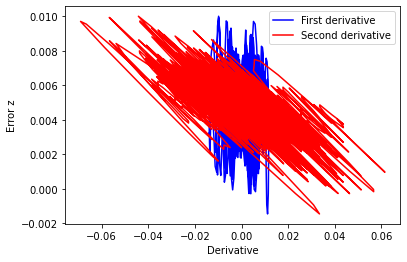

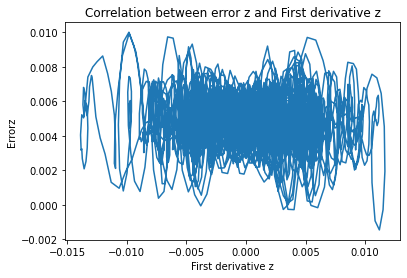

[[ 1.         -0.07812407]
 [-0.07812407  1.        ]]


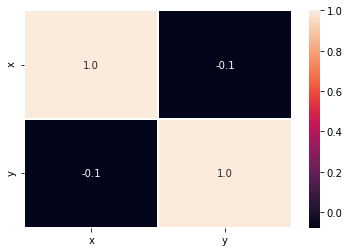

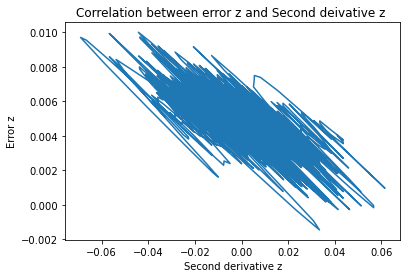

[[ 1.       -0.753744]
 [-0.753744  1.      ]]


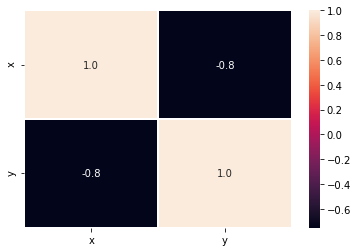

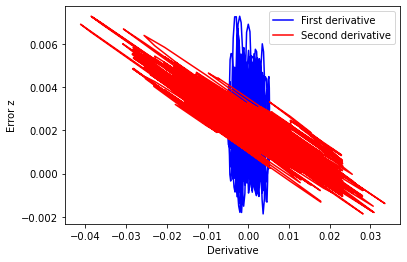

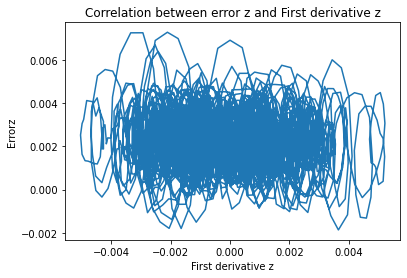

[[ 1.         -0.05840365]
 [-0.05840365  1.        ]]


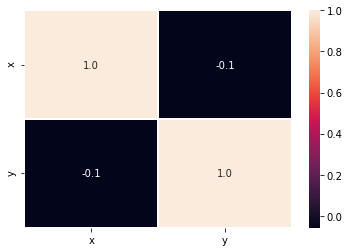

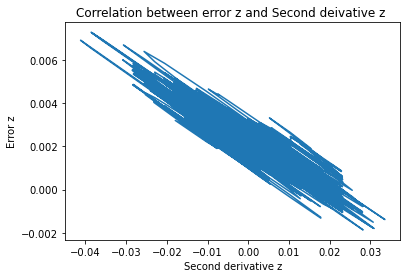

[[ 1.         -0.91678892]
 [-0.91678892  1.        ]]


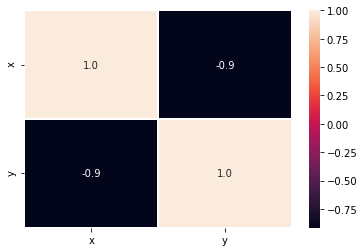

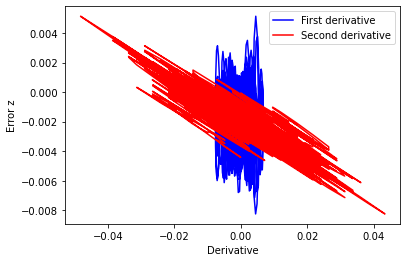

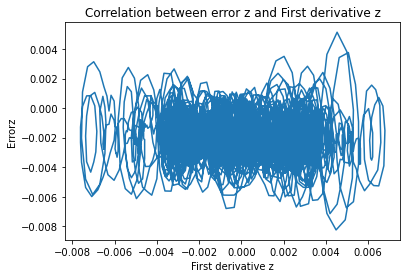

[[ 1.        -0.0766453]
 [-0.0766453  1.       ]]


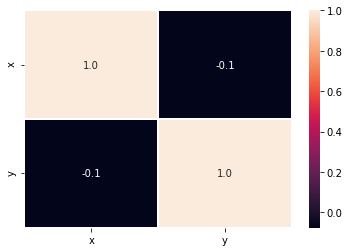

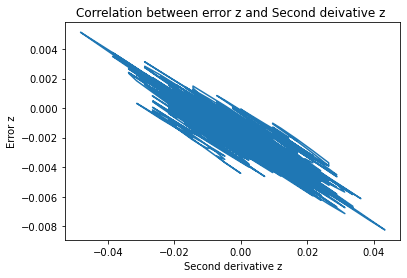

[[ 1.        -0.9036265]
 [-0.9036265  1.       ]]


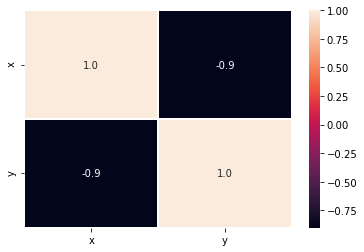

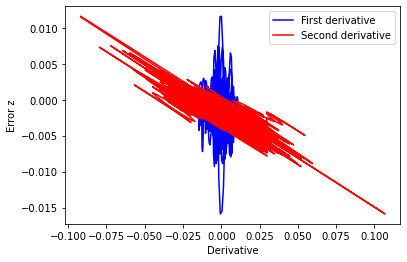

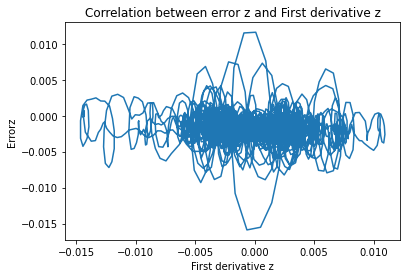

[[ 1.         -0.09268842]
 [-0.09268842  1.        ]]


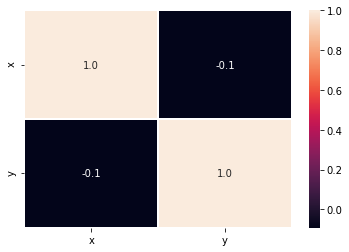

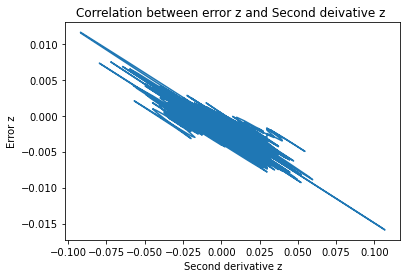

[[ 1.         -0.85405531]
 [-0.85405531  1.        ]]


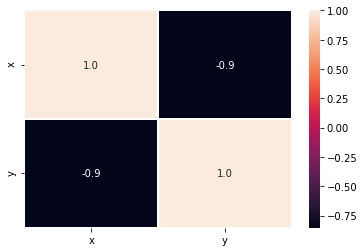

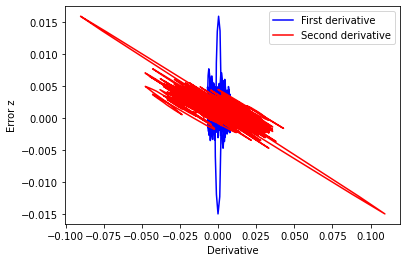

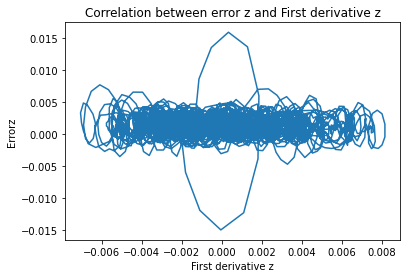

[[ 1.         -0.07833213]
 [-0.07833213  1.        ]]


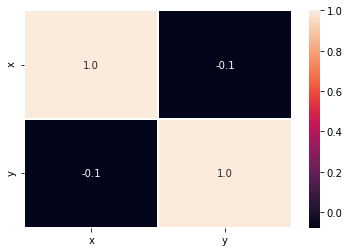

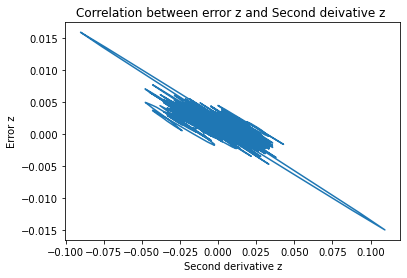

[[ 1.         -0.80127847]
 [-0.80127847  1.        ]]


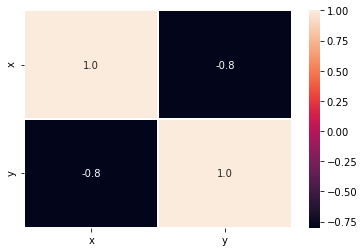

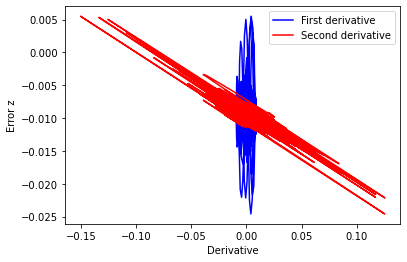

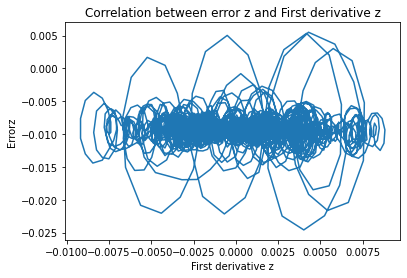

[[ 1.         -0.06100832]
 [-0.06100832  1.        ]]


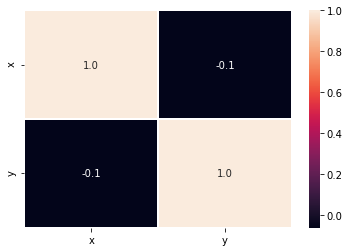

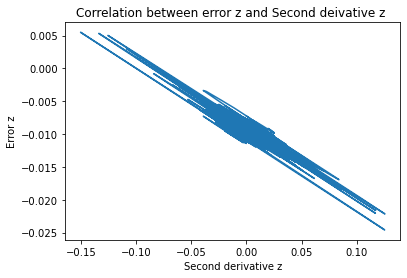

[[ 1.         -0.90744433]
 [-0.90744433  1.        ]]


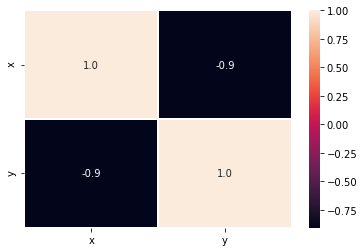

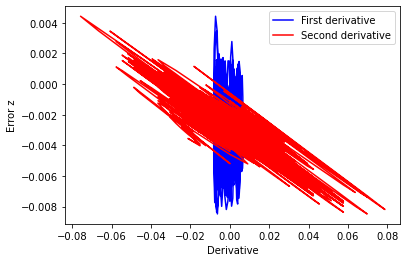

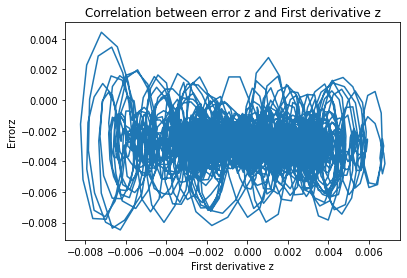

[[ 1.         -0.06546513]
 [-0.06546513  1.        ]]


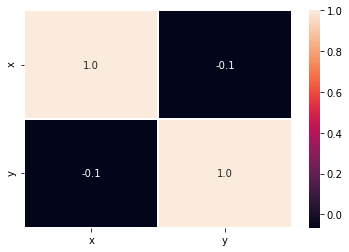

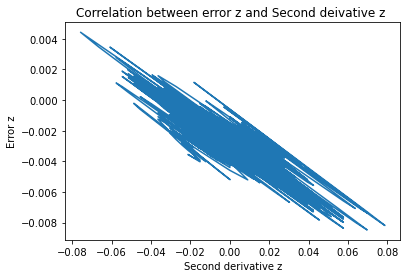

[[ 1.         -0.88163089]
 [-0.88163089  1.        ]]


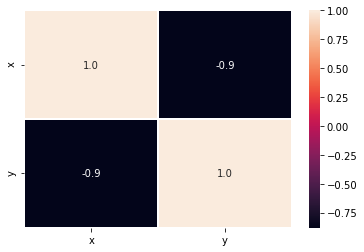

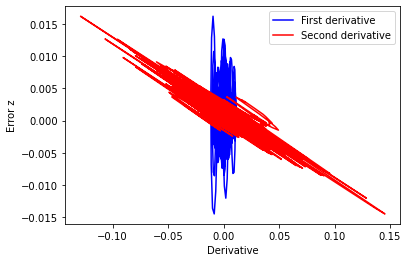

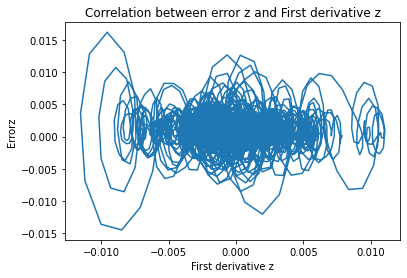

[[ 1.         -0.03673323]
 [-0.03673323  1.        ]]


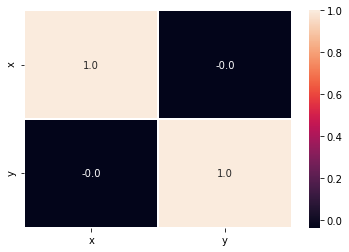

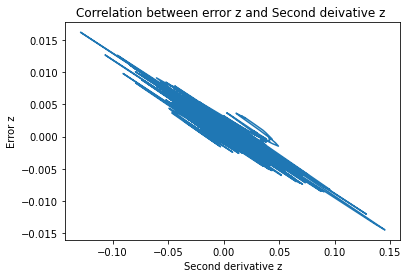

[[ 1.         -0.92234679]
 [-0.92234679  1.        ]]


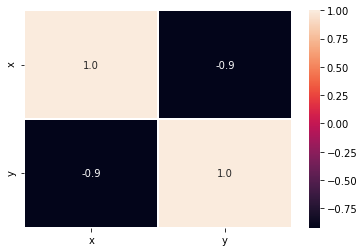

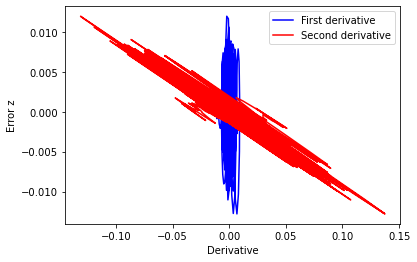

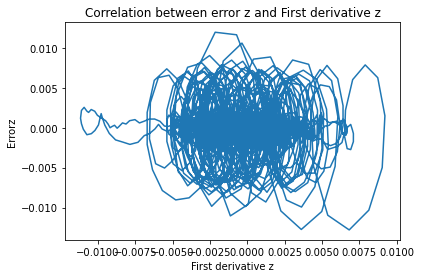

[[ 1.         -0.05330817]
 [-0.05330817  1.        ]]


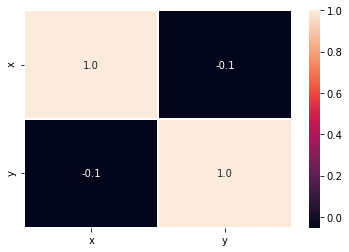

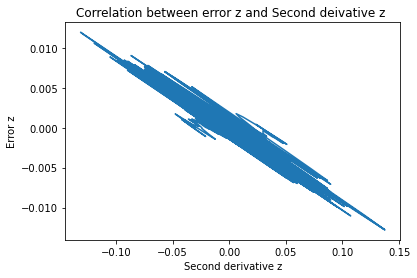

[[ 1.         -0.94823924]
 [-0.94823924  1.        ]]


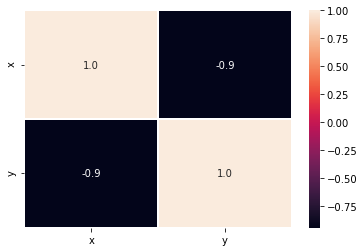

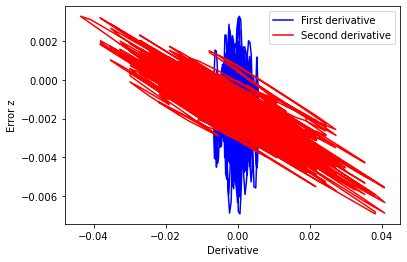

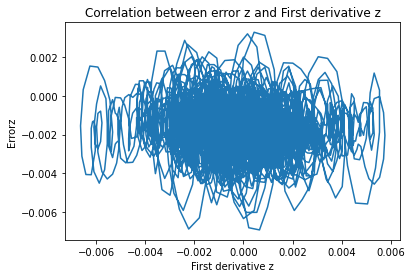

[[ 1.         -0.11076438]
 [-0.11076438  1.        ]]


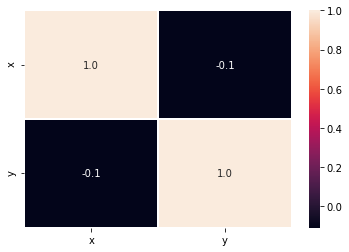

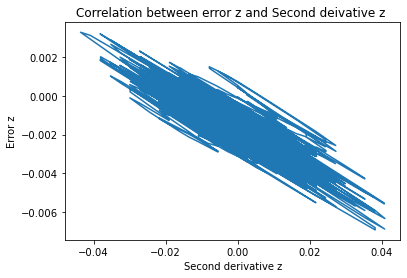

[[ 1.         -0.86097179]
 [-0.86097179  1.        ]]


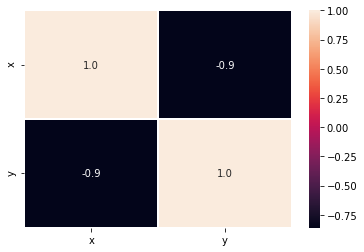

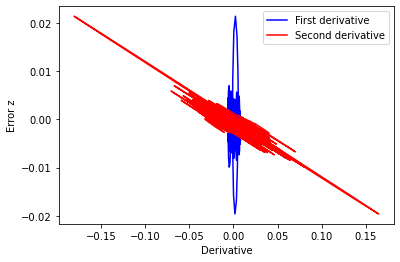

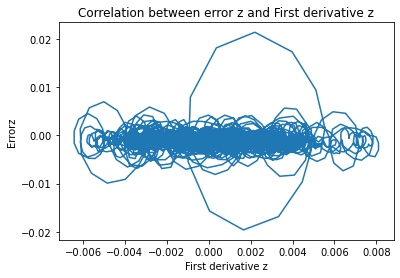

[[ 1.         -0.02305288]
 [-0.02305288  1.        ]]


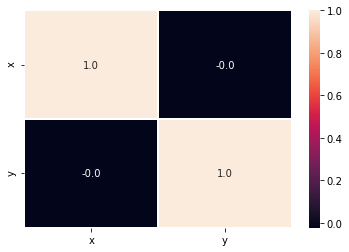

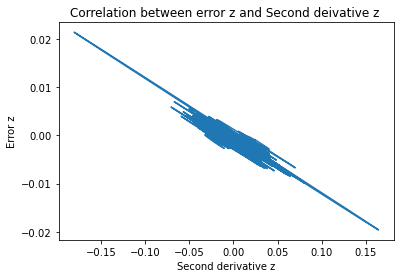

[[ 1.         -0.86594234]
 [-0.86594234  1.        ]]


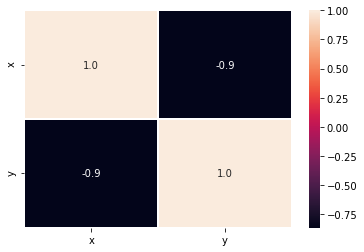

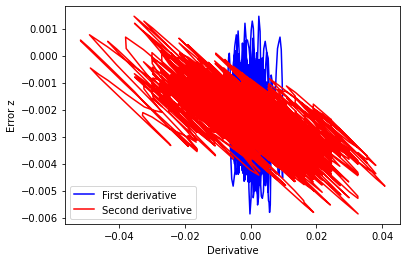

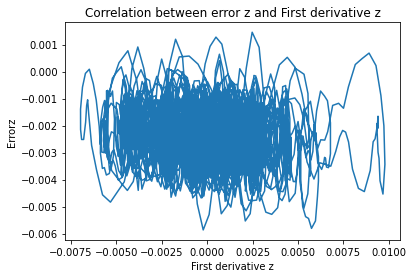

[[ 1.         -0.12244735]
 [-0.12244735  1.        ]]


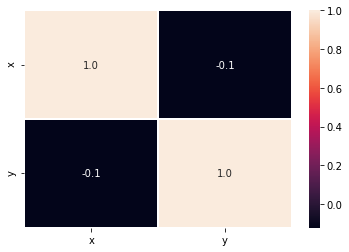

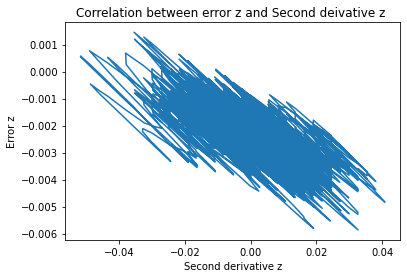

[[ 1.         -0.73042086]
 [-0.73042086  1.        ]]


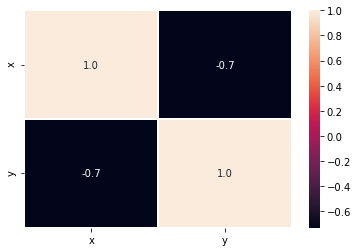

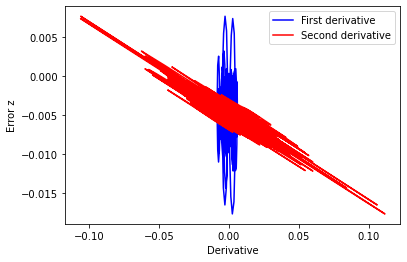

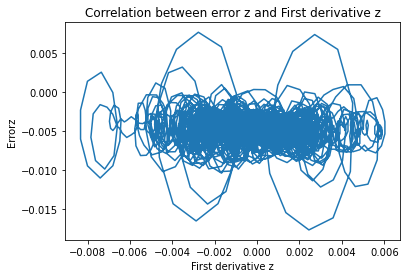

[[ 1.         -0.06111015]
 [-0.06111015  1.        ]]


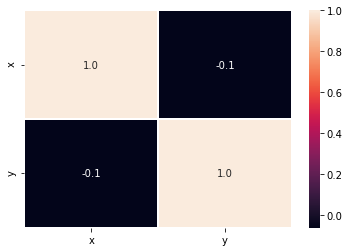

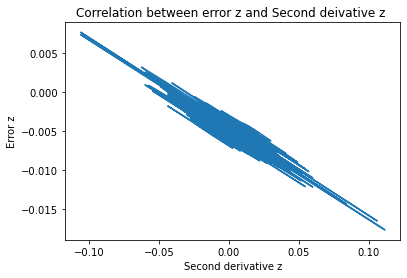

[[ 1.         -0.92131981]
 [-0.92131981  1.        ]]


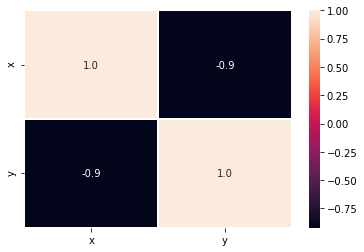

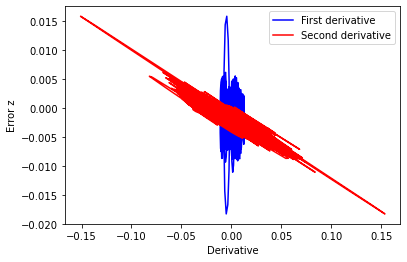

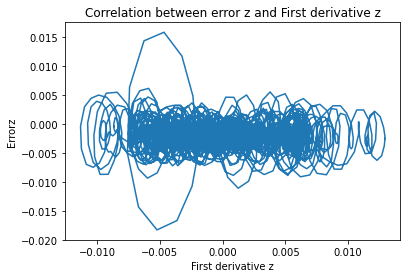

[[ 1.       -0.058361]
 [-0.058361  1.      ]]


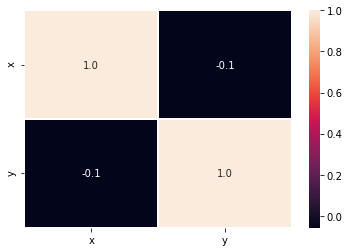

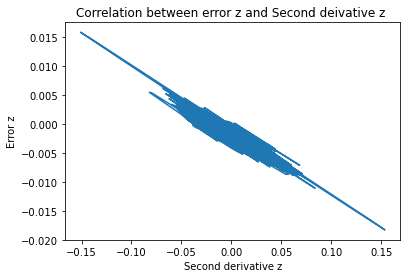

[[ 1.         -0.91934417]
 [-0.91934417  1.        ]]


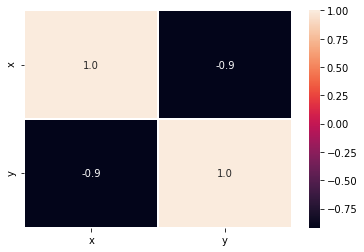

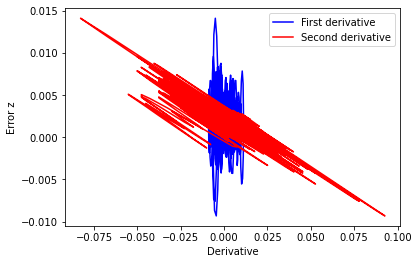

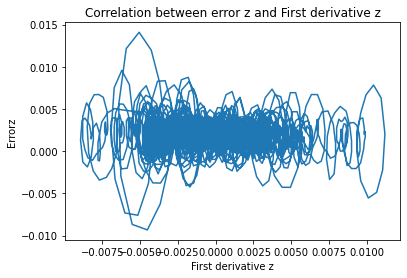

[[ 1.         -0.05641773]
 [-0.05641773  1.        ]]


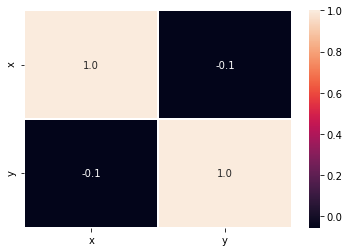

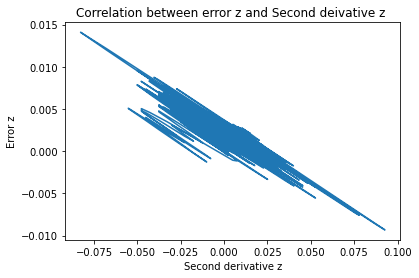

[[ 1.         -0.88183517]
 [-0.88183517  1.        ]]


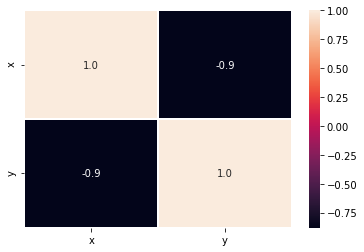

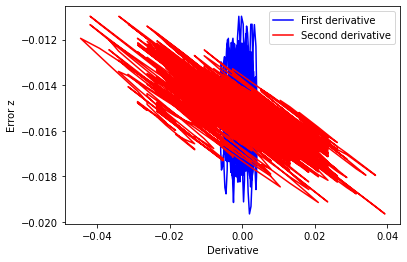

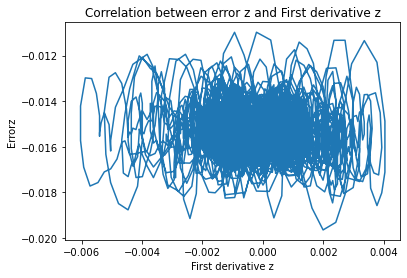

[[ 1.         -0.08153686]
 [-0.08153686  1.        ]]


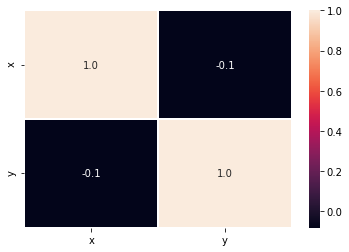

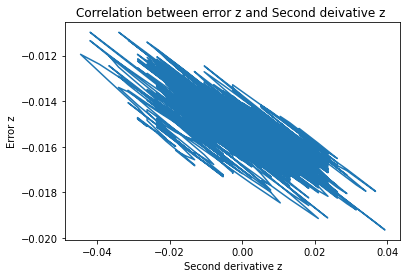

[[ 1.         -0.79008481]
 [-0.79008481  1.        ]]


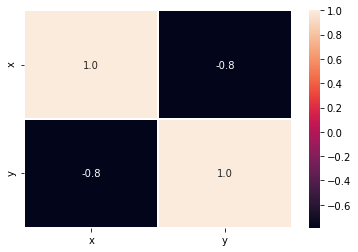

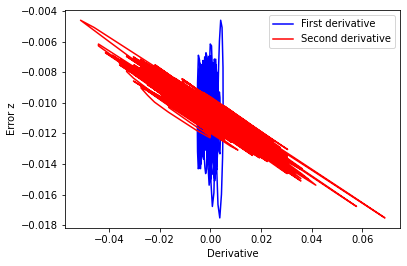

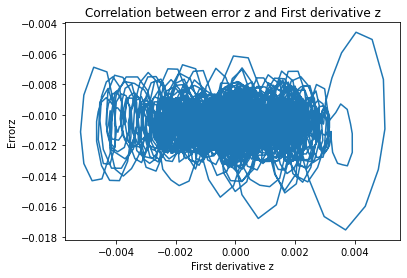

[[ 1.         -0.02713893]
 [-0.02713893  1.        ]]


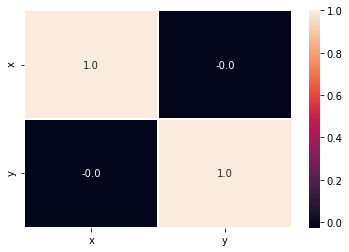

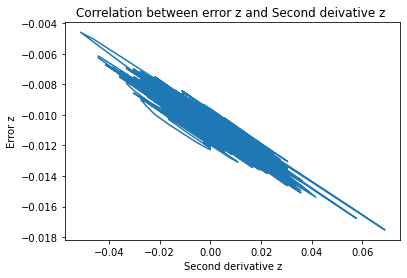

[[ 1.         -0.94257131]
 [-0.94257131  1.        ]]


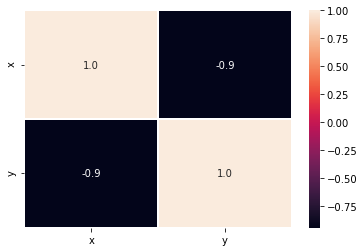

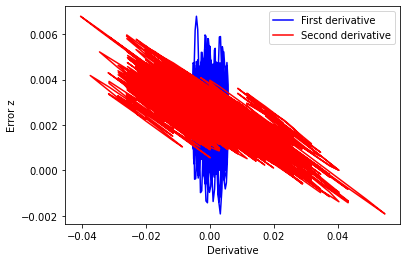

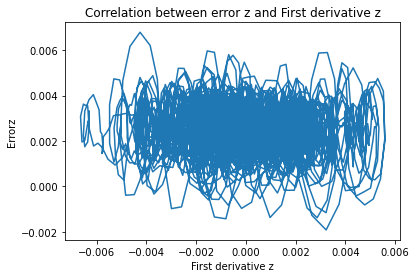

[[ 1.        -0.0605892]
 [-0.0605892  1.       ]]


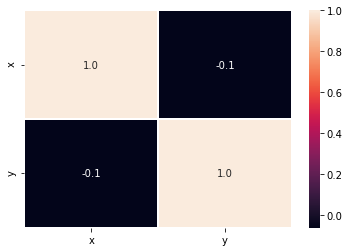

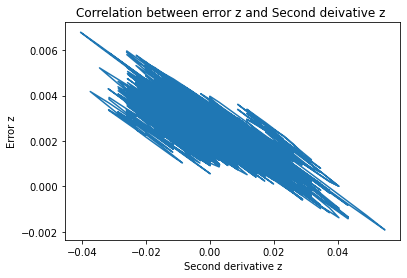

[[ 1.        -0.8157297]
 [-0.8157297  1.       ]]


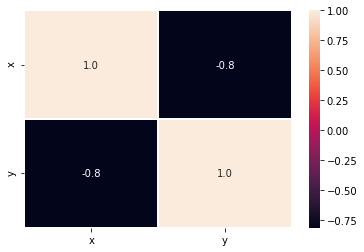

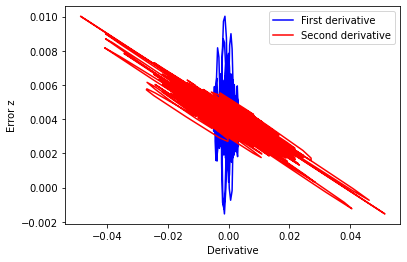

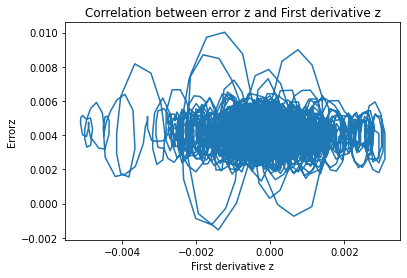

[[ 1.         -0.06274723]
 [-0.06274723  1.        ]]


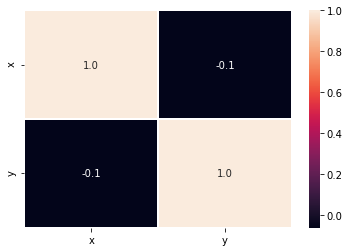

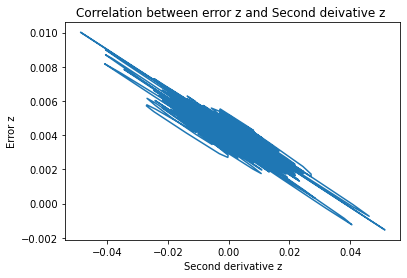

[[ 1.         -0.92644385]
 [-0.92644385  1.        ]]


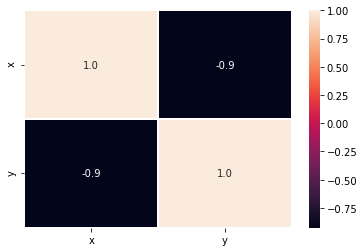

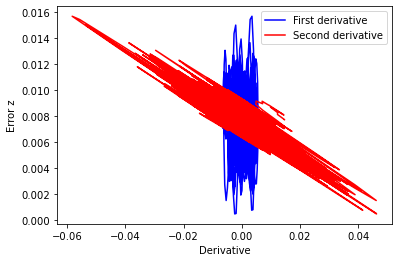

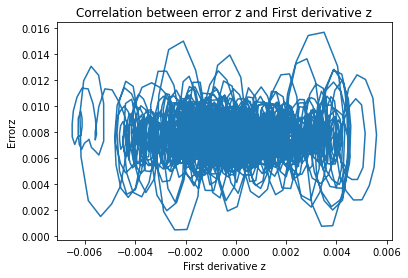

[[ 1.        -0.0366605]
 [-0.0366605  1.       ]]


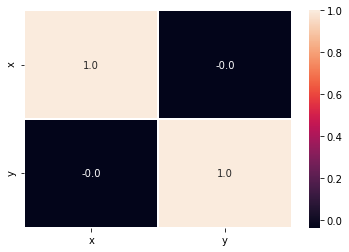

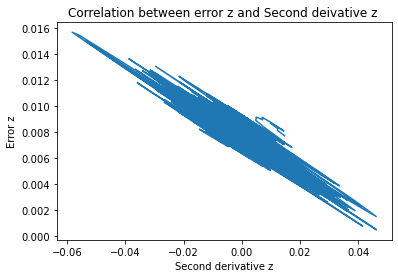

[[ 1.         -0.91521152]
 [-0.91521152  1.        ]]


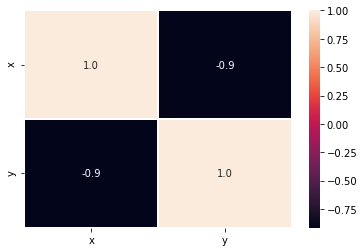

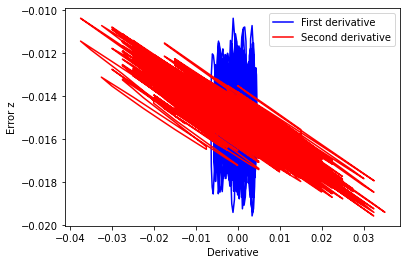

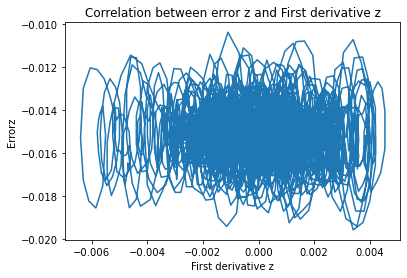

[[ 1.        -0.0501198]
 [-0.0501198  1.       ]]


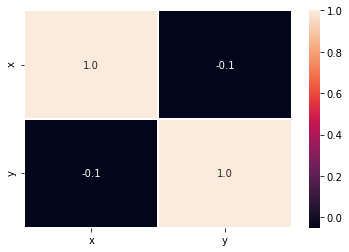

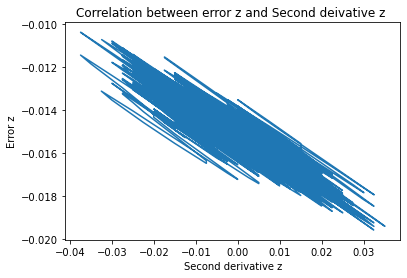

[[ 1.         -0.90166759]
 [-0.90166759  1.        ]]


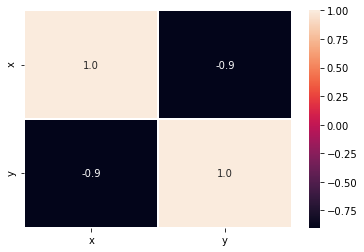

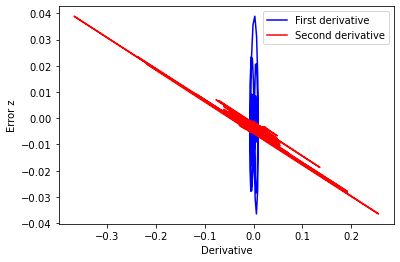

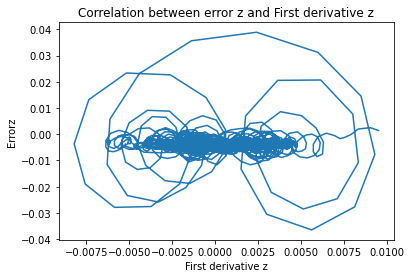

[[ 1.         -0.01331534]
 [-0.01331534  1.        ]]


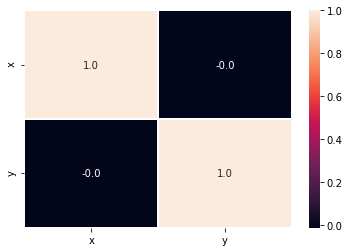

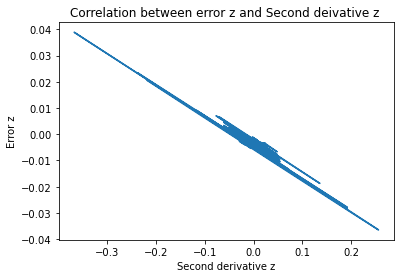

[[ 1.         -0.96749587]
 [-0.96749587  1.        ]]


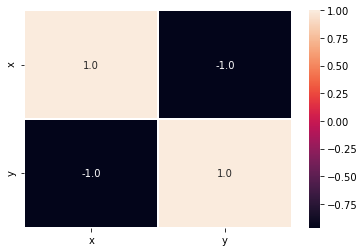

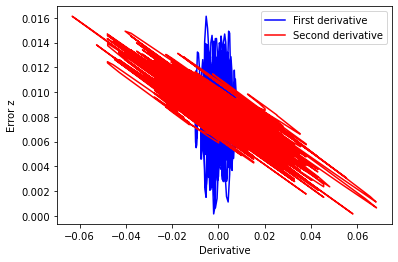

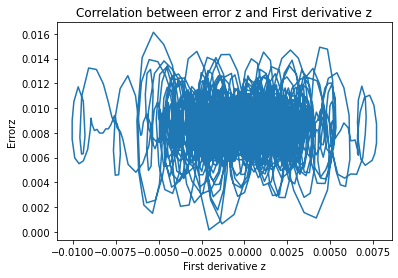

[[ 1.         -0.01546924]
 [-0.01546924  1.        ]]


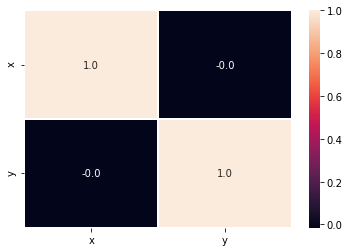

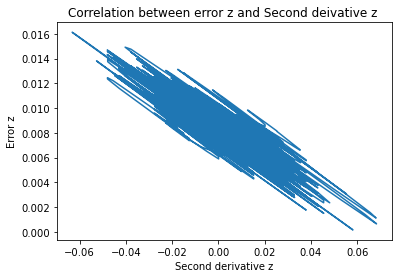

[[ 1.         -0.86893981]
 [-0.86893981  1.        ]]


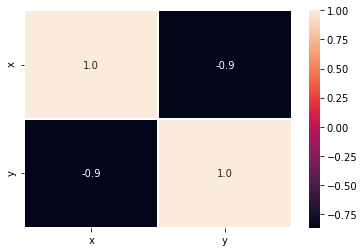

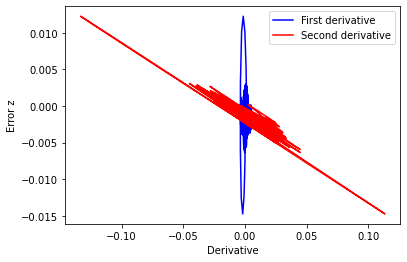

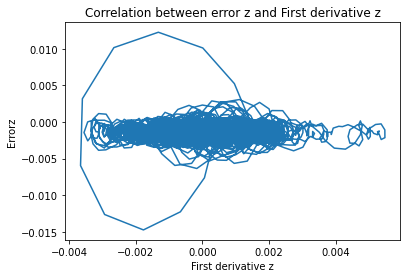

[[ 1.         -0.00920735]
 [-0.00920735  1.        ]]


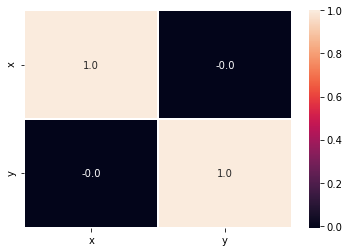

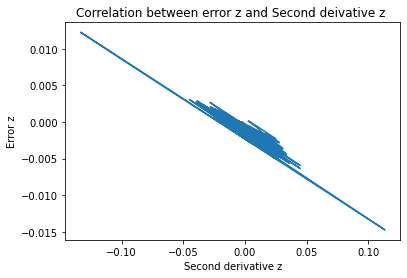

[[ 1.         -0.94377942]
 [-0.94377942  1.        ]]


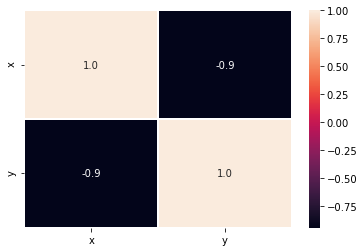

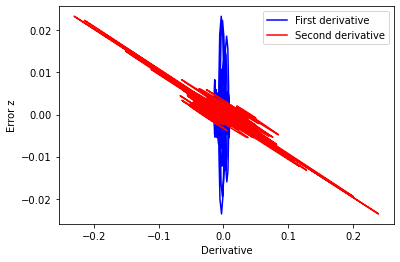

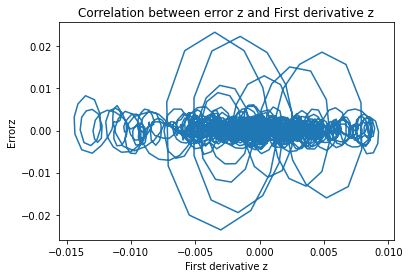

[[ 1.         -0.04635167]
 [-0.04635167  1.        ]]


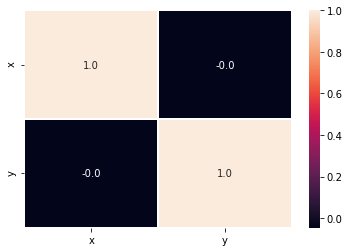

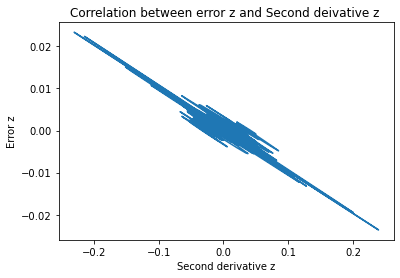

[[ 1.         -0.92100922]
 [-0.92100922  1.        ]]


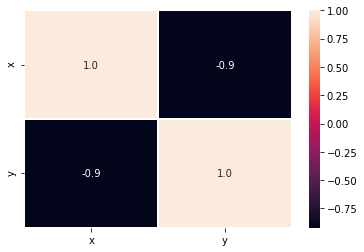

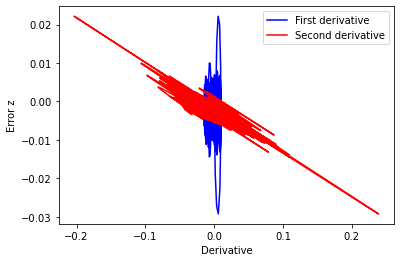

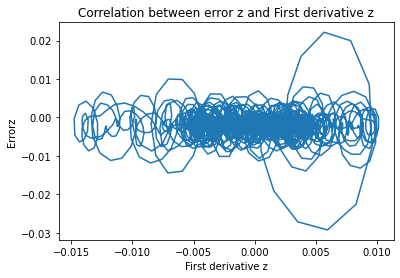

[[ 1.         -0.02443413]
 [-0.02443413  1.        ]]


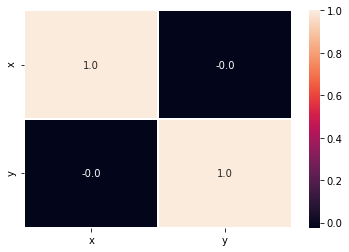

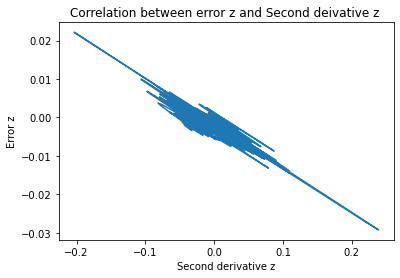

[[ 1.         -0.91153828]
 [-0.91153828  1.        ]]


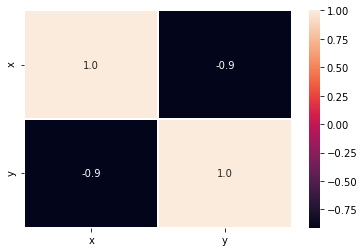

In [26]:
for s in range(1,50):
    plt.figure()
    plt.plot(d1z[s-1,:],errorZ[s-1,:],color='blue',label='First derivative')
    plt.plot(d2z[s-1,:],errorZ[s-1,:],color='red',label='Second derivative')
    plt.xlabel("Derivative")
    plt.ylabel("Error z")
    plt.legend()
    plt.show()

    plt.plot(d1z[s-1,:],errorZ[s-1,:])
    plt.xlabel("First derivative z")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and First derivative z")
    plt.show()
    r=np.corrcoef(d1z[s-1,:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':d1z[s-1,:],
          'y': errorZ[s-1,:],
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    plt.plot(d2z[s-1,:],errorZ[s-1,:])
    plt.xlabel("Second derivative z")
    plt.ylabel("Error z")
    plt.title("Correlation between error z and Second deivative z ")
    plt.show()
    r=np.corrcoef(d2z[s-1,:],errorZ[s-1,:])
    print(r)
    plt.figure()
    data={'x':d2z[s-1,:],
          'y': errorZ[s-1,:],
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
